In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
from pathlib import Path
from wordcloud import WordCloud, STOPWORDS

In [2]:
raw = Path('/home3/usfb/analysis/analysis-fake-news/input/reaction/1000-page/20-min/by-reaction-type/LIKE/by-page-id')
page_info_path = Path('/home3/usfb/build/output/page/1000-page-info.csv')
politifact_fake_domain_path = Path('/home3/usfb/analysis/analysis-fake-news/temp/post-match-domain/1000_page_politifact_domain.csv')

In [3]:
pageinfo = pd.read_csv(page_info_path)
politifact_with_fake_domain = pd.read_csv(politifact_fake_domain_path)
page_category = pageinfo[['page_id','category','type']]
politifact_with_fake_domain = politifact_with_fake_domain.join(page_category.set_index('page_id'), on='page_id')
politifact_with_fake_domain

,page_id,page_name,post_id,post_type,post_name,post_message,post_caption,post_picture,post_link,post_description,...,post_created_time_CT,post_updated_time_CT,post_created_date_CT,post_updated_date_CT,post_created_time,post_updated_time,page_talking_about_count,domain,category,type
0,440106476051475,Freedom Daily,440106476051475_1308905149171599,link,Donald Trump Thinks Some Kids NEED a GOOD Old ...,Donald Trump Thinks Some Kids NEED a GOOD Ol' ...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/donald-trump-thinks-ki...,A good 'Ol Whoopin!,...,2016-11-22T10:28:48Z,2016-12-10T19:02:11Z,2016-11-22,2016-12-10,2016-11-22T16:28:48Z,2016-12-11T01:02:11Z,203082.0,FreedomDaily.com,Media/News/Publishing,media
1,610045389164725,Liberal Daily,610045389164725_770596729776256,link,"""Grow A Nut"", Whoopi Doesn't Hold Back, Just T...","Whoopi is pissed off, just let loose on the sp...",liberalplug.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://liberalplug.com/2017/02/07/grow-nut-who...,NaN,...,2017-02-07T14:00:03Z,2017-04-03T18:43:49Z,2017-02-07,2017-04-03,2017-02-07T20:00:03Z,2017-04-03T23:43:49Z,165919.0,LiberalPlug.com,Media/News/Publishing,media
2,440106476051475,Freedom Daily,440106476051475_1138216752907107,link,"Home Invasion Thug Stabs 75-Year-Old Man, 80-Y...","Home Invasion Thug Stabs 75-Year-Old Man, 80-Y...",freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/home-invasion-thug-sta...,"An intruder broke into a home in Monroe, Washi...",...,2016-05-01T16:30:00Z,2016-05-03T13:40:50Z,2016-05-01,2016-05-03,2016-05-01T21:30:00Z,2016-05-03T18:40:50Z,273614.0,FreedomDaily.com,Media/News/Publishing,media
3,440106476051475,Freedom Daily,440106476051475_1376156649113115,link,Donald Trump Thinks Some Kids NEED a GOOD Old ...,Donald Trump Thinks Some Kids NEED a GOOD Old ...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/donald-trump-thinks-ki...,A good 'Ol Whoopin!,...,2017-01-15T11:03:18Z,2017-01-22T11:47:35Z,2017-01-15,2017-01-22,2017-01-15T17:03:18Z,2017-01-22T17:47:35Z,200739.0,FreedomDaily.com,Media/News/Publishing,media
4,610045389164725,Liberal Daily,610045389164725_758948130941116,link,Jimmy Carter Flew To DC For Inauguration...But...,This is how a man of HONOR and DIGNITY behaves...,liberalplug.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://liberalplug.com/2017/01/21/jimmy-carter...,NaN,...,2017-01-21T17:30:00Z,2017-01-26T20:19:55Z,2017-01-21,2017-01-26,2017-01-21T23:30:00Z,2017-01-27T02:19:55Z,171811.0,LiberalPlug.com,Media/News/Publishing,media
5,440106476051475,Freedom Daily,440106476051475_1279170668811714,link,Media RAGING After City's Biggest Police Union...,Media RAGING After City's Biggest Police Union...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/media-raging-citys-big...,HAha! Liberal media is freaking out because Sh...,...,2016-10-24T10:24:08Z,2016-10-26T03:01:07Z,2016-10-24,2016-10-26,2016-10-24T15:24:08Z,2016-10-26T08:01:07Z,437482.0,FreedomDaily.com,Media/News/Publishing,media
6,610045389164725,Liberal Daily,610045389164725_755235044645758,link,Liz Warren Just Struck At Trump With A Bill Th...,Hero Senator Liz Warren just filed a bill that...,liberalplug.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://liberalplug.com/2017/01/15/liz-warren-j...,NaN,...,2017-01-15T13:21:00Z,2017-02-18T21:07:05Z,2017-01-15,2017-02-18,2017-01-15T19:21:00Z,2017-02-19T03:07:05Z,171811.0,LiberalPlug.com,Media/News/Publishing,media
7,610045389164725,Liberal Daily,610045389164725_774673936035202,link,"Congressman Who Called Trump ""Racist"" Refuses ...",A Dem congressman caught flak for calling Trum...,liberalplug.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://liberalplug.com/2017/02/14/congressman-...,NaN,...,2017-02-14T14:00:00Z,2017-02-21T04:58:28Z,2017-02-14,2017-02-21,2017-02-14T20:00:00Z,2017-02-21T10:58:28Z,16

In [4]:
pageinfo_separate_by_cat = pageinfo.groupby('category').mean()
pageinfo_separate_by_cat = pageinfo_separate_by_cat[['total_like','total_comment','total_share','fan_count']]
pageinfo_separate_by_cat['page_num'] = pageinfo.groupby('category').size()

In [5]:
pageinfo_separate_by_type = pageinfo.groupby('type').mean()
pageinfo_separate_by_type = pageinfo_separate_by_type[['total_like','total_comment','total_share','fan_count']]
pageinfo_separate_by_type['page_num'] = pageinfo.groupby('type').size()

In [6]:
politifact_separate_by_cat = politifact_with_fake_domain.groupby('category').mean()
politifact_separate_by_cat = politifact_separate_by_cat[['post_reactions','post_likes','post_comments','post_shares','page_talking_about_count']]
politifact_separate_by_cat['count'] = politifact_with_fake_domain.groupby('category').size()
politifact_separate_by_cat['page_num'] = politifact_with_fake_domain.groupby(['category','page_name']).size().reset_index().groupby('category').size()
politifact_separate_by_cat = politifact_separate_by_cat[politifact_separate_by_cat['count']>90]
politifact_separate_by_cat.sort_values('count')

,post_reactions,post_likes,post_comments,post_shares,page_talking_about_count,count,page_num
category,,,,,,,
Organization,742.393939,287.479167,71.552083,338.600000,4.965308e+04,96,2
Arts/Humanities Website,829.888889,700.762887,76.103093,304.968750,4.512231e+05,97,1
Education,195.031250,110.432584,15.797753,134.902098,5.513023e+04,178,3
Political Organization,499.842975,381.148571,104.131429,429.902685,1.595614e+05,350,14
Musician/Band,2144.972028,1556.852273,296.059659,2155.670455,1.256542e+07,352,2
Website,1073.092784,786.185819,87.520782,356.331633,3.996985e+05,409,4
Society/Culture Website,915.402985,815.295880,129.157303,441.550562,1.107704e+05,534,2
Personal Blog,333.233108,275.406932,64.798460,168.778271,5.524922e+04,779,2
Non-Governmental Organization (NGO),235.392357,168.049682,42.351592,98.579421,3.385693e+04,1570,1


In [7]:
politifact_separate_by_type = politifact_with_fake_domain.groupby('type').mean()
politifact_separate_by_type = politifact_separate_by_type[['post_reactions','post_likes','post_comments','post_shares','page_talking_about_count']]
politifact_separate_by_type['count'] = politifact_with_fake_domain.groupby('type').size()
politifact_separate_by_type['page_num'] = politifact_with_fake_domain.groupby(['type','page_name']).size().reset_index().groupby('type').size()
politifact_separate_by_type

,post_reactions,post_likes,post_comments,post_shares,page_talking_about_count,count,page_num
type,,,,,,,
figure,482.353943,336.531283,78.051039,194.284932,1.461013e+05,16223,24
group,581.435492,444.999275,100.825327,279.041251,1.170871e+05,31745,92
media,1227.113731,641.382905,125.076634,420.594803,3.221109e+05,83710,56
others,1559.808824,883.352396,165.001546,1236.947702,6.871414e+06,647,5


## frequently used words for post name in different types

In [28]:
import nltk
from nltk import sent_tokenize
total_post_name = ""
for i in politifact_with_fake_domain['post_name'][:]:
    total_post_name = total_post_name + str(i) + '\n'
sentences = sent_tokenize(total_post_name)

In [29]:
from nltk.tokenize import word_tokenize
tokens = word_tokenize(total_post_name)
tokens = [w.lower() for w in tokens]
import string
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]

In [30]:
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])

['donald', 'trump', 'think', 'kid', 'need', 'good', 'old', 'fashion', 'spank', 'agree', 'vote', 'freedom', 'daily', 'grow', 'nut', 'whoopi', 'hold', 'back', 'torch', 'cowardly', 'gops', 'refuse', 'stand', 'idiot', 'betsy', 'devos', 'video', 'home', 'invasion', 'thug', 'stab', 'man', 'wife', 'blow', 'thug', 'away', 'freedom', 'daily', 'donald', 'trump', 'think', 'kid', 'need', 'good', 'old', 'fashion', 'spank', 'agree', 'vote', 'freedom', 'daily', 'jimmy', 'carter', 'fly', 'dc', 'inauguration', 'something', 'amaze', 'protestors', 'plane', 'media', 'rag', 'city', 'biggest', 'police', 'union', 'award', 'sheriff', 'clarke', 'man', 'year', 'freedom', 'daily', 'liz', 'warren', 'strike', 'trump', 'bill', 'could', 'lead', 'impeachment', 'hell', 'yes', 'congressman', 'call', 'trump', 'racist', 'refuse', 'apologize', 'double', 'hell', 'yes', 'army', 'ranger', 'destroy', 'qb', 'colin', 'kaepernick', 'sit', 'anthem']


In [31]:
from collections import Counter
x = Counter(lemmatized)
x.most_common()

[('obama', 13990),
 ('video', 13051),
 ('trump', 12528),
 ('politics', 10934),
 ('hillary', 9868),
 ('get', 7863),
 ('watch', 7834),
 ('muslim', 7736),
 ('man', 6356),
 ('see', 5970),
 ('freedom', 5899),
 ('make', 5838),
 ('daily', 5817),
 ('cop', 5623),
 ('say', 5616),
 ('woman', 5540),
 ('black', 5454),
 ('us', 5377),
 ('find', 4885),
 ('go', 4414),
 ('doug', 4229),
 ('break', 4137),
 ('isis', 4113),
 ('new', 4064),
 ('white', 4060),
 ('muslims', 3812),
 ('take', 3480),
 ('shock', 3461),
 ('question', 3365),
 ('attack', 3337),
 ('call', 3336),
 ('girl', 3315),
 ('one', 3270),
 ('america', 3261),
 ('look', 3127),
 ('leave', 3098),
 ('giles', 3023),
 ('herald', 2954),
 ('mom', 2878),
 ('kill', 2869),
 ('police', 2838),
 ('show', 2762),
 ('gun', 2633),
 ('people', 2625),
 ('sick', 2613),
 ('clinton', 2584),
 ('want', 2519),
 ('shoot', 2445),
 ('dear', 2413),
 ('give', 2380),
 ('come', 2339),
 ('news', 2207),
 ('something', 2192),
 ('secret', 2172),
 ('catch', 2158),
 ('school', 2104),
 

In [ ]:
import nltk
from nltk import sent_tokenize
figure_post_name = ""
for i in politifact_with_fake_domain[politifact_with_fake_domain['type']=='figure']['post_name']:
    figure_post_name = figure_post_name + str(i) + '\n'
sentences = sent_tokenize(figure_post_name)

In [15]:
from nltk.tokenize import word_tokenize
tokens = word_tokenize(figure_post_name)
tokens = [w.lower() for w in tokens]
import string
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]

In [16]:
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])

['mcdonalds', 'pizza', 'hut', 'kfc', 'refuse', 'muslim', 'demand', 'serve', 'halal', 'meat', 'view', 'chop', 'block', 'cancel', 'fan', 'sick', 'tire', 'video', 'plan', 'parenthood', 'get', 'million', 'tax', 'money', 'spend', 'million', 'hillary', 'campaign', 'court', 'rule', 'sharia', 'civil', 'law', 'muslims', 'america', 'hey', 'soros', 'kiss', 'deplorable', 'hillary', 'police', 'intentionally', 'kill', 'black', 'men', 'france', 'find', 'mosque', 'raid', 'deeply', 'disturb', 'proof', 'trump', 'right', 'us', 'herald', 'clock', 'boy', 'family', 'leave', 'america', 'say', 'good', 'riddance', 'doug', 'giles', 'clashdaily', 'clock', 'boy', 'family', 'leave', 'america', 'say', 'good', 'riddance', 'doug', 'giles', 'clashdaily', 'massive', 'rally', 'islam', 'france', 'never', 'know', 'watch', 'cnn', 'ice', 'hit', 'sanctuary', 'city', 'philadelphia', 'arrest', 'criminal', 'illegal', 'immigrants', 'rosie', 'donnell', 'leave', 'america', 'promise']


In [17]:
from collections import Counter
x = Counter(lemmatized)
x.most_common()

[('obama', 1814),
 ('video', 1450),
 ('trump', 1156),
 ('hillary', 1151),
 ('isis', 1012),
 ('get', 899),
 ('muslim', 885),
 ('us', 824),
 ('watch', 820),
 ('man', 788),
 ('make', 697),
 ('say', 662),
 ('woman', 657),
 ('black', 609),
 ('herald', 597),
 ('attack', 569),
 ('police', 522),
 ('clinton', 520),
 ('new', 518),
 ('go', 503),
 ('muslims', 495),
 ('find', 494),
 ('take', 485),
 ('cop', 485),
 ('kill', 465),
 ('doug', 450),
 ('white', 448),
 ('break', 441),
 ('call', 440),
 ('giles', 438),
 ('see', 435),
 ('clashdaily', 421),
 ('gun', 415),
 ('shoot', 405),
 ('america', 387),
 ('state', 358),
 ('question', 357),
 ('show', 349),
 ('leave', 342),
 ('school', 339),
 ('one', 324),
 ('shock', 316),
 ('want', 312),
 ('people', 305),
 ('girl', 301),
 ('plan', 291),
 ('try', 281),
 ('give', 275),
 ('judge', 256),
 ('house', 252),
 ('report', 252),
 ('american', 246),
 ('mom', 244),
 ('refugees', 241),
 ('islam', 240),
 ('arrest', 240),
 ('bill', 236),
 ('flag', 233),
 ('like', 230),
 ('

In [8]:

total_post_name = []
for i in politifact_with_fake_domain['post_name'][:]:
    total_post_name.append(str(i))

In [9]:
import gensim
import string
from nltk.corpus import stopwords
import nltk
from nltk.tokenize import word_tokenize
totalpost_name = []
for i in total_post_name:
    tokens = word_tokenize(i)
    tokens = [w.lower() for w in tokens]
    
    table = str.maketrans('','',string.punctuation)
    stripped = [w.translate(table) for w in tokens]
    words = [word for word in tokens if word.isalpha()]
    
    stop_words = set(stopwords.words('english'))
    words = [w for w in words if not w in stop_words]
    totalpost_name.append(words)

In [10]:
import gensim
from gensim import corpora
dictionary = corpora.Dictionary(totalpost_name)
corpus = [dictionary.doc2bow(text) for text in totalpost_name]

In [11]:
from gensim import models
tfidf = models.TfidfModel(corpus)

In [23]:
model=models.ldamodel.LdaModel(corpus, num_topics=5, id2word=dictionary)

In [24]:
model.print_topics(num_words=5)

[(0,
  '0.046*"politics" + 0.026*"liberty" + 0.024*"alliance" + 0.017*"doug" + 0.016*"video"'),
 (1,
  '0.094*"politics" + 0.027*"obama" + 0.026*"video" + 0.017*"willie" + 0.014*"schiff"'),
 (2,
  '0.022*"man" + 0.016*"woman" + 0.011*"mom" + 0.011*"girl" + 0.010*"economic"'),
 (3,
  '0.022*"jim" + 0.017*"black" + 0.014*"video" + 0.011*"dollar" + 0.010*"white"'),
 (4,
  '0.046*"alternative" + 0.014*"trump" + 0.009*"muslim" + 0.009*"hillary" + 0.009*"freedom"')]

In [12]:
tfidf_corpus = tfidf[corpus]
tfidf_corpus

In [13]:
model2 =models.ldamodel.LdaModel(tfidf_corpus, num_topics=15, id2word=dictionary)

In [14]:
model2.print_topics(num_words=8)

[(0,
  '0.020*"reasons" + 0.017*"false" + 0.011*"currency" + 0.009*"signs" + 0.009*"modern" + 0.008*"powerful" + 0.007*"report" + 0.007*"pics"'),
 (1,
  '0.014*"ancient" + 0.012*"earth" + 0.010*"united" + 0.008*"left" + 0.008*"man" + 0.008*"ready" + 0.007*"discovery" + 0.007*"mysterious"'),
 (2,
  '0.019*"nuclear" + 0.010*"sex" + 0.010*"students" + 0.009*"things" + 0.008*"bernie" + 0.007*"times" + 0.007*"pentagon" + 0.006*"lies"'),
 (3,
  '0.048*"politics" + 0.026*"illuminati" + 0.021*"collapse" + 0.009*"mind" + 0.008*"video" + 0.007*"stock" + 0.007*"blow" + 0.006*"check"'),
 (4,
  '0.057*"liberty" + 0.054*"alliance" + 0.039*"schiff" + 0.039*"peter" + 0.021*"economic" + 0.018*"economy" + 0.008*"matter" + 0.006*"future"'),
 (5,
  '0.012*"order" + 0.010*"cruz" + 0.010*"obama" + 0.009*"list" + 0.008*"gay" + 0.008*"google" + 0.008*"ways" + 0.007*"tell"'),
 (6,
  '0.010*"news" + 0.010*"conspiracy" + 0.009*"paris" + 0.008*"terrorist" + 0.007*"windows" + 0.006*"mass" + 0.006*"video" + 0.006*"

In [15]:
import pyLDAvis.gensim
lda_display = pyLDAvis.gensim.prepare(model2, tfidf_corpus, dictionary, sort_topics=False)
pyLDAvis.display(lda_display)

/home3/ntueconfbra5/.conda/envs/jesse/lib/python3.6/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


In [ ]:
total_post_name = []
for i in politifact_with_fake_domain['post_name'][:]:
    total_post_name.append(str(i))
totalpost_name = []
for i in total_post_name:
    tokens = word_tokenize(i)
    tokens = [w.lower() for w in tokens]
    table = str.maketrans('','',string.punctuation)
    stripped = [w.translate(table) for w in tokens]
    words = [word for word in tokens if word.isalpha()]
    stop_words = set(stopwords.words('english'))
    words = [w for w in words if not w in stop_words]
    totalpost_name.append(words)

In [ ]:
dictionary = corpora.Dictionary(totalpost_name)
corpus = [dictionary.doc2bow(text) for text in totalpost_name]
tfidf = models.TfidfModel(corpus)
tfidf_corpus = tfidf[corpus]
tfidf_corpus
model2 =models.ldamodel.LdaModel(tfidf_corpus, num_topics=15, id2word=dictionary)
model2.print_topics(num_words=8)

In [58]:
politifact_topicmodel = pd.DataFrame()
politifact_topicmodel = politifact_with_fake_domain[:]

In [62]:
from datetime import datetime
politifact_topicmodel['post_created_date_CT'] = politifact_topicmodel['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))

In [78]:
politifact_topicmodel['post_created_month'] = politifact_with_fake_domain['post_created_date_CT'].map(lambda x:x[0:7])

## Topic Modeling For Every Month

In [89]:
total_post_name_201601 = []
for i in politifact_topicmodel[politifact_topicmodel['post_created_month'] == '2016-01']['post_name']:
    total_post_name_201601.append(str(i))
totalpost_name = []
for i in total_post_name_201601:
    tokens = word_tokenize(i)
    tokens = [w.lower() for w in tokens]
    table = str.maketrans('','',string.punctuation)
    stripped = [w.translate(table) for w in tokens]
    words = [word for word in tokens if word.isalpha()]
    stop_words = set(stopwords.words('english'))
    words = [w for w in words if not w in stop_words]
    totalpost_name.append(words)
dictionary = corpora.Dictionary(totalpost_name)
corpus = [dictionary.doc2bow(text) for text in totalpost_name]
tfidf = models.TfidfModel(corpus)
tfidf_corpus = tfidf[corpus]
tfidf_corpus
model2 =models.ldamodel.LdaModel(tfidf_corpus, num_topics=15, id2word=dictionary)
model2.print_topics(num_words=8)

[(0,
  '0.019*"due" + 0.014*"vote" + 0.013*"reserve" + 0.011*"attack" + 0.011*"little" + 0.009*"muslim" + 0.008*"christian" + 0.008*"girls"'),
 (1,
  '0.020*"national" + 0.013*"media" + 0.009*"former" + 0.009*"mainstream" + 0.008*"review" + 0.007*"amazing" + 0.007*"silent" + 0.007*"people"'),
 (2,
  '0.018*"politics" + 0.014*"new" + 0.009*"cruz" + 0.007*"reveals" + 0.007*"discovers" + 0.007*"dangerous" + 0.007*"human" + 0.007*"obama"'),
 (3,
  '0.014*"history" + 0.009*"white" + 0.008*"book" + 0.007*"demise" + 0.007*"encryption" + 0.007*"privacy" + 0.007*"key" + 0.007*"tyranny"'),
 (4,
  '0.023*"jim" + 0.018*"illuminati" + 0.018*"alternative" + 0.013*"ancient" + 0.012*"politics" + 0.010*"even" + 0.009*"weapon" + 0.009*"willie"'),
 (5,
  '0.012*"city" + 0.012*"trump" + 0.009*"question" + 0.009*"still" + 0.008*"behind" + 0.008*"middle" + 0.008*"star" + 0.007*"candidate"'),
 (6,
  '0.015*"cruz" + 0.015*"economy" + 0.013*"trump" + 0.013*"haters" + 0.011*"ted" + 0.010*"issue" + 0.009*"blinde

In [94]:
total_post_name_201602 = []
for i in politifact_topicmodel[politifact_topicmodel['post_created_month'] == '2016-02']['post_name']:
    total_post_name_201602.append(str(i))
totalpost_name = []
for i in total_post_name_201602:
    tokens = word_tokenize(i)
    tokens = [w.lower() for w in tokens]
    table = str.maketrans('','',string.punctuation)
    stripped = [w.translate(table) for w in tokens]
    words = [word for word in tokens if word.isalpha()]
    stop_words = set(stopwords.words('english'))
    words = [w for w in words if not w in stop_words]
    totalpost_name.append(words)
dictionary = corpora.Dictionary(totalpost_name)
corpus = [dictionary.doc2bow(text) for text in totalpost_name]
tfidf = models.TfidfModel(corpus)
tfidf_corpus = tfidf[corpus]
tfidf_corpus
model2 =models.ldamodel.LdaModel(tfidf_corpus, num_topics=15, id2word=dictionary)
model2.print_topics(num_words=8)

[(0,
  '0.020*"microchipped" + 0.020*"actually" + 0.019*"alternative" + 0.018*"cash" + 0.017*"world" + 0.015*"news" + 0.013*"new" + 0.012*"announcements"'),
 (1,
  '0.046*"videos" + 0.038*"alternative" + 0.018*"together" + 0.016*"history" + 0.010*"blacksphere" + 0.010*"biggest" + 0.009*"terrorists" + 0.008*"fired"'),
 (2,
  '0.056*"willie" + 0.050*"jim" + 0.035*"towers" + 0.018*"phone" + 0.018*"ban" + 0.017*"coming" + 0.017*"politics" + 0.013*"order"'),
 (3,
  '0.021*"interview" + 0.021*"popping" + 0.019*"obedience" + 0.019*"allegiance" + 0.019*"pledge" + 0.018*"indoctrination" + 0.014*"truth" + 0.011*"politics"'),
 (4,
  '0.024*"iphone" + 0.024*"turn" + 0.023*"stores" + 0.023*"map" + 0.021*"alternative" + 0.017*"movie" + 0.016*"quoted" + 0.015*"best"'),
 (5,
  '0.050*"collapse" + 0.044*"economic" + 0.024*"global" + 0.023*"approaching" + 0.023*"quickening" + 0.023*"markets" + 0.023*"politics" + 0.015*"cia"'),
 (6,
  '0.046*"cell" + 0.033*"domestic" + 0.027*"everywhere" + 0.025*"market"

In [95]:
total_post_name_201603 = []
for i in politifact_topicmodel[politifact_topicmodel['post_created_month'] == '2016-03']['post_name']:
    total_post_name_201603.append(str(i))
totalpost_name = []
for i in total_post_name_201603:
    tokens = word_tokenize(i)
    tokens = [w.lower() for w in tokens]
    table = str.maketrans('','',string.punctuation)
    stripped = [w.translate(table) for w in tokens]
    words = [word for word in tokens if word.isalpha()]
    stop_words = set(stopwords.words('english'))
    words = [w for w in words if not w in stop_words]
    totalpost_name.append(words)
dictionary = corpora.Dictionary(totalpost_name)
corpus = [dictionary.doc2bow(text) for text in totalpost_name]
tfidf = models.TfidfModel(corpus)
tfidf_corpus = tfidf[corpus]
tfidf_corpus
model2 =models.ldamodel.LdaModel(tfidf_corpus, num_topics=15, id2word=dictionary)
model2.print_topics(num_words=8)

[(0,
  '0.011*"order" + 0.010*"feds" + 0.009*"nuclear" + 0.007*"saying" + 0.007*"finally" + 0.006*"went" + 0.006*"rnc" + 0.006*"hit"'),
 (1,
  '0.017*"politics" + 0.014*"list" + 0.012*"barack" + 0.010*"obama" + 0.010*"kill" + 0.010*"president" + 0.008*"cities" + 0.008*"top"'),
 (2,
  '0.027*"politics" + 0.027*"peter" + 0.027*"schiff" + 0.018*"willie" + 0.015*"collapse" + 0.011*"coming" + 0.011*"economy" + 0.010*"videos"'),
 (3,
  '0.029*"alternative" + 0.014*"cruz" + 0.012*"trump" + 0.011*"time" + 0.008*"bleeding" + 0.008*"government" + 0.007*"stripped" + 0.007*"dear"'),
 (4,
  '0.014*"elections" + 0.012*"looks" + 0.011*"suspend" + 0.010*"like" + 0.009*"starting" + 0.009*"account" + 0.009*"politics" + 0.009*"russia"'),
 (5,
  '0.009*"bank" + 0.009*"wants" + 0.008*"satanism" + 0.008*"question" + 0.008*"dollar" + 0.008*"count" + 0.007*"body" + 0.007*"chick"'),
 (6,
  '0.012*"politics" + 0.012*"plans" + 0.010*"phone" + 0.009*"summer" + 0.009*"press" + 0.009*"war" + 0.008*"videos" + 0.008*

In [96]:
total_post_name_201604 = []
for i in politifact_topicmodel[politifact_topicmodel['post_created_month'] == '2016-04']['post_name']:
    total_post_name_201604.append(str(i))
totalpost_name = []
for i in total_post_name_201604:
    tokens = word_tokenize(i)
    tokens = [w.lower() for w in tokens]
    table = str.maketrans('','',string.punctuation)
    stripped = [w.translate(table) for w in tokens]
    words = [word for word in tokens if word.isalpha()]
    stop_words = set(stopwords.words('english'))
    words = [w for w in words if not w in stop_words]
    totalpost_name.append(words)
dictionary = corpora.Dictionary(totalpost_name)
corpus = [dictionary.doc2bow(text) for text in totalpost_name]
tfidf = models.TfidfModel(corpus)
tfidf_corpus = tfidf[corpus]
tfidf_corpus
model2 =models.ldamodel.LdaModel(tfidf_corpus, num_topics=15, id2word=dictionary)
model2.print_topics(num_words=8)

[(0,
  '0.028*"economic" + 0.018*"history" + 0.016*"politics" + 0.014*"election" + 0.014*"largest" + 0.012*"peter" + 0.012*"schiff" + 0.012*"mean"'),
 (1,
  '0.023*"dollar" + 0.020*"society" + 0.009*"blacklivesmatter" + 0.008*"typical" + 0.007*"politics" + 0.007*"western" + 0.007*"silver" + 0.007*"ever"'),
 (2,
  '0.028*"modern" + 0.019*"silent" + 0.010*"department" + 0.009*"past" + 0.008*"day" + 0.007*"terrorists" + 0.007*"call" + 0.007*"amnesty"'),
 (3,
  '0.019*"politics" + 0.015*"meeting" + 0.013*"coming" + 0.010*"exactly" + 0.009*"fema" + 0.009*"secret" + 0.009*"military" + 0.009*"mankind"'),
 (4,
  '0.041*"collapse" + 0.020*"economic" + 0.015*"system" + 0.011*"reality" + 0.011*"markets" + 0.010*"debt" + 0.009*"humanity" + 0.009*"collapsing"'),
 (5,
  '0.023*"illuminati" + 0.016*"prepare" + 0.016*"wealth" + 0.008*"evaporation" + 0.007*"defense" + 0.007*"cruz" + 0.006*"trump" + 0.006*"major"'),
 (6,
  '0.019*"panama" + 0.019*"politics" + 0.019*"papers" + 0.017*"even" + 0.013*"marti

In [42]:
from gensim.models import CoherenceModel
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model =models.ldamodel.LdaModel(corpus=corpus, num_topics=num_topics, id2word=dictionary)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [43]:
model_list, coherence_values = compute_coherence_values(dictionary=dictionary, corpus=tfidf_corpus, texts=totalpost_name, start=2, limit=40, step=6)

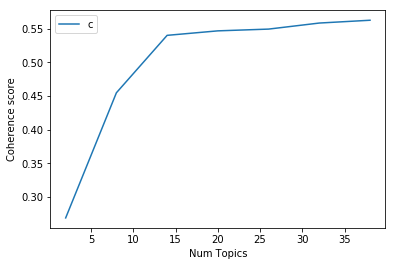

In [93]:
limit=40; start=2; step=6;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [18]:
group_post_name = ""
for i in politifact_with_fake_domain[politifact_with_fake_domain['type']=='group']['post_name']:
    group_post_name = group_post_name + str(i) + '\n'
sentences = sent_tokenize(group_post_name)

In [19]:
from nltk.tokenize import word_tokenize
tokens = word_tokenize(group_post_name)
tokens = [w.lower() for w in tokens]
import string
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]

In [20]:
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])

['liberals', 'irate', 'trump', 'send', 'muslims', 'pack', 'airport', 'showdown', 'coffee', 'co', 'refugees', 'starbucks', 'weep', 'bold', 'man', 'stand', 'brats', 'hold', 'sign', 'perfect', 'word', 'woman', 'order', 'spare', 'rib', 'chinese', 'restaurant', 'dog', 'paw', 'video', 'marine', 'dad', 'make', 'school', 'pay', 'push', 'islamic', 'propaganda', 'daughter', 'teenager', 'beat', 'katt', 'williams', 'file', 'million', 'dollar', 'lawsuit', 'woman', 'order', 'spare', 'rib', 'chinese', 'restaurant', 'dog', 'paw', 'video', 'donald', 'trump', 'say', 'want', 'poppin', 'young', 'thug', 'love', 'caitlyn', 'jenner', 'bae', 'kevin', 'gate', 'file', 'divorce', 'wife', 'refuse', 'eat', 'booty', 'woman', 'beat', 'boyfriend', 'female', 'followers', 'instagram', 'retire', 'cop', 'sell', 'shirt', 'black', 'murder', 'career', 'trend', 'cure', 'finally', 'find', 'doctor', 'confirm', 'condoms', 'trump', 'hillary', 'trust', 'woman', 'suck']


In [21]:
from collections import Counter
x = Counter(lemmatized)
x.most_common()

[('trump', 3852),
 ('obama', 3144),
 ('hillary', 2515),
 ('muslim', 2452),
 ('daily', 2383),
 ('freedom', 2375),
 ('get', 2235),
 ('watch', 2139),
 ('see', 1837),
 ('cop', 1741),
 ('video', 1698),
 ('man', 1681),
 ('make', 1563),
 ('woman', 1556),
 ('say', 1541),
 ('black', 1522),
 ('break', 1333),
 ('find', 1304),
 ('white', 1242),
 ('doug', 1141),
 ('go', 1132),
 ('us', 1111),
 ('muslims', 1093),
 ('look', 1025),
 ('girl', 1018),
 ('shock', 991),
 ('question', 954),
 ('sick', 899),
 ('take', 879),
 ('one', 874),
 ('mom', 873),
 ('call', 845),
 ('leave', 824),
 ('new', 805),
 ('liberty', 796),
 ('alliance', 776),
 ('attack', 772),
 ('america', 767),
 ('show', 729),
 ('isis', 713),
 ('herald', 692),
 ('giles', 667),
 ('people', 665),
 ('kill', 654),
 ('gun', 638),
 ('give', 638),
 ('want', 636),
 ('dear', 635),
 ('police', 629),
 ('something', 628),
 ('news', 612),
 ('come', 608),
 ('thugs', 572),
 ('word', 571),
 ('catch', 571),
 ('islam', 567),
 ('surprise', 558),
 ('try', 553),
 ('l

In [22]:
media_post_name = ""
for i in politifact_with_fake_domain[politifact_with_fake_domain['type']=='media']['post_name']:
    media_post_name = media_post_name + str(i) + '\n'
sentences = sent_tokenize(media_post_name)

In [23]:
from nltk.tokenize import word_tokenize
tokens = word_tokenize(media_post_name)
tokens = [w.lower() for w in tokens]
import string
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]

In [24]:
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])

['donald', 'trump', 'think', 'kid', 'need', 'good', 'old', 'fashion', 'spank', 'agree', 'vote', 'freedom', 'daily', 'grow', 'nut', 'whoopi', 'hold', 'back', 'torch', 'cowardly', 'gops', 'refuse', 'stand', 'idiot', 'betsy', 'devos', 'video', 'home', 'invasion', 'thug', 'stab', 'man', 'wife', 'blow', 'thug', 'away', 'freedom', 'daily', 'donald', 'trump', 'think', 'kid', 'need', 'good', 'old', 'fashion', 'spank', 'agree', 'vote', 'freedom', 'daily', 'jimmy', 'carter', 'fly', 'dc', 'inauguration', 'something', 'amaze', 'protestors', 'plane', 'media', 'rag', 'city', 'biggest', 'police', 'union', 'award', 'sheriff', 'clarke', 'man', 'year', 'freedom', 'daily', 'liz', 'warren', 'strike', 'trump', 'bill', 'could', 'lead', 'impeachment', 'hell', 'yes', 'congressman', 'call', 'trump', 'racist', 'refuse', 'apologize', 'double', 'hell', 'yes', 'army', 'ranger', 'destroy', 'qb', 'colin', 'kaepernick', 'sit', 'anthem']


In [25]:
from collections import Counter
x = Counter(lemmatized)
x.most_common()

[('politics', 10815),
 ('video', 9861),
 ('obama', 9002),
 ('trump', 7497),
 ('hillary', 6176),
 ('watch', 4869),
 ('get', 4718),
 ('muslim', 4397),
 ('man', 3822),
 ('see', 3690),
 ('make', 3568),
 ('freedom', 3476),
 ('us', 3422),
 ('daily', 3386),
 ('cop', 3385),
 ('say', 3366),
 ('woman', 3277),
 ('black', 3277),
 ('find', 3045),
 ('go', 2772),
 ('new', 2706),
 ('doug', 2633),
 ('isis', 2370),
 ('white', 2360),
 ('break', 2343),
 ('muslims', 2222),
 ('shock', 2144),
 ('take', 2104),
 ('america', 2099),
 ('one', 2072),
 ('question', 2054),
 ('call', 2040),
 ('girl', 1991),
 ('attack', 1980),
 ('leave', 1920),
 ('giles', 1913),
 ('look', 1883),
 ('mom', 1752),
 ('kill', 1735),
 ('show', 1678),
 ('police', 1666),
 ('herald', 1659),
 ('people', 1639),
 ('dear', 1573),
 ('gun', 1569),
 ('want', 1550),
 ('sick', 1544),
 ('clinton', 1532),
 ('come', 1513),
 ('secret', 1505),
 ('shoot', 1489),
 ('alternative', 1473),
 ('give', 1455),
 ('catch', 1394),
 ('news', 1387),
 ('something', 1342),

In [30]:
for word in tokens:
    print(word)

donald
trump
thinks
some
kids
need
a
good
old
fashioned
spanking
,
do
you
agree
?
(
vote
)
⋆
freedom
daily
''
grow
a
nut
''
,
whoopi
does
n't
hold
back
,
just
torched
cowardly
gops
who
refuse
to
stand
up
to
idiot
betsy
devos
[
video
]
home
invasion
thug
stabs
75-year-old
man
,
80-year-old
wife
blows
thug
away
⋆
freedom
daily
donald
trump
thinks
some
kids
need
a
good
old
fashioned
spanking
,
do
you
agree
?
(
vote
)
⋆
freedom
daily
jimmy
carter
flew
to
dc
for
inauguration
...
but
he
did
something
amazing
for
the
protestors
on
the
plane
!
media
raging
after
city
's
biggest
police
union
awards
sheriff
clarke
‘
man
of
the
year
’
⋆
freedom
daily
liz
warren
just
struck
at
trump
with
a
bill
that
could
lead
to
his
impeachment
,
hell
yes
congressman
who
called
trump
``
racist
''
refuses
to
apologize
,
just
doubled
down
on
it
,
hell
yes
army
ranger
destroys
49ers
qb
colin
kaepernick
who
sat
out
nat'l
anthem
and
cried
racism
⋆
freedom
daily
bernie
sanders
brilliantly
destroys
trump
after
the
presi

us
herald
this
is
what
happened
when
maine
forced
welfare
recipients
to
work
for
their
benefits
stop
blaming
others
:
black
teen
sold
newspapers
for
5
years
,
has
enough
money
to
pay
for
college
⋆
freedom
daily
prince
harry
makes
amazing
pledge
to
u.s.
veterans
-
puts
obama
to
shame
in
huge
way
!
!
!
⋆
us
herald
thug
put
a
gun
to
a
woman
's
head
,
but
she
was
faster
pulled
her
own
and
smoked
his
a*s
!
⋆
freedom
daily
breaking
:
millions
of
greedy
illegals
just
got
their
asses
kicked
by
trump
after
he
found
sick
thing
they
were
secretly
doing
⋆
freedom
daily
black
lives
thugs
arrested
for
killing
high
ranking
kansas
city
police
captain
⋆
freedom
daily
question
:
should
the
white
house
leakers
face
hard
prison
time
?
mcdonald
's
,
pizza
hut
and
kfc
refuse
muslim
demands
to
serve
halal
meat
–
muslims
enraged
⋆
freedom
daily
america
:
would
you
support
a
10yr
.
ban
on
muslim
immigration
?
(
this
...
media
raging
after
city
's
biggest
police
union
awards
sheriff
clarke
‘
man
of
the
year
’
⋆

hard
way
about
racism
⋆
us
...
question
:
isn
’
t
it
great
to
have
a
president
that
loves
america
?
colts
player
gives
kaepernick
the
finger
,
wears
shoes
to
honor
fallen
deputy
⋆
freedom
daily
dear
trump
haters
:
if
trump
is
‘
evil
’
then
why
are
his
kids
so
awesome
?
judge
shocks
baltimore
looter
who
set
cvs
on
fire
⋆
freedom
daily
wow
!
blue
star
mom
responds
to
muslim
father
’
s
attacks
on
trump
,
and
it
’
s
absolutely
brutal
⋆
freedom
daily
muslims
are
angry
!
german
police
woman
being
called
the
hottest
cop
on
earth
armed
citizen
shoots
and
kills
suspect
who
was
beating
a
cop
on
i-75
!
⋆
freedom
daily
boom
!
louisiana
town
fining
anyone
with
saggy
pants
stop
blaming
others
:
black
teen
sold
newspapers
for
5
years
,
has
enough
money
to
pay
for
college
...
black
tv
host
ignites
firestorm
in
epic
race
rant—
'blacks-only
mattis
shows
isis
not
to
'f
'
with
america
his
first
day
on
the
job
:
terrorists
crapping
their
pants
!
⋆
freedom
daily
question
:
would
you
like
to
see
trump
win
ju

muslim
miss
usa
just
ditched
her
religion
for
christianity
!
her
life
now
in
danger
⋆
...
meet
the
badass
viking
who
uses
instagram
to
show
his
slaughter
of
isis
⋆
freedom
daily
just
in
:
gowdy
announces
full
on
revival
of
hillary
probe
now
elections
are
done
,
it
's
over
for
her
⋆
us
herald
outrageous
:
muslim
students
at
public
school
walk
out
when
national
anthem
plays
⋆
freedom
daily
patriots
:
should
trump
hire
monica
to
sit
in
the
front
row
during
the
debates
?
trump
just
unleashed
'mad
dog
'
mattis
on
american
muslims
,
thousands
to
get
a
one-way
ticket
to
hell
!
⋆
freedom
daily
after
hillary
bashed
benghazi
widow
she
fired
back
and
unloads
on
killary
!
(
video
)
⋆
freedom
daily
clash
poll
:
should
trump
purge
the
u.s.
of
the
muslim
brotherhood
?
clash
poll
:
should
trump
purge
the
u.s.
of
the
muslim
brotherhood
?
clash
poll
:
should
trump
purge
the
u.s.
of
the
muslim
brotherhood
?
clash
poll
:
should
trump
purge
the
u.s.
of
the
muslim
brotherhood
?
muslim
infiltrators
angry
tha

samurai
?
america
:
would
you
support
a
10yr
.
ban
on
muslim
immigration
?
(
this
woman
does
)
dear
terrorists
:
get
ready
to
meet
your
virgins
–
the
west
is
coming
for
...
are
you
suffering
from
trump
acceptance
resistance
disorder
(
tard
)
?
obama
said
no
terror
attacks
happened
on
his
watch
on
u.s
.
soil
question
:
is
obama
the
worst
president
ever
?
take
our
poll
⋆
freedom
daily
man
puts
beyoncé
in
her
place
after
her
racist
half
time
show
sunday
piers
morgan
brutally
mocks
us
marine
who
lost
his
legs
to
an
ied
blast
-
marine
owns
him
⋆
freedom
daily
after
beyonce
trashes
tampa
police
department
,
they
troll
her
hardcore
and
get
last
laugh
!
⋆
...
this
ice
agent
refused
obama
’
s
hush
money
and
is
testifying
about
rampant
corruption
from
obama
appointed
ice
officials
⋆
freedom
daily
young
black
trump
voter
destroys
blm
and
leftist
movement-
wow
!
(
video
)
⋆
freedom
daily
mayor
sets
syrian
refugees
straight
:
'we
don
’
t
adapt
to
your
culture
,
you
adapt
to
ours
'
⋆
us
herald
massi

muslim
and
not
a
christian
,
do
you
agree
?
obama
is
pissed
!
look
who
just
accepted
their
invitation
to
melania
spent
entire
day
in
hospital
following
nasty
attack
by
dems
the
night
before
—
here
's
why
⋆
freedom
daily
obama
rejected
!
queen
harshly
refuses
to
meet
obama
on
his
forthcoming
trip
to
england
⋆
us
herald
this
house
hidden
in
a
cliff
has
amazingly
terrifying
views
of
the
sea
people
are
literally
cheering
in
the
streets
after
rachel
maddow
accuses
trump
of
being
``
the
top
______________
''
on
live
tv
!
out-of-time
:
800-year-old
'mobile
cell
phone
'
found
in
austria
hey
,
soros
:
kiss
our
deplorable
ass
!
two
olympians
destroy
black
lives
thug
qb
colin
kaepernick
,
and
clash
poll
:
are
you
officially
finished
with
‘
the
media
’
and
their
smug
bs
?
clash
poll
:
are
you
officially
finished
with
‘
the
media
’
and
their
smug
bs
?
clash
poll
:
are
you
officially
finished
with
‘
the
media
’
and
their
smug
bs
?
russia
orders
obama
:
tell
the
world
about
aliens
,
or
we
will
must-s

then
you
’
re
one
stupid
sob
!
water
on
mars
?
petroglyphs
and
statues
discovered
on
mars
!
coincidence
?
ford
cancels
u.s.
plant
move
to
mexico
after
trump
declares
this
huge
threat
to
...
pope
to
declare
“
the
aliens
are
coming
”
5th
june
2015
question
:
would
melania
trump
be
a
big
improvement
over
michelle
obama
?
america
:
would
you
support
a
10yr
.
ban
on
muslim
immigration
?
(
this
woman
does
)
''
damn
the
lies
''
,
dan
rather
explains
how
flynn
scandal
will
bring
trump
down
watch
:
if
cops
won
’
t
stop
muslim
thugs
,
are
you
ok
with
vigilantes
doing
it
?
iowa
principal
just
took
epic
stand
against
trump
's
muslim
ban
,
it
went
so
viral
even
gops
shared
it
video
:
former
drill
sgt
.
unleashes
hell
on
obama
admin
!
watch
!
⋆
freedom
daily
finally
:
this
group
will
be
labeled
a
‘
terrorist
organization
’
by
trump
question
:
o
’
reilly
says
,
obama
’
s
‘
deep
ties
to
islam
’
have
hurt
america
…
do
you
agree
?
video
:
whoopi
goldberg
is
threatening
to
leave
u.s.
and
never
return
-
y

?
attorney
refuses
to
remove
her
offensive
blm
pin
,
has
no
idea
what
judge
is
about
to
do
⋆
freedom
daily
dear
cnn
:
you
’
d
better
hope
this
video
doesn
’
t
go
viral
,
it
could
get
trump
elected
captured
:
cop
killer
arrested
–
looks
like
cops
beat
the
hell
out
of
him
!
texas
could
be
the
next
state
to
enact
a
bathroom
bill
⋆
freedom
daily
judge
jeanine
drops
bombshell…this
is
why
we
won
’
t
see
a
missouri
cop
ambushed
by
thugs
last
week
now
paralyzed
from
neck
down
after
being
shot
⋆
freedom
...
while
louisiana
suffers
,
hillary
and
obama
attend
glitzy
fundraiser
with
$
27,000
per
head
entry
fee
⋆
freedom
daily
racist
black
democrats
just
learned
the
final
fate
of
their
anti-cop
artwork
and
they
are
pissed
!
!
!
⋆
freedom
daily
breaking
:
mosby
humiliated
–
all
charges
dropped
against
remaining
officers
in
freddie
gray
case
⋆
freedom
daily
leaked
arctic
ufo
pics
taken
from
us
submarine
in
1971
leave
experts
speechless
question
:
should
the
u.s.
exit
the
un
?
#
usexitun
new
poll
:
sh

man
goes
into
women
's
bathroom
and
commits
horrific
act
to
10-year-old
girl
...
⋆
us
herald
brilliant
:
german
trucker
hangs
raw
pork
to
his
truck
to
stop
muslim
migrants
climbing
aboard
⋆
...
this
biker
had
to
pull
over
and
start
filming…
his
footage
is
creating
a
lot
of
controversy
.
[
video
]
question
:
after
berlin
slaughter
trump
says
,
isis
must
be
‘
eradicated
’
–
...
viral
:
black
bro
mocks
black
thugs
with
epic
rant
that
’
s
melting
the
internet
watch
:
if
cops
won
’
t
stop
muslim
thugs
,
are
you
ok
with
vigilantes
doing
it
?
whoopi
goldberg
is
moving
out
of
u.s.
for
this
incredibly
awesome
reason
...
⋆
us
herald
question
:
do
you
think
melania
would
be
a
more
gracious
1st
lady
than
michelle
?
green
beret
blasts
michael
moore
’
s
gun
tweet
,
‘
you
’
re
the
king
turd
on
sh*t
mountain
’
graphic
!
black
lives
thug
takes
white
woman
hostage
,
texas
police
blow
him
away
!
-
video
!
⋆
...
look
what
just
happened
the
second
trump
got
off
marine
one
after
unexpected
landing
!
idiot
:

on
national
tv
that
the
illuminati
is
attacking
paris
[
video
]
dna
test
results
:
paracas
skulls
are
not
human
strange
argentina
ghost
town
that
was
underwater
for
25
years
re-emerges
250
million
year-old
stone
with
microchip
discovered
the
first
super
moon
eclipse
in
32
years
happens
this
sunday
dear
america
:
trump
says
,
american
mosques
should
be
heavily
monitored
…
do
you
agree
?
nasa
and
russia
received
three
detailed
messages
from
alien
planet
what
these
archaeologists
found
all
over
the
world
is
deeply
disturbing
.
and
yes
,
it
’
s
real
.
watch
:
blacks
make
strong
case
to
vote
for
trump
(
hillary
’
s
crappin
’
her
...
some
kids
were
digging
in
their
backyard
when
they
hit
something
.
police
have
never
seen
anything
like
this
america
:
do
you
believe
trump
will
win
by
a
landslide
?
question
:
would
you
support
the
arrest
and
conviction
of
obama
?
hero
cop
ambushed
&
shot
4
times
-
county
cancels
his
insurance
!
call
to
action
!
⋆
freedom
daily
viral
:
jill
stein
is
a
complete


'
obama
will
reveal
the
existence
of
aliens
to
the
globe
before
stepping
down
proud
patriot
told
to
take
down
american
flag
outside
his
own
home
because
it
's
a
``
threat
to
the
...
watch
:
this
mobile
anti-hillary
sign
is
pissing
her
off
six
ways
to
sunday
—
so
share
it
!
thug
tries
to
rob
waffle
house
in
texas
…
quickly
regrets
it
(
video
)
⋆
freedom
daily
hey
,
soros
:
kiss
our
deplorable
a
$
$
!
watch
:
man
proves
software
stole
votes
in
all
‘
hillary
won
’
counties
(
viral
)
massive
earthquakes
and
tsunamis
now
confirmed
soon
to
hit
u.s.
pacific
northwest
trump
just
sent
armed
guards
to
remove
sick
senior
wh
official
after
what
he
did
to
ivanka
⋆
freedom
daily
watch
:
blacks
make
strong
case
to
vote
for
trump
(
hillary
’
s
crappin
’
her
...
watch
:
blacks
make
strong
case
to
vote
for
trump
(
hillary
’
s
crappin
’
her
...
'jesus
was
black
,
'
reveals
newly
found
manuscript
german
politician
says
:
‘
muslims
should
be
shot
at
the
border
if
they
...
viral
:
‘
the
hillary
song
’
is
me

liar
5
strange
ufo
anomalies
spotted
in
classic
paintings
video
:
ann
coulter
just
created
a
huge
firestorm
,
outrage
after
calling
obama
a
'monkey
'
on
national
tv
⋆
us
herald
13
year-old
invents
tesla
inspired
free
energy
device
for
under
$
15
[
video
]
lady
gaga
just
got
brutal
payback
after
refusing
to
trash
trump
—
she
needs
our
prayers
⋆
freedom
daily
question
:
is
tim
kaine
a
rude
and
whiny
pussy
,
or
what
?
epic
!
!
!
!
american
air
attack
barbecues
isis
fallujah
convoy
...
with
lead
bacon
!
250
dead
!
watch
!
...
kanye
west
:
leaving
united
states
because
it
’
s
‘
too
racist
’
breaking
:
al
sharpton
just
got
devastating
news
because
of
his
unpaid
taxes
that
he
refuses
to
...
breaking
:
another
candidate
of
trump
's
being
investigated
by
fbi
,
it
's
crumbling
around
him
there
is
another
sun
and
human
civilization
inside
the
earth
micro-satellite
to
inspect
if
americans
did
land
on
moon
[
video
]
heroic
federal
judge
stands
up
for
american
citizens
-
tells
obama
exactly
where
to

islam
’
s
wh*re
’
–
do
you
agree
?
dying
cia
agent
claims
he
assassinated
marilyn
monroe
,
and
36
more
targets
muslim
migrants
flood
into
massive
camp
next
to
george
clooney
's
$
10m
italian
villa
⋆
us
herald
clock
boy
:
his
family
are
leaving
america
and
we
say
good
riddance
⋆
doug
giles
⋆
#
clashdaily
firefighter
shot
dead
,
volunteer
critically
wounded
in
d.c.
⋆
freedom
daily
the
secret
cia
time
travel
program
college
students
given
coloring
books
&
play
doh
to
help
'cope
'
with
trump
's
victory
⋆
us
herald
angela
merkel
forced
to
release
secret
ufo
files
german
government
fought
to
withhold
wikileaks
set
to
reveal
us-ufo
war
in
southern
ocean
blm
leader
:
“
f**k
you
,
pay
me
!
”
-
says
blacks
entitled
to
slave
reparations
from
whites
⋆
us
herald
burqa
clad
muslim
b*tch
messed
with
wrong
white
guy
,
learns
what
respect
tastes
like
!
⋆
freedom
daily
while
obama
was
golfing
:
france
passed
new
law
that
strips
islam
of…
danish
workers
find
alien
skull
on
denmark
's
sealand
island
cia
d

from
neck
down
after
being
shot
⋆
freedom
daily
muslims
attack
philly
restaurant
goers
,
police
panic
over
one
watch
:
blacks
make
strong
case
to
vote
for
trump
(
hillary
’
s
crappin
’
her
depends
)
london
islamic
mayor
's
warning
to
trump
:
let
muslims
into
america
or
face
terrorist
attacks
⋆
us
...
larry
the
cable
guy
to
hillary
:
you
'll
be
the
end
of
our
country
!
⋆
freedom
daily
dear
cnn
:
did
you
forget
hillary
called
a
gold
star
mom
a
liar
?
you
're
fired
!
quarterback
colin
kaepernick
says
goodbye
to
49ers
because
of
protests
!
⋆
freedom
daily
extraterrestrial
civilizations
visited
the
earth
in
the
distant
past
,
the
evidence
is
here
ben
carson
rocks
the
house
at
rnc
;
destroys
hillary
clinton
-
watch
⋆
freedom
daily
around
the
world
were
discovered
skeletons
of
giants
[
video
]
forbidden
history
.
secret
egyptology
exposed
!
[
video
]
coincidence
?
ford
cancels
u.s.
plant
move
to
mexico
after
trump
declares
this
huge
threat
to
outsourcing
⋆
us
herald
muslims
are
offended
at
na

:
would
you
enjoy
nugent
as
a
trump
v.
hillary
debate
moderator
?
do
n't
freak
out
,
but
scientists
think
octopuses
'might
be
aliens
'
after
dna
study
massive
cloud
tsunami
stuns
coast
of
sydney
90
pounds
of
cocaine
found
on
cargo
ship
owned
by
anti-drug
senator
’
s
family
another
racist
navy
scumbag
refuses
to
stand
and
salute
american
jean-claude
van
damme
calls
out
rothschild
and
rockefeller
on
live
tv
[
video
]
question
:
if
trump
wins
should
he
grant
assange
asylum
&
hero
status
?
every
mass
shooting
over
last
20
years
has
one
thing
in
common…
and
it
’
s
not
guns
muslims
outraged
after
what
infidel
prankster
does
to
their
halal
meat
(
video
)
⋆
freedom
daily
trump
supporter
to
liberals
:
get
yo
a**
up
,
get
to
work
and
make
america
great
again
(
video
)
⋆
freedom
daily
this
brazilian
man
built
a
motorcycle
that
can
travel
over
300
miles
on
one
liter
of
water
ted
nugent
humiliates
obama
with
perfect
send-off
that
burns
his
ass
!
⋆
freedom
daily
u.s.
muslims
flaunt
“
allah
”
on
plan

:
cnn
producer
just
filed
suit
against
trump
,
and
he
's
poised
to
win
watch
:
black
panthers
threaten
extreme
violence
at
gop
convention
-
these
badass
bikers
shut
them
down
...
⋆
us
herald
this
artwork
is
probably
the
most
accurate
(
and
scary
)
portrayal
of
modern
life
we
’
ve
ever
seen
nasa
:
'asteroid
2015
tb145
to
come
incredibly
close
to
earth
on
halloween
!
'
texas
ag
just
shut
down
sharia
for
good
-
``
shariah
doesn
’
t
apply
in
texas
''
⋆
us
herald
black
knight
satellite
caught
creeping
up
on
the
iss
8
most
bizarre
sea
monster
carcasses
ever
found
breaking
video
:
ohio
launches
civil
war
over
patriot
shredding
apart
quran
in
their
faces
...
obama
just
took
gloves
off
,
ripped
fox
news
to
shreds
for
8
years
of
lies
,
it
’
s
viral
ancient
gnostic
texts
:
earth
is
ruled
by
an
interplanetary
race
known
as
archons
black
conservative
to
mexican
flag
protesters
:
“
if
your
country
is
so
great…why
are
you
here
?
⋆
...
aliens
abducted
a
man
in
puerto
rico
and
told
him
how
the
earth
wi

has…
oh
the
jetlag
!
⋆
...
astronomers
have
received
a
shocking
signal
from
a
missing
us
satellite
question
:
should
black
lives
matter
be
designated
a
terrorist
group
?
finally
,
the
cia
admits
covering
up
jfk
assassination
did
ancient
egyptians
have
electricity
?
two
human-alien
hybrids
in
one
week
...
furious
american
citizens
in
san
bernardino
burn
down
radical
islamic
mosque
⋆
us
herald
russia
threatens
us
with
smoking
gun
satellite
photos
proving
9/11
inside
job
shocking
pics
:
hillary
’
s
aged
drastically
and
mo
’
s
stopped
shaving
after
...
fact-checkers
call
out
trump
for
these
heinous
lies
during
inaugural
address
,
what
was
he
thinking
?
dear
patriots
:
did
you
love
trump
bashing
barack
&
michelle
to
their
...
dear
patriots
:
did
you
love
trump
bashing
barack
&
michelle
to
their
...
dear
patriots
:
did
you
love
trump
bashing
barack
&
michelle
to
their
...
swiss
scientist
say
atlantis
was
on
mars
and
ancient
egypt
traded
with
them
shocking
pics
:
hillary
’
s
aged
drastically


:
your
boy
was
carrying
a
stolen
gun
and
his
wife
filed
this
against
him
dear
rioters
:
your
boy
was
carrying
a
stolen
gun
and
his
wife
filed
this
...
huge
ufo
mothership
has
entered
our
solar
system
,
say
astronomers
question
:
would
you
support
the
arrest
and
conviction
of
obama
?
caught
!
4
thugs
carjacked
and
beat
trump
supporter
,
law
and
order
gets
last
laugh
!
⋆
freedom
daily
japan
accepts
giant
robot
fight
challenge
from
america
watch
:
‘
the
rock
’
has
a
special
song
for
hillary
,
but
i
don
’
t
think
she
’
ll
like
it
lights
in
mexican
storm
may
be
ufo
recharging
on
lightning
muslim
lady
gets
furious
after
she
’
s
denied
service…
but
justice
steps
up
and
smacks
her
⋆
...
have
you
ever
woken
up
in
the
middle
of
night
paralyzed
?
you
’
re
not
alone
!
question
:
should
hooters
shut
down
because
they
’
re
offensive
to
islam
?
sheriff
clarke
has
a
perfect
response
for
michelle
obama
's
statement
russian
scientist
injects
himself
with
3,5-mn-yr-old
'immortality
'
bacteria
to
'extend


arrested
yet
media
refuses
to
report
story
⋆
...
woman
approaches
parked
cop
&
makes
demands
,
then
he
sees
behind
her
veteran
told
to
remove
american
flag
because
it
’
s
‘
un-american
’
so
he
does
this
instead
⋆
...
as
obama
seeks
to
house
illegals
and
muslims
a
vietnam
vet
just
died
from
maggots
crawling
in
wounds
⋆
freedom
daily
patriots
:
wasn
’
t
it
great
to
see
melania
in
the
gallery
instead
of
michelle
?
muslim
migrants
are
taught
a
tough
lesson
by
a
john
deere
and
a
local
farmer
!
video
!
⋆
freedom
daily
evil
:
4
men
charged
with
gang
raping
a
9-year-old
girl
while
mom
smoked
meth
⋆
freedom
daily
best
full
length
ufo
documentaries
list
online
available
people
who
talk
to
themselves
aren
’
t
crazy
,
they
’
re
actually
geniuses
viral
:
‘
the
hillary
song
’
is
melting
the
‘
net
–
i
wonder
if
hillary
will
...
obama
furious
after
this
black
trump
supporter
sends
him
a
giant
‘
f*ck
you
’
for
2017
⋆
freedom
daily
muslim
father
rapes
his
daughter
as
punishment
because
she
had
become
't

of
the
baltic
sea
anomaly
?
get
ready
to
have
your
mind
blown
sean
hannity
releases
4
minute
video
of
obama
praising
islam
!
breaking
:
hackers
hit
hillary
’
s
campaign…what
they
found
will
change
everything
!
⋆
freedom
daily
10,000
year
old
statue
contains
coded
message
about
human
origins
[
video
]
merkel
forced
to
release
secret
ufo
files
german
government
fought
to
withhold
hillary
trash
talks
sarah
palin
over
trump
endorsement
...
palin
's
response
has
left
hillary
...
body
cam
footage
shows
officer
shooting
thug
in
the
face
after
he
reaches
for
gun
(
video
)
⋆
...
huge
floating
structure
sets
out
to
clean
the
ocean
in
2016
russian
air
force
destroys
20
isis
tanks
at
palmyra
,
near
the
monument
isis
destoyed
video
:
muslims
say
america
needs
sharia
law
now
-
hannity
issues
epic
slap
down
!
⋆
us
herald
stewardesses
just
told
they
must
wear
hijabs
to
appease
muslims
—
their
response
is
brilliant
!
george
bush
senior
on
ufos
:
'americans
ca
n't
handle
the
truth'
megalithic
devil
's
d

is
furious
she
only
gets
$
1,700
monthly
benefits
for
this
disgraceful
reason
⋆
us
herald
ufo
filmed
in
the
sky
,
september
22
,
2016
[
video
]
hateful
b*tch
who
called
barron
a
homeschool
killer
just
got
shocking
dose
of
justice
!
⋆
freedom
daily
why
are
nasa
and
the
us
media
covering
up
a
'devastating
'
meteor
strike
in
iran
?
the
citadel
tells
potential
muslim
student
to
shove
it
,
when
she
requested
to
wear
her
slave
...
14
arrested
for
$
16
million
in
welfare
fraud
...
what
's
more
shocking
is
their
names
!
see
the
trend
?
⋆
freedom
daily
lmao
:
black
lives
matter
clowns
,
who
blocked
highway
,
receive
bad
news
!
snowden
reveals
documents
:
'more
intelligent
homo
sapiens
exist
underground'
'earth
must
be
warned
!
'
-
french
astronaut
's
chilling
warning
resurfaced
this
week
scientists
at
large
hadron
collider
hope
to
make
contact
with
parallel
universe
in
days
hundreds
of
people
witnessed
a
ufo
battle
in
1665
'ominous
'
black
ring
moves
through
sky
(
again
)
question
:
if
ivanka
’

egyptian
army
from
the
biblical
exodus
armed
punk
's
shoot
combat
medic
mom
with
baby
twice
...
then
she
stephen
king
responds
to
meryl
streep
's
attack
on
trump
...
experts
are
shocked
by
what
he
says
airplanes
and
interplanetary
space
travel
described
7.000
years
ago
in
india
sheriff
clarke
just
received
the
best
news
of
his
life
from
president-elect
trump
⋆
freedom
daily
hey
,
pollyanna
:
check
out
the
weapons
cache
just
confiscated
at
mosque
nasa
spies
3-mile-tall
'pyramid
,
'
more
bright
spots
on
ceres
brutal
truth
bomb
by
denmark
teacher
eviscerates
liberals
’
call
for
“
free
stuff
”
here
’
s
the
campaign
slogan
and
picture
hillary
wants
banned
from
the
internet
–
let
’
s
share
the
...
boom
!
isis
terror
mob
celebrates
victory
,
right
before
we
send
them
to
meet
allah
(
video
)
⋆
freedom
daily
question
:
trump
says
,
‘
hillary
created
isis
with
obama
’
—
do
you
agree
?
question
:
trump
says
,
‘
hillary
created
isis
with
obama
’
—
do
you
agree
?
breaking
:
wikileaks
julian
assange

this
young
lady
is
sick
of
america
’
s
pussification
(
graphic
...
mystery
of
rh-negative
:
15
%
of
humans
do
not
have
rh-
and
have
an
'alien
'
gene
instead
yo
,
liberals
:
if
gun
makers
are
‘
responsible
’
for
‘
gun
crimes
,
’
shouldn
’
t
hillary
be
responsible
for
dear
snowflakes
:
trump
’
s
going
to
take
your
obama
phone
and
give
you
an
...
queen
maddow
annihilates
kellyanne
conway
,
now
it
's
viral
dear
snowflakes
:
trump
’
s
going
to
take
your
obama
phone
and
give
you
an
...
''
silent
no
more
''
:
george
bush
rips
obama
⋆
freedom
daily
security
camera
captures
mummified
buddhist
monk
moving
[
video
]
rip
david
bowie
:
'an
extraordinary
,
alien
,
otherworldly
creature
’
-
video
tribute
[
video
]
president
obama
just
made
his
last
epic
'goodbye
'
comment
,
you
do
n't
want
to
miss
this
trump
reveals
attorney
general
pick…
hillary
collapses
!
⋆
freedom
daily
dan
aykroyd
describes
his
strange
encounter
with
the
real
'men
in
black
'
[
video
]
quetzalquatl
,
the
white
alien
god
of
the
me

freedom
daily
after
bashing
trump
for
objectifying
women
,
anderson
cooper
and
democrats
are
pissed
!
lifelong
dem
says
she
'd
vote
for
trump
after
wasserman
stunt
(
video
)
⋆
freedom
daily
marine
vet
takes
drastic
action
against
public
school
after
they
force
religion
of
peace
indoctrination
on
his
child
⋆
us
herald
pineal
gland
our
third
eye
:
the
biggest
cover-up
in
human
history
[
video
]
wait
?
water
on
earth
is
,
at
least
,
a
million
years
older
than
the
sun
arizona
just
ended
rioting
with
what
they
just
took
from
every
idiot
who
protests
against
our
president
!
leaked
nasa
footage
proves
man
already
walked
on
mars
here
we
go
:
president
trump
is
now
getting
his
intel
about
the
nation
’
s
‘
deep
secrets
’
digital
analysis
of
dead
sea
scrolls
reveals
noah
's
ark
was
a
pyramid
video
:
biker
club
holds
``
ramadan
pig
roast
''
-
muslims
can
not
contain
...
rare
image
shows
possible
secret
entrance
into
the
great
sphinx
of
giza
boom
:
citizens
armed
with
ar-15s
went
to
texas
police
de

all
syrian
refugees
.
do
you
agree
?
marine
’
s
rant
about
white
people
is
making
waves
across
the
internet
[
video
]
rosie
o
’
donnell
roasts
trump
,
and
now
it
’
s
viral
look
what
just
happened
to
the
us
national
debt
since
trump
was
elected
!
⋆
freedom
daily
crabzilla
?
!
giant
crab
under
a
popular
crabbing
spot
in
whitstable
tennessee
pastor
:
is
telling
kids
to
rebel
against
islam
in
their
...
backlash
over
the
removal
of
the
confederate
flag
has
begun
&
it
's
epic
wikileaks
:
guess
who
owned
75,000
shares
in
putin
energy
company
the
top
10
facts
about
the
illuminati
you
never
knew
japanese
researchers
present
video
footage
of
a
giant
megalodon
shark
he
did
n't
always
speak
.
but
when
he
did
,
he
gave
the
greatest
speech
of
all
time
secret
underground
bases
and
cloning
centers
uc
irvine
student
govt
.
leader
:
american
flag
represents
hate
speech
,
still
takes
entitlement
...
what
mystery
of
mars
do
you
think
nasa
will
announce
the
answer
to
on
september
28th
?
patriots
:
should
o

you
isis
getting
taken
out
by
apache
helicopters
-
warning
graphic
material
!
⋆
us
herald
an
ancient
egyptian
medallion
is
the
proof
for
contact
with
alien
races
[
video
]
lmao
:
michelle
’
s
designer
vows
to
never
dress
melania
–
are
you
glad
?
boom
!
police
just
got
last
laugh
!
look
what
just
happened
to
cop-hating
kaepernick
!
⋆
freedom
daily
hajji
go
boom
!
:
watch
terrorist
try
to
ride
hoverboard
wearing
a
suicide
vest
edward
snowden
:
ufos
come
from
ultra-terrestrial
civilization
in
earth
mantle
question
:
armed
texans
protest
mosque
saying
‘
veterans
before
refugees
’
…
do
you
agree
with
them
?
former
airman
abducted
,
experimented
on
and
forced
into
life
of
slavery
on
secret
moon
base
marilyn
mosby
being
sued
by
freddie
gray
officers
this
nation
just
outright
banned
islam
,
all
mosques
to
be
destroyed
⋆
us
herald
yes
,
this
is
really
a
photo
of
the
white
house
staff
waiting
to
greet
president
trump
190
meter
alien
spacecraft
crashed
on
mars
[
video
]
5
scariest
pieces
of
paran

being
forced
to
release
his
tax
returns
and
he
is
furious
this
new
8
minute
surgery
will
give
you
superhuman
vision
.
forever
.
green
beret
destroys
michael
moore
’
s
gun
tweet
,
‘
you
’
re
the
king
turd
on
sh*t
mountain
’
⋆
...
with
this
greenhouse
it
is
now
possible
to
grow
crops
in
the
desert
(
or
on
mars
?
!
)
an
'unknown
force
'
is
pulling
the
milky
way
towards
it
at
12
million
miles
per
hours
woah
!
terrafugia
’
s
flying
car
has
been
approved
for
the
us
airspace
here
's
the
evidence
that
wherever
black
lives
matter
goes
,
violence
follows
⋆
freedom
daily
islamic
state
releases
official
statement
:
'we
did
it
and
paris
is
just
the
start
of
a
storm'
the
sealand
skull
-
remains
of
an
extraterrestrial
being
?
lmao
:
michelle
hates
trump
’
s
language
but
not
these
disgusting
rappers
a
farmer
drilled
for
water
,
but
what
came
up
astounded
the
world
murdered
holistic
doctors
discoverd
autism/cancer-causing
enzyme
being
added
to
vaccines
the
mysterious
marree
man
of
outback
australia
:
l

us
military
!
cop
takes
forever
to
exit
patrol
car
,
all
becomes
clear
after
he
approaches
old
secret
nasa
photos
stolen
by
a
hacker
...
now
uncovered
?
!
ex-cruz'er
phil
robertson
from
duck
dynasty
humiliates
and
blasts
dinosaur
blood
vessels
survived
80
million
years
.
jurassic
world′
become
reality
?
holy
cow
!
trey
gowdy
destroys
hillary
when
he
finds
out
she
planned
“
political
terrorism
”
on
him
[
details
]
l.a.
times
newspaper
published
in
1934
reports
5,000
years
old
reptilian
city
under
los
angeles
[
video
]
multiple
ufo-like
objects
being
struck
by
lightning
over
corsica
[
video
]
viral
:
this
dick
morris
video
about
hillary
’
s
email
bs
has
been
seen
by
1million
people
muhammad
ali
's
daughter
stuns
blacks
after
she
refuses
to
support
black
lives
matter
...
then
she
drops
a
bomb
⋆
freedom
daily
white
police
chief
loses
it
and
tells
the
blunt
truth
about
black
crime
[
video
]
⋆
freedom
daily
powerful
magnitude
8.3
quake
hits
off
coast
of
chile
200
stranded
marines
needed
a
pl

bringing
body
home
was
booed
on
commercial
flight
when
pilot
announced
(
video
)
⋆
freedom
daily
comedian
rips
into
betsy
devos
on
twitter
,
trump
is
furious
!
american
airlines
passenger
takes
photos
of
‘
ufo
’
near
‘
area
51
’
epic
street
war
!
white
guy
takes
on
whole
gang
of
illegals
in
lv
-
destroys
them
!
watch
!
⋆
...
claim
of
undersea
battle
between
russia
and
aliens
emerges
muslim
clock
boy
vs
.
hero
in
ucc
massacre
:
guess
who
did
n't
get
a
call
from
obama
⋆
doug
giles
⋆
#
clashdaily
ancient
indian
temple
carved
out
of
mountain
:
aliens
or
gods
giant
tower
on
the
moon
[
video
]
trump
honors
navy
seal
&
war
widow
,
obama
honored
deserter
&
muslim
...
as
ramadan
is
about
to
begin
obama
bows
to
muslims
and
attacks
boom
:
no
pc
judge
shuts
up
blacklivesmatter
lawyer
with
2
words
ufo
landed
on
surface
of
moon
in
apollo
15
video
footage
huma
abedin
exposes
hillary
’
s
relationship
with
george
soros
,
it
’
s
sick
and
pure
treason
to
america
!
⋆
freedom
daily
donald
trump
unleashes
f

]
state
's
attorney
general
granted
the
power
to
go
after
trump
,
what
will
happen
next
?
breaking
:
13
year
old
girl
trump
raped
releases
video
,
makes
shocking
accusation
,
trump
is
so
f*cked
this
guy
woke
up
from
a
12-year
coma…
then
he
revealed
this
frightening
story
!
lol
-
activists
:
park
ranger
uniforms
‘
threaten
’
latinos
,
too
similar
to
border
patrol
⋆
freedom
...
wounded
war
veterans
show
they
’
re
confident
enough
to
be
calendar
models
president
truman
acknowledged
'ufos
are
real
'
[
video
]
arachnophobes
beware
!
scientists
discover
flying
spiders
in
south
america
violent
chicago
:
41
shot
,
4
killed
in
last
four
days
⋆
freedom
daily
lmao
:
look
who
crooked
hillary
had
to
fill
her
rally
with
because
no
one
else
would
show
up
!
man
floored
at
what
he
saw
trump
do
with
busboy
seconds
after
secret
service
swarmed
his
hotel
lobby
⋆
freedom
daily
shocking
pics
:
hillary
’
s
aged
drastically
and
mo
’
s
stopped
shaving
after
...
look
what
ice
just
raided
in
nevada
that
led
to
6

t
race
baiting
holy
sh*t
!
look
what
this
pennsylvania
muslim
was
just
caught
doing
in
us
soldiers
’
homes
!
⋆
freedom
daily
trump
tsunami
incoming
:
what
trump
did
in
florida
today
will
make
him
president
!
⋆
freedom
daily
obama
just
said
no
employee
should
have
to
speak
english
in
america
apple
ceo
says
time
travelers
exist
after
seeing
1670
painting
with
iphone
49ers
just
oppressed
kaepernick
;
naturally
,
it
’
s
‘
white
privilege
–
and
racism
’
⋆
freedom
daily
tom
selleck
is
a
real
deal
patriot
...
watch
him
stand
up
for
the
american
flag
!
⋆
us
herald
oklahomans
flip
obama
the
finger
as
he
arrives
,
but
guess
who
organized
it
trump
's
badass
newest
cabinet
member
just
showed
up
to
work
in
the
most
epic
way
imaginable
!
this
nation
just
outright
banned
islam
,
all
mosques
to
be
destroyed
⋆
us
herald
video
:
hillary
viciously
attacks
the
mother
of
benghazi
victim
-
'absolutely
wrong
to
call
me
a
...
video
:
white
woman
is
being
called
a
hero
for
how
she
handles
intimidating
muslim
r

moon
says
former
nasa
contractor
dona
hare
humans
will
be
cyborgs
within
200
years
,
expert
predicts
trey
gowdy
's
new
role
in
trump
's
white
house
has
obama
very
pissed
off
⋆
us
herald
nasa
's
great
taboo
:
intelligent
extraterrestial
life
alert
:
do
not
use
voting
machines
owned
by
george
soros
–
here
’
s
how
you
can
tell
⋆
freedom
daily
top
intel
official
:
'what
obama
was
just
caught
releasing
on
trump
could
end
in
5
year
prison
sentence
'
⋆
freedom
daily
epic
street
war
!
white
guy
takes
on
whole
gang
of
illegals
in
lv
-
destroys
them
!
watch
!
⋆
freedom
daily
dear
cnn
:
underage
malia
obama
causes
a
scene
at
ny
‘
white
privilege
’
hotspot
unbelievable
:
nfl
fines
players
that
honored
9/11
⋆
freedom
daily
dear
cnn
:
underage
malia
obama
causes
a
scene
at
ny
‘
white
privilege
’
...
america
's
favorite
t.v
.
host
just
came
out
of
retirement
to
slam
president
trump
,
donald
is
fuming
black
man
gets
on
stage
with
sharpton
,
infuriates
crowd
with
epic
truthbomb
(
video
)
⋆
freedom
dail

and
your
wife
lied
to…
’
⋆
freedom
daily
should
we
leave
the
un
and
get
the
un
out
of
the
us
?
this
is
what
happens
when
you
rob
a
marine
—
who
also
happens
to
be
a
kung
fu
master
(
video
)
⋆
...
iceland
to
take
power
to
create
money
away
from
rothschild
cartel
thug
punches
female
teacher
in
the
face
...
then
surprising
hero
destroys
thug
's
face
!
(
video
)
⋆
freedom
daily
hillary
tries
to
steal
credit
for
killing
bin
laden
,
navy
seal
who
took
the
shot
smacks
her
down
hard
⋆
freedom
daily
this
new
theme
park
400ft
underground
looks
absolutely
insane
obama
bans
video
that
exposes
him
!
one
look
and
you
'll
see
why
-
see
it
before
its
gone
again
...
⋆
us
herald
finnish
patriots
'soldiers
of
odin
'
has
begun
patrolling
cities
in
finland
amids
influx
of
migrants
video
:
blm
thug
tries
chokehold
on
cop
,
officer
teaches
him
a
hard
lesson
(
video
)
⋆
freedom
daily
''
shameful
''
signs
put
up
when
nobody
is
looking
has
black
lives
matter
activists
outraged
!
⋆
us
...
bombshell
:
hawaii
just

attorney
has
announced
that
he
will
be
pursuing
charges
of
treason
against
the
former
president
barack
obama
breaking
:
clinton
foundation
gets
hacked
–
here
’
s
the
goods
!
lovely
!
six
diseases
we
wiped
out
in
the
u.s.
are
coming
back
–
thanks
to
obama
’
s
refugees
⋆
...
a
liberal
reporter
told
this
sheriff
he
was
n't
being
“
politically
correct
”
,
watch
the
sheriff
...
strange
barking
striped
creature
:
is
this
a
tasmanian
tiger
?
city
council
removes
veteran
memorial
,
so
voters
remove
something
of
theirs
world
bank
senior
council
:
there
is
“
another
species
”
among
us
controlling
money
and
religion
alert
–
trump
uncovers
evidence
of
a
traitor
in
a
powerful
position
,
calls
for
investigation
⋆
freedom
daily
another
ufo
emerges
above
clouds
in
front
of
space
station
what
nasa
recorded
in
space
will
give
you
intense
goosebumps
[
video
]
watch
:
hilarious
‘
save
the
snowflakes
’
mockery
has
liberals
outraged
liberals
demand
ted
nugent
be
charged
with
federal
crime
for
brilliant
atta

malja
‘
somebody
with
balls
’
:
here
’
s
why
this
rowdy
patriot
thinks
we
need
trump
the
pinnacle
of
all
leaked
alien
videos
[
video
]
this
foldable
dome
home
is
the
perfect
bug-out
home
in
case
of
shtf
boycott
:
the
nfl
is
getting
it
’
s
anti-american
ass
handed
to
them
–
look
...
‘
go
home
’
:
germans
cheer
and
block
firemen
as
muslim
refugee
shelter
is
set
on
fire
a
pyramid
on
the
moon
:
rare
image
of
artificial
structure
on
the
far
side
of
the
moon
[
video
]
shocking
:
cnn
reporter
says
hillary
was
drunk
election
night
and
became
...
planet
x
-
nasa
files
-
they
know
it
is
coming
!
yes
:
500
people
just
lost
their
jobs
because
of
trump
–
you
’
ll
love
this
trump
is
draining
the
swamp
!
career
politicians
are
freaking
out
over
ted
cruz
's
new
constitutional
amendment
!
⋆
freedom
daily
the
top
5
unexplained
sightings
caught
on
tape
!
this
stuff
is
scary
!
[
video
]
viral
:
black
bro
mocks
black
thugs
with
epic
rant
that
’
s
melting
the
internet
she
’
s
dead
:
grandma
succumbs
after
b

⋆
freedom
daily
america
:
do
you
believe
trump
will
win
by
a
landslide
?
nasa
footage
shows
a
rocket
like
object
launching
out
of
a
crater
on
the
moon
2
chicago
men
charged
with
murder
of
dwayne
wade
's
cousin
...
yup
they
are
n't
white
!
blm
silent
!
⋆
freedom
daily
wikileaks
:
here
’
s
the
evidence
hillary
planned
to
make
trump
look
like
sexual
predator
blacklivesmatter
woman
demands
trump
’
s
assassination
,
she
didn
’
t
expect
this
severe
backlash
!
⋆
freedom
daily
question
:
should
‘
refugees
’
who
break
the
law
&
rape
women
be
deported
immediately
?
trump
smacks
illegal
sympathizers
with
hard
truth
they
’
re
not
going
to
like
mooching
parents
freak
over
new
rule
that
kicks
them
off
the
benefits
bus
nasa
records
mysterious
sounds
36
km
above
earth
's
surface
this
is
what
a
100-foot
wave
looks
like
,
and
it
's
horrible
[
video
]
watch
:
legendary
interview
with
lacerta
the
reptilian
hillary
's
foul-mouthed
rants
against
soldiers
,
secret
service
(
warning-
graphic
content
)
⋆
freed

270
million
year
old
character
stone
in
china
?
wow
,
trump
just
stiffed
his
workers
out
of
$
5
million
[
details
]
mother
of
beheaded
hostage
,
``
obama
failed
all
the
american
isis
captives
''
trump
will
be
our
next
president
!
results
flooding
in…
hundreds
of
people
captured
this
ufo
hovering
over
houston
veteran
shocked
by
note
in
his
yard
after
neighbor
had
been
watching
him
boy
woke
to
'groaning
noise
'
outside
window
,
did
what
others
wouldn't
edward
snowden
’
s
new
revelations
are
truly
chilling
[
video
]
yellowstone
:
incredible
footage
last
night
!
[
video
]
a
history
of
aliens
on
film
question
:
should
welfare
abusers
be
arrested
?
whoopi
rips
goper
to
shreds
for
saying
``
trump
will
be
good
for
people
's
pocketbooks
''
,
it
's
epic
mysterious
mass
captured
floating
in
the
sky
over
philadelphia
[
video
]
screw
you
,
media
spin-meisters
:
it
’
s
my
vote
breaking
:
trump
invites
bill
clinton
’
s
ex-mistress
to
sit
in
front
row
during
the
debate
patriots
:
should
trump
fly
the


]
nasa
image
of
mars
captures
strange
object
on
the
surface
of
the
planet
[
video
]
chicago
teen
thug
gets
blasted
and
killed
by
the
police
,
guess
what
happens
next
!
⋆
freedom
daily
breaking
:
secret
service
frantic
after
what
liberal
celebrity
just
threatened
to
do
first
family
⋆
freedom
daily
lil
wayne
shocks
blm
thugs
,
says
black
cops
left
him
to
die
,
but
a
white
cop
did
this
...
!
⋆
freedom
daily
legendary
rockers
kiss
stop
mid-concert
;
liberals
lose
their
minds
over
why
⋆
freedom
daily
new
discoveries
suggest
that
ancient
egyptians
traveled
to
america
thousands
of
years
ago
question
:
should
obama
be
made
to
answer
to
the
benghazi
committee
?
the
hillary
condom
:
this
meme
is
melting
the
internet
!
(
hillary
hates
it
,
so
share
it
)
question
:
sarah
palin
calls
trump
protesters
,
‘
punk
@
ss…
little
thugs
’
…
...
watch
:
buddhist
monks
capture
ufo
flying
inside
their
temple
on
cctv
watch
:
‘
clinton
can
’
t
remember
‘
c
’
means
classified
,
but
she
memorized
...
breaking
:
it

this
is
disgusting
moment
meteor
is
'struck
by
ufo
to
prevent
it
crashing
to
earth
'
[
video
]
she
refused
to
stand
for
the
national
anthem
,
and
then
this
happened
[
video
]
⋆
freedom
daily
this
u.s.
general
just
ripped
wide
open
obama
's
plan
to
allow
isis
into
america
⋆
us
herald
media
not
reporting
this
in
2016
?
?
big
event
happening
worldwide
(
warning
signs
!
)
[
video
]
#
bluelivesmatter
:
thug
mows
down
and
kills
black
police
officer
with
his
car
;
blacks
silent
!
⋆
...
christian
student
expelled
from
college
for
quoting
the
bible
on
facebook
⋆
freedom
daily
question
:
is
obama
a
‘
good
’
role
model
for
boys
or
is
he
a
pussy
?
store
video
shows
concealed
carrying
customer
blowing
armed
robber
away
⋆
freedom
daily
america
’
s
most
powerful
islamic
group
gets
some
devastating
news
!
⋆
freedom
daily
in
the
middle
of
a
barren
desert
,
a
lonely
castle
has
kept
watch
for
centuries
10,000
trump
supporters
go
wild
with
one
word
from
adorable
'mini-trump'-
watch
!
⋆
freedom
daily
racis

families
to
sue
breakthrough
:
scientists
reverse
aging
in
human
cell
line
new
ufo
visits
new
york
while
previous
one
still
unexplained
[
video
]
this
black
chick
thought
it
would
be
fun
to
pick
a
fight
with
a
random
white
girl…until
she
was
destroyed
⋆
freedom
daily
this
white
house
petition
to
charge
hillary
reaches
87,000
—
are
you
with
them
?
isis
downs
russian
jet
,
putin
gets
brutal
revenge
that
obama
never
would
joe
scarborough
just
made
a
bold
prediction
what
media
will
do
to
trump
now
,
you
'll
love
it
terrorism
:
blm
torches
ny
home
with
blue
lives
matter
flag
-
writes
'lie
with
pigs
,
fry
like
bacon
'
⋆
freedom
daily
straight-talking
grandma
hits
``
whiny
b**ch
babies
''
protesting
trump
's
election
with
serious
tough
love
...
⋆
freedom
daily
anunnaki
structures
before
the
flood
end
of
the
world
:
god
particle
could
destroy
universe
,
warns
stephen
hawking
new
black
panther
leader
gets
robbed
&
calls
cops
,
their
response
is
priceless
prepare
for
mind-numbing
bullsh*t
tonigh

1
thing
she
did
⋆
freedom
daily
green
beret
blasts
michael
moore
’
s
gun
tweet
,
‘
you
’
re
the
king
turd
on
...
a
black
scumbag
see
's
white
people
,
then
opens
fire
on
them
,
1
mystery
planet
,
10
times
the
size
of
jupiter
,
discovered
floating
in
free
space
[
video
]
germany
warns
saudi
arabia
:
'time
of
looking
away
over
...
stop
funding
radical
islamists'
russian
scientist
claims
that
around
200
yetis
are
living
in
siberia
lmao
:
the
trump
haters
’
playmate
of
the
month
,
john
lewis
,
hasn
’
t
been
paying
his
taxes
mysterious
signal
from
the
large
hadron
collider
hints
at
cracks
in
physics
’
standard
model
lmao
:
the
trump
haters
’
playmate
of
the
month
,
john
lewis
,
hasn
’
t
been
...
planet
9
's
enormous
mass
is
tilting
our
sun
[
video
]
three
of
the
most
believable
alien
abduction
stories
so
far
[
video
]
cop
did
n't
know
he
was
caught
doing
private
act
with
crying
handicap
woman
dear
trump
haters
:
if
trump
is
‘
evil
’
then
why
are
his
kids
so
awesome
?
publish
and
perish
:
th

secret
government
wishes
you
'll
never
read
question
:
should
welfare
abusers
be
arrested
?
give
‘
em
hell
stacey
!
miss
dash
hammers
trump-haters
–
we
think
you
’
ll
...
church
slams
islam
publicly
,
liberals
cry
hate
speech
⋆
freedom
daily
muslim
demands
texas
school
fire
teacher
for
insulting
islam
-
gets
brutal
4-word
response
⋆
freedom
daily
obama
is
frantic
after
kurt
russell
issues
this
confrontational
challenge
to
him
⋆
us
herald
dear
america
:
if
russia
hacked
hillary
’
s
30k
‘
missing
’
emails
,
would
you
...
restaurant
jabs
``
black
lives
matter
''
with
huge
sign
...
we
...
''
act
of
god
''
on
9/11
leaves
muslim
crowds
dead
in
islam
's
most
sacred
place
breaking
:
trumps
arrive
at
wh
with
gift
for
obamas
,
look
what
nasty
michelle
immediately
does
!
⋆
freedom
daily
10
amazing
images
of
the
most
incredible
ancient
megalithic
site
in
peru
the
red
hair
giants
and
the
mystery
of
lovelock
cave
wow
!
fox
news
anchor
just
handed
trump
his
ass
on
live
tv
,
it
changes
everything
[
vi

15
creepy
facts
you
did
n't
know
about
area
51
[
video
]
whistleblower
from
nasa
has
evidence
of
moon
photos
being
manipulated
to
hide
ufos
!
bionic
eye
'cures
'
blindness
by
bypassing
retina
entirely
is
this
a
new
escalation
?
black
chemtrails
reported
around
the
world
!
watch
:
u.s.
airstrikes
blast
five
isis
targets
into
smithereens
watch
:
trump
just
blasted
the
fbi
&
hillary
in
this
damning
video
hilarious
:
dennis
miller
offers
a
new
hillary
slogan
and
it
’
s
perfect
!
two
generals
interviewed
:
constitutional
crisis
could
force
military
to
remove
obama
|
politics
the
man
who
attacked
ivanka
trump
on
jetblue
just
got
a
taste
of
his
own
medicine
⋆
freedom
daily
watch
the
best
trump
video
of
the
year
!
(
video
)
⋆
freedom
daily
breaking
:
secret
service
agent
busted
in
what
she
really
did
with
her
'stolen
'
laptop
and
it
's
bad
⋆
freedom
daily
question
:
is
obama
a
‘
good
’
role
model
for
boys
or
is
he
a
pussy
?
look
what
happened
to
melania
right
after
she
stepped
out
in
public
on

freedom
daily
trash-talking
designers
who
refused
to
dress
melania
get
worst
news
of
their
lives
today
⋆
freedom
daily
typical
muslim
does
sick
act
during
the
national
anthem
...
this
says
it
all
!
⋆
freedom
daily
exclusive
:
21-minutes
preview
of
upcoming
'the
x-files
'
-
the
truth
is
out
there
!
spotted
!
evidence
of
martian
civilization
as
rover
captures
alien
structure
on
camera
!
watch
:
trump
campaign
manager
goes
on
'the
view
,
'
drops
women
truth
bomb
they
hated
⋆
freedom
daily
the
top
5
unexplained
sightings
caught
on
tape
!
this
stuff
is
scary
!
[
video
]
breaking
:
sessions
betrays
trump
,
says
he
will
lead
the
way
in
prosecuting
trump
for
``
blatant
_______________
''
conspiracy
theories
top
10
that
turned
out
to
be
true
[
video
]
giant
pyramids
in
china
-
why
are
china
trying
to
hide
them
?
[
video
]
unsettling
video
of
the
earth
breathing
in
nova
scotia
jeb
bush
joins
hillary
clinton
and
betrays
republicans
with
shocking
statement
⋆
freedom
daily
detect
negative
energies


&
unsettling
''
comments
ufo
hunter
claims
evidence
that
a
3-cm
tall
alien
'sabotaged
'
nasa
's
rover
malja
ufos
caught
on
tape
by
united
states
navy
submarine
with
the
periscope
in
1971
[
video
]
george
soros
destroys
trump
in
scathing
op-ed
,
he
didn
’
t
hold
back
,
it
went
viral
in
seconds
weird
alien
'devil
lizard
'
pops
up
from
behind
rock
to
look
at
mars
rover
this
genius
device
can
seal
gunshot
wounds
in
less
than
a
minute
watch
:
if
the
ar-15
is
so
terrifying
why
is
this
little
girl
a
pro
with
it
?
arrest
made
in
trump
assassination
plot
,
hillary
connection
confirmed
new
drone
footage
of
the
worlds
largest
radio
telescope
in
construction
(
china
)
[
video
]
hillary
camp
freaking
out
as
this
video
goes
viral
...
‘
no
way
to
stop
it
now
’
[
video
]
russia
threatens
obama
to
reveal
alien
presence
or
they
will
[
video
]
dear
american
:
what
assange
just
said
about
hillary
is
disturbing
–
is
...
judge
jeanine
:
brexit
is
just
the
beginning
of
a
worldwide
revolution
(
video
)
⋆
free

daily
civil
war
?
national
guard
being
called
in
to
block
obama
’
s
syrian
refugees
|
politics
citizen
pulls
over
cop
,
demands
id
&
its
amazing
[
video
]
breaking
!
major
felony
committed
by
hillary
was
just
exposed
⋆
freedom
daily
‘
offended
’
muslims
try
to
force
texan
to
take
down
american
flag
–
then
this
happens
⋆
freedom
daily
pelosi
just
pissed
off
the
wrong
woman
says
her
mom
should
have
aborted
her—finally
gets
exactly
what
she
deserves
scariest
alien
creatures
sightings
caught
on
tape
2016
!
[
video
]
question
:
should
‘
refugees
’
who
break
the
law
&
rape
women
be
deported
immediately
?
navy
engineer
:
i
saw
aliens
and
top
secret
bases
in
antarctica
!
clashdaily.com
’
s
‘
p-ssy
of
the
week
’
trophy
goes
to
the
cast
of
hamilton
obama
threatened
de-funding
our
military
unless
terrorists
released
,
now
this
?
|
politics
secret
service
exposes
trump
's
lies
,
now
it
's
viral
dear
patriots
:
leftists
threaten
civil
war
if
trump
wins
…
are
you
scared
?
czech
president
shames
obam

are
not
100
%
human
taxi
driver
films
ufo
hurtling
through
the
sky
in
the
sky
over
liverpool
hawaii
judge
who
halted
trump
travel
ban
gets
some
bad
news
–
he
’
s
done
bad
choice
:
watch
what
happens
when
tourist
laugh
at
the
tomb
of
the
unknown
soldier
(
video
)
⋆
freedom
daily
mysterious
pattern
discovered
on
chinese
mountains
:
an
ancient
message
?
angels
flying
in
the
sky
caught
on
tape
[
video
]
wow
:
black
celebrities
turn
from
hillary
and
endorse
trump
prophecy
of
the
third
antichrist
and
the
end
of
days
[
documentary
]
[
video
]
marvel
at
this
beautiful
sight
of
a
rainbow
in
space
caught
on
nasa
camera
new
ufo
documentary
australien
skies
has
'over
2000
images
of
extraterrestrial
activity
in
australia'
“
f*ck
yo
flag
:
”
black
lives
matter
terrorists
desecrate
u.s
.
flag
in
front
of
vets
(
watch
)
⋆
...
7
unsolved
mysteries
that
’
ll
creep
you
out
in
the
style
of
demons
:
sleep
paralysis
is
the
worst
trip
ever
muslim
millionaire
freeloader
just
got
a
nasty
surprise
after
years
o

ve
ever
had
?
watch
:
muslim
claims
delta
kicked
him
off
flight
for
speaking
arabic
,
but
watch
this
video
!
⋆
freedom
daily
you
’
ve
never
seen
tattoos
move
like
this
before
[
video
]
the
ancient
origins
of
rh
negative
blood
type
allahu
ak-boom
:
watch
what
russian
cops
do
to
a
mosque
filled
with…
physicist
brian
cox
:
'there
could
be
alien
life
beneath
the
surface
of
pluto'
former
mi5
officer
claims
:
paris
terror
strikes
were
'inside
job
not
isis'
watch
:
if
cops
won
’
t
stop
muslim
thugs
,
are
you
ok
with
vigilantes
doing
it
?
dear
hillary
:
did
you
know
your
new
anti-trump
chick
is
a
porn
star
accused
of
these
crimes
?
awesome
:
alabama
city
passes
transgender
bathroom
ordinance
with
threat
of
$
500
fine
,
6
months
...
u.s.
military
could
n't
stand
anymore
-
just
took
it
to
isis
in
a
major
way
!
⋆
us
herald
illegal
freeloaders
pissed
after
showing
up
for
their
freebies
and
being
faced
with
their
worst
nightmare
instead
!
⋆
freedom
daily
furious
cowboys
declare
war
on
armed
illegal

them
⋆
freedom
daily
finally
:
this
texas
city
just
said
,
‘
enough
’
on
middle
east
‘
refugees
’
hate
crime
:
black
teen
thug
with
brass
knuckles
sucker
punches
kid
...
but
gets
nasty
surprise
!
⋆
freedom
daily
5
interesting
facts
about
janet
–
the
us
goverment
’
s
secret
airline
that
transports
workers
to
area
51
question
:
do
you
think
islam
makes
things
suck
everywhere
it
goes
?
head
of
border
control
comes
forward
to
directly
address
obama
,
reveals
border
bombshell
⋆
freedom
daily
the
most
powerful
anti-hillary
ad
yet
[
video
]
boom
!
russians
humiliate
hillary
,
tell
cold
hard
truth
about
why
she
was
defeated
⋆
freedom
daily
bikers
plan
armed
anti-islamic
protest
:
outside
terrorist
mosque
in
az
⋆
...
chronicles
of
the
future
:
the
secret
diary
of
someone
who
saw
the
future
as
milwaukee
burned
last
night
,
official
justifies
riots
as
‘
a
warning
cry
’
–
pissed-off
meryl
just
ripped
trump
even
harder
than
at
golden
globes
,
trump
will
freak
out
outback
workers
wish
nobody
saw
wha

|
usa
politics
today
after
brussels
terror
attack
-
should
we
immediately
start
a
muslim
travel
ban
?
-
supreme
patriot
what
kind
of
weapons
are
the
saudi
's
using
?
mini
nukes
?
[
video
]
governor
made
food
stamp
recipients
volunteer
6
hours/week
,
what
quickly
happens
is
outrageous
!
⋆
us
herald
just
wait
...
isis
smuggled
thousands
extremists
amongst
innocent
refugees
into
europe
spirit
,
angel
,
demon
,
alien
,
what
is
it
?
[
video
]
nasa
picture
that
reveals
possible
'archaeological
site
'
on
mars
china
:
prayer
in
mosques
is
now
outlawed
and
all
muslim
shopkeepers
must
sell
alcohol
glowing
entity
over
antarctica
science
station
,
on
live
cam
[
video
]
second
mysterious
quasicrystal
found
in
4.5-billion-year-old
meteorite
god
made
eve
from
adam
’
s
penis
and
not
his
rib
,
claims
religious
academic
watch
:
these
black
rappers
are
pro-trump
,
their
defense
of
him
is
hilarious
hillary
will
go
to
the
lowest
of
lows
...
.
she
should
be
in
prison
!
like
if
you
agree
!
ten
mysterious
doc

7
biggest
eagle
attacks
’
are
pretty
frickin
’
awesome
!
the
sun
briefly
built
an
'eiffel
tower
'
larger
than
our
whole
planet
deeper
down
the
rabbit
hole
:
'why
was
ronald
reagan
so
obsessed
about
an
alien
invasion
?
'
obama
blocks
black
teen
from
his
twitter
account
:
cj
pearson
,
the
teen
,
puts
bho
on
blast
⋆
doug
giles
⋆
#
clashdaily
one
country
has
no
mosques
and
just
rejected
muslims
'
proposal
to
build
one
tower
found
on
mars
by
curiosity
rover
[
video
]
china
to
eavesdrop
on
extraterrestials
with
this
new
giant
radio
telescope
watch
:
sheriff
clarke
destroys
geraldo
after
he
has
the
nerve
to
insult
the
sheriff
over
racism
...
⋆
us
herald
putin
takes
on
the
nwo
,
october
2016
[
video
]
do
all
mass
killings
bother
you
,
or
only
the
ones
the
media
tells
you
to
be
bothered
about
?
stephen
hawking
and
elon
musk
sign
open
letter
in
hopes
to
ban
killer
robot
uprising
bully
punches
blind
kid
:
what
happens
next
is
what
we
call
‘
instant
justice
’
scum
thug
graffiti
writer
hates
whites

watch
:
family
of
tortured
chicago
hate
crime
victim
shows
incredible
class
while
dealing
with
heartbreak
!
⋆
us
herald
white
nypd
officer
shot
in
face
by
black
thug
dies
...
no
riots
have
ensued
800
immigrants
set
to
be
deported
for
national
security
concerns
'mistakenly
'
granted
citizenship
⋆
freedom
daily
the
state
dept
.
is
sending
huma
abedin
&
susan
rice
into
a
panic
over
benghazi
thug
assaults
couple
‘
because
they
’
re
white
’
–
then
this
happens
⋆
freedom
daily
evidence
:
cern
was
waiting
for
the
planet
saturn
to
be
closer
!
mtv
illuminati
vmas
2015
exposed
-
miley
cyrus
kali
symbolism
watch
:
bill
o'reilly
just
instantly
shut
geraldo
down
hard
after
claiming
illegals
are
n't
criminals
...
⋆
us
herald
she
accuses
cops
for
stopping
her
for
‘
walking
while
black
’
:
the
cop
’
s
dash
cam
tells
different
story
revealed
:
who
is
making
these
mysterious
sand
circles
on
the
ocean
floors
?
one
thousand
mile
wide
ufo
photographed
above
the
earth
[
video
]
trump
protesters
are
about
as

,
campaign
wants
it
gone
!
piss
her
off
,
share
it
!
⋆
freedom
daily
here
’
s
the
campaign
slogan
and
picture
hillary
wants
banned
from
the
internet
–
let
’
s
share
the
hell
conspiracy
theorists
predict
end
of
world…
and
it
’
s
very
soon
question
:
do
you
still
consider
fox
news
‘
fair
&
balanced
?
’
question
:
trump
said
,
‘
hillary
created
isis
with
obama
’
…
do
you
agree
?
question
:
should
welfare
abusers
go
to
prison
?
obama
announces
restriction
of
independent
media
:
'we
’
re
going
to
have
to
change
how
the
media
reports'
real
disclosure
!
secret
alien
base
found
in
moon
's
tycho
crater
[
video
]
donald
and
melania
just
dropped
shocking
announcement
after
months
of
brutal
attacks
⋆
freedom
daily
#
benghazi
survivor
blasts
hillary
,
she
won
’
t
like
this
,
so
spread
it
pissed
off
veterans
take
matters
into
their
own
hands
after
seeing
sick
thing
va
hospital
did
with
trump
’
s
pic
⋆
freedom
daily
watch
:
trump
just
blasted
the
fbi
&
hillary
in
this
damning
video
watch
:
bitter
mic

be
allowed
to
vote
and
get
food
stamps
?
alien
abductions
are
down
dramatically
.
this
is
why
.
2.8-billion-year-old
spheres
found
in
south
africa
:
how
were
they
made
?
muslim
welfare
moocher
refuses
to
take
off
headscarf
in
court
-
judges
reaction
is
brutal
and
...
space
glass
:
universes
suspended
inside
beautiful
glass
pendants
[
video
]
report
:
anti-trump
protesters
block
ambulance
;
father
of
4-year-old
girl
dies
⋆
freedom
daily
hovercar
that
works
using
the
magnetics
of
the
earth
!
ufo
antigravity
?
'ufo
'
footage
from
texas
shows
strange
moving
'lights
falling
out
of
the
sky'
this
is
a
must-see
!
!
!
former
fiancée
of
ambassador
chris
stevens
destroys
hillary
⋆
freedom
daily
syrian
migrants
who
attacked
woman
tell
police
they
're
above
the
law
⋆
us
herald
bilderberg
2015
:
the
true
monsters
revealed
[
video
]
cop
overhears
woman
ask
odd
question
,
acts
fast
when
he
looks
behind
her
spectacular
!
officially
verified
ufo
footage
from
nasa
’
s
sts-48
space
shuttle
mission
trump
j

over
colima
volcano
in
the
moment
of
eruption
before
applauding
hillary
's
abortion
remarks
,
know
the
one
fact
she
ignored
seven
years
ago
today…
al
gore
predicted
north
pole
would
be
ice
free
in
five
years
a
life-long
communist
,
obama
has
us
on
the
verge
of
1917
,
and
a
complete
muslim
invasion
!
|
opinion
single
mom
rents
motel
room
for
homeless
man
,
got
more
than
he
expected
hacked
email
exposes
who
just
tried
to
buy
the
supreme
court
ruling
on
immigration
amnesty
!
⋆
freedom
daily
ufos
spotted
again
over
mexican
castle
ruins
wow
!
now
that
's
leadership
!
!
watch
video
now
!
woman
left
bawling
after
what
small
shop
mechanic
unexpectedly
did
to
car
10
most
terrifying
cases
of
real
demonic
possession
breaking
:
sheriff
arpaio
gives
evidence
to
feds
that
proves
obama
’
s
birth
certificate
is
“
fraudulently
created
document
''
⋆
us
herald
homeless
vet
forced
from
shelter
and
freezes
to
death
...
just
across
town
'refugees
'
get
free
...
rapist
caught
in
the
act
by
victim
's
boyfrien

email
probe
liberals
&
muslims
irate
when
fed
up
public
pool
owner
takes
trump
's
advice
snowboarder
films
chilling
moment
she
's
chased
by
a
monster
and
does
n't
even
realise
[
video
]
newest
maps
of
ceres
highlight
bright
spots
,
giant
pyramid
mountain
and
mystery
structures
muslim
terrorist
farrakhan
incites
mass
murder
:
calls
on
10,000
volunteers…
‘
stalk
them
and
...
mind-reading
device
invented
by
scientists
to
eavesdrop
on
'inner
voice'
mind
boggling
images
from
1958
show
disc-shaped
ufo
over
mexico
see
the
sticker
being
placed
on
meat
that
is
pissing
off
muslims
everywhere
4
black
thugs
arrested
for
brutally
beating
white
pro-police
teen
kanye
west
says
his
career
puts
his
``
life
at
risk
''
more
than
a
us
soldier
or
cop
⋆
us
herald
fluoride
officially
classified
as
a
neurotoxin
in
world
’
s
most
prestigious
medical
journal
police
reveal
identities
of
fl
mass
shooting
of
kids
;
here
’
s
why
media
is
silent
⋆
freedom
daily
russian
scientists
can
now
transmute
any
known
element


:
blacks
outraged
over
‘
racist
’
cartoons
drawn
by
a
black
guy
⋆
freedom
daily
this
man
in
the
uk
may
have
just
capture
video
evidence
of
black
eyed
children
court
forces
german
parliament
to
release
expertise
on
ufos
new
leak
:
here
is
who
gave
kill
order
to
hillary
to
butcher
the
4
men
in
benghazi
!
⋆
freedom
daily
top
10
strangest
planets
in
the
known
universe
[
video
]
trump
promises
major
american
holiday
to
make
a
comeback
if
he
’
s
elected
al
sharpton
banned
:
walter
scott
family
bans
sharpton
from
funeral
to
...
muslim
welfare
moocher
refuses
to
take
off
headscarf
in
court
-
judges
reaction
is
brutal
and
...
shocking
:
man
claims
hillary
‘
forcibly
kissed
him
’
while
singing
‘
sexual
healing
’
on
a
flight
in
’
79
dr.
steven
greer
:
dozens
of
benevolent
et
species
are
here
,
eager
to
make
contact
boom
!
with
2
brutal
words
,
sheriff
destroys
black
lives
matter
movement
anti-democrat
:
nyc
mayor
,
de
blasio
calls
for
more
anti-trump
protests
the
lost
continent
of
kumari
kandam
b

mosque
breaking
:
the
final
tally
is
in
of
the
election
!
watch
why
all
of
the
democrats
are
freaking
out
!
-
warning
!
coronal
hole
in
the
sun
sparks
massive
solar
storm
heading
towards
earth
nellis
airforce
base
testing
ufo
technology
,
september
3
,
2016
[
video
]
armed
female
homeowner
quite
literally
'scares
the
crap
'
out
of
intruder
⋆
us
herald
question
:
are
you
for
waterboarding
?
hillary
is
seething
over
trump
’
s
new
ad
that
hilariously
mocks
her…and
...
‘
ambush
’
:
texas
deputy
shot
four
times
in
back
⋆
freedom
daily
is
the
danube
civilization
script
the
oldest
writing
in
the
world
?
where
does
it
come
from
?
shocking
photos
rediscovered
from
bohemian
grove
the
presence
of
aliens
on
earth
[
documentary
]
[
video
]
california
earthquake
:
fears
of
big
one
as
los
angeles
is
rocked
by
5.2
quake
question
:
do
you
believe
‘
immigrants
’
are
a
‘
vicious
cancer
from
within
?
’
question
:
after
brussels
terrorist
attack
,
do
you
now
agree
with
trump…
...
sheriff
joe
sells
seized
g

video
]
thug
unloads
on
cop
during
stop
,
but
he
forgot
to
account
for
one
thing
snowden
prounounced
dead
by
his
girlfriend
in
russia
anomalous
phenomenon
ufo
landing
plasma
sphere
in
russia
this
immigrant
knows
what
's
coming
next
,
has
a
warning
for
all
americans
question
:
should
islam
be
kept
out
of
american
classrooms
?
nasa
just
released
an
image
of
a
'space
lightsaber
'
cutting
through
cosmic
clouds
black
lives
thugs
attack
whites—
”
rich
people
got
all
this
money
and
they
not
givin
’
us
none
”
⋆
freedom
daily
10th
holistic
doctor
found
murdered
in
her
home
-
controversial
connections
are
surfacing
zimbabwe
mass
ufo
sighting
contactee
speaks
publicly
for
the
first
time
hey
,
pollyanna
:
check
out
the
weapons
cache
just
confiscated
at
mosque
us
fears
russian
publication
of
satellite
photos
of
the
tragedy
of
9/11
question
:
do
you
think
kanye
west
is
a
talentless
blithering
idiot
?
watch
:
trump
just
blasted
the
fbi
&
hillary
in
this
damning
video
one
country
just
showed
the
world

while
filming
oops
:
jihadi
work
accident
...
isis
kills
10
of
its
own
fighters
boycott
:
the
nfl
is
getting
it
’
s
anti-american
a**
handed
to
them
–
look
at
the
ratings
!
convict
gets
payback
on
cop
after
spotting
him
at
bbq
&
confronting
him
seed
bombers
can
plant
900,000
trees
a
day
judge
jeanine
makes
obama
look
like
a
chump
!
calls
him
terrorist
on
live
tv
[
video
]
⋆
us
herald
terrafugia
claims
its
tf-x
will
be
ready
to
take
to
the
skies
by
2018
[
video
]
watch
:
melania
made
michelle
look
like
an
angry
clown
in
front
of
millions
muslim
refuses
'racist
'
bag
check
,
officer
wipes
entitled
grin
off
his
...
pack
of
thugs
attack
mom
&
baby
at
walmart
—
made
one
massive
mistake
humanity
:
the
lie
we
live
[
video
]
astronomer
warns
'buckle
your
seatbelts
'
'new
development
foreshadowed
within
our
solar
system'
meet
abdullah
ii
:
jordan
's
warrior
king
hillary
clinton
body
count
+5
new
dead
in
6
weeks
only
[
video
]
thug
teen
tried
to
kill
louisiana
cops
,
but
instead
got
smoked
by
th

51'
new
nightmare
for
isis
:
angels
of
death
sends
countless
to
virgin-less
hell
isis
picks
the
wrong
chicks
,
pays
the
price
after
attacking
female
soldiers
remains
of
mysterious
creature
discovered
at
bear
lake
in
utah
breaking
:
u.s.
marines
stop
french
terrorist
dead
in
his
tracks
,
never
saw
it
coming
patriots
:
are
you
scared
of
liberals
starting
a
‘
civil
war
?
’
‘
my
brothers
died
for
that
flag
’
:
vet
confronts
thugs
and
things
get
hectic…
colossal
underwater
pyramids
discovered
near
portugal
another
media
narrative
fail
:
castile
had
gun
in
his
lap
,
failed
to
comply
to
do
not
move
order
,
...
pristine
bible
page
found
fused
to
9/11
steel
—
what
it
says
left
us
in
awe
lmao
:
michelle
’
s
designer
vows
to
never
dress
melania
–
are
you
glad
?
the
secret
nasa
transmissions
[
video
]
70
isis
toads
arrested
in
the
usa
:
including
some
of
obama
’
s
‘
sweet
&
innocent
refugees
’
kenyan
government
shows
100
muslims
what
happens
when
you
kill
their
christians
video
:
muslim
police
chi

one
of
her
fathers
rape
victims—
she
never
expected
to
get
knocked
out
!
how
would
the
world
change
if
we
found
extraterrestrial
life
?
al
sharpton
is
getting
fired
after
this
remarkable
event
blows
up
in
his
...
pneumonia
my
ass
:
if
it
’
s
‘
pneumonia
’
why
did
hillary
have
this
test
...
does
nibiru
-
planet
x
really
exist
as
remembered
in
ancient
sumerian
writing
?
a
mysterious
piece
of
space
junk
is
headed
for
earth
,
and
astronomers
are
stoked
alien
-
human
base
operating
in
the
south
pacific
[
video
]
video
:
major
nfl
star
rips
planned
parenthood
to
shreds
with
brutal
truthbomb
⋆
freedom
daily
nevertrump
clowns
mitt
romney
and
john
kasich
kiss
trumps
'
butt
in
pathetic
fashion
...
⋆
us
herald
this
awesome
graphic
shows
over
500
exoplanets
.
check
it
out
!
watch
:
mob
of
150
feral
black
thugs
riot
and
beat
the
hell
out
of
white
people-
obama
’
s
america
⋆
freedom
daily
pelosi
is
nuttier
than
a
squirrel
turd
:
pelosi
quotes
mohammad
at
...
sts-80
mission
:
the
best
nasa
ufo
footag

millions
mad
patriots
:
are
you
scared
of
liberals
starting
a
‘
civil
war
?
’
pollsters
suffer
yuge
embarrassment
-
bb4sp
welcome
to
the
island
where
people
forget
to
die
and
diseases
like
lung
cancer
mysteriously
disappear
transcript
released
detailing
cia
briefing
president
reagan
on
alien
encounters
giant
hatch
that
opened
up
in
the
sun
to
allow
'ufo
motherships
'
to
exit
death
and
the
tunnel
of
light
:
the
final
grand
trick
fed-up
mayor
confronts
entitled
muslim
``
refugees
,
''
kicks
them
out
himself
big
mexican
thug
bullies
little
7-11
clerk
,
then
gets
absolutely
wrecked
by
clerk
!
(
video
)
⋆
freedom
daily
ufo
spotted
(
cockpit
)
by
russian
fighter
jet
pilots
[
video
]
mexico
bends
the
knee
!
look
what
trump
got
them
to
do
today
!
#
blacklivesmatter
is
being
sued
—
you
will
love
who
behind
it
real
alien
ufo
caught
on
video
in
south
of
france
-
august
27th
2013
[
video
]
zero
cares
given
in
brutal
message
to
baltimore
:
'little
black
bastards
!
'
read
this
before
the
media
uses


piece
of
machinery
found
in
russia
astronauts
gone
wild
-
an
investigation
into
the
authenticity
of
the
moon
landings
[
video
]
congressional
black
caucus
just
made
a
serious
move
to
make
taxpayers
liable
for
slavery
reparations
⋆
us
herald
must
read
:
chuck
norris
questions
jade
helm
,
sticks
it
to
obama
mother
with
newborn
hears
loud
noise
,
sees
cop
walking
from
her
home
elon
musk
:
'let
us
terraform
mars
by
dropping
thermonuclear
bombs
on
it
!
'
obama
gets
caught
in
a
huge
lie…but
no
one
is
saying
a
word
about
it
pussification
:
hillary
supporters
showing
‘
respect
for
process
’
by
...
gun
lovers
,
shop
at
krogers
:
food
store
slams
anti-gun
thugs
in
a
...
question
:
do
you
agree
with
trump
that
rosie
o
’
donnell
’
s
a
disgusting
pig
?
breaking
:
black
lives
matter
couple
plant
dummy
bomb
at
elementary
school
to
ambush
responding
police
⋆
freedom
daily
boom
:
this
beauty
has
been
killing
terrorists
,
what
she
says
about
isis
is
hilarious
multiple
police
officers
have
been
shot
and


of
the
greatest
achievements
in
us
history
⋆
freedom
daily
ufo
leaving
earth
caught
on
nasa
hd
camera
[
video
]
michelle
obama
just
made
this
reprehensible
move
against
navy
seals
⋆
us
herald
5
nostradamus
predictions
for
2016
!
[
video
]
trump
’
s
stance
on
the
2nd
amendment
is
making
millions
mad
breaking
:
cbs
reporter
tweets
that
hillary
's
about
to
drop
out
of
race
⋆
freedom
daily
do
n't
mess
with
texas
:
cops
arrest
muslim
9th
grader
for
taking
this
to
school
⋆
doug
giles
⋆
#
clashdaily
fabrice
monteiro
captures
the
destruction
caused
by
man
in
haunting
photographs
the
secret
history
of
the
gods
w/
erich
von
dniken
[
video
]
ufo
spotted
at
delhi
airport
.
indian
air
force
on
high
alert
.
[
video
]
ivanka
just
threw
a
major
temper
tantrum
when
a
top
retailer
cut
off
business
relations
with
her
,
the
reason
is
awesome
video
:
woman
's
tantrum
over
neighbor
's
trump
yard
signs
backfires
in
her
face
!
⋆
freedom
daily
former
british
army
soldier
makes
sensational
claim
he
was
abducted

of
vicious
thugs
comes
after
white
elderly
man
in
the
park
,
but
they
made
one
massive
mistake
⋆
us
herald
the
obama
legacy
!
edward
snowden
alive
and
back
on
twitter
with
mark
twain
quote
what
’
s
worse
:
trump
calling
porn
chick
‘
miss
piggy
’
or
hillary
calling
...
hillary
clinton
:
we
ca
n't
legalize
drugs
because
'there
is
just
too
much
money
in
it'
boycott
!
popular
restaurant
tells
veterans
to
remove
american
flag
&
military
patches
or
get
the
hell
out
!
⋆
freedom
daily
liberal
media
ignored
:
triple
homicide
in
oregon
,
suspect
fire
in
the
sky
news
glowing
'flamelike
'
cloud
appears
in
sky
!
[
video
]
finding
the
legendary
mongolian
death
worm
proof
that
'magicians
'
make
contracts
with
demons
[
video
]
question
:
are
blacks
the
political
chumps
of
the
democrats
?
this
week-old
facebook
post
by
one
of
the
murdered
baton
rouge
police
officers
is
going
viral…
⋆
...
pocahontas
had
the
audacity
to
lecture
about
'rigged
“
i
’
m
sick
of
it
''
medal
of
honor
recipient
unloads
on
black

shut
them
down
...
⋆
us
herald
trump
surges
to
41
percent
after
releasing
proposal
to
ban
all
muslims
from
entering
the
u.s.
ufos
over
conyers
,
georgia
3
june
2015
[
video
]
dear
rioters
:
your
boy
was
carrying
a
stolen
gun
and
his
wife
filed
this
against
him
she
's
like
``
a
puppet
without
_____
''
,
wow
rachel
maddow
just
destroyed
kellyanne
[
video
]
viral
:
dick
morris
says
the
latest
lib
polls
are
bs
…
trump
’
s
actually
...
watch
judge
jeanine
explode
at
the
hillary
clinton
&
jill
stein
recount
bid
-
bb4sp
question
:
do
you
think
islam
makes
things
suck
everywhere
it
goes
?
nasa
:
aliens
living
among
us
and
we
do
n't
know
about
it
?
!
fbi
director
testifies
over
trump
tower
wiretaps
but
trey
gowdy
drops
the
real
showstopper
that
every
american
needs
to
hear
...
⋆
us
herald
students
change
pledge
of
allegiance
from
'under
god
'
to
'under
allah
'
⋆
us
herald
how
to
find
a
30
meter
ufos
at
area
51
using
google
earth
map
[
video
]
horrific
:
12-year-old
christian
girl
burned
alive
a

but
you
’
d
never
know
it
if
you
...
25
normal
things
the
bible
forbids
but
we
still
do
question
:
hillary
labeled
‘
islam
’
s
whore
’
–
do
you
agree
?
baton
rouge
shooter
was
nation
of
islam
,
railed
against
‘
crackers
’
&
said
``
kill
cops
''
on
youtube
...
bombshell
:
hillary
’
s
going
down
like
the
titanic
!
here
’
s
the
breaking
:
banned
muslim
detained
at
airport
shocks
with
alarming
live
statement
about
trump
!
⋆
freedom
daily
the
pearl
harbor
conspiracy
:
a
history
lesson
about
the
mother
of
all
false
flags
.
mystery
object
outshines
entire
milky
way
galaxy
by
50
times
money
,
money
,
money
:
more
doctors
confessing
to
intentionally
diagnosing
healthy
people
with
cancer
maurice
strong
,
the
'nwo
father
'
of
global
warming
and
agenda
21
is
dead
update
:
dawn
probe
sees
ceres
'
mysterious
spots
in
more
detail
whoa
:
did
rosie
just
prove
trump
was
right
by
calling
her
‘
a
pig
’
alien
structures
on
comet
67p
:
the
real
reason
for
the
esa/rosetta
mission
[
video
]
giant
creature
or


slapped
with
fine
&
gag
order
has
strong
warning
for
government
otherwordly
craft
seen
over
houston
and
near
the
iss
watch
:
protestors
shout
hillary
down
at
‘
rally
’
–
her
reaction
is
strange
nfl
player
confronts
bad
situation
,
shocks
onlookers
with
what
he
did
judge
lays
smack
down
on
muslim
welfare
queen
refusing
to
remove
headscarf
white
tx
cowboy
to
black
cop
killers
:
'you
're
days
over
...
you
better
...
dear
america
:
if
muslims
come
here
should
they
assimilate
and
become
...
looking
back
at
time
traveller
john
titor
's
predictions
!
maybe
he
was
right
!
[
video
]
watch
:
rosie
proves
she
’
s
still
a
pig
by
mocking
trump
’
s
10yr
.
old
son
these
16
states
:
make
a
huge
move
against
islam
-
and
every
state
should
...
aliens
wearing
‘
human
suits
’
visited
casinos
in
las
vegas
,
former
us
air
force
serviceman
claims
man
leaves
wife
dying
alone
in
hospital
,
returns
to
scene
nobody
saw
coming
breaking
:
trump
attacker
and
hillary
supporter
-
has
his
dead
ufo
following
the
space


leave
america
because
trump
won
the
presidency
?
?
[
watch
]
⋆
us
herald
breaking
:
melania
trump
is
in
huge
trouble
now
for
immigration
fraud
,
what
hypocrites
[
details
]
breaking
:
here
’
s
how
the
milwaukee
riots
started
!
(
total
chaos
)
nazi
elites
fled
to
neuschwabenland
,
antarctica
[
video
]
if
obama
had
a
son…
17
year-old
arrested
for
trying
to
ambush
over
15,000
baby
sea
lions
estimated
dead
as
pacific
sea
life
dies
off
question
:
would
melania
trump
be
a
big
improvement
over
michelle
obama
?
man
irate
after
noticing
400
u.s
.
soldiers
mistreated
,
does
something
...
clock
boy
:
his
family
is
leaving
america
and
we
say
good
riddance
fire
in
the
sky
news
|
unusual
'object
'
enters
atmosphere
|
nasa
skycam
[
video
]
two
kids
hand
white
guys
a
sack
,
then
they
see
what
's
written
on
it
deadly
epidemic
sweeps
the
isis
ranks
-
being
called
a
'biblical
plague
'
⋆
us
herald
mississippi
governor
takes
stand
against
obama
's
syrian
refugee
plans
father
’
s
day
massacre
:
18
shot
,
6


baltimore
over
...
heinrich
himmler
’
s
stash
of
occult
and
witchcraft
books
uncovered
!
fed
up
restaurant
puts
end
to
spoiled
brats
inside
,
but
not
everyone
’
s
happy
man
slams
on
breaks
when
he
sees
what
teen
is
carrying
down
busy
street
question
:
if
white
punks
burned
alive
cute
black
teen
girl
,
would
it
make
‘
the
news
?
’
(
because
this
viral
:
this
dick
morris
video
about
hillary
’
s
email
bs
has
been
seen
by
1million
people
hacker
publishes
list
of
cell
phone
numbers
,
private
e-mails
for
most
house
democrats
⋆
freedom
daily
dear
america
:
have
you
noticed
‘
dead
people
’
generally
vote
democrat
?
black
lives
&
beyonce
started
war
on
cops
,
deaths
up
150
%
this
year
!
!
!
⋆
freedom
daily
we
're
getting
closer
than
ever
to
reading
the
mysterious
herculaneum
scrolls
rare
amateur
9
11
footage
with
audio
not
show
on
tv
[
video
]
wikileaks
founder
just
warned
conservatives
to
brace
themselves
for
next
big
drop
--
and
it
’
s
bad
⋆
freedom
daily
obama
's
college
records
finally
expo

less
control
than
believed
,
according
to
new
theory
marine
’
s
epic
sign
slaps
obama
in
the
face
over
bergdahl
swap
breaking
:
'obamagate
'
blows
wide
open
as
wikileaks
releases
obama
's
wiretapping
'victim
list
'
⋆
freedom
daily
sheriff
clarke
discusses
race
,
describes
obama
presidency
in
3
perfect
words
boom
!
dr.
gina
loudon
drops
huge
truth
bomb
on
cnn
-
bb4sp
racist
muslim
attacks
jewish
rabbi
,
realizes
he
messed
with
the
wrong
jew
hoax
exposed
:
muslim
student
ahmed
mohamed
's
'briefcase
clock
'
is
1980s
digital
alarm
clock
something
amiss
at
house
sends
mailman
to
the
door
,
then
his
day
changes
nazi
gold
train
attracts
hordes
of
fortune
hunters
to
poland
muslim
brat
demands
special
treatment
,
pissed
she
did
when
she
gets
nasty
surprise
with
it
!
⋆
freedom
daily
trump
gives
welfare
leeches
the
boot
by
taking
one
major
thing
away
from
them
⋆
us
herald
breaking
!
admiral
issues
dire
warning
to
america
-
``
why
would
an
american
president
embrace
the
...
government
employee
bus

⋆
freedom
daily
billionaire
offers
1
million
reward
for
best
message
to
represent
us
to
extraterrestrial
in
case
of
contact
nfl
executives
unleash
hell
on
kaepernick
he
's
a
f****
'traitor
'
⋆
freedom
daily
muslims
arrive
for
their
$
300,000
handout
,
state
slaps
them
with
7
words
wow
!
trump
started
total
war
with
obama
just
days
before
inauguration
!
black
lives
thug
dad
thought
it
was
hilarious
to
have
his
kid
flip
off
a
cop
(
video
)
⋆
freedom
daily
dear
anti-trumpers
:
meet
steve
bannon
…
he
’
s
way
smarter
than
you
1978
the
ufo
sighting
of
police
officer
mark
coltrane
hajji
go
boom
!
:
watch
terrorist
try
to
ride
hoverboard
wearing
a
suicide
...
exploring
the
darknet
:
a
complete
beginner
's
guide
isis
getting
taken
out
by
apache
helicopters
-
warning
graphic
material
!
...
question
:
do
you
agree
with
what
trump
just
said
about
islam
?
(
liberals
&
muslims
are
furious
)
did
you
know
that
if
you
believe
in
‘
national
security
’
…
you
’
re
a
racist
?
liberals
go
insane
!
furious
a

spacesuits
pxs
and
z2
viral
:
this
gun
&
clinton
meme
is
true
and
hillary
hates
it
(
so
spread
it
)
bombshell
email
shows
hillary
showed
terrorists
how
,
when
and
where
to
kill
chris
stevens
⋆
us
herald
15-year-old
boy
knifed
to
death
by
muslim
'refugee
'
for
preventing
young
girl
from
sexual
assault
⋆
us
herald
total
loser
:
kaepernick
’
s
stupid
crusade
ended
up
costing
the
49ers
the
following
…
boom
:
thug
takes
bullet
to
face
after
attacking
65-yr
old
bad-
@
ss
another
mass
shooting
just
took
place
,
one
reason
you
didn
’
t
hear
about
it
alien
construction
on
comet
67p
&
the
secret
nasa
agenda
[
video
]
what
nasa
accidentally
caught
on
film
outside
of
the
space
station
is
chilling
in
this
life
or
the
next
:
every
muslim
will
bow
before
jesus
this
state
just
blasted
sharia
law
and
muslims
are
ticked
(
we
love
it
)
viral
:
this
video
has
had
1
million
views
…
it
’
s
pissing
off
all
the
right
people
the
real
world
war
i
:
13,000
years
ago
?
!
barack
obama
should
be
impeached
:
practic

mistake
⋆
freedom
daily
breaking
:
guess
who
carly
fiorina
just
endorsed
for
president
question
:
if
you
could
send
obama
on
one
final
vacation
,
where
would
it
be
?
queen
elizabeth
ii
is
not
the
rightful
heir
to
the
throne
of
england
switzerland
denying
citizenships
for
not
assimilating
to
swiss
culture
obama
scandal
escalates
after
reporter
exposes
white
house
scrubbed
press
briefing
video
⋆
...
melania
trump
:
make
america
hot
again
(
adios
,
michelle
&
hillary
!
)
boom
!
this
marine
’
s
drivers
license
is
a
whole
lot
of
awesome
(
can
you
spot
why
?
)
hillary
,
casey
&
oj
:
the
‘
not
guilty
’
dream
team
video
:
muslim
thug
tries
to
break
up
prayer
,
catholic
makes
brutal
example
of
him
⋆
us
herald
city
council
removes
veteran
memorial
,
so
voters
remove
something
of
theirs
photo
bomb
:
watch
radical
blow
up
friends
taking
selfie
with
phone
...
college
president
drops
truth
bomb
on
self-absorbed
&
narcissistic
students
photo
bomb
:
watch
radical
blow
up
friends
taking
selfie
with
pho

arrives
,
but
guess
who
organized
it
watch
:
nbc
looks
for
trump
bashers
at
oh
rally
–
instead
they
get
their
ass
handed
to
them
[
video
]
hillary
busted
by
her
own
words
for
lying
about
'one
device'
rosie
o
’
donnell
is
leaving
america
and
promising
to
never
return
-
you
'll
love
why
she
's
going
⋆
...
alien
probes
have
reached
earth
,
according
to
mathematicians
the
espy
’
s
open
with
pro-black
lives
matter
message
–
‘
the
racial
profiling
has
to
stop
’
⋆
...
pennsylvania
may
soon
ban
benefits
for
two
'special
'
groups
of
people
watch
:
sniper
takes
out
stupid
kidnapper
(
graphic
video
)
isis
downs
jet
&
putin
goes
for
throat
,
hits
targets
obama
refused
[
pics
]
let
’
s
remember
a
time
when
the
pledge
of
allegiance
was
valued
in
america
girl
warns
what
isis
needs
to
fear
in
u.s.
,
it
has
people
yelling
‘
murica
!
[
vid
]
pro-muslim
‘
refugee
’
filmmakers
:
get
robbed
by
muslim
refugees
while
filming
new
california
law
secretly
rewards
illegal
aliens
,
then
james
woods
steps
in
the
w

terrorism
⋆
freedom
daily
armed
muslim
on
mission
from
‘
allah
’
stormed
church
,
media
not
reporting
it
breaking
:
president-elect
trump
makes
major
announcement
on
presidential
salary
⋆
freedom
daily
straight
pride
:
russia
adopts
pro-heterosexual
flag
sending
gays
into
...
fed
up
restaurant
owner
posts
‘
politically
incorrect
’
sign
,
then
sales
soar
muslim
brat
mouths
off
to
two
soldiers
,
gets
exactly
what
she
deserves
what
the
hell
:
islamic
opening
prayer
to
allah
in
the
house
of
reps
melania
trump
's
reply
to
michelle
obama
has
michelle
humiliated
and
her
liberal
supporters
...
atheists
'
outrage
against
carrie
underwood
just
backfired
in
a
huge
way
see
the
sticker
being
placed
on
meat
that
is
pissing
off
muslims
everywhere
malja
inspiring
:
wounded
vet
to
open
business
whose
sole
mission
's
to
'empower
'
and
employ
other
vets
...
scientists
,
engineers
launch
organization
to
scientifically
study
ufos
pluto
photograph
by
new
horizons
:
nasa
spacecraft
snaps
best
photo
yet
ukrai

just
scored
huge
in
the
fight
against
trump
,
this
is
a
game-changer
angry
patriots
:
do
you
think
granny
would
’
ve
been
a
better
leader
than
mitch
?
electoral
college
:
it
’
s
brilliant
…
and
here
’
s
irrefutable
proof
!
is
this
master
jedi
yoda
appearing
in
a
medieval
manuscript
?
[
video
]
wussification
:
this
toy
commercial
from
the
’
60
’
s
would
be
banned
today
–
but
we
love
it
!
the
video
that
walmart
does
n't
want
you
to
see
!
future
rfid
chipping
hubs
...
[
video
]
obama
inserts
himself
in
england
's
politics
&
the
queen
puts
him
in
his
place
alien
entity
shows
up
while
person
attempts
contact
through
meditation
gov
’
t
spends
over
half
a
million
dollars
on
‘
culturally-appropria
simple
chart
destroys
argument
that
islam
and
christianity
are
both
violent
welfare
queen
scams
$
250k
from
taxpayers
,
judge
nails
her
with
3
bold
words
imagine
by
john
lennon
[
video
]
question
:
should
trump
accept
the
‘
results
’
if
the
election
’
s
rigged
?
a
closer
look
at
ceres
'
mysterious
br

crushing
it
police
dog
latches
onto
muslim
punk
,
humiliates
him
in
most
demeaning
way
'muslim
refugees
'
:
overrun
hospital
,
stab
doctors
and
yet
no
media
coverage
⋆
doug
giles
⋆
#
clashdaily
muslims
attack
elderly
british
man
with
flying
kick
to
the
back
!
major
brawl
erupts
!
(
video
)
⋆
...
shining
ufo
filmed
flying
above
mexican
volcano
popocatepetl
sparks
heated
online
debate
wikileaks
just
won
this
election
for
trump
–
drops
bombshell
brian
kid
rock
breaks
silence
over
confederate
flag
protesters
,
and
it
’
s
awesome
space
anomaly
:
number
58
sign
on
the
surface
of
moon
and
mars
[
video
]
gowdy
pushed
to
brink
:
slams
obama
admin
with
exactly
what
they
feared
most
,
'well
past
time
...
'
...
astronomers
hint
on
the
origin
of
the
strange
fast
radio
bursts
.
this
is
where
they
come
from
!
50
years
since
a
spectacular
ufo
was
spotted
over
exeter
with
all
eye
's
on
beyoncé
,
gaga
sneaks
shocking
admission
about
anthem
levin
explodes
over
paris
attacks
,
gives
dire
prediction
for
am

?
nbc
news
:
'all
americans
microchipped
by
2017'
watch
:
liberal
chicks
are
mad
at
trump
–
so
they
show
their
boobs
?
what
’
s
worse
:
trump
calling
porn
chick
‘
miss
piggy
’
or
hillary
calling
...
what
badass
queen
just
said
about
muslims
everywhere
could
get
her
killed
illuminati
&
satanic
gestures
:
fully
exposed
[
video
]
shock
:
ben
carson
praises
trump
:
most
christian
candidate
,
most
honest
of
the
four
remaining
|
...
this
is
how
people
in
the
1970
's
imagined
space-cities
would
look
like
beyonce
is
popular
because
the
u.s.
is
filled
with
low
brow
idiots
nasa
flys
by
enceladus
and
finds
mysterious
formations
.
what
are
these
things
?
the
greatest
story
in
human
history
...
.
an
extraterrestrial
reality
?
[
video
]
demon
spotted
during
obama
trip
to
kenya
(
slowed
down
video
)
[
video
]
question
:
if
black
lives
matter
then
why
do
blacks
slaughter
each
other
?
this
guy
decided
to
drive
his
boat
directly
into
a
waterspout
,
and
he
's
insane
[
video
]
wikileaks
:
hillary
’
s
aid


in
budapest
[
video
]
coulter
on
scalia
:
‘
craven
coward
republicans
in
washington
’
better
not
confirm
an
obama
nominee
astronomer
royal
:
if
we
find
aliens
,
they
will
be
machines
breaking
:
two
more
of
hillary
’
s
enemies
‘
mysteriously
’
found
dead
watch
:
obama
attempts
to
bash
trump
,
ivanka
shuts
him
down
in
under
10
seconds
!
⋆
us
herald
real
giants
in
history
lost
hidden
secrets
documentary
[
video
]
strange
activity
in
the
sky
above
london
watch
–
what
this
pissed-off
texas
mom
said
about
hillary
has
liberals
freaking
out
⋆
freedom
daily
the
most
heartbreaking
pictures
from
china
's
cruel
dog
meat
eat
festival
question
:
should
‘
refugees
’
who
break
the
law
&
rape
women
be
deported
immediately
?
dad
broke
every
bone
in
man
's
face
after
seeing
how
daughter
was
treated
feature
film
:
ufos
out
of
the
blue
[
video
]
airline
passenger
films
ufo
orbs
over
atlanta
,
georgia
,
usa
from
airplane
[
video
]
this
is
what
muslims
do
to
police
who
are
not
allowed
to
carry
guns
(
video
)

the
ocean
[
video
]
william
shatner
on
ufos
with
larry
king
[
video
]
wikileaks
-
the
us
strategy
to
create
a
new
global
legal
and
economic
system
:
tpp
,
ttip
,
tisa
.
[
video
]
scientists
ready
to
genetically
modify
human
embryos
in
the
united
kingdom
cnn
hosts
asks
rev
.
franklin
graham
about
islam…she
didn
’
t
like
his
four
word
answer
exclusive
:
three
videos
of
keith
lamont
scott
shooting
synced
with
audio
-
guilty
!
-
watch
⋆
freedom
daily
china
’
s
new
world
map
claims
hawaii
and
most
of
micronesia
black
lives
matter
thugs
do
the
unthinkable
to
girl…
watch
what
woman
floored
by
note
from
cop
after
what
she
was
caught
doing
in
car
german
officials
chasing
alien
saucer
;
nasa
could
join…
veteran
at
flag
burning
rally
refused
to
leave
,
had
great
reason
why
cop
comes
across
alarming
scene
in
woods
,
discovers
couple
's
22
year
secret
wow
:
hillary
warns
of
another
civil
war
if
trump
is
elected
-
bb4sp
exposed
:
trey
gowdy
makes
huge
announcement
about
hillary
video
&
photo
evidenc

men
is
enraging
mob
of
muslims
abduct
christian
nurse
,
repeatedly
gang
rape
her
yes
:
this
sign
should
be
on
every
street
corner
in
the
u.s.
after
secret
service
arrives
,
reporter
shocked
by
how
trump
handles
busboy
white
high
school
girl
beat
by
black
lives
thugs
for
supporting
trump
(
video
)
⋆
freedom
daily
‘
wolf
blitzer
is
on
suicide
watch
!
’
:
twitter
derides
‘
desperate
’
host
with
hilarious
tweets
5
reasons
washington
has
already
decided
to
go
to
war
with
russia
red
alert
:
general
james
mattis
fired
after
he
refused
to
take
up
arms
against
us
citizens
…
...
paranormal
experts
shot
'mind-blowing
'
photo
of
a
ghost
at
a
museum
saudi
princess
speaks
out
against
chemtrails
and
geoengineering
[
video
]
here
's
an
awesome
map
of
the
evolution
of
all
religions
watch
:
donald
trump
’
s
“
the
snake
”
video
is
going
viral
in
europe
(
guess
who
hates
this
?
)
check
your
wallet
:
your
$
1
bills
might
be
worth
hundreds
or
thousands
of
dollars
dear
cnn
:
you
’
d
better
hope
this
video
do

of
thugs
attack
mom
&
baby
at
walmart
—
made
one
massive
mistake
istanbul
residents
:
'everyone
knows
what
's
going
on
'
with
turkey-isis
oil
trade
people
boycotting
sam
’
s
club
after
what
ceo
said
about
white
men
don
’
t
believe
mainstream
media
nonsense
!
clinton
being
pounded
in
polls
(
video
)
|
politics
hillary
goes
full
retard
says
she
’
s
the
only
candidate
who
supports
coal
country
(
video
)
⋆
...
1924
newspaper
article
outlines
six
goals
of
the
illuminati
lead
anti-trump
protester
's
damning
past
exposed
after
she
shut
down
hwy
genuine
footage
:
tr-3b
in
action
,
enfield
uk
2016
[
video
]
boom
:
this
beauty
has
been
killing
terrorists
,
what
she
says
about
isis
is
hilarious
question
:
what
would
you
do
if
muslim
‘
migrants
’
attacked
you
for
...
fbi
director
comey
is
a
board
member
of
clinton
foundation
connected
bank
hsbc
hey
,
cnn
&
fox
:
how
is
a
white
teen
girl
burned
alive
by
17
black
thugs
...
ice
just
hauled
off
trump-hating
dem
congressman
after
finding
what
he
was
do

on
trump
,
badass
patriots
do
something
about
it
racist
susan
rice
:
we
have
too
many
white
people
in
top
national
security
positions
(
video
)
⋆
...
trump
makes
shocking
unexpected
live
announcement
after
nasty
texas
sheriff
sent
him
a
huge
‘
f
you
’
⋆
freedom
daily
another
powerful
earthquake
strikes
central
italy
child
predator
left
quivering
after
trying
to
pee
next
to
lawman
's
little
girl
the
dogon
tribe
of
africa
and
their
extraterrestrial
history
full
retard
:
ashley
judd
says
trump
’
s
election
was
worse
than
being
raped
!
boycott
?
these
5
businesses
flat
out
refused
service
to
cops
just
in
the
last
week
⋆
us
herald
watch
:
blacks
make
strong
case
to
vote
for
trump
that
just
may
make
hillary
explode
!
obama
hates
this
meme
about
his
‘
christianity
’
:
so
spread
it
everywhere…
media
won
’
t
name
mass
rapist
because
he
’
s
a
muslim
migrant
⋆
freedom
daily
the
police
are
now
hunting
for
the
2
creepy
figures
that
appeared
in
this
video
nasa
promises
'definitive
evidence
'
of
alie

...
⋆
us
herald
should
fans
change
costume
because
it
's
now
offensive
to
muslims
?
⋆
freedom
daily
soldier
's
dead
daughter
suddenly
comes
back
to
life
&
does
the
unexplained
majla
chicago
's
sick
mayor
just
gave
big
gift
to
muslim
refugees
after
teen
was
gang
raped
⋆
freedom
daily
swedish
ninja
warrior
cop
wearing
just
a
bikini
chases
thief
and
slams
his
face
into
the
ground
!
⋆
freedom
daily
real-life
star
trek
'replicator
'
called
the
genie
prepares
meal
in
30
seconds
trump
gets
last
laugh
after
stars
go
on
stage
begging
him
for
one
sick
thing
after
trashing
him
at
grammys
⋆
freedom
daily
refugee
thinks
he
can
steal
from
white
girl
because
of
her
size
—
big
...
glowing
ufo
slams
through
the
walls
of
this
house
!
amazing
sighting
[
video
]
worker
at
la-area
mosque
linked
to
9/11
terrorist
attack
⋆
freedom
daily
abc
's
george
stephanopoulos
took
a
swing
at
trump
advisor
,
then
watch
him
immediately
regret
it
after
what
happened
next
!
⋆
usa
politics
today
combat
vet
:
slams
obama
for

would
find
this
bizarre
egg
sack
?
ag
loretta
lynch
just
announced
her
sick
plans
for
anyone
who
has
‘
anti-islam
rhetoric
’
question
:
should
trump
trounce
hillary
in
the
debates
or
should
he
play
nice
?
fallen
officer
’
s
wife
makes
statement
at
funeral
,
wearing
bold
new
tattoo
kid
rock
endorses
trump
:
‘
let
the
motherf***ing
business
man
run
it
’
joy
behar
just
committed
a
disgusting
attack
on
10-year-old
barron
trump
...
but
what
the
co-hosts
did
will
send
you
into
a
rage
!
(
video
)
dawn
probe
gets
closer
look
at
ceres
'
white
spots
,
but
mystery
endures
''
the
devils
's
breath
''
world
's
scariest
drug
can
block
free
will
,
wipe
your
memory
&
even
kill
why
are
some
mormons
preparing
for
doomsday
now
?
breaking
:
government
of
kenya
has
released
obama
's
authentic
birth
certificate
⋆
us
herald
new
super-hubble
telescope
could
find
out
if
we
are
alone
in
the
universe
pope
francis
is
calling
for
an
end
to
the
death
penalty
in
the
u.s.
[
video
]
experiencing
a
dark
night
of
the
sou

send
dangerously
terrifying
message
to
muslims
watch
what
happens
when
broke
black
thugs
begging
for
money
are
told
'no
'
⋆
freedom
daily
will
we
live
on
the
moon
?
-
full
documentary
hd
hd
[
video
]
flashback
:
remember
when
cops
shot
white
bikers
and
no
one
rioted
?
in
the
face
of
radical
islam
it
’
s
time
for
america
to
declare
war
—
do
you
agree
?
trump
kept
quiet
about
incident
at
georgia
farm
in
the
‘
80s
,
secret
’
s
out
now
four-star
navy
admiral
blasts
obama
for
treason
,
and
reveals
obama
's
plans
|
politics
the
sun
went
'blank
'
for
the
second
time
this
month
.
what
does
it
mean
?
obama
in
trouble
:
u.s.
house
demands
these
documents
be
released
now
wan
na
see
a
ufo
?
hie
thee
to
america
's
extraterrestrial
highway
.
boy
records
ufo
in
small
town
in
chile
,
frightening
farm
animals
[
video
]
see
it
:
awesome
etching
on
ar-15
ensures
muslims
ca
n't
use
it
…
ever
jordan
says
isis
leader
‘
frightened
,
’
issues
epic
challenge
hillary
would
run
off
the
road
if
she
saw
this
sign


12
dead
cops
!
''
(
video
)
⋆
freedom
daily
saudi
billionaire
begins
construction
of
'western
mecca
'
in
wyoming
question
:
did
hillary
seem
like
‘
a
witch
with
a
capital
b
’
in
1st
debate
?
muslims
food
stamp
recipients
demand
food
meet
islamic
requirements
[
video
]
⋆
us
herald
indiana
pizzeria
re-opens
,
community
delivers
vicious
blow
to
gay
bullies
trump
just
won
again
!
immediately
rubs
it
in
hillary
's
face
!
hell
yeah
!
⋆
freedom
daily
watch
:
latino
democrat
destroys
hillary
and
liberals
``
you
just
sucked
hillary
''
you
divided
america
!
⋆
freedom
daily
muslim
group
attempts
to
get
texas
veteran
school
teacher
fired
for
offending
islam
,
he
has
just
4
powerful
words
for
them
...
⋆
us
herald
new
world
order
plan
to
implant
id
chips
in
people
by
2017
!
outrageous
:
tsa
went
too
far
on
this
one
!
!
i
'm
sorry
but
this
is
wrong
!
as
muslim
stabs
woman
,
she
utters
one
word
that
makes
him
drop
knife
dear
trump
haters
:
if
trump
is
‘
evil
’
then
why
are
his
kids
so
awesome
?
here
’

regarding
obama
's
treason
|
politics
this
coulter
quote
shows
how
damn
stupid
‘
the
media
’
is
when
it
comes
to
islam
no
words
!
this
is
how
stupid
hillary
voters
really
are
(
watch
)
⋆
freedom
daily
trump
does
it
again
!
nails
welfare
leeches
with
crushing
news
mass
shooting
ignored
by
media
:
was
it
because
the
suspect
wasn
’
t
…
college
sticks
it
to
muslim
student
ticked
at
showing
of
‘
american
sniper
’
president
obama
speaks
on
paris
terror
attacks
[
video
]
question
:
are
you
for
waterboarding
?
cnn
host
asks
trump
about
obama
’
s
birth
certificate
,
he
has
brutal
reply
iraqi
refugees
piss
on
5
year
old
little
blonde
girl
,
what
her
mother
says
will
wake
america
the
hell
up
!
viral
:
computer
programmer
confesses
he
coded
computers
to
rig
elections
...
what
do
you
see
?
one
phrase
will
change
how
your
brain
sees
this
image
‘
a
coloring
book
for
college
cry
babies
’
–
share
if
you
love
the
idea
patriot
teen
's
class
project
appears
to
be
simple
flag
,
until
you
look
closer
revere

thankfully
the
...
whites
need
not
apply
:
bbc
advertises
‘
black
,
asian
,
or
minority
’
-only
positions
⋆
freedom
daily
blacks
do
n't
care
about
blacks-
black
guy
shot
and
killed
at
‘
stop
the
violence
’
rally
⋆
freedom
daily
what
police
just
found
on
muslim
heading
to
paris
is
even
more
bone-chilling
oregon
umpqua
college
shooting
hoax
chris
harper-mercer
agenda
exposed
[
video
]
the
president
of
france
:
declares
action
against
muslim
terrorists
–
...
muslims
are
offended
at
national
anthem
:
they
say
it
’
s
forcing
them
to…
.
breaking
:
benghazi
parents
file
wrongful
death
&
defamation
suit
against
hillary
this
artist
takes
forgotten
photos
and
turns
them
into
surreal
hallucinations
allen
west
’
s
perfect
response
to
al
sharpton
’
s
tantrum
over
all-white
oscars
‘
american
sniper
’
widow
slams
obama
on
gun
control
,
to
his
face…
question
:
do
you
think
will
smith
’
s
a
whiny
b*tch
for
boycotting
the
...
top
10
creepiest
cctv
videos
[
video
]
hispanic
teens
invade
home
:
marine
ble

on
earth
eyewitness
:
or
militiaman
was
murdered
by
cops…
“
he
had
his
hands
in
the
air
”
blood
moon
and
total
lunar
eclipse
rising
over
u.s.
easter
weekend
if
carly
is
‘
ugly
’
then
what
is
whoopi
?
bride
says
'i
do
'
&
immediately
runs
out
,
found
later
leaving
bloody
scene
‘
alien
megastructure
’
star
mystery
deepens
after
fresh
kepler
data
confirms
erratic
dimming
$
20k
reward
for
the
identity
of
thug
who
did
this
to
a
…
charles
barkley
says
it
's
blacks
themsleves
,
not
whites
or
cops
who
are
keeping
them
down
⋆
us
herald
federal
judge
who
told
new
citizens
to
“
leave
if
you
don
’
t
like
trump
,
”
just
got
screwed
by
obama…
⋆
freedom
daily
russia
has
not
seen
such
amassing
of
hostile
military
forces
on
its
borders
since
1941
military
airbus
a400m
plane
crashes
in
spain
watch
:
hillary
caught
on
camera
breaking
north
carolina
election
laws
-
video
⋆
freedom
daily
the
first
alien
planet
detected
in
visible
light
dear
cnn
:
black
thug
repeatedly
smashes
white
kid
’
s
head
into
curb
–

found
in
fbi
release
texas
makes
ballsy
move
against
the
fed
,
``
we
want
our
gold
back
now
!
''
brit
puts
muslims
on
blast
:
‘
go
back
to
your
f-cking
country
,
you
’
re
...
starbucks
ceo
:
if
you
support
traditional
marriage
,
we
don
’
t
want
your
business
⋆
freedom
daily
hillary
wants
to
burn
this
video
of
bill
,
and
trump
loves
it
ben
carson
responds
to
being
called
‘
uncle
tom
’
&
‘
traitor
,
’
&
it
’
s
brilliant
[
vid
]
watch
:
melania
made
michelle
look
like
an
angry
clown
in
front
of
millions
two
kids
hand
white
guys
a
sack
,
then
they
see
what
's
written
on
it
hey
never-trumpers
:
that
wall
you
hate
…
guess
who
’
s
bidding
to
build
it
?
city
workers
spot
elderly
man
putting
something
on
a
bench
,
take
action
documentary
frontline
claims
russian
gov
is
a
single
man
ruling
with
an
iron
fist
#
blacklivesmatter
movement
called
for
white
genocide
&
now
it
's
beginning
item
on
white
boy
’
s
shirt
gets
him
suspended
,
guess
what
didn
’
t
come
after
anti-trump
people
harass
16
year
ol

is
the
#
1
trending
hashtag
in
the
world
–
and
trump
just
...
police
cops
abusing
steroids
at
alarming
rates
,
resisting
mandatory
drug
testing
[
watch
]
black
man
body
slams
cop
,
but
50,000
volts
turn
it
around
quick
drone
100
:
using
intel
technology
to
push
the
boundaries
of
whats
possible
[
video
]
secret
tunnel
found
behind
home
’
s
wall
,
leading
to
incredible
discovery
wow
!
check
out
the
best
‘
babes
for
trump
’
of
the
week
[
photos
]
⋆
freedom
daily
5
creepiest
unexplained
internet
mysteries
[
video
]
awesome
:
us
debt
decreased
by
more
than
$
60
billion
since
trump
inauguration
-
bb4sp
conservative
movie
star
blasts
obama
,
praises
benjamin
netanyahu
question
:
what
if
you
were
a
cop
and
a
muslim
with
ties
to
isis
spit
on
you
?
proud
patriot
told
to
take
down
american
flag
outside
his
own
home
because
it
's
a
``
threat
to
the
...
obama
never
thought
his
morning
jog
would
end
like
this
...
⋆
us
herald
charlotte
thugs
leaves
cop
’
s
body
with
disgusting
thing
they
did
...
⋆
fr

two
glowing
ufos
observing
gemini
spacecraft
never-before-seen
creatures
caught
on
film
in
world
’
s
deepest
abyss
is
china
the
one
to
watch
in
new
space
race
?
saudi
prince
blasted
trump
for
muslim
ban
,
caught
hiding
something
huge
watch
:
computer
programmer
testifies
under
oath
he
coded
dramatic
photo
from
curiosity
rover
:
mars
or
earth
?
24
hrs
after
inauguration
,
everyone
notices
what
michelle
snuck
into
every
photo
taken
of
her
!
p*ssy
of
the
week
:
cnn
’
s
considers
permanently
banning
kellyanne
conway
p*ssy
of
the
week
:
cnn
’
s
considers
permanently
banning
kellyanne
conway
uncle
ted
slams
‘
high
school
brat
,
’
says
everything
racbaiters
do
n't
want
to
hear
christian
citzens
threaten
war
on
muslim
migrants
in
'crusade
'
to
save
town
mystery
on
mercury
:
strange
pattern
of
huge
cliffs
defy
explanation
black
man
lets
loose
one
fact
about
#
blacklivesmatter
,
and
they
’
re
pissed
the
phoenix
lights
:
ufo
cover-up
or
air
force
operation
?
green
beret
who
stood
next
to
kaeperni

station
(
again
)
[
video
]
why
is
the
media
silent
on
this
95-yr
old
vet
nearly
decapitated
by
a
black
thug
?
⋆
freedom
daily
before
applauding
hillary
's
abortion
remarks
,
know
the
one
fact
she
ignored
reptilian
street
fight
[
video
]
muslim
refugees
start
molesting
little
girls
,
did
n't
see
who
was
watching
10
incredibly
creepy
vintage
pictures
of
medical
students
posing
with
cadavers
nasa
:
astronaut
poop
burns
up
in
atmosphere
,
'looks
like
shooting
stars'
11
christian
missionaries
were
just
crucified
&
beheaded
:
crickets
from
'the
media
'
and
obama
⋆
doug
giles
⋆
#
clashdaily
pregnant
mom
did
n't
know
cop
heard
her
conversation
until
it
was
too
late
dear
trump
haters
:
if
trump
is
‘
evil
’
then
why
are
his
kids
so
awesome
?
researchers
discover
first
sensor
of
earth
's
magnetic
field
in
an
animal
blm
livid
over
huge
sign
hanging
in
texas
,
4
words
shuts
them
up
for
good
prayer
at
school
gets
threatened
,
atheist
just
got
a
rude
awakening
[
photo
]
guess
who
president
carter
ba

law
&
rape
women
be
deported
immediately
?
if
you
thought
obama
would
stop
with
trans
restrooms–get
a
load
of
this
crazy
new
obamacare
reg…
...
obama
hates
this
meme
about
his
'christianity
'
:
so
spread
it
...
sick
!
man
accused
of
peeping
in
women
’
s
restroom
also
faces
child
porn
charges
⋆
freedom
daily
russian
prime
minister
talks
of
aliens
living
among
us
!
[
video
]
top
10
vehicles
for
your
survival
after
an
emp
attack
zacharias
moussaoui
,
the
20th
9/11
hijacker
,
had
the
blackwater
training
center
phone
number
in
his
notebook
french
patriots
meet
muslims
in
paris
streets
with
a
backlash
they
were
...
see
it
:
dallas
cowboys
defy
obama
,
take
jaw-dropping
pro-cop
stand
colin
kaepernick
just
bashed
nfl
fans
and
threw
his
support
to
a
communist
dictator
⋆
freedom
daily
sober
,
far-sighted
warning
:
churchill
’
s
‘
prophecy
’
of
the
muslim
threat
woman
will
never
be
the
same
after
finding
sick
thing
muslim
men
are
using
public
u.s.bathrooms
for
after
obama
opened
them
to
all
gende

pissing
off
muslims
at
once
badass
benghazi
hero
tired
of
hillary
's
crap
,
blasts
her
with
8
epic
words
holy
cow
!
trump
just
granted
barron
special
permission
for
risky
position
—
libs
are
freaking
out
!
⋆
freedom
daily
black
lives
matter
thugs
start
publicly
calling
for
killing
all
‘
white
people
’
&
trump
—
weren
’
t
expecting
this
to
immediately
happen
⋆
freedom
daily
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
armed
illegal
‘
dreamer
’
breaks
into
texas
home…gets
a
brutal
‘
howdy
’
(
pics
)
outback
workers
wish
nobody
saw
what
they
wrote
on
cops
’
receipt
obama
just
got
rocked
by
u.s.
air
force
's
huge
announcement
⋆
us
herald
wow
!
former
white
house
chef
:
hillary
clinton
called
black
servant
the
‘
n-word
’
(
video
)
⋆
freedom
daily
nfl
player
’
s
sons
receive
‘
participation
’
trophy
,
and
he
’
s
not
happy
about
it
video
:
man
gets
ambushed
by
thugs
in
own
garage…
serves
up
some
epic
justice
⋆
freedom
daily
secret
norad
files
public
[
vi

word
from
cnn
or
fox
,
yet
)
mysterious
blue
flashes
in
space
have
been
caught
on
film
question
:
has
the
us
been
too
good
to
mexico
for
too
long
?
melania
just
shocked
everyone
with
what
they
noticed
the
second
she
stepped
out
of
hotel
⋆
freedom
daily
exposed
:
hillary
clinton
's
vp
pick
has
long
standing
ties
with
radical
islam
⋆
us
herald
muslim
lunatics
banned
these
two
words
claiming
they
are
offensive
.
when
will
this
madness
stop
?
...
angry
mother
destroys
common
core
by
writing
this
on
her
son
’
s
test
old
cowboy
shocks
preacher
after
visiting
his
fancy
upscale
church
⋆
us
herald
wounded
warrior
asks
trump
one
question
that
makes
him
walk
offstage
heartbreaking
!
police
make
traffic
stop
on
black
lives
thugs
,
then
all
hell
breaks
loose
!
cop
...
new
research
discovers
:
depression
is
an
allergic
reaction
to
inflammation
woman
immediately
snaps
pics
after
seeing
what
cop
does
to
homeless
black
man
watch
:
geraldo
‘
disgusted
’
over
new
fbi
hillary
probe
–
is
it
because
he
love

a
little
bitch
’
…
do
you
agree
?
breaking
:
75
target
stores
need
to
brace
for
some
really
bad
news
girl
holds
door
for
woman
at
restaurant
,
what
happened
next
went
viral
ski
accident
turns
this
woman
into
a
genius
hillary
campaign
panic-stricken
after
footage
surfaces
of
hillary
looking
for
alien
civilizations
?
check
these
star
clusters
,
american
astronomical
society
says
is
it
a
fake
?
dna
testing
deepens
mystery
of
shroud
of
turin
ted
nugent
wants
obama
executed
:
'he
's
the
enemy
of
america
'
(
video
)
|
politics
nfl
’
s
$
4.6
billion
tv
bounty
may
be
at
risk
due
to
kaepernick
fiasco
question
:
should
looters
be
shot
on
sight
?
|
doug
giles
|
#
clashdaily
hypocrisy
!
disney
fires
schilling
,
yet
profits
from
countries
with
death
penalty
for
gays
⋆
...
father
’
s
day
massacre
:
18
shot
,
6
fatally
,
no
word
from
bho
or
cnn
3-year-old
remembers
past
life
&
identifies
his
murderer
[
video
]
this
is
racism
!
black
bully
torments
white
teen
,
then
her
nappy
head
gets
wrecked
!
(
vid

’
any
slack
tonight
in
new
york
:
'tribute
in
light
'
will
mark
the
14th
anniversary
of
9/11
michelle
obama
drops
the
hammer
on
school
after
it
drops
her
lunches
weatherman
resigns
after
criticizing
dnc
on
facebook
for
having
mothers
of
“
slain
thugs
”
isis
on
the
run
after
they
discover
escaped
sex
slave
's
savage
payback
dad
keeps
secret
from
kids
for
years
,
then
he
gets
knock
at
his
door
breaking
:
colorado
gop
caves
,
will
rescind
cruz
's
``
win
''
amid
voter
outcries
of
fraud
muslim
prayer
gets
canceled
in
north
dakota
,
muslims
do
n't
like
the
reason
blink-182
co-founder
tom
delonge
goes
deep
on
ufos
,
gov
coverups
and
why
aliens
are
bigger
than
jesus
10
most
important
'tips
'
from
the
cia
to
become
a
good
ufo
researcher
shocker
:
rush
limbaugh
predicts
this
for
democrats
…
can
it
be
true
?
ufo
spotted
over
worthing
[
video
]
kkk
billboard
deemed
‘
racist
,
’
but
it
’
s
really
the
exact
opposite
[
photos
]
antarctic
ufo
conspiracy
deepens
after
'tanks
'
guarding
an
allegedly
'cr

real
and
only
truth
about
this
world
[
video
]
build
the
wall
:
this
european
nation
plans
to
build
a
200
mile
wall
to
keep
muslims
out
dollar
store
shopper
shocked
at
what
teen
did
behind
helpless
white
woman
isis
threatens
to
cut
the
tongue
out
of
anyone
who
says
this
about
them
dear
america
:
do
you
think
obama
is
a
national
disgrace
?
obama
gives
all
respect
to
islamic
holy
days
while
denying
christmas
sassy
sarah
palin
gives
a
big
f***
you
to
michael
moore
!
2,000
entitled
muslims
plan
to
take
over
park
for
prayer
,
find
nasty
surprise
never
rob
a
store
in
texas
!
clerk
goes
scarface
on
thugs
!
(
video
)
⋆
freedom
daily
watch
:
these
black
rappers
are
pro-trump
,
their
defense
of
him
is
hilarious
just
in
:
driver
rams
traffic
at
100
mph
“
in
the
name
of
allah
”
⋆
freedom
daily
photo
bomb
:
watch
radical
blow
up
friends
taking
selfie
with
phone
...
the
problems
with
talking
to
aliens
wounded
combat
vet
:
says
obama
is
a
traitor
for
forcing
refugees
on
the
us
obama
should
be
facing


verdict
on
hillary
clinton
|
usa
politics
...
woman
fired
and
banned
from
store
when
they
see
what
's
all
over
her
car
viral
:
dick
morris
says
the
latest
lib
polls
are
bs
…
trump
’
s
actually
ahead
(
here
’
s
proof
)
''
an
atheist
was
seated
next
to
a
little
girl
on
an
airplane
and
he
...
watch
:
cnn
host
gets
destroyed
after
calling
trump
voters
racist
,
nowhere
to
hide
on
live
tv
⋆
us
herald
two
glowing
ufos
over
menifee
,
california
on
nov
25
,
2015
[
video
]
the
illuminati
declassified
[
video
]
police
officer
collin
rose
was
surrounded
by
150
officers
man
freaks
over
flight
crew
saying
‘
merry
christmas
,
’
instant
justice
follows
loch
ness
monster
found
?
remains
found
on
shores
lead
to
speculation
it
's
official
:
clinton
's
popular
vote
win
came
entirely
from
one
state
!
⋆
freedom
daily
rand
paul
,
ron
wyden
to
introduce
resolution
in
senate
urging
the
president
to
declassify
28
redacted
pages
of
9/11
report
cowboys
ride
100
miles
in
protest
of
``
dark
of
night
''
offense
agai

texas
cops
response
is
amazing
!
⋆
us
herald
kanye
west
:
wants
this
photo
removed
from
the
internet
,
so
share
it
around
michelle
comes
after
trump
for
``
predatory
''
behavior
,
then
gets
humiliated
by
her
own
double
standards
⋆
us
herald
german
trucker
hangs
raw
pork
on
his
truck
to
keep
muslims
from…
'day
without
immigrants
'
protest
totally
backfires
after
most
of
america
fails
to
notice
the
difference
⋆
us
herald
apocalypse
begins
:
upgrade
to
windows
10
is
now
mandatory
for
all
windows
7-8
users
boom
:
citizens
armed
with
ar-15s
went
to
texas
police
dept
—
do
something
epic
watch
:
sheriff
clarke
destroys
geraldo
after
he
has
the
nerve
to
insult
the
sheriff
over
racism
...
⋆
us
herald
people
boycotting
sam
’
s
club
after
what
ceo
said
about
white
men
ass-kicked
:
watch
nugent
steamroll
roseanne
over
her
goofy
remarks
about
...
mysterious
new
allergy
triggered
by
vibrations
discovered
whoa
!
trump
blasts
megyn
kelly
’
s
double
standards
using
her
gq
pics
breaking
:
top
commanders

a
devout
muslim
...
watch
:
4-star
general
says
,
‘
generals
who
disagree
with
obama
are
asked
to
…
homeless
vet
denied
help
&
dies
in
cold
,
but
look
what
refugees
got
instead
bombshell
!
the
kremlin
reports
a
$
1.8
billion
transfer
made
from
the
clinton
foundation
to
the
qatar
central
bank
»
liberty
alliance
ancient
aliens
season
7
full
episode
1
the
reptilians
[
video
]
off-grid
dream
at
siberia
's
lake
baikal
the
5
things
you
did
n't
know
about
satanists
and
their
'religion'
guess
what
religion
still
owns
black
slaves
in
the
21st
century
muslims
try
to
bully
catholic
school
into
islamic
agenda
,
here
's
their
...
liberal
utopia
:
high
school
boy
with
penis
becomes
all-state
in
girls
’
track
and
field
—
girls
...
ted
nugent
:
posts
this
about
trump
on
facebook
and
melts
the
internet
the
aaron
swartz
fbi
files
have
been
obtained
nc
mob
attacks
female
trucker
,
loots
truck
,
sets
cargo
on
fire…no
one
helps
her
!
-
video
⋆
freedom
daily
hey
,
cnn
&
fox
:
how
is
a
white
teen
girl
burned

the
world
's
first
cyborg
plant
breaking
:
rubio
’
s
mistresses
have
been
identified
(
marco
,
you
’
ve
got
some
explaining
to
do
)
incredible
find
in
israel
spells
bad
news
for
islam
,
great
news
for
christians
babies
are
bundles
of
joy
,
but
these
ultrasound
pictures
are
bundles
of
terror
how
safe
is
our
water
?
6
more
us
states
report
extensive
lead
exposure
[
video
]
if
trump
is
so
awful
,
why
are
his
kids
so
awesome
?
historian
uncovers
secrets
of
the
reformation
hidden
in
england
’
s
oldest
printed
bible
boom
:
calvin
klein
blasts
designers
who
won
’
t
dress
melania
and
it
’
s
awesome
video
:
hillary
&
lena
dunham
discuss
their
desire
to
see
lenny
kravitz
...
poll
shows
who
the
military
surprisingly
wants
as
the
next
president
⋆
us
herald
124-year-old
``
grave
''
warning
about
democrats
china
just
made
4
huge
moves
against
muslims
,
not
taking
any
chances
watch
:
highly
accurate
election
model
says
trump
will
stomp
hillary
judge
wo
n't
play
pc
game
with
black
lives
matter
lawyer


question
:
should
these
men
get
the
death
penalty
if
guilty
of
gang
...
trump
attacks
the
new
york
times
again
,
but
did
he
go
too
far
this
time
?
lady
told
lawn
jockey
is
racist
,
sets
them
straight
with
what
it
really
...
video
:
tim
allen
defends
trump
supporters
,
lays
into
hollywood
liberals
brawl
between
black
families
leaves
one
teen
dead
,
nine
charged
with
murder
⋆
freedom
daily
trump
drops
bombshell
about
muslim
refugees
headed
here
,
obama
pissed
want
to
protect
yourself
against
nsa
?
start
at
home
:
social
media
self-defense
everything
you
think
you
know
about
addiction
is
wrong
[
video
]
a
crisis
worse
than
isis
?
bank
'bail-ins
'
about
to
begin…
'your
life
savings
in
danger'
brain
dead
:
watch
hillary
supporters
agree
with
trump
policies
!
(
viral
video
)
finally
:
this
group
will
be
labeled
a
‘
terrorist
organization
’
by
trump
watch
:
hilarious
video
shows
how
hillary
’
s
fake
accents
have
changed
through
the
years
⋆
freedom
...
trump
is
now
being
compared
to
hitler
for

murder
⋆
us
herald
entire
town
pissed
at
liberal
governor
after
seeing
horrid
thing
illegals
were
getting
away
with
in
their
sanctuary
state
⋆
freedom
daily
justice
:
beyoncé
,
the
race
baiter
,
just
received
bad
news
after
yapping
at
trump
obama
facing
up
to
10
years
to
life
in
prison
after
his
term
ends
⋆
us
herald
jordan
gives
isis
a
taste
of
their
own
medicine
with
incredible
promise
man
follows
lady
home
after
helping
her
,
ca
n't
believe
what
he
hears
there
look
:
homeless
vet
alone
&
frozen
in
park
,
then
u.s.
marines
show
up
remember
the
murderous
,
crap
talker
,
‘
jihadi
john
?
’
a
drone
found
him…
here
’
s
what
’
s
left
designer
of
melania
's
inauguration
gown
shocked
by
'consequences
'
-
bb4sp
sheriff
has
blunt
message
to
americans
after
terror
attack
,
you
should
listen
[
vid
]
hey
,
bernie
sanders
fans
:
here
’
s
a
video
before
bernie
’
s
buddy
castro
took
over
cuba
28
killed
in
beachfront
bomb
on
riu
hotel
in
tunisia
,
beheading
terror
attack
in
france
bad*ss
green
beret


by
white
people
,
demands
money
for
being
a
‘
fat
,
black
b**ch
’
⋆
...
5
must-watch
science
documentaries
exploring
unconventional
theories
hey
,
pollyanna
:
check
out
the
weapons
cache
just
confiscated
at
mosque
breaking
:
texas
takes
this
powerful
stand
against
black
lives
matter
,
blm
is
enraged
⋆
us
herald
black
power
supporter
stomps
on
american
flag
-
she
gets
what
's
coming
to
her
real
fast
!
⋆
us
herald
dear
cnn
:
the
orlando
terrorist
was
a
muslim
,
a
registered
democrat
,
who
targeted
gays
⋆
freedom
...
[
vid
]
philando
castile
's
girlfriend
exposed
:
see
her
lies
,
child
abuse
,
&
scams
vet
shocked
at
what
happened
after
buffalo
wild
wings
denies
beer
for
dead
soldier
teacher
asked
her
students
about
hillary
clinton
,
but
she
never
expected
this
response
...
⋆
us
...
boom
:
female
marine
kicks
@
ss
on
college
cry
babies
–
‘
here
’
s
why
trump
...
clash
poll
:
have
you
stopped
watching
megyn
because
of
her
love
for
hillary
?
target
allows
men
in
womens
bathrooms
but
kicked
o

who
try
...
muslim
woman
insults
american
flag
pin
on
cashier
but
these
patrons
will
have
none
of
it
⋆
us
herald
uploading
the
2,000-year-old
temple
of
bel
destroyed
by
daesh
to
the
matrix
top
10
mysterious
creatures
caught
on
camera
[
video
]
this
is
no
joke
:
obama
is
about
to
end
4th
of
july
as
we
know
it
⋆
doug
...
german
politician
says
:
‘
muslims
should
be
shot
at
the
border
if
they
...
dear
america
:
who
values
our
fallen
soldiers
more
…
trump
or
hillary
?
this
white
house
petition
to
charge
hillary
reaches
87,000
—
are
you
with
them
?
gray
state
:
the
rise
-
uncut
documentary
-
censored
'martial
law
'
movie
in
full
here
!
watch
it
while
you
still
can
!
old
cowboy
shocks
preacher
after
visiting
his
fancy
upscale
church
⋆
us
herald
''
prophet
''
preacher
has
eerie
message
about
trump
:
``
holy
spirit
spoke
to
me
''
two
dark
towers
seen
on
earths
moon
with
backyard
telescope
[
video
]
public
school
teacher
caught
on
camera
brainwashing
students
that
whites
are
all
racist
(
video


to
daughter
crying
,
barely
makes
it
out
when
he
sees
pool
table
michelle
obama
says
the
u.s
.
belongs
to
muslims
,
immediately
blows
up
in
her
face
!
⋆
freedom
daily
3
migrant
rapists
jump
unarmed
woman
in
park
,
did
n't
see
her
secret
weapon
the
case
for
black
holes
being
holograms
just
got
even
stronger
kepler
186f
-
life
after
earth
-
documentary
[
video
]
doj
,
fbi
in
discussions
with
huma
's
lawyers
to
conduct
full
email
search
-
bb4sp
welcome
to
socialism
:
bernie
sanders
’
wife
bankrupts
college
,
forcing
its
closure
⋆
freedom
daily
he
’
ll
never
do
that
again
:
son
mouths
off
,
dad
enacts
perfect
punishment
russia
outlaws
the
building
of
mosques
,
muslims
outraged
-
supreme
patriot
look
what
just
happened
to
the
us
national
debt
in
68
days
since
trump
was
elected
(
video
)
|
politics
rapper
confronts
military
men
in
airport
,
shocks
employee
with
what
he
did
#
benghazi
survivor
blasts
hillary
,
she
won
’
t
like
this
,
so
spread
it
should
we
leave
the
un
and
get
the
un
out
of
t

:
what
do
you
think
of
this
muslim
child
bride
video
?
mob
of
anti-trump
high
school
students
brutally
beat
15
yr-old
trump
supporter
(
video
)
⋆
freedom
daily
breaking
:
muslims
slaughter
34
at
american
airlines
check-in
at
brussels
...
trump
's
comments
on
mccain
,
what
the
msm
does
n't
want
you
to
know
5
ghost
attack
video
caught
on
cctv
/
surveillance
cam
[
video
]
shocking
:
cnn
reporter
says
hillary
was
drunk
election
night
and
became
physically
violent
alien
transit
systems
may
be
a
giveaway
in
the
search
for
et
obama
’
s
thugs
scared
to
see
trump
’
s
surprise
that
just
arrived
in
chicago
the
mysterious
lunar
wave
event
[
video
]
apocalypse
:
physicist
brian
greene
just
told
colbert
how
the
world
will
end
fed
up
restaurant
owner
puts
up
sign
that
infuriates
muslims
everywhere
kellyanne
conway
lets
loose
&
crushes
her
worst
enemy
-
‘
you
’
re
a
f**king
miserable
person
!
’
⋆
us
herald
patriots
:
should
trump
treat
hillary
like
a
lovely
woman
or
a
lying
wombat
?
watch
:
if
cops
wo

he
approaches
friends
ditch
pregnant
mom
at
baby
shower
,
gets
surprise
knock
at
the
door
girl
starts
puking
&
ca
n't
stop
,
then
dad
sees
what
immigrant
did
to
her
watch
:
trump
visits
little
haiti
in
miami
–
‘
reporters
’
flee
when
clintons
get
exposed
!
[
graphic
video
]
the
‘
clearest
9/11
’
video
goes
viral
...
ex-muslim
’
s
open
letter
to
america
:
‘
what
else
has
to
happen
so
you
wake
up
?
!
’
watch
:
haggard
old
hillary
attempts
to
exit
van
–
nearly
bites
the
dust
!
nascar
just
put
the
politically
correct
to
shame
and
it
's
epic
!
⋆
freedom
daily
muslims
attack
christian
farmers
,
realize
too
late
they
've
made
a
big
mistake
texas
governor
to
call
for
investigation
into
scalia
death
?
(
video
)
|
politics
boom
:
what
china
did
to
these
captured
terrorists
is
what
america
should
...
college
students
given
coloring
books
&
play
doh
to
help
'cope
'
with
trump
's
victory
⋆
us
herald
flashback
:
state
department
‘
misplaced
’
$
6
billion
-
bb4sp
airlines
refused
to
fly
terminally
il

see
these
little
n******
coming
at
you…
you
should
shoot
them
’
(
viral
video
)
democrats
who
participated
in
the
sit-in
for
gun
control
get
some
bad
news
dear
america
:
farrakhan
says
‘
the
u.s.
is
satan
’
for
blaming
islam
for
9/11…
do
you
agree
with
louis
?
government
to
'regulate
'
cajun
navy
,
pissed
off
louisiana
citizens
fight
...
rich
woman
sees
poor
family
in
nice
restaurant
,
ensures
they
never
forget
her
teen
asks
white
guy
odd
question
,
acts
fast
when
he
sees
what
's
behind
him
it
’
s
war
–
france
just
attacked
isis
and
syria
[
video
]
watch
:
if
the
ar-15
is
so
terrifying
why
is
this
little
girl
a
pro
with
it
?
ted
cruz
silences
cbs
anchors
after
they
try
to
trap
him
on
obamacare
this
school
:
is
forcing
lazy
parents
to
control
their
out
of
control
...
college
takes
white-hating
,
self-loathing
to
an
all
new
disgusting
extreme
obama
does
nothing
:
so
putin
takes
on
isis
in
an
epic
way
⋆
doug
giles
⋆
...
bill
gates
:
life
would
be
better
with
a
(
new
)
world
(
order
)
gove

sentiments
’
breaking
:
author
to
send
‘
pussification
’
book
to
college
campuses
–
but
...
exposed
:
here
’
s
michelle
’
s
race
obsessed
thesis
from
princeton
–
written
in
an
‘
unknown
language
’
muslim
woman
gets
her
feelings
hurt
,
and
now
this
man
faces
a
felony
for
it
!
⋆
freedom
daily
if
you
post
this
anti-islam
meme
,
you
might
kiss
your
facebook
profile
goodbye
obama
bans
video
that
exposes
him
!
one
look
and
you
'll
see
why
-
see
it
before
its
gone
again
...
⋆
us
herald
benghazi
plot
uncovered
,
hillary
let
4
americans
die
for
one
sick
reason
palin
gives
brutally
honest
response
to
people
that
did
n't
like
her
son
's
pics
aclu
backs
illegal
immigrants
who
are
suing
this
state
for
being
denied
welfare
⋆
us
herald
cop
busts
thief
,
it
’
s
what
he
did
next
that
he
didn
’
t
want
you
to
know
about
shameful
!
wwii
veterans
invited
to
football
game
then
cheerleaders
take
knee
during
anthem
!
(
video
)
⋆
freedom
daily
adios
,
b-tches
:
here
’
s
2doz
hollywood
dipsticks
who
said
they
’

s
10,000
in
this
city
the
j.f.k
assassination
:
a
pentagon
insider
says
it
was
not
oswald
...
it
was
johnson
[
video
]
obama-loving
welfare
queen
mouth
off
in
court
–
gets
a
rude
wakeup
call
from
judge
(
video
)
⋆
...
brothers
serve
massive
dose
of
street
justice
to
thieves
who
stole
their
...
mexican
drug
lord
threatens
trump
&
``
the
donald
''
fires
back
epic
response
walmart
makes
huge
move
after
la
makes
$
15
minimum
wage
hike
⋆
us
herald
mysterious
cat
vanishes
on
security
cam
footage
[
video
]
will
smith
:
gives
mega-money
to
black
muslim
who
called
for
murder
of
...
jan
morgan
dumps
cruz
after
ted
blames
trump
for
chaos
in
chicago
the
paris
attacks
are
just
the
beginning
seconds
from
death
with
truck
on
top
of
him
,
teen
hears
'familiar
'
voice
dear
fbi
:
mateen
is
the
2nd
terrorist
connected
to
this
florida
mosque
smart
meters
:
tidal
wave
of
mysterious
illnesses
that
strike
people
in
their
homes
dear
america
:
is
it
ok
to
allow
men
in
the
women
’
s
bathroom
?
she
refused
to
pu

sheriff
david
clarke
'ready
to
kick
ass
,
'
gives
blm
thug
nasty
surprise
marine
drops
mic
after
epic
burn
on
million
student
march
wins
the
internet
woman
blows
herself
to
hell
in
paris
raid
,
look
what
obama
said
hours
prior
india
's
new
law
has
muslim
men
outraged
black
sheriff
says
:
democrats
'whore
'
for
black
votes
and
they
also
...
...
thug
tries
to
beat
cop
to
death
but
he
did
n't
expect
this
to
happen
⋆
us
herald
old
pic
bought
for
$
2
turns
out
to
be
worth
$
5
million
because
of
who
’
s
...
george
clooney
calls
for
more
refugees
,
gets
nasty
surprise
on
his
doorstep
boom
!
kellyanne
conway
shuts
down
cnn
’
s
cuomo
-
bb4sp
unreal
:
pro-trump
13yr
.
old
boy
was
allegedly
stabbed
at
school
–
...
stunning
study
:
stars
predicted
to
average
two
planets
in
habitable
zone
muslims
get
court
order
to
ban
these
particular
posts
on
facebook
question
:
who
sucks
more
–
liberal
‘
stars
’
at
the
oscars
or
‘
journalists
?
’
frail
grandma
rolls
into
wrong
aisle
in
walmart
,
had
no
clue
what

:
the
majority
of
europeans
agree
with
trump
regarding
islam
&
...
[
watch
]
popular
youtuber
has
perfect
message
for
ferguson
rioters
watch
:
kaepernick
prepared
to
kneel
for
anthem
when
crowd
erupted
in
amazing
chant
to
show
him
they
are
not
having
it
!
⋆
us
herald
james
carville
says
80
%
of
democrats
are
politically
clueless
russia
just
exposed
massive
secret
about
isis
in
syria
obama
didn
’
t
want
out
black
man
viciously
beats
white
woman
in
public
(
video
)
⋆
freedom
daily
question
:
are
you
thoroughly
disgusted
with
the
fbi
?
disturbing
video
shows
horrifying
effects
of
smoking
on
lungs
see
the
sticker
being
placed
on
meat
that
is
pissing
off
muslims
everywhere
busted
:
ny
attorney
general
targets
trump
foundation
,
and
this
comes
to
light
atlantropa
1920
:
the
colossal
plan
to
dam
the
mediterranean
and
craft
a
supercontinent
[
vid
]
jay
leno
lays
into
'politically
correct
'
college
kids
&
their
view
of
racism
#
blm
supporter
tweeted
‘
kill
whites
,
’
look
what
he
did
on
christm

reject
iran
deal
:
you
can
thank
ted
cruz
⋆
doug
giles
⋆
...
screw
off
islam
:
cartoonists
around
the
world
send
islam
a
message
|
doug
giles
|
#
clashdaily
watch
:
‘
mad
dog
mattis
’
tells
mouthy
liberal
twit
how
he
got
his
nickname
two
black
thugs
shoot
a
random
white
teen
girl
in
houston
:
“
he
was
aiming
to
kill.
”
(
video
)
⋆
...
incredible
beach
discovery
brings
89-year-old
widow
to
tears
pope
francis
throws
gun
owners
to
the
wolves
in
front
of
congress
got
an
iphone
6
?
mysterious
'code
53
'
error
is
borking
iphones
beyond
repair
this
vigilante
is
putting
isis
into
a
‘
state
of
panic
’
…and
we
love
it
french
official
’
s
‘
medieval
’
surprise
for
terrorists
means
no
more
72
virgins
former
gtmo
detainee
returns
home
,
gets
an
unpleasant
surprise
party
woman
's
letter
to
peyton
manning
results
in
surprise
call
from
police
question
:
should
hillary
get
a
gold
medal
for
her
ability
to
sling
...
bad
news
for
baltimore
state
’
s
attorney
,
but
you
might
like
it
racist
whoopi
said
cons

doug
giles
⋆
#
clashdaily
newly
released
nasa
photos
from
mercury
to
apollo
[
video
]
what
tom
brokaw
just
said
about
obama
is
something
that
everyone
on
facebook
has
to
hear
...
⋆
us
herald
islamic
scholar
unable
to
answer
11-year-old
christian
girl
's
simple
request
quantum
mechanics
just
go
weirder
than
we
thought
''
a
man
goes
into
a
restaurant
,
his
server
is
wearing
an
'obama
2012
'
...
700
muslim
refugees
in
several
states
just
fled
,
all
with
one
horrifying
thing
in
common
⋆
freedom
daily
these
unique
twins
leave
everyone
puzzled
by
their
looks
democrat-run
cities
with
huge
homeless
problem
asking
for
syrian
refugees
online
government
trolls
have
infiltrated
the
internet
[
video
]
lmao
:
obama
’
s
brother
posts
barack
’
s
kenyan
birth
certificate
–
is
it
real
?
woman
explains
to
'caitlyn
'
jenner
supporters
what
courage
really
looks
like
boom
!
tv
host
’
s
epic
takedown
of
obama
over
islam
is
best
2
minutes
ever
seeding
fear
-
mini-documentary
exposing
monsanto
[
documentary
]


⋆
us
herald
president
trump
unleashes
new
executive
order
,
sends
isis
running
scared
upset
black
girl
sees
2
white
cops
,
leaves
them
with
something
'special'
watch
:
d
’
souza
,
“
is
there
any
reasonable
person
who
doesn
’
t
realize
the
...
breaking
:
bi-sexual
chick
said
trump
supporters
sent
her
anti-gay
slurs
...
ex-muslim
imam
's
open
letter
to
trump
is
chilling
,
warns
about
fate
of
u.s.
[
video
]
maybe
one
more
‘
allahu
akbar
’
would
have
saved
him…
boom
!
watch
:
this
syrian
tank
gets
lit
up
like
a
christmas
tree
foreigner
fighting
isis
has
an
epic
message
for
barack
&
michelle
obama
gun
love
:
poll
shows
americans
prefer
to
live
in
neighborhoods
with
guns
...
jill
stein
comment
on
castro
’
s
death
tells
you
exactly
why
she
’
s
raising
recount
-
bb4sp
the
evil
keebler
elf
quits
:
harry
reid
wo
n't
run
in
2016
(
video
)
|
doug
...
young
black
woman
:
explains
the
confederate
flag
to
everyone
(
and
...
breaking
:
trump
reno
disrupter
austyn
crites
’
name
shows
up
in
wikileaks
7


as
gravy
train
just
about
comes
to
grinding
halt
huge
mistake
:
mall
cop
tries
to
eject
navy
seal
for
talking
about
jesus
-
see
what
happens
...
muslims
plan
‘
pool
day
’
at
public
waterpark
,
days
later
get
nasty
surprise
idiot
:
baltimore
state
’
s
atty
charged
wrong
people
,
wrong
names
,
wrong
...
hey
,
jada
smith
&
spike
lee
:
should
we
boycott
the
nba
for
lack
of
...
migrant
cuts
in
line
&
calls
lady
'whore
'
—
messed
with
the
wrong
customer
we
do
n't
have
money
for
vets
:
but
guess
who
we
're
going
to
be
giving
cash
to
⋆
doug
giles
⋆
...
kanye
west
:
wants
this
photo
removed
from
the
internet
,
so
share
it
around
white
house
:
result
of
election
“
accurately
reflects
the
will
of
people
”
-
bb4sp
king
obama
bends
over
for
muslims
,
then
everything
goes
horribly
wrong
this
'racist
'
billboard
:
needs
to
be
in
every
city
and
state
⋆
doug
...
look
what
just
happened
to
major
show
host
after
exposing
d.c.
's
sick
pedophile
ring
⋆
freedom
daily
sharpton
blames
‘
racist
’
whites
for
bl

war
ii
muslim
obama
staffer
thrown
out
of
trump
white
house
lies
her
ass
off
see
it
:
damning
list
of
hillary
’
s
nasty
potty-mouth
puts
trump
to
shame
revolution
:
trump
draws
four
times
clinton
,
rubio
and
cruz
crowds
(
one
town
couldn
’
t
handle
the
...
watch
!
early
4th
of
july
cookout
!
coalition
forces
send
isis
to
the
bbq—they
get
annihilated
!
⋆
...
ouch
:
this
has
to
be
the
most
brutal
anti-hillary
ad
so
far
uk
researchers
wary
about
hitting
the
'send
'
button
of
a
message
to
extraterrestials
eu
creates
secret
plans
to
deport
400,000
economic
migrants
in
the
coming
weeks
'please
do
n't
shoot
me
'
:
black
teens
kill
white
man
walking
his
dog
|
...
woman
missing
for
hours
,
then
sister
realizes
something
else
is
gone
obama
daughter
selfie
leaked
,
lands
in
the
wrong
hands
[
photos
]
watch
:
hillary
hosts
‘
volunteer
event
in
ohio
’
–
the
results
are
hilarious
!
teens
shoveling
snow
to
help
out
had
no
clue
who
was
right
inside
one
house
patriots
:
are
soldiers
right
to
be
furious

to
account
for
one
thing
thug
killed
after
shooting
officer
in
face
;
protesters
react
by
harassing
cops
the
insane
censorship
of
vaccination
truths
[
video
]
hilarious
:
illegal
alien
‘
dump
trumper
’
gets
trolled
by
rowdy
patriot
world
renowned
heart
surgeon
speaks
out
on
what
really
causes
heart
disease
breaking
:
cnn
severs
ties
with
hillary
’
s
girl
–
donna
brazile
(
thanks
...
13yr
old
black
kid
:
found
guilty
of
1st
degree
murder
of
9yr
old
white
boy
⋆
doug
giles
⋆
...
roseburg
residents
'
sentiments
to
obama
,
``
do
not
come
here
!
''
[
video
]
megyn
kelly
’
s
ex
:
‘
i
wanted
a
wife
and
so
did
megyn
’
–
this
explains
a
lot
demon
possession
filmed
in
metro
[
video
]
jesus
and
virgin
mary
image
can
be
seen
on
google
earth
right
now
[
video
]
7/7
ripple
effect
[
documentary
]
[
video
]
question
:
dr.
gorka
blames
obama
for
#
nice
and
#
orlando
…
do
you
agree
?
‘
muslim
’
pranksters
pretend
to
throw
bombs
,
find
out
stupid
has
a
price
tag
sail
(
far
)
away
:
at
sea
with
america
's


...
u.s.
women
's
gymnasts
told
not
to
praise
god
,
what
they
did
instead
is
incredible
...
⋆
us
herald
people
immediately
notice
nasty
thing
michelle
before
leaving
inauguration
for
good
⋆
freedom
daily
‘
calibration
error
’
:
early
voters
vote
for
gop
candidates
–
look
what
happened
to
their
vote
generous
woman
does
something
amazing
for
a
large
group
of
soldiers
gross
:
watch
this
muslim
woman
take
a
dump
in
the
hallway
while
everyone
...
like
'i
fucking
love
science
'
...
?
well
,
mainstream
science
is
a
religion
.
and
here
is
why
...
waitress
lies
to
couple
whose
baby
died
,
leaves
them
in
tears
question
:
why
is
‘
the
media
’
silent
about
black
thug
stabbing
white
child
multiple
times
in
the
head
?
trump
:
just
implicated
mom
and
sister
of
cali
muslim
terrorist
wench
...
‘
between
9
and
60
’
thugs
beat
alabama
teen
for
posting
‘
blue
lives
matter
’
on
facebook
–
crack
his
skull
(
video
)
⋆
freedom
daily
crooked
:
hillary
’
s
entourage
hit
with
five
different
fbi
investigations
ce

the
party
is
over
...
food
stamp
recipients
may
need
different
dinner
plans
breaking
!
san
antonio
officer
who
supported
trump
ambushed
,
assassinated
by
thug
outside
of
police
headquarters
⋆
freedom
daily
what
obama
's
``
critical
ally
''
did
for
isis
proves
democrats
are
aiding
terrorism
in
this
life
or
the
next
:
every
muslim
will
bow
before
jesus
[
vid
]
muslim
panel
's
brainwashing
session
backfires
when
attendee
stands
up
watch
these
leftist
thugs
nearly
kill
conservatives
for
simply
supporting
their
candidate
insane
...
obama
’
s
former
top
intelligence
appointee
defected
to
trump
's
camp
(
video
)
|
politics
[
watch
]
no
72
virgins
?
!
?
:
terrorist
meets
allah
when
rpg
goes
…
boom
!
allen
west
has
epic
response
after
soldiers
told
to
hide
from
isis
[
watch
]
‘
bully
’
pays
the
price
after
nearby
police
officer
went
unnoticed
worker
insults
fallen
officer
,
customer
’
s
epic
reaction
has
people
cheering
entitled
latina
gets
owned
after
demanding
white
people
pay
for
her
college

like
lavoy
finicum
get
...
what
trump
just
quietly
brought
into
oval
office
makes
his
enemies
furious
dear
america
:
how
would
you
respond
if
‘
poor
refugees
’
blocked
your
...
100
anti-trumpers
fired
over
weekend
,
all
had
one
chilling
thing
in
common
can
you
tell
which
one
of
these
is
a
fake
gun
?
it
’
s
the
one
tamir
rice
was
holding
man
caught
in
after
work
activity
,
news
crew
accidentally
exposed
his
secret
hillary
wants
to
burn
this
video
of
bill
,
and
trump
loves
it
missouri
cops
made
alarming
find
buried
by
where
muslims
bought
cellphones
nypd
officer
'steps
'
on
suspect
's
head
,
gets
2
yr
probation
,
was
he
just
doing
his
job
!
?
(
video
)
...
black
lives
matter
leader
:
dallas
cop
ambush
is
a
conspiracy
to
make
black
lives
matter
look
bad
...
these
unique
twins
leave
everyone
puzzled
by
their
looks
search
for
et
life
extends
to
new
realms
.
new
detector
just
begun
to
scan
the
sky
!
pissed
off
melania
slaps
rosie
o'donnell
hard
,
could
cost
her
big
bucks
after
man
take
pictu

:
trump
endorsed
live
in
oklahoma
by
duck
star
–
...
what
a
syrian
refugee
just
revealed
about
new
import
of
refugees
is
terrifying
captured
isis
leader
makes
terrifying
confession
about
barack
obama
|
politics
10
year
old
boy
goes
ballistic
to
save
sister
from
sex
offender
[
watch
]
trump
has
just
one
epic
word
for
ca
killers
…
completely
nails
it
just
in
:
charlotte
police
reveal
what
they
said
to
black
man
moments
before
shooting…
⋆
freedom
daily
video
:
msnbc
anchor
horrified
when
interview
with
black
voter
goes
horribly
wrong
⋆
freedom
daily
watch
:
nfl
owner
‘
dishes
’
on
what
trump
is
really
like
…
off
camera
!
watch
:
cop
shot
7
times
by
muslim
…
i
wonder
if
‘
the
media
’
will
report
this
?
as
muslims
prepare
to
behead
christian
woman
,
she
smiles
and
says
1
word
fed-up
roseanne
barr
slaps
whining
liberals
hard
with
brutal
announcement
ann
coulter
:
‘
hillary
can
still
be
prosecuted
’
–
twitter
immediately
melts
lmao
:
thug
videos
cop
‘
targeting
for
him
being
black
’
–
acciden

trump
at
whopping
64
%
,
highest
yet
–
...
michelle
obama
facing
multi-million
dollar
law
suit
after
being
caught
doing
this
|
usa
politics
...
disgusting
:
president
bush
’
s
daughter
to
deliver
keynote
speech
at
this
...
viral
:
black
bro
mocks
black
thugs
with
epic
rant
that
’
s
melting
the
internet
the
mysterious
28
pages
of
the
'9/11
report
'
everyone
’
s
now
talking
about
ex-muslim
who
won
draw
muhammad
contest
has
a
message
for
the
critics
this
rare
phenomenon
causes
pregnant
women
to
give
birth
...
from
beyond
the
grave
''
hillary
clinton
goes
to
a
primary
school
in
new
york
...
''
leaked
email
:
hillary
staffers
discuss
'excuse
'
for
not
turning
over
emails
⋆
freedom
daily
father
’
s
son
killed
by
illegal
immigrant
just
slammed
these
two
gop
...
video
:
mother
is
sexually
assaulted
inside
a
courtroom
,
liberal
judge
watches
as
horror
unfolds
...
admiral
fired
for
leaking
obama
bought
mansion
in
non-extradition
country
|
politics
mailwoman
feels
weird
about
man
's
front
door
,


this
extremely
critical
...
breaking
:
wikileaks
founder
just
hit
hillary
with
another
massive
blow
,
democrats
are
panicking
⋆
us
herald
ted
nugent
blasts
young
tinkerpot
who
stupidly
disparaged
an
older
woman
...
another
explosion
at
a
metro
station
in
brussels
.
at
least
10
dead
.
[
watch
]
idiot
muslim
twirls
loaded
rifle
,
you
’
ll
love
what
happens
next
school
demands
mom
sign
anti-flag
form
,
she
responds
with
something
better
[
watch
]
bully
’
s
nose
springs
a
leak
after
he
forgets
to
respect
his
elders
'gorilla
mask
'
guy
gets
what
he
deserves
after
attacking
someone
's
mom
amateur
video
shows
shoreham
air
show
plane
crash
[
video
]
that
did
n't
take
long
:
louis
farrakhan
wages
war
on
the
american
flag
now
⋆
doug
giles
⋆
#
clashdaily
unemployed
liberals
ticked
at
brutally
honest
sign
hung
by
badass
employer
founder
of
wikileaks
just
survived
potential
assassination
attempt
carrie
underwood
revealed
what
she
’
s
been
doing
to
son
,
liberals
attacking
lmao
:
‘
strong
,
independ

media
caught
in
huge
lie
,
truth
of
sc
student
's
mother
's
'death
'
is
out
question
:
how
many
more
muslim
should
we
allow
into
the
u.s.
?
poll
shows
who
the
military
surprisingly
wants
as
the
next
president
⋆
us
herald
clinton
judge
who
blocked
trump
supporters
at
polls
just
got
terrible
news
amazing
footage
of
soap
bubbles
freezing
[
video
]
watch
:
hillary
booed
off
stage
on
last
day
of
campaign
by
latinos
in
l.a.
muslim
brats
attack
man
,
realize
they
messed
with
the
wrong
infidel
[
watch
]
hadron
collider
restarts
:
the
hunt
for
the
mysterious
dark
matter
is
on
uncovered
video
:
bill
clinton
gropes
stewardess
on
plane
–
before
realizing
camera
is
on
⋆
freedom
daily
a
dire
warning
for
republicans
who
won
’
t
deliver
the
change
they
promised
obama
giving
transexual
soldiers
this
very
special
treatment
that
weakens
our
military
more
!
⋆
...
boom
:
cop
pens
hilarious
letter
to
kanye
after
he
compares
his
rapping
...
one
year
of
silence
on
hillary
clinton
uranium
deal
⋆
freedom
daily


for
donor
-
bb4sp
michael
brown
memorial
:
omits
he
was
a
thug
who
beat
up
a
cop
after
...
store
owners
get
epic
revenge
on
#
blm
terrorists
arriving
at
mall
of
america
neighbor
's
son
got
this
farmers
daughter
pregnant
,
no
one
expected
this
!
⋆
us
herald
#
blacklivesmatter
blocks
ambulance
from
sick
child
on
bridge
—
does
this
make
you
mad
?
why
is
the
federal
government
installing
mysterious
boxes
on
utility
poles
?
(
videos
)
|
politics
with
all
eyes
out
the
window
,
woman
took
pic
of
what
men
did
inside
bus
video
:
clueless
josh
earnest
says
trump
has
to
“
work
hard
”
to
beat
obama
on
jobs
⋆
freedom
daily
71
%
of
msnbc
viewers
agree
➠
you
can
be
black
if
you
want
apple
refuses
order
by
u.s.
government
to
install
backdoor
on
iphones
elijah
wood
:
'hollywood
in
the
grip
of
child
abuse
scandal
similar
to
jimmy
savile'
u.s.
lawmaker
experiences
muslim
``
hospitality
''
firsthand
at
temple
mount
israel
thwarts
terrorism
with
new
strategy
&
it
's
better
than
obama
's
plan
watch
:
obama


top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
coincidence
?
ford
cancels
u.s.
plant
move
to
mexico
after
trump
declares
this
huge
threat
to
...
'not
my
pres
'
libs
ask
black
man
about
trump
,
shocked
by
his
6-word
reply
gorilla
’
s
reaction
to
seeing
pictures
on
phone
last
thing
anyone
expected
hillary
clinton
warns
media
to
restrict
their
first
amendment
rights
or
else
!
wow
!
steven
crowder
delivers
most
epic
smackdown
of
leftist
protestors
ever
(
watch
)
⋆
freedom
daily
gov
.
walker
suspends
campaign
to
do
something
obama
would
never
do
crews
called
to
move
demolished
car
,
make
unfathomable
find
on
the
scene
fema
camps
will
soon
outnumber
banks
paranormal
investigator
sees
something
else
in
stanley
hotel
picture
queen
michelle
pissed
:
congress
puts
her
in
her
place
with
nasty
surprise
sheriff
clarke
:
silences
every
single
cop
hater
in
only
60
seconds
-
...
lmao
:
guess
what
a
russian
zoo
named
their
black
goat
as
obama
heads
to
dallas
,
fed-u

hillary
hates
this
black
young
man
ridiculous
demands
made
for
illegals
after
woman
arrested
for
felony
charlie
daniels
:
slams
race-baiters
trying
to
ban
the
confederate
flag
...
patriots
:
is
hillary
a
‘
whore
for
wall
street
’
?
see
it
:
200-year-old
crumbling
home
holds
stunning
secret
on
the
inside
guy
grabs
his
buddies
when
pregnant
woman
lets
out
blood-curdling
scream
man
spots
something
odd
on
roadside
,
heart
drops
when
he
gets
closer
mob
of
black
chicks
beat
victoria
’
s
secret
employee
—
never
expected
what
she
did
!
thugs
who
beat
homeless
veteran
just
got
bad
news
,
changes
everything
man
sees
what
veteran
is
doing
at
his
booth
,
immediately
calls
manager
over
hobby
lobby
just
announced
plan
to
close
all
stores
-
founder
reveals
the
alarming
reason
why
...
⋆
us
herald
aunt
boo
says
:
'if
you
do
n't
like
america
...
leave
;
go
play
with
...
what
was
just
found
at
mosque
obama
visited
proves
he
has
terror
ties
dunkin
’
donuts
employee
allegedly
drains
dish
rag
in
officer
’
s

went
full
retard
regarding
‘
mass
shootings
’
breaking
:
trump
just
tweeted
the
most
disturbing
comment
,
you
'll
cringe
here
's
what
prophet
muhammad
did
that
muslims
do
n't
want
you
to
know
new
information
:
florida
georgia
line
band
busted
lying
to
fans
about
anti-police
statements
!
⋆
freedom
daily
gary
sinise
:
puts
a
barbed
tweet
across
bho
's
bow
over
the
berghdal
bs
,
...
when
a
boy
was
short
on
cash
,
his
mother
's
response
shocked
the
cashier
pics
:
forest
ranger
spots
hidden
cabin
in
woods
,
finds
creepy
mystery
inside
hilarious
!
rand
paul
says
that
john
mccain
is
‘
unhinged
’
and
that
’
s
just
...
mainstream
media
blackout
as
another
shooting
takes
place
in
pennsylvania
beautiful
woman
exposes
one
truth
about
islam
after
being
raped
by
muslim
teddy
roosevelt
's
view
on
immigration
:
would
make
obama
&
jeb
have
a
stroke
⋆
doug
giles
⋆
#
clashdaily
breaking
:
secret
service
confirms
,
‘
hillary
suffers
from
this
disease
and
camera
flashes
makes
her
…
#
mylifematters
:
fed
up

video
:
trump-sign
stealing
idiot
gets
confronted
by
logical
ass-kicking
(
he
never
saw
this
coming
!
)
disgusting
:
obese
woman
makes
$
2,000
every
month
because
of
her
eight-foot
hips
,
and
brags
!
⋆
...
ex-muslim
woman
goes
off
on
obama
’
s
favorite
religion
in
epic
rant
dear
america
:
who
’
s
the
greater
race
baiter
…
michelle
or
sharpton
?
thanks
to
pussification
:
terrorists
attacks
are
now
a
weekly
event
[
video
]
judge
jeanine
shuts
down
anti-trump
gop
elite
with
these
6
words
this
epic
list
:
of
obama
's
most
famous
lies
is
going
viral
⋆
doug
giles
...
question
:
should
america
have
a
holiday
celebrating
michelle
obama
’
s
birthday
?
massive
rally
against
islam
in
france
but
you
’
d
never
know
it
if
you
...
robots
could
soon
be
delivering
domino
's
pizza
in
australia
lmao
:
watch
zombified
anti-trump
protester
go
gonzo
!
mom
's
brutal
message
tells
girls
why
they
should
not
look
up
to
hillary
landmark
on
close
watch
after
alarming
questions
muslim
men
asked
server
singularity


what
black
...
video
:
welfare
leech
goes
insane
when
cashier
denies
change
after
paying
with
welfare
card
⋆
us
...
hypocrite
hillary
chides
america
for
racism
yet
lives
in
town
with
1.9
%
black
population
these
‘
black
actors
’
deserve
a
damn
oscar
,
someone
tell
jada
smith
and
spike
lee
obama
goes
after
trump
,
but
what
he
said
about
white
men
is
enraging
vet
confronts
punk
disrespecting
the
flag
,
his
reaction
is
enraging
[
video
]
muslims
target
pennsylvania
bar
after
owner
infuriates
them
in
one
move
after
muslim
mouths
off
,
woman
responds
with
'gift
'
they
'll
never
forget
‘
religion
of
peace
’
:
muslim
refugees
at
center
of
rape
allegations
⋆
doug
giles
⋆
#
clashdaily
man
gets
pulled
over
,
ignores
cop
’
s
request
&
says
one
chilling
word
mom
's
epic
response
to
ungrateful
teen
nips
his
entitlement
in
the
bud
nostradamus
prophecies
for
2016
coming
true
!
[
video
]
four-star
navy
admiral
blasts
obama
for
treason
,
and
reveals
obama
's
plans
|
politics
girls
make
bizarre
claim
:


with
announcement
about
her
sick
new
career
that
nobody
saw
coming
⋆
freedom
daily
bully
punches
blind
kid
:
what
happens
next
is
what
we
call
‘
instant
justice
’
meteor
outburst
alert
!
bolides
,
fireballs
and
meteors
sudden
increase
[
video
]
giant
wall
erected
to
keep
out
illegals
,
where
it
is
proves
major
hypocrisy
waffle
house
server
picks
up
shift
for
extra
cash
,
man
’
s
tip
leaves
her
‘
sick
’
this
russian
who
lived
through
communism
slams
bernie
dear
feds
:
exactly
what
evidence
will
you
need
before
you
press
charges
...
this
coulter
quote
shows
how
damn
stupid
‘
the
media
’
is
when
it
comes
to
islam
umberto
eco
asked
the
hard
questions
about
the
myths
we
ca
n't
help
believing
in
should
withholding
hiv-positive
status
be
punishable
by
law
?
these
...
bully
punches
blind
kid
:
what
happens
next
is
what
we
call
'instant
...
cop
buys
lemonade
at
girl
’
s
stand
&
returns
next
day
,
but
not
to
buy
more
elderly
woman
sends
letter
to
her
bank
after
they
bounced
her
check
-
this
is
g

filmmaker
warns
america
is
morphing
into
communist
country
⋆
freedom
daily
home
invading
thugs
put
gun
to
woman
's
neck
,
did
n't
realize
they
'd
just
...
city
seizes
woman
's
guns
,
but
some
big
guns
just
stepped
up
to
help
her
what
's
written
on
broncos
player
's
wrist
will
have
offended
liberals
shrieking
leak
:
hillary
not
indicted
because
everyone
in
d.c.
tied
to
clinton
foundation
(
videos
)
|
politics
“
this
guy
sees
more
invisible
people
than
_____
”
,
bill
maher
just
skewered
trump
’
s
crazy
cpac
speech
ted
cruz
embarrasses
celebrity
&
lgbt
activist
with
truth
[
video
]
trump
accidentally
proposes
something
republicans
hate
...
his
own
party
is
turning
on
him
now
!
colonel
ralph
peters
calls
obama
a
''
pu**y
''
on
live
tv
|
politics
wikileaks
embarrassment
:
look
who
hillary
camp
describes
as
“
f***ing
dumb
”
⋆
freedom
daily
palin
to
race-baiters
:
'which
symbol
killed
90k
black
babies
last
year
?
'
...
ohio
state
terrorist
issued
this
statement
just
before
he
died
,
media
try

kind
trump
adviser
warns
dems
:
'there
will
be
a
civil
war
'
if
they
do
one
thing
'what
a
b-tch
'
:
man
surprises
wife
with
new
kitchen
,
her
reaction
is
why
...
“
clock
boy
”
returns
to
texas
with
message
about
islam…immediately
enrages
the
internet
!
⋆
...
sharpton
starts
war
with
kid
rock
,
was
not
expecting
what
happened
next
this
is
the
sickest
video
of
a
muslim
threatening
a
child
you
will
ever
see
piers
morgan
just
blew
liberals
minds
over
brussels
attack
flashback
:
obama
talks
about
‘
ribs
&
p*ssy
'
(
must-see
)
⋆
freedom
daily
graphic
:
kurds
become
isis
killing
machine
,
adopt
new
corpse
disposal
method
60
minutes
australia
:
special
investigation
spies
lords
and
predators
[
video
]
new
poll
:
should
we
be
able
to
fly
the
flag
wherever
we
want
?
⋆
doug
...
watch
:
mariah
carey
completely
bombs
nye
performance
and
it
’
s
awesome
black
woman
:
'we
do
n't
need
no
curfew
!
we
grown
ass
people
!
'
|
doug
...
if
you
’
ve
seen
’
13
hours
’
&
still
support
hillary
,
fox
host
has
3
b

:
images
of
cop
are
going
viral
for
all
the
right
reasons
viewers
notice
something
eerie
about
hillary
's
debate
podium
last
night
st
.
cloud
crossroads
mall
terrorist
mentioned
allah…
shot
&
killed
by
off-duty
cop
!
behold
,
the
5
black
thugs
who
gang
raped
18yr
.
girl
in
front
of
her
dad
breaking
:
new
wave
of
dnc
emails
leaked
and
you
won
’
t
believe
what
’
s
in
them
these
veterans
are
taking
a
stand
against
terrorists
at
the
border
,
...
latest
on
ufos
from
seth
shostak
's
,
the
senior
astronomer
at
the
seti
institute
exclusive
:
kellyanne
conway
is
finally
done
for
,
you
won
’
t
believe
the
straw
that
broke
the
camel
’
s
back
obama
’
s
sick
play
during
isis
bomb
strike
proves
whose
side
he
’
s
really
on
muslim
refugee
tries
to
rape
woman
pushing
stroller
,
picked
wrong
mama
hen
hillary
hates
:
this
brutal
new
benghazi
ad…
so
spread
it
everywhere
soldiers
receive
restaurant
bill
&
find
shocking
note
written
on
receipt
goldman
sachs
invented
the
'carbon-credit
market
'
in
response
t

now
this
is
why
you
should
never
mess
with
grandma
!
⋆
us
herald
13
reasons
why
trump
is
right
about
islam
and
rinos
,
libs
and
bho
are
blithering
idiots
kanye
west
:
wants
this
photo
removed
from
the
internet
,
so
share
it
around
gun
packing
store
owner
’
s
son
kills
robber
during
insane
shootout…
saves
...
[
watch
]
new
mcdonald
's
ad
sparks
outrage
for
all
the
wrong
reasons
meat
plant
fires
nearly
200
muslim
workers
over
‘
prayer
dispute
’
…
guess
who
’
s
getting
involved
breaking
:
boston
bomber
,
dzhokhar
tsarnaev
,
sentenced
to
death
|
doug
...
michelle
obama
:
a
repellant
cauldron
of
race-based
rage
elderly
woman
sends
letter
to
her
bank
after
they
bounced
her
check
-
this
is
golden
⋆
us
herald
wounded
combat
vet
:
brutally
calls
out
black
thugs
that
attacked
an
active
duty
captain
⋆
doug
giles
⋆
#
clashdaily
man
's
truck
gets
stuck
,
but
a
country
music
superstar
came
to
his
rescue
cologne
mayor
on
migrant
sex
assaults
:
women
must
have
``
code
of
conduct
''
to
aviod
rape
remov

matter
'
:
watch
this
black
man
totally
shatter
...
new
shocking
details
emerge
:
about
the
christians
slaughtered
on
oregon
campus
⋆
doug
giles
⋆
#
clashdaily
obama
's
syrian
``
orphans
''
do
something
sickening
as
soon
as
they
arrive
celebrities
join
group
calling
for
a
‘
month
of
resistance
’
against
trump
—
do
you
care
?
muslims
thought
they
were
drinking
camel
urine
,
but
he
sold
something
else
massive
search
underway
after
what
happened
to
cops
inside
chick-fil-a
black
thugs
murder
5yr
.
old
white
girl
–
no
word
yet
from
colin
kaepernick
watch
:
‘
proud
’
hillary
voters
can
’
t
name
one
damn
thing
she
’
s
accomplished
this
toy
commercial
from
the
’
60
’
s
would
be
banned
today
–
but
we
love
it
!
school
board
member
asks
muslims
simple
question
,
guess
what
happened
muslim
man
makes
people
immediately
regret
taking
him
in
,
it
's
too
late
now
video
:
inmates
beat
terror
suspect
senseless
after
he
tried
converting
them
to
islam
⋆
us
herald
top
cop
adds
something
to
all
patrol
cars


died
muslims
just
bought
entire
motel
in
north
carolina
,
have
awful
plans
for
it
muslim
mayor
sets
up
task
force
to
jail
those
who
“
offend
”
muslims
online
dolphin
dies
after
tourists
pose
with
it
for
pictures
[
video
]
yo
,
hillary
&
bernie
supporters
:
venezuela
runs
out
of
toilet
paper…
socialism
accomplished
!
girl
&
cop
both
crying
after
he
learns
why
she
was
searching
between
cars
teens
get
'weird
feeling
'
about
strange
woman
,
frantically
call
911
did
you
notice
the
huge
thing
obama
left
out
of
his
4th
of
july
speech
?
(
video
)
⋆
freedom
daily
here
’
s
a
brutal
truth
bomb
for
loud
mouth
,
anti-american
,
mexicans
entitled
muslim
couple
bullies
poor
waitress
,
karma
delivers
nasty
surprise
look
what
nfl
is
letting
lady
gaga
do
to
trump
at
super
bowl
,
this
will
piss
you
off
!
⋆
freedom
daily
what
's
the
number
one
reason
people
die
early
in
your
country
?
rape
survivor
calls
out
'emotional
manipulation
'
of
trans-bathroom
debate
bristol
palin
’
s
provocative
picture
raising
e

calling
bruce
jenner
a
woman
'
⋆
doug
...
al
sharpton
exposed
:
secretly
recorded
conversation
with
victims
'
families
there
’
s
a
secret
city
1,200
feet
below
ground
,
and
it
is
unbelievable
clinton
foundation
lawyers
thought
the
non-profit
was
shady
-
bb4sp
wikileaks
'
3d
strike
:
new
batch
of
documents
from
cia
's
chief
e-mails
watch
muslim
make
brussels
memorial
his
soapbox
,
leaves
crowd
pissed
(
video
)
⋆
freedom
daily
ted
zeppelin
:
this
ted
cruz
pic
is
melting
the
internet
europe
to
establish
a
3d
printed
lunar
base
by
2030
bullies
beat
up
autistic
teen
,
but
he
’
s
the
one
that
gets
the
last
laugh
watch
:
gutsy
bro
moons
obama
’
s
motorcade
in
dallas
obama
's
definition
of
'un-american
'
is
guaranteed
to
piss
you
off
farmer
feels
cheated
after
buying
a
car
from
a
slick
salesman
,
then
he
sees
a
chance
for
revenge
...
watch
:
isis
shoots
at
us
helicopter
–
helicopter
responds
and
it
’
s
bad
@
ss
!
black
woman
confronts
white
guy
,
leaves
him
something
he
'll
never
forget
huge
g

rally
for
'confederate
pride
'
parade
⋆
doug
giles
⋆
#
clashdaily
fort
hillary
:
massive
barriers
just
erected
outside
of
pneumonia
...
[
vid
]
us
muslims
torment
woman
in
parked
car
,
did
n't
see
what
was
coming
fort
hillary
:
massive
barriers
just
erected
outside
of
pneumonia
...
the
bushes
,
who
never
criticized
obama
,
are
doing
this
to
donald
124-year-old
``
grave
''
warning
about
democrats
6
mysterious
plane
crashes
that
baffle
people
to
this
day
what
2
teachers
did
in
louisiana
theater
has
the
internet
on
fire
james
woods
has
perfect
solution
for
thug
who
murdered
pastor
’
s
wife
son
demands
‘
scared
’
mother
pull
the
car
over
,
moments
later
she
was
in
tears
watch
:
pastor
drops
a
truth
bomb
on
imam
—
then
all
hell
breaks
loose
!
dear
cnn
:
if
trump
‘
hates
blacks
’
then
explain
this
video
and
his
work
...
breaking
:
trey
gowdy
just
got
game
changing
news
that
will
change
his
career
&
america
for
good
⋆
us
herald
soldier
wears
uniform
near
muslims
—
he
never
expected
what
happe

ammo
?
you
will
love
this
shirt
that
is
pissing
off
cop
haters
and
#
blacklivesmatter
trash
⋆
freedom
daily
kid
rock
:
explains
why
obama
sucks
with
just
seven
words
⋆
doug
giles
⋆
...
grieving
mom
revisits
site
where
son
died
,
makes
unbelievable
discovery
new
infrared
images
:
the
two
bright
'alien
'
spots
on
ceres
have
different
origins
man
who
sold
everything
to
go
fight
isis
has
dire
warning
:
``
third
world
war
''
arabs
find
out
new
items
walmart
is
selling
and
start
war
on
the
store
this
man
's
beat
down
shows
why
the
#
blacklivesmatter
movement
is
bogus
boston
strong
?
woman
,
49
,
strangled
at
home
by
illegal
alien
with
criminal
past
usa
politics
today
what
an
isis
fighter
saw
made
him
throw
his
quran
in
the
trash
12-year-old
kid
destroys
al
sharpton
in
2
minutes
,
and
it
’
s
beautiful
[
watch
]
woman
’
s
behavior
halts
rally
,
that
’
s
when
trump
shocks
arena
there
is
no
gray
area…it
’
s
called
treason
!
|
politics
meanwhile
in
detroit
:
11
people
shot
at
basketball
court
dur

parties
[
watch
]
father
discovers
son
was
hitting
girls
,
does
something
about
it
an
open
letter
to
milwaukee
’
s
thugs
&
race
baiting
city
officials
fake
news
spigot
,
cnn
,
says
:
trump
wants
to
‘
delegitimize
’
journalism
watch
what
happens
when
neighborhood
watch
takes
on
a
thieving
muslim
migrant
(
video
)
⋆
freedom
...
explosive
:
see
what
happens
when
christians
pray
in
‘
muslim
only
’
prayer
room
...
...
expose
him
:
psycho
hillary
supporter
calls
for
the
rape
a
question
:
did
megyn
kelly
’
s
love
fest
with
michael
moore
make
you
sick
?
responding
to
san
bernardino
:
put
your
trust
in
god
and
keep
your
powder
...
there
will
be
blood
—
lgbt
will
march
through
muslim
community
firefighters
stay
after
false
alarm
,
when
they
see
what
the
woman
was
doing
angry
trucker
has
huge
surprise
for
muslims
after
spotting
them
in
road
[
vid
]
tx
gov
.
greg
abbott
:
just
gave
‘
syrian
refugees
’
headed
for
tx
some
bad
news
the
christian
genocide
has
begun
:
thousands
butchered
in
mass
slaugh

s
what
obama
said
about
dead
reporters
10
real
ghost
videos
caught
on
cctv
camera
2016
[
video
]
miss
alabama
gets
bad
news
after
using
one
word
to
praise
dallas
cop
killer
dear
muslim
rapists
in
germany
:
try
that
sh*t
in
texas
and…
lmao
:
what
o
’
reilly
says
about
maxine
waters
’
hair
will
make
you
howl
...
shocking
emails
:
hillary
's
aides
cover-up
confusion
,
facing
indictment
?
reporter
enters
muslim
no-go
zone
to
prove
trump
lied
,
blows
up
in
his
face
obama
praises
#
blacklivesmatter
leaders…
leaders
who
fueled
the
murders
of
cops
nationwide
photo
:
dallas
cops
line
up
outside
hospital…
what
they
did
next
will
give
you
goosebumps
⋆
...
australia
's
gun
control
failing
,
but
more
disturbing
is
their
plan
to
'fix
'
it
wikileaks
:
here
’
s
the
evidence
hillary
planned
to
make
trump
look
like
...
'typical
male
'
makes
typical
decision
when
deciding
which
of
3
girlfriends
to
marry
⋆
us
herald
[
watch
]
lunatic
learns
the
hard
way
why
you
don
’
t
bum-rush
a
cop
watch
:
thug
drags
co

community
enraged
after
flipping
off
dead
soldiers
in
2012
,
karma
smacked
this
woman
hard
castro
croaks
.
trump
tweets
this
.
liberals
go
full
retard
full
retard
:
ut
students
are
‘
pro-dildos
&
anti-gun
’
–
their
parents
...
obama
tells
us
to
get
off
``
high
horse
,
''
but
he
's
killed
more
than
the
spanish
inquisition
phantom
limbs
may
hold
the
key
to
consciousness
christian
couple
denied
wedding
request
,
here
's
what
they
did
about
it
trump
’
s
jet
is
nicer
than
air
force
one
.
don
’
t
believe
me
?
look
!
[
pics
]
trump
just
dropped
a
bomb
in
megyn
kelly
’
s
lap…
this
is
yuuuge
breaking
:
white
house
just
went
on
lockdown
,
here
's
the
disturbing
thing
they
found
⋆
freedom
daily
chris
boom
!
watch
kellyanne
conway
school
meryl
streep
-
bb4sp
obama
's
america
:
cuts
for
veterans
,
government
checks
for
illegals
media
not
reporting
story
of
army
capt
.
beaten
to
bloody
pulp
,
know
why
?
dear
chelsea
:
what
you
just
called
trump
,
your
dad
owns
in
spades
rapist
regrets
attacking
teen

real-life
vampirism
:
the
people
who
drink
human
blood
12
scams
con
artists
will
use
to
trick
you
wtf
:
guess
how
much
chelsea
clinton
charges
for
a
speech
?
(
video
)
illegal
immigrant
car
crash
:
kills
6
people
in
high
speed
chase
-
guess
...
shop
attendant
notices
muslim
acting
fishy
,
then
he
looks
under
her
hijab
liberals
ecstatic
over
tn
welfare
drug
test
results
,
missed
something
huge
pentagon
stunned
as
thousands
of
chinese
troops
enter
isis
war
|
usa
politics
today
sears
bows
down
to
islam
after
muslim
man
whined
about
what
he
saw
there
dear
america
:
unlike
obama
’
s
girls
,
i
doubt
ivanka
would
wear
$
20k
taxpayer
funded
dress
lmao
:
‘
strong
,
independent
feminist
’
bawls
on
tv
because
her
girl
lost
...
donald
trump
:
“
christianity
is
being
chipped
away
at…
i
’
m
not
going
to
let
that
happen
”
hero
cop
proves
the
effectiveness
of
the
second
amendment
3
child
refugees
take
5-year-old
idaho
girl
by
knife
,
neighbor
discovers
horror
busted
:
hillary
’
s
hideous
wardrobe
‘
st

slams
rapist
with
a
brick
to
the
head
while
he
tried
raping
a
...
a
'gentle
'
african
lion
:
kills
&
eats
man
in
front
of
his
family
(
graphic
video
)
⋆
doug
giles
⋆
#
clashdaily
chicago
thugs
stab
vet
&
‘
search
’
his
girlfriend
,
find
out
it
was
bad
idea
question
:
should
san
jose
police
chief
be
punished
for
allowing
attacks
on
trump
supporters
?
watch
:
isis
fighter
thinks
he
’
s
safe
,
but
soldier
has
other
plans
—
boom
!
married
lady
finds
flirtatious
note
on
car
,
shocked
when
she
saw
the
bottom
isis
calls
for
``
slaughter
of
americans
''
on
election
day
-
bb4sp
watch
:
assange
says
,
‘
clinton
&
isis
’
are
pimped
by
the
same
people
technician
cleaning
out
trade-in
,
makes
shocking
discovery
stashed
in
car
hillary
's
busted
,
new
cia
director
has
power
to
get
her
on
one
huge
thing
obama
furious
as
military
commander
reveals
what
's
happening
to
gitmo
the
true
cost
of
the
war
on
terror
dear
patriots
:
should
mexico
pay
for
the
wall
?
question
:
should
women
not
dress
provocativel

huge
mistake
:
mall
cop
tries
to
eject
navy
seal
for
talking
about
jesus
-
see
what
happens
next
...
[
video
]
⋆
us
herald
trump
protesters
admit
answering
craigslist
ad
paying
$
16/hr
to
protest
(
video
)
|
politics
video
:
this
new
“
kfc
hillary
”
pin
has
liberal
media
in
a
complete
meltdown
-
watch
!
⋆
freedom
daily
cia
agent
says
obama
not
even
close
to
telling
truth
about
terrorist
threats
|
politics
kenny
baker
,
actor
behind
r2-d2
,
dies
man
called
to
scene
of
family
's
obliterated
car
—
unfathomable
find
inside
graphic
:
watch
what
the
‘
religion
of
peace
’
does
to
dogs
welfare
queen
:
watch
this
ugly
hag
taunt
taxpayers
and
try
not
to
scream
obama
:
‘
i
might
have
ingested
some
lead
paint
when
i
was
2
or
3
years
old
’
here
’
s
a
history
lesson
:
on
the
war
being
waged
by
islamic
terrorists
new
video
:
clinton
refuses
to
deal
with
stage
stairs
,
makes
alarming
move
instead
⋆
freedom
daily
oregon
militia
confirms
they
are
not
leaving
;
ready
to
die
for
freedom
|
politics
graphic

her
garage
,
finds
horrifying
scene
senator
battles
state
dept
on
visa
overstays
,
you
wo
n't
like
their
answers
donald
trump
posts
video
from
cockpit
on
trump
force
one
and
everyone
immediately
notices
what
’
s
very
different
⋆
freedom
daily
watch
:
thug
gets
busted
shoplifting…
what
they
found
in
his
pants
is
beyond
belief
!
⋆
freedom
daily
meet
your
new
favorite
police
chief
:
if
you
bring
violence
to
our
community
“
we
’
re
going
to
...
veteran
hears
‘
put
that
back
in
your
pocket
,
’
then
the
unexpected
happens
franklin
graham
:
just
put
obama
&
hillary
on
full
blast
,
this
can
’
t
be
ignored
mom
runs
into
restroom
,
begins
sobbing
when
she
saw
who
was
with
her
test
your
vibration
using
4
signs
from
the
universe
cop
confronts
woman
acting
odd
on
bench
after
he
sees
what
's
by
her
steve
quayle
-
planet
x
the
destroyer
-
january
2015
[
video
]
watch
:
incredibly
patriotic
moment
of
bald
eagle
caught
live
on
video
incontrovertible
-
new
9/11
[
documentary
]
[
video
]
man
next
to
mour

build
the
islamic
mess
the
world
is
now
reeling
from
marco
rubio
just
proved
why
he
should
not
be
president
—
‘
amnesty
first
,
then…
’
mccain
spits
on
trump
’
s
face
,
issues
him
a
warning
about
this…
[
details
]
⋆
freedom
daily
she
murdered
her
neighbor
as
a
'public
service
'
after
she
discovered
his
secret
boy
comes
home
using
wrong
hand
,
the
sickening
reason
infuriates
mom
whoa
:
this
lady
goes
off
on
isis
and
obama
in
this
epic
rant
one
state
now
allowing
muslims
to
wear
burqas
in
driver
's
license
photos
boy
injured
during
car
wreck
,
what
firefighter
does
next
has
photo
going
viral
hey
,
cnn
:
nc
teen
accused
of
beheading
his
mom
was
in
u.s
.
illegally
—
...
refugees
bring
something
deadly
along
with
them
,
could
kill
thousands
dear
america
:
do
you
love
trump
’
s
new
nickname
for
hillary
?
(
it
’
s
hilarious
and
accurate
)
muslim
woman
fired
from
television
job
for
being
too
ugly
open
borders
feminist
demands
more
refugees
,
slapped
with
nasty
surprise
navy
veteran
updates
the

in
the
white
house
to
do
________________
,
this
is
vile
fbi
director
:
puts
obama
’
s
muslim
refugee
policy
on
blast
and
he
’
s
ticked
lmao
:
ralph
lauren
stocks
soar
after
first
lady
melania
wears
outfit
inspired
by
jackie
kennedy
rocker
ted
nugent
has
an
urgent
plea
for
america
in
2016
did
you
see
this
yet
!
!
!
?
trying
to
get
brave
and
walk
alone
!
?
oops
!
franklin
graham
:
calls
for
drastic
measures
against
1.5
billion
muslims
...
this
hedge
fund
manager
raised
price
of
aids
drug
from
$
13.50
to
$
750
per
pill
mom
shocked
at
what
she
found
under
her
baby
's
hospital
crib
as
he
slept
black
protesters
get
serious
wake
up
call
when
badasses
roll
into
ferguson
black
woman
calls
for
race
war
:
at
the
scene
of
the
charleston
church
...
question
:
do
you
think
obama
is
intentionally
destroying
america
?
teen
fishing
from
canoe
stunned
at
what
happened
right
before
him
[
vid
]
black
lives
matter
:
committed
to
keeping
americans
hating
one
another
say
what
?
5
interesting
statements
from

slams
michelle
obama
for
telling
graduates
‘
america
is
racist
’
mind-boggling
statistics
on
gun
purchases
in
us
during
obama
's
presidency
persecuted
bakers
hit
back
at
gay
rights
groups
with
major
surprise
message
bruce
springsteen
is
a
vile
leftist
persecuted
bakers
hit
back
at
gay
rights
groups
with
major
surprise
message
balls
:
this
country
’
s
going
to
strip
citizenship
from
isis
idiots
cair
spokesman
condemned
cali
.
attack
,
but
dirty
secret
was
just
exposed
watch
:
smug
thug
jumps
white
kid
,
not
so
funny
when
cops
show
up
in
light
of
paris
’
terrorist
attack
:
trump
’
s
closed
borders
makes
a
lot
...
boom
:
tx
governor
challenges
bho
on
guns…
‘
come
and
take
it
’
question
:
should
trump
sue
accusers
and
should
riot
instigators
be
...
insider
leaks
bill
’
s
2-word
nickname
for
hillary
,
exposes
dirty
sex
habits
little
girl
walks
into
public
bathroom
only
to
be
choked
by
this
sicko
waiting
for
her
convict
gets
payback
on
cop
after
spotting
him
at
bbq
&
confronting
him
the
kent

hillary
,
exposing
her
next
murder
target
⋆
us
herald
nfl
has
moment
of
silence
for
paris
,
man
halts
it
by
shouting
2
words
[
vid
]
trump
:
just
implicated
mom
and
sister
of
cali
muslim
terrorist
wench
...
2
of
obama
’
s
‘
dreamers
’
charged
in
the
‘
satanic
’
slaying
of
texas
girl
how
’
d
america
wind
up
with
such
lawless
leaders
?
black
man
blindsided
by
cop
,
left
crying
in
car
not
knowing
what
to
do
hillary
wanted
this
for
her
podium
at
the
debate
…
but
she
was
denied
fight-for-
$
15
brats
horrified
to
walk
in
&
see
what
’
s
waiting
inside
door
anonymous
declares
‘
war
’
on
isis
in
chilling
video
,
already
claims
first
...
boy
refused
to
return
teen
's
iphone
for
cash
,
asks
for
something
else
watch
:
‘
mammas
don
’
t
let
your
cowboys
grow
up
to
be
pussies
!
’
(
music
video
)
police
chief
warns
this
is
coming
if
obama
tries
to
disarm
americans
chris
kyle
’
s
widow
wore
the
perfect
item
to
his
killer
’
s
trial
dear
america
:
if
muslims
come
here
should
they
assimilate
and
become
..

5
secret
military
bases
and
ufo's
usa
politics
today
breaking
:
fbi
made
‘
side
deals
’
with
hillary
associates
to
destroy
their
...
chuck
norris
warns
republicans
&
makes
prediction
about
trump
presidency
covering
their
ass
:
dems
hire
pr
agent
to
quell
stories
that
hillary
’
s
...
matt
facebooked
:
chick
's
'disability
benefits
'
dry
up
when
they
saw
her
facebook
photos
⋆
doug
giles
⋆
#
clashdaily
walmart
worker
fired
for
'gross
'
thing
he
did
there
every
day
for
20
years
cia
reclassified
previously
released
ufo
documents
it
looks
like
them
duke
boys
are
in
a
heap
of
trouble
with
tv
land
illegal
immigrants
go
on
hunger
strike
at
prison
,
here
's
the
list
of
demands
[
watch
]
man
catches
unattended
kids
at
walmart
doing
something
surprising
nfl
player
kneels
&
raises
fist
during
anthem
,
smacked
with
instant
karma
question
:
should
we
take
nukes
off
the
table
in
defeating
isis
?
question
:
cop
haters
want
these
signs
taken
down…
do
you
agree
with
them
?
burqa
clad
muslim
slave
threate

ferguson
protesters
has
incredible
response
ben
carson
explains
why
he
couldn
’
t
endorse
ted
cruz
trump
responded
to
obama
muslim
controversy
&
blew
peoples
’
doors
in
brutal
truth
bomb
by
denmark
teacher
eviscerates
liberals
’
call
for
“
free
stuff
”
kid
rock
slams
beyonce
&
praises
hunting
:
this
is
hilarious
...
please
...
trumps
roughs
up
rubio
:
‘
zero
credibility
,
’
‘
outright
lies
’
to
sell
...
was
michelle
erased
from
the
history
books
?
not
happy
with
nasty
surprise
this
welfare
mom
:
collecting
checks
for
12
years
,
here
's
what
she
thinks
about
working
⋆
doug
...
the
truth
about
militias
that
obama
hopes
you
will
never
see
this
white
house
petition
to
charge
hillary
reaches
87,000
—
are
you
with
them
?
linking
human
brains
:
uw
scientists
say
they
've
done
it
phil
robertson
:
destroys
hillary
's
campaign
with
just
9
words
-
and
she
hates
it
⋆
doug
giles
⋆
#
clashdaily
[
watch
]
muslim
slaps
wrong
girl
,
learns
what
she
’
s
hiding
under
her
skirt
kiss
this
:
gene
simmons
sl

,
acts
fast
when
he
looks
behind
her
combat
vet
:
has
a
message
for
bowe
bergdahl
-
brace
yourself
for
prison
justice
⋆
doug
giles
⋆
#
clashdaily
be
prepared
for
how
you
feel
once
you
look
at
these
creepy
photos
muslims
slaughter
211
christians
trapped
in
church
,
then
miracle
happens
hillary
wants
to
increase
muslim
refugees
in
america
500
%
—here
’
s
trump
’
s
response
⋆
freedom
daily
badass
biker
‘
necromancer
’
has
isis
scared
as
hell
,
here
’
s
what
they
did
cia
agent
says
obama
not
even
close
to
telling
truth
about
terrorist
threats
|
politics
people
disgusted
by
woman
’
s
indecent
photo
,
so
she
shows
them
much
more..wow
!
!
!
⋆
freedom
daily
this
conservative
christmas
card
to
isis
isn
’
t
making
muslims
happy…
so
share
it
‘
imagine
’
:
anti-islam
parody
song
needs
to
be
seen
by
everyone
in
the
eu
...
megyn
kelly
’
s
ex
:
‘
i
wanted
a
wife
and
so
did
megyn
’
–
this
explains
a
lot
dear
leftists
:
russia
says
it
’
ll
publish
things
obama
asked
moscow
to
‘
keep
secret
’
dear
ameri

sneaking
onto
property
why
he
’
s
called
“
destroyer
”
(
video
)
–
bb4sp
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
question
:
do
you
think
schools
should
start
spanking
kids
again
?
mob
of
muslim
migrants
sexually
assault
35
young
girls
at
music
fest
⋆
freedom
daily
ten
weird
and
terrifying
medical
instruments
from
the
past
bad
news
for
global
warmists
:
sun
has
entered
'weakest
solar
cycle
in
a
century'
question
:
do
you
think
bho
’
s
gun
control
‘
tears
’
were
total
bs
?
does
your
tendon
protrude
out
of
your
wrist
like
that
?
here
is
what
it
means
!
[
video
]
irs
auditor
picks
the
wrong
grandpa
to
tangle
with
.
hilarious
!
⋆
us
herald
black
judge
accuses
white
3-year-old
victim
of
being
racist
,
lets
thugs
walk
ben
carson
:
loses
it
with
the
press
–
blows
up
like
never
before
(
watch
)
she
accuses
cops
for
stopping
her
for
‘
walking
while
black
’
:
the
cop
’
s
...
us
terrorists
to
start
world
war
3
[
video
]
here
are
7
ridiculous
scientific
c

why
cops
shot
tamir
rice
,
can
you
spot
the
fake
gun
?
here
’
s
what
obama
did
to
iraqi
christians
after
granting
4,200
muslims
asylum
breaking
:
bill
’
s
‘
black
son
’
asks
monica
for
dna
sample
–
should
she
...
wow
:
vet
is
thrown
out
of
air
force
ceremony
for
reciting
dedication
to
the
…
can
you
spot
the
problem
a
school
had
with
this
dress
?
look
closely
!
u.s.
army
base
bows
to
islam
,
urgent
demand
because
of
offended
muslims
barista
slips
customer
note
with
shocking
admission
about
what
she
knows
dear
america
:
justin
,
jessica
,
jennifer
&
jamie
love
crooked
hillary
–
...
jailed
christian
county
clerk
just
had
a
huge
victory
that
no
one
realized
'homeland
security
'
has
received
$
791
billion
since
9/11
.
feeling
safer
now
?
police
body
cam
video
'you
wo
n't
see
on
the
news
'
,
this
is
the
last
thing
obama
and
liberal
...
before
you
unfriend
your
facebook
pal
,
there
's
something
you
should
know
question
:
trump
says
‘
we
’
re
winning
’
and
‘
the
polls
are
phony
’
–
do
you
...


video
:
killer
films
himself
murdering
journalists
(
graphic
)
⋆
...
angry
moms
fight
back
against
‘
reverse
racism
’
at
school
,
get
surprise
result
black
teens
kill
white
woman
,
but
what
they
did
with
her
body
is
sickening
hey
,
cnn
&
fox
:
how
is
a
white
teen
girl
burned
alive
by
17
black
thugs
not
news
?
o
’
reilly
releases
new
pictures
of
obama
dressed
in
islamic
garb
kanye
calls
taylor
swift
‘
a
fake
@
ss
’
,
says
he
’
s
more
influential
than
the
apostle
paul
in
this
...
white
man
loses
it
in
sonic
,
shocked
witness
catches
what
black
cops
do
[
pic
]
this
female
jihadi
obtained
a
visa
from
the
dhs…but
should
’
ve
never
gotten
one
watch
:
hillary
hosts
‘
volunteer
event
in
ohio
’
–
the
results
are
hilarious
!
muslims
declare
disgusting
holiday
to
replace
christmas
and
birth
of
christ
media
&
leftists
fuming
over
detail
that
has
them
silent
over
mass
shooting
liberals
ignore
:
'one
isis
attack
every
84
hours
'
spurs
terrible
tragedy
befalls
james
woods
,
and
it
simply
left
him
poi

wikileaks
uncovers
something
that
could
put
trump-hating
john
mccain
in
prison
|
politics
photo
:
of
slain
texas
deputy
's
son
's
shirt
is
heart
rending
⋆
doug
giles
⋆
#
clashdaily
after
paris
attacks
,
obama
ignoring
law
for
full-court
press
on
horrid
idea
police
officer
responds
to
panhandling
scammers
with
a
sign
of
his
own
#
pussification
:
poor
little
liberals
are
losing
their
minds
over
donald
...
michelle
obama
sends
message
to
white
girls
that
they
do
n't
matter
2,000
thugs
shut
down
mall…you
’
ll
fume
when
you
see
what
they
did
no
nonsense
southern
sheriff
gets
candid
on
camera
with
punk
thieves
cops
find
chilling
item
in
muslim
slasher
’
s
pocket
,
tried
to
keep
it
secret
racist
muslim
tries
to
firebomb
police
—
immediately
regrets
his
decision
watch
:
melania
made
michelle
look
like
an
angry
clown
in
front
of
millions
fox
news
the
fb
page
:
found
in
hillary
's
recovered
emails
:
obama
plan
to
seize
republican
guns
!
armed
black
panthers
:
tell
tx
cops
,
'we
'll
start
creepin

contain
missing
link
for
fbi
guy
leaves
muslims
nasty
gift
in
his
truck
after
they
kept
hiding
inside
dallas
thugs
leave
dead
cops
'
bodies
with
something
disgusting
they
did
king
obama
hears
that
town
rejects
muslims
,
enacts
sick
revenge
photo
of
student
’
s
flag
goes
viral
,
viewers
floored
by
what
else
it
caught
obama
discovers
town
rejects
muslims
:
so
he
enacts
this
sick
revenge
ncis
actress
nearly
killed
by
homeless
,
makes
surprising
statement
about
...
dear
america
:
do
you
like
this
new
mosque
near
d.c.
?
islamic
scholar
unable
to
answer
11-year-old
christian
girl
's
simple
request
mexican-american
combat
vet
asks
hispanics
:
'if
you
're
not
proud
of
...
thugs
enter
home
&
kill
family
dog
,
then
they
discover
who
else
was
home
an
open
letter
to
milwaukee
’
s
thugs
&
race
baiting
city
officials
ufo
caught
on
video
over
rome
by
professional
photographer
obama
just
tanked
hillary
’
s
2016
,
and
it
could
be
for
shocking
reason
[
video
]
trump
goes
pc
at
latest
rally
,
but
here
’


the
bathroom
,
his
response
is
hilarious
⋆
us
herald
texas
has
a
new
outlook
on
firearms
that
may
surprise
you
obama
kept
his
promise
83,000
coal
jobs
lost
and
400
mines
closed
shocking
:
man
claims
hillary
‘
forcibly
kissed
him
’
while
singing
‘
sexual
healing
’
on
a
flight
in
’
79
putin
's
humiliating
message
to
obama
,
location
makes
it
more
embarrassing
after
marines
killed
,
obama
runs
off
,
but
it
was
n't
to
play
golf
this
time
obama
makes
a
big
move
to
ban
all
speech
about
christmas
in
this
va
facility
coptic
christians
march
on
white
house
with
chilling
message
for
obama
marines
announce
gender
neutral
boot
camp…so
usmc
captain
goes
beast
mode
in
epic
rant
man
attacked
for
harsh
words
to
beyoncé
,
has
blunt
message
for
his
haters
dear
europe
:
everyone
who
said
‘
refugees
are
welcome
’
are
responsible
from
brussels
good
news
on
9/11
:
sniper
smokes
terror
leader
in
the
most
epic
way
at
...
[
watch
]
after
idiot
flips
off
cop
,
karma
comes
back
to
bite
him
big
time
man
has
guns


in
her
car
france
is
on
lock
down
after
muslim
attacks
,
the
last
time
this
happened
...
british
spy
found
murdered
:
after
he
hacked
into
data
on
bill
clinton
⋆
...
jihadi
bride
passed
3
visa
background
checks
despite
this
online
activity
fatal
blow
:
planned
parenthood
is
getting
paid
for
dead
babies
⋆
doug
giles
⋆
#
clashdaily
because
they
hate
america
:
the
left
's
hating
trump
,
hating
his
message
⋆
...
neuroscientists
create
illusion
of
having
invisible
body
.
invisibility
cloaking
next
?
cowardly
isis
crybaby
caught
by
kurds
,
they
give
him
a
good
spanking
[
vid
]
associated
press
sues
us
govt
over
fbi
fabrication
of
ap
article
[
video
]
what
if
:
obama
were
president
in
1941
|
doug
giles
|
#
clashdaily
''
watchdog
''
names
hillary
clinton
most
corrupt
politician
of
2015
|
usa
politics
today
black
professor
:
‘
i
would
much
rather
my
children
interact
with
drugs
than
with
police
’
-
bb4sp
watch
:
thug
demands
bro
’
s
cash
…
bro
gives
him
lead
instead
jon
bon
dumb
@
ss
:
hillary


bro
drop
him
!
(
viral
video
)
dear
voter
:
guess
what
group
’
s
butt
tim
kaine
has
been
kissing
?
(
hint
:
‘
silence
,
i
kill
you
!
)
liberal
offers
nauseating
pro-abortion
argument
,
fox
obliterates
it
liberal
logic
:
‘
micro-aggressions
’
are
bad…
riots
in
chicago
are
good
kodachrome
:
revealing
the
“
roswell
slides
”
,
a
documentary
kanye
west
:
wants
this
photo
removed
from
the
internet
,
so
share
it
around
video
:
obama
won
’
t
secure
our
borders
so
god
did
this…wow
!
⋆
freedom
daily
you
like
that
sandwich
?
well
,
it
could
be
banned
because
it
offends
muslims
obama
just
insulted
fallen
soldiers
in
the
most
despicable
way
...
russian
military
jets
'disrupted
uk
aviation
'
airspace
americans
donated
to
pay
for
his
funeral
,
here
's
what
mom
did
with
money
watch
:
obama
is
fuming
after
this
uk
reporter
really
puts
him
back
in
his
place
viral
:
dad
&
daughter
confront
target
over
bathroom
bs
,
what
his
...
child
sex
slave
outsmarts
muslim
pedophile
,
leaves
him
without
his
``
prize


dad
:
is
a
muslim
pos
also
,
check
this
out
...
⋆
...
bill
mahar
asked
if
muslim
‘
ideas
are
bad
,
’
reply
gets
thunderous
applause
obama
missing
in
action
:
world
war
iii
on
the
horizon
and
american
is
...
she
’
s
back
:
rosie
makes
twitter
account
public
again
—
immediately
...
former
cia
director
unloads
,
then
issues
severe
warning
about
obama
|
politics
everyone
has
one
huge
racist
symbol
in
their
pocket
that
won
’
t
be
banned
charlie
daniels
:
wrote
an
open
letter
to
obama
and
it
needs
to
go
viral
...
sheriff
clarke
:
slams
michael
moore
's
tweets
calling
to
disarm
police
|
...
boy
suspended
after
saving
girl
dying
in
class
while
teacher
did
nothing
watch
:
trump
drop
kicks
hillary
in
his
first
general
election
ad
megyn
kelly
’
s
ex
:
‘
i
wanted
a
wife
and
so
did
megyn
’
–
this
explains
a
lot
black
thug
corners
an
elderly
white
woman
and
does
the
unthinkable
!
(
video
)
⋆
freedom
daily
diner
caught
what
homeless
man
was
doing
,
instantly
loses
his
appetite
‘
get
a
damn
job
’
:
dr

told
they
support
slavery
,
it
's
now
banned
somalia
shows
politically
correct
liberals
how
to
deal
with
muslim
...
hillary
clinton
hit
hard
with
karma
at
$
2,700/ticket
fundraiser
the
potus
is
a
pos
:
obama
snubs
justice
scalia
’
s
funeral
guy
puts
something
special
on
all
halal
meat
he
sees
,
muslims
are
mad
this
fire
extinguisher
uses
low-frequency
sound
waves
to
douse
a
blaze
[
video
]
starbucks
unveils
holiday
cup
to
slam
trump
and
his
'deplorables'
north
carolina
airman
was
ready
to
deploy…
then
“
blacklives
”
protester
snuck
up
from
behind
...
peyton
manning
:
what
peyton
did
in
chattanooga
proves
he
's
a
‘
class
act
’
...
combat
vet
:
1000
's
of
terrorists
are
infiltrating
europe
as
'refugees
'
⋆
doug
giles
⋆
#
clashdaily
busted
!
cia
reveals
hillary
and
obama
armed
isis
(
video
)
|
politics
german
tourist
who
climbed
giza
pyramid
to
face
life
ban
[
video
]
breaking
:
after
hillary
’
s
email
press
conference
,
major
media
outlet
files
suit
liberal
host
family
discovers
what
mig

n't
as
she
left
it
,
then
she
noticed
a
note
...
black
dude
:
says
,
'black
people
are
starting
to
p*ss
me
the
f*ck
...
teen
asks
white
guy
odd
question
,
acts
fast
when
he
sees
what
's
behind
him
question
:
do
you
believe
hillary
when
she
told
cbs
she
’
s
never
lied
?
george
clooney
calls
for
more
refugees
,
gets
nasty
surprise
on
his
doorstep
diner
glances
at
waitress
's
'gross
'
appearance
and
demands
new
server
watch
:
hillary
clinton
makes
her
grand
entrance
with
the
most
unfortunate
song
ever
!
lmao
⋆
freedom
daily
brutal
killing
in
``
gun
free
zone
,
''
but
the
media
does
n't
want
you
to
...
jeb
's
a
dirty
punk
:
bush
staffer
planted
in
audience
to
attack
trump
⋆
...
question
:
did
you
know
rubio
’
s
‘
gang
of
8
’
bill
would
’
ve
opened
the
floodgates
to
islamic
refugees
?
breaking
:
julian
assange
emerges
from
shadows
and
ruins
democrats
!
watch
what
he
said
about
russia
!
⋆
usa
politics
today
congressman
creates
``
toolkit
''
to
help
illegals
break
the
law
[
video
]
ted
cruz
'

meal
,
what
he
did
next
left
her
stunned
judge
says
enough
evidence
to
indict
and
convict
hillary
clinton
(
video
)
|
politics
question
:
do
you
think
obama
could
kick
putin
’
s
a
$
$
?
clintons
bankrupt
,
shocking
court
documents
they
do
n't
want
you
to
see
wannabe
thug
punches
woman
,
her
boyfriend
delivers
epic
instant
justice
couple
hears
crinkle
under
hotel
room
sheets
,
disturbed
by
what
they
find
[
watch
]
female
bully
gets
exactly
what
's
coming
to
her
...
and
a
little
...
breaking
:
the
muslim
who
slit
priest
’
s
throat
…
had
a
special
message
for
the
cops
isis
fighter
about
to
kill
christians
sees
something
that
stops
him
dead
watch
:
congressman
dares
ag
,
loretta
lynch
,
to
prosecute
him
in
epic
rant
hundreds
of
specks
appear
in
sky
&
reporter
is
left
in
awe
,
can
you
see
why
?
dad
delivers
epic
punishment
when
his
little
girl
is
caught
misusing
her
phone
91yr
.
old
man
:
killed
in
detroit…
body
set
on
fire…
no
word
yet
from
obama
from
the
ashes
:
kobani
rising
.
the
lions


&
soros
she
’
s
evil
&
bold
:
hillary
floats
her
biggest
damn
lie
yet
–
will
it
be
her
waterloo
?
remove
all
doubt
media
and
government
hostile
against
conservatives
|
politics
boy
sees
man
acting
odd
outside
mom
's
work
,
does
what
others
wouldn't
kaepernick
not
only
hates
america
but
he
also
converted
to
this
religion
'disarm
the
police
'
protestors
:
start
burning
the
flag
,
then
guess
who
...
hillary
's
lapdog
media
just
got
busted
rigging
results
for
her
debate
'win'
16
organic
antibiotics
and
antibacterials
that
should
be
in
every
home
!
nsa
whistleblower
shocks
radio
host
:
we
have
all
hillary
’
s
deleted
emails
(
video
)
|
politics
atheist
gets
epic
response
after
telling
grieving
family
prayer
is
'mumbo
jumbo'
the
system
’
s
rigged
:
the
‘
moderator
’
of
1st
presidential
forum
announced
...
treason
:
why
wo
n't
obama
take
action
vs.
22
domestic
jihad
training
camps
|
politics
michelle
obama
just
made
this
reprehensible
move
against
navy
seals
⋆
us
herald
airline
finally
offers

open
letter
to
obama
and
it
needs
to
go
viral
...
black
pastor
’
s
shocking
claim
about
president
obama
‘
the
long
legged
devil
’
&
his
mother
➠
video
sweden
’
s
pm
condemns
trump
for
‘
migrant
violence
’
claim
–
look
how
...
obama
on
isis
:
‘
ideologies
are
not
defeated
with
guns
,
they
are
defeated
...
dear
texas
:
one
of
your
high
schools
just
opened
a
muslim
prayer
room
dramatic
dash
cam
video
shows
crime
spree
suspect
flying
through
the
air
child
predator
left
quivering
after
trying
to
pee
next
to
lawman
's
...
texas
cops
make
alarming
find
in
walmart
where
muslim
went
on
rampage
baltimore
residents
hate
cops
?
there
's
a
reason
why
they
do
n't
anymore
black
thug
executes
white
deputy
:
while
the
deputy
was
gassing
up
his
...
hillary
wants
this
13-minute
video
banned
from
the
internet…
so
watch
...
trump
protesters
admit
answering
craigslist
ad
paying
$
16/hr
to
protest
(
video
)
|
politics
sarah
palin
:
just
slammed
'muslim
clock
boy
'
and
the
left
is
flippin
'
...
putin
loves
th

nation
by
killing
the
muslim
third
reich
'
|
doug
giles
|
#
clashdaily
san
bernardino
:
police
allude
to
this
being
a
muslim
terrorist
attack
jesus
soldiers
military
united
nations
vehicles
spotted
on
u.s.
interstate
obama
’
s
college
records
are
finally
released
–
what
they
say
could
get
him
impeached
|
politics
fbi
:
obama
shouldn
’
t
know
details
of
investigation
into
clinton
muslims
gang
rape
14-year-old
girl
—
what
leftist
judge
gives
them
is
infuriating
boom
!
trump
just
ended
michigan
recount
,
he
made
something
incredible
!
christians
are
called
to
‘
love
’
muslims
–
but
they
’
re
also
called
to
do
something
else…
check
out
the
3
brutal
words
the
crowd
chanted
at
hillary
after
her
iowa
...
11yr-old
girl
:
puts
every
thug
in
america
to
shame
and
leaves
reporter
stunned
⋆
doug
giles
⋆
...
japan
accepts
27
muslim
refugees
,
immediately
gets
taste
of
islamic
gratitude
drivers
horrified
at
massive
roadside
display
when
they
see
what
signs
say
guess
who
just
got
banned
by
‘
the
media

man
about
to
bulldoze
house
he
just
bought
,
then
he
opened
the
walls…
question
:
bill
&
hillary
had
‘
private
servers
’
–
which
one
is
worse
?
you
’
ll
see
red
when
you
see
the
real
reason
for
the
democrat
anti-gun
...
after
rash
of
robberies
,
gas
station
fights
back
with
sign
that
liberals
hate
cat
fight
:
ann
coulter
clobbers
michelle
fields
over
#
grabgate
muslim
finally
agrees
to
remove
burka
,
judge
delivers
bad
news
to
her
face
watch
:
bodies
fly
when
black
lives
matter
mooks
try
to
block
the
road
after
paris
attack
,
citizens
baffled
at
who
they
saw
walking
by
on
live
tv
angry
gays
slapped
in
the
face
after
bullying
pizzeria
owners
into
hiding
muslim
cop
respected
by
many
,
until
fellow
officers
see
what
's
on
his
phone
queen
michelle
pissed
:
congress
puts
her
in
her
place
with
nasty
surprise
parents
confront
school
board
on
bad
curriculum
,
room
erupts
&
you
would
too
boom
:
ivanka
makes
massive
move
toward
white
house
–
liberals
heads
are
...
black
thugs
excited
over
hurric

&
why
he
didn
’
t
philly
’
s
mayor
says
something
unreal
about
muslim
isis
cop
shooter…you
’
ll
see
red
the
search
for
starivores
,
intelligent
life
that
could
eat
the
sun
here
's
why
the
supposed
nsa
'hack
'
is
unlike
anything
we
've
ever
seen
before
most
damning
leaked
email
yet
links
hillary
to
high-profile
assassination
trump
just
insulted
the
one
person
obama
loves
most
,
obama
’
s
reaction
is
stunning
disclose.tv
-
how
to
install
guide
for
kodi
-
xbmc
(
videos
,
ancient
mysteries
,
conspiracy
theories
)
[
video
]
breaking
:
john
podesta
is
finished
after
what
cbs
news
just
did
to
him
!
watch
hillary
's
right
hand
crumble
!
⋆
usa
politics
today
isis
hell
:
``
i
saw
severed
heads
.
they
killed
children
in
front
of
their
parents
''
more
than
1
in
4
americans
now
believe
the
u.s.
government
is
the
enemy
of
the
people
|
politics
‘
i
hate
m-ther
f-cking
white
people
’
:
black
8yr
.
old
boy
could
be
the
...
well
,
well
,
well
,
look
what
secret
service
agent
protecting
mike
pence
was
ju

you
agree
with
what
trump
just
said
about
islam
?
(
liberals
...
13
reasons
why
trump
is
right
about
islam
and
rinos
,
libs
and
bho
are
...
the
proof
you
've
wanted
regarding
obama
's
treason
|
politics
black
13-yr
old
conservative
:
slams
obama
over
muslim
clock
maker
teen
⋆
...
viral
:
damn
it
feels
good
to
be
a
clinton
(
1.6m
views
)
you
’
ll
howl
when
you
see
the
‘
goodbye
’
coal
miners
gave
hillary
clint
eastwood
:
slams
‘
p*ssy
generation
’
,
praises
trump
&
hammers
...
a
devout
muslim
meets
a
devout
christian
.
what
happens
next
will
shock
you
.
watch
:
'naughty
baby
'
being
'abused
'
by
dad
comes
to
a
sudden
end
watch
:
gowdy
destroys
clinton
’
s
bogus
presser
demanding
the
fbi
‘
release
emails
’
‘
i
’
m
the
infidel
’
:
this
defiant
image
against
islamic
state
is
melting
...
muslim
thug
tries
to
stab
infidel
,
but
something
``
divine
''
happens
to
knife
senate
passes
cisa
,
strikes
down
four
pro-privacy
amendments
hillary
won
’
t
like
her
new
nickname
,
but
truck
’
s
badass
tai

,
then
it
starts
raining
pink
mist
ben
carson
joins
team
trump
woman
puts
feet
up
on
train
,
muslim
stops
by
&
wants
more
than
a
chat
ex-muslim
woman
goes
off
on
obama
’
s
favorite
religion
in
epic
rant
one
state
now
allowing
muslims
to
wear
burqas
in
driver
's
license
photos
dear
cnn
:
the
orlando
terrorist
was
a
muslim
,
a
registered
democrat
,
who
targeted
gays
viral
video
:
this
black
woman
has
a
message
for
christians
not
voting
...
yo
,
hildebeest
:
you
will
hate
this
l.a.
times
–
usc
dornsife
poll
…
but
we
love
it
muslim
pos
repeatedly
shouts
this
phrase
at
mourners
during
munich
memorial
⋆
freedom
daily
can
a
sitting
us
president
be
arrested
?
|
politics
welfare
duo
'too
fat
to
work
'
have
infuriating
message
for
their
critics
ncis
actress
nearly
killed
by
homeless
,
makes
surprising
statement
about
cops
nascar
just
put
the
politically
correct
to
shame
and
it
's
epic
!
⋆
freedom
daily
mother
who
let
7-year-old
daughter
ride
motorcycle
fires
back
at
critics
⋆
freedom
daily
surpr

(
video
)
|
politics
boom
:
17yr
.
old
catches
pos
trying
to
rob
his
mom
,
what
happens
next
is
old
school
awesomeness
⋆
doug
giles
⋆
#
clashdaily
jerusalem
’
s
mayor
unloads
on
knife-wielding
palestinian
terrorist
[
video
]
trump
kicked
from
conference
after
making
these
comments
to
megyn
kelly
unbelieveable
who
hillary
told
benghazi
hero
’
s
sister
to
‘
feel
’
for
after
attack
leaked
cdc
emails
expose
obama
's
goal
for
diseased
illegal
immigrants
[
watch
]
terrorists
blown
to
bits
after
buying
cannon
on
the
cheap
president
trump
launches
bold
attack
against
this
senator
,
is
he
f*cking
crazy
?
obama
is
to
christianity
what
rosie
o'donnell
is
to
...
⋆
doug
giles
⋆
...
pictured
:
see
the
facebook
post
that
officially
has
muslims
pissed
off
smug
campus
leftist
challenges
dinesh
d
’
souza
and
instantly
regrets
it
watch
:
gun
wielding
thugs
rob
convenience
store
…
the
clerk
had
a
little
surprise
for
them
[
graphic
]
vile
child
rapist
's
horrific
execution
caught
on
camera
dad
gets
terrify

of
21
attacks
by
radical
muslims
in
less
than
13
days
gets
largely
...
watch
:
this
brave
coed
fled
islam
–
has
a
brutal
message
for
obama
&
...
sarah
palin
:
seen
posing
with
sign
that
says
``
fuc
--
you
michael
moore
''
|
doug
giles
|
#
clashdaily
exposed
:
george
soros
owns
attorney
general
blocking
trump
's
'muslim
'
ban
hey
,
soros
:
kiss
our
deplorable
ass
!
guess
who
mitt
likes
for
trump
’
s
replacement
?
(
hint
:
it
’
s
mitt
)
kid
flops
into
gorilla
enclosure
…
what
happened
next
is
hard
to
watch
megyn
kelly
demands
answers
from
state
dept
regarding
yemen
evacuation
media
hiding
something
about
mckinney
pool
party
that
needs
to
come
out
fort
hillary
:
massive
barriers
just
erected
outside
of
pneumonia
hillary
’
s
home
as
jewish
family
lies
dying
,
muslim
kids
surround
them
,
do
the
unthinkable
huffpost
tries
to
shame
newt
gingrich
;
he
embarrasses
them
instead
question
:
would
you
like
to
see
trump
win
just
to
prove
the
media
wrong
?
oregon
victim
's
father
:
refuses
to
meet
ob

daily
are
you
kidding
me
:
muslim
call
to
prayer
at
duke
university
|
doug
giles
|
#
clashdaily
graphic
:
wannabe
badass
plays
with
gun
,
points
it
at
head…
big
mistake
watch
:
“
f**k
yo
flag
”
black
protesters
spit
on
the
flag…then
they
meet
a
vet
young
brat
gets
rude
,
‘
worlds
meanest
mom
’
gives
brutal
lesson
in
respect
boom
:
black
conservative
drops
a
truth
bomb
on
mexican
trump
rioters
124-year-old
``
grave
''
warning
about
democrats
2012
pentagon
report
warned
obama
was
creating
isis
(
video
)
|
politics
mayor
calls
for
the
remains
of
this
confederate
general
to
be
dug
up
send
obama
to
prison
for
using
tax
payer
money
on
this
...
|
politics
mark
levin
:
rips
trump
heckler
,
ramos
,
a
new
one
in
epic
rant
⋆
doug
giles
⋆
#
clashdaily
boy
injured
during
car
wreck
,
what
firefighter
does
next
has
photo
going
viral
trump
fires
back
after
media
blasts
his
statements
about
disabled
journalist
pack
of
teens
infiltrate
neighborhood
and
leave
residents
in
total
...
watch
:
geraldo
‘
disg

'
:
guess
what
happened
...
thug
flashes
gang
sign
in
front
of
cop
car
,
police
educate
him
on
4
things
wise
young
cowboy
delivers
brutal
truth
bomb
regarding
the
direction
of
government
refusing
to
call
ca
terrorists
muslims
,
guess
who
fbi
is
investigating
now
egypt
:
71
muslim
brotherhood
savages
get
life
sentences
for
torching
christian
church
»
liberty
alliance
[
watch
]
liberal
learns
why
it
’
s
a
bad
idea
to
spit
in
a
marine
’
s
face
question
:
what
would
you
do
if
this
‘
migrant
’
blocked
your
ambulance
?
obama
’
s
quiet
new
attack
on
the
2nd
amendment
should
have
gun
owners
mad
lena
dunham
threatens
to
leave
the
us
if
trump
’
s
elected
…
trump
’
s
...
cop
pulls
over
black
man
,
snaps
photo
after
shown
something
remarkable
restaurant
patrons
brutally
assaulted
by
muslim
mob
,
police
horrified
by
disturbing
detail
⋆
us
...
president
trump
!
america
’
s
remedy
for
eight
years
of
empty
chair
donald
trump
:
“
christianity
is
being
chipped
away
at…
i
’
m
not
going
to
let
that
happen

how
cop
is
acting
,
then
she
sees
what
's
behind
her
al
sharpton
doesn
’
t
quite
trust
hillary
clinton
chris
christie
:
destroyed
moderators
over
this
stupid
question
and
we
...
trump
uses
only
5
words
to
completely
obliterate
obama
’
s
mosque
visit
muslims
gang
rape
14-year-old
girl
—
what
leftist
judge
gives
them
is
infuriating
[
watch
]
navy
captain
exposes
sinister
reason
iran
really
took
us
sailors
cop
cowers
to
islam
&
refuses
to
look
under
niqab
,
little
girl
pays
the
price
muslim
parents
:
make
a
huge
threat
to
jersey
schools
after
not
getting
their
way
⋆
doug
giles
⋆
...
holy
man
,
mitt
romney
:
is
now
bashing
trump
’
s
wives
smug
agent
who
wouldn
’
t
take
bullet
for
trump
gets
worst
news
of
her
life
former
muslim
confirms
what
we
've
suspected
about
islam
&
donald
trump
pope
francis
delivers
powerful
speech
that
might
cause
concern
for
some
texas
governor
calls
obama
a
liar
and
has
texas
national
guard
monitoring
jade
helm
|
politics
10
embarrassing
excuses
why
obama
skipped


joe
:
is
sending
armed
posses
to
protect
60
black
churches
this
sunday
⋆
...
#
hillarysoold
:
hilarious
,
yo
mama-style
jokes
about
hillary
tearing
up
...
watch
what
shepard
smith
does
when
reporter
speaks
truth
about
black
lives
matter
one
little
girl
's
selfless
act
just
saved
her
brother
's
life
this
little
cowboy
:
thinks
obama
is
full
of
crap
regarding
isis
hillary
&
obama
helped
build
the
islamic
mess
the
world
is
now
reeling
from
watch
:
alpha
male
shuts
down
beta
male
protesting
at
trump
rally
...
obama
regime
opening
centers
for
speed
vetting
syrian
migrants
into
u.s.
|
bb4sp
liberals
insult
cowboy
:
his
response
left
them
speechless
(
watch
)
⋆
doug
...
after
minnesota
welcomes
burkinis
,
they
find
something
horrifying
in
pools
dear
white
americans
:
islam
’
s
now
targeting
you
because
your
death
won
’
t
be
labeled
a
…
14
blm
thugs
leave
dead
flood
victims
with
nasty
thing
they
tried
to
hide
obama
built
this
:
charlotte
thugs
beat
white
man
begging
for
mercy
after
veteran
get

on
their
wristbands
pregnant
woman
horrified
after
what
muslim
cabbie
did
to
her
service
dog
white
mom
stops
at
red
light
in
chicago
,
seconds
later
she
regrets
her
decision
take
this
hijab
and
shove
it
:
taxpayer-funded
school
celebrates
hijab
day
|
doug
giles
|
#
clashdaily
monarch
butterflies
[
documentary
]
[
video
]
muslims
thought
they
were
drinking
camel
urine
,
but
he
sold
something
else
huma
slams
hillary
’
s
$
12m
morocco
fiasco
-
bb4sp
caught
on
video
:
‘
care
giver
’
beats
old
grandma…
thank
god
they
caught
her
#
blm
claims
white
supremacists
shot
6
at
rally
,
here
’
s
what
really
happened
us
gov
says
iran
’
s
chants
of
“
death
to
america
”
are
“
not
helpful
,
”
but
won
’
t
have
impact
on
nuke
talks
[
video
]
new
evidence
rocks
castile
shooting
,
lavish
reynolds
'
mom
's
shocking
5
...
texas
governor
abbott
:
'i
will
sign
open
carry
'
|
doug
giles
|
#
clashdaily
breaking
:
trump
melts
down
on
live
tv
,
no
one
knows
what
happens
from
here
cop
will
never
be
the
same
after
fin

living
lie
’
…after
...
obama
prepares
for
war
with
americans
:
it
's
time
we
prepare
back
!
|
politics
rudi
kicks
ass
:
2
viral
videos
of
rudy
giuliani
destroying
obama
,
islam
and
iran
|
doug
giles
|
...
watch
:
do
you
blame
this
cop
for
shooting
a
woman
coming
at
him
with
a
meat
clever
?
trump
told
the
cameramen
to
zoom
out…now
the
msm
doesn
’
t
want
you
to
see
...
our
star
,
5
years
of
jaw
dropping
sdo
imagery
-
wonders
of
the
universe
-
the
sun
[
video
]
after
ca
shooting
,
new
billboard
turning
heads
…
but
it
isn
’
t
coming
down
the
victims
:
here
are
the
9
christians
killed
in
cold
blood
⋆
doug
giles
...
when
this
woman
would
n't
move
to
let
a
soldier
sit
down
,
his
response
back
was
priceless
⋆
us
herald
turkey
shoots
down
russian
jet
for
bombing
isis…
sick
video
emerges
firestorm
:
hillary
clinton
and
bill
de
blasio
caught
on
video
doing
racist
skit
.
``
colored
people
...
two
generals
interviewed
:
constitutional
crisis
could
force
military
to
remove
obama
|
politics
can
of
w

she
isn
’
t
taking
it
lying
down
watch
what
happened
to
hellion
after
he
left
store
he
tore
apart
rebel
flag
parade
comes
to
abrupt
halt
after
man
’
s
prediction
comes
true
outrageous
!
government
kicks
local
family
out
of
home
,
gives
it
to
muslim
migrants
⋆
...
mars
mystery
:
does
flowing
water
cause
red
planet
's
dark
streaks
?
watch
:
black
democrat
urges
people
to
do…
what
to
cops
?
!
isis
members
castrate
3
men
,
then
take
a
baby
and
do
something
gruesome
walmart
white
trash
brawl
:
things
get
ugly
when
a
6
year
old
gets
involved
(
video
)
⋆
freedom
daily
woman
floored
by
sudden
announcement
at
waffle
house
,
snaps
picture
obama
’
s
hand
written
letter
to
brother
before
politics
explains
everything
muslim
rapist
left
humiliated
when
girl
pulls
out
odd
``
secret
weapon
''
lindsey
graham
:
'trump
is
going
to
kill
my
party
'
and
we
say
,
'screw
off
lindsey
!
'
⋆
doug
giles
...
obama
vs
our
military
:
obama
to
sign
onto
20
%
reduction
for
military
...
shocking
:
nsa
whistleblower
say

the
same
after
what
he
saw
in
strange
woman
's
window
dramatic
dashcam
footage
captures
taiwan
plane
crash
[
video
]
after
noticing
something
strange
next
door
,
man
rushes
over
immediately
george
lopez
posts
morbid
image
of
trump
,
gets
taste
of
his
own
medicine
heroic
federal
judge
stands
up
for
american
citizens
-
tells
obama
exactly
where
to
stick
it
on
...
black
man
finds
woman
trapped
in
car
,
takes
full
advantage
of
her
position
rush
limbaugh
asks
one
question
about
obama
’
s
love
for
islam
:
“
why
would
...
judge
blocks
travel
ban
to
help
muslim
brotherhood
imam
's
mom
,
this
is
nuts
watch
:
protester
cuts
off
lights
at
trump
rally
,
they
didn
’
t
count
on
trump
’
s
response
man
slips
girl
meth
in
pot
pipe
and
her
dad
finds
out
,
huge
mistake
[
video
]
woman
storms
out
of
diner
after
manager
’
s
brutally
honest
piece
of
advice
family
's
response
to
stranger
who
saved
toddler
's
life
is
infuriating
germans
respond
to
migrant
crisis
by
taking
matters
into
their
own
hands
why
is
t

this
guy
blows
his
financial
aid
on
a
trip
to
thailand…
⋆
freedom
daily
don
’
t
make
hillary
mad
…
it
could
cost
you
your
life
[
watch
]
terrorists
find
out
the
hard
way
not
to
bring
guns
to
a
jet
fight
baltimore
needs
more
money
?
look
how
much
obama
’
s
stimulus
sent
.
world
’
s
fittest
grandma
body
builder
just
celebrated
her
80th
birthday
these
are
the
5
most
creepy-looking
creatures
that
crawled
on
earth
one
horrifying
thing
was
just
discovered
within
100
brooklyn
mosques
and
it
’
s
really
bad
⋆
freedom
daily
man
hears
ruckus
outside
,
sees
30,000
people
pissing
off
muslims
at
once
wikileaks
:
guess
who
owned
75,000
shares
in
putin
energy
company
farmer
checked
on
livestock
acting
odd
,
he
couldn
’
t
believe
what
he
found
[
watch
]
illegal
alien
pushes
police
officer
to
his
death
in
front
of
train
watch
:
man
proves
software
stole
votes
in
all
‘
hillary
won
’
counties
(
viral
)
viral
:
black
chick
starts
a
fight
,
ends
up
losing
her
leg
after
getting
…
these
‘
black
actors
’
deser

,
dad
irate
to
learn
why
math
proves
why
you
should
never
mess
with
a
female
driver
⋆
us
herald
patriots
:
does
this
abc
#
orlando
report
sound
like
a
‘
lone
wolf
’
to
you
?
mao
,
stalin
,
hitler
&
farrakhan
:
they
all
conveniently
forgot
'all
lives
...
question
:
do
you
think
nra
’
s
wayne
lapierre
would
dust
obama
in
a
gun
debate
?
u.s.
muslims
flaunt
``
allah
''
on
plane
,
flight
attendant
has
brilliant
...
teen
asks
white
guy
odd
question
,
acts
fast
when
he
sees
what
's
behind
him
''
sh*t
on
the
flag
''
organizer
had
a
dirty
secret
,
she
received
funds
from
...
president
trump
just
made
a
disturbing
admission
about
obamacare
dad
wakes
to
daughter
crying
,
barely
makes
it
out
when
he
sees
pool
table
boy
bullies
the
wrong
girl
,
finds
out
what
's
really
under
her
dress
[
video
]
another
company
bans
confederate
flags
,
but
it
’
ll
have
a
far
reaching
impact
breaking
:
democrat
senator
is
introducing
a
bill
that
would
end
american
democracy
hillary
clinton
's
attempts
to
mock
donald


campaign
reveals
true
faces
of
church
,
media
,
and
gop
entitled
muslim
couple
bullies
poor
waitress
,
karma
delivers
nasty
surprise
woman
beats
violent
rapist
,
‘
stunned
’
at
judge
’
s
actions
during
trial
graphic
:
premature
baby
leaves
doctors
completely
in
‘
awe
’
in
delivery
room
what
if
...
two
white
chicks
beat
and
stuffed
latex
gloves
in
the
mouth
of
an
old
black
woman
?
|
...
school
banned
‘
dominant
’
holidays
,
people
scream
‘
get
the
hell
out
!
’
30
troops
enter
restaurant
,
man
immediately
requests
manager
sketchy
muslim
‘
family
’
gets
banned
from
entering
the
us…
here
’
s
why
trump
says
he
was
,
‘
viciously
attacked
’
by
parents
of
muslim
soldier
,
...
this
is
the
video
that
got
donald
j.
trump
elected
as
president
of
the
united
states
of
america
(
video
)
⋆
freedom
daily
dear
america
:
obama
said
after
trump
rally
‘
leaders
should
promote
unity
’
,
is
he
full
of
it
!
muslim
judges
helps
woman
'validate
'
her
marriage
,
issues
insane
ruling
ouch
!
kellyanne
conway
slams

nashville
rally
burglar
makes
massive
discovery
in
home
he
hit
,
immediately
tells
police
australian
youtuber
accidentally
creates
viral
ufo
hoax
that
went
viral
this
week
what
's
on
your
mind
...
?
[
video
]
here
’
s
6
phrases
never
spoken
by
a
navy
seal
that
you
should
stop
using
officer
shot
dead
:
while
transporting
prisoner
,
now
there
's
a
massive
...
when
obama
is
done
demonizing
americans
over
syrians
,
he
can
focus
on
this
real
problem
leaked
audio
:
barack
&
michelle
call
malia
after
watching
her
twerk
on
stage
watch
:
army
veteran
goes
off
in
intense
response
to
pledge
opt-out
letter
change
of
fortune
?
world
’
s
400
richest
people
lose
$
127
billion
on
brexit
|
politics
23
jihad
training
camp
locations
inside
the
u.s
.
exposed
-
obama
and
fbi
turn
a
blind
eye
⋆
us
...
watch
:
donald
trump
exposed
this
about
the
fake
audience
at
the
debate
liberals
smear
trump
with
rape
allegations
,
here
’
s
what
his
‘
victim
’
says
troops
on
boat
get
strange
package
,
beyond
shocked
when
t

justice
cop
quickly
questions
girl
after
seeing
what
she
was
holding
on
to
girl
's
'sixth
sense
'
sends
her
back
to
where
sister
died
,
makes
shocking
...
prepare
for
war
:
leaked
docs
show
saudi
arabia
to
behead/crucify
ayatollah
hey
,
anti-gun
goobers
:
if
you
have
the
balls
,
check
out
what
’
s
happened
to
u.s.
crime
rates
urgent
–
men
with
guns
show
up
at
trump
rally
with
this
message
for
donald
trump
|
usa
politics
...
in
2016
passports
will
be
needed
for
domestic
travel
,
and
the
irs
can
revoke
it
for
this
reason
yo
,
mitt
&
marco
:
attacks
on
trump
are
increasing
his
support
women
's
march
organizer
's
damning
past
exposed
,
here
's
who
she
really
is
graphic
:
victim
serves
up
gruesome
plate
of
instant
justice
on
4
intruders
hillary
goes
to
texas
and
gets
greeted
by
only
6
people
,
look
how
she
...
obama
's
college
records
finally
exposed
despite
attempts
to
suppress
⋆
us
herald
how
obama
plans
to
change
the
second
amendment
for
2016
is
revealed
lmao
:
dude
said
climate
change
w

get
a
job
brutal
:
colbert
ridicules
maddow
’
s
trump
tax
–
even
other
liberals
...
teacher
asked
her
students
about
hillary
clinton
,
but
she
never
expected
this
response
...
⋆
us
herald
viral
:
computer
programmer
confesses
he
coded
computers
to
rig
elections
...
watch
:
neighbors
mocked
texas
prepper
until
the
flood
came
…
he
was
safe
and
they
were
sorry
look
what
muslims
were
just
caught
doing
as
terror
victims
’
bodies
still
lay
in
russian
subway
-
this
is
sick
⋆
freedom
daily
''
devil
dog
''
sings
like
an
american
angel
in
a
tribute
for
fallen
heroes
combat
vet
to
hungary
's
pm
:
'thank
you
for
standing
against
terrorists
invading
your
country
'
⋆
doug
giles
⋆
#
clashdaily
special
forces
soldier
hears
screams
&
immediately
acts
,
pays
the
price
dear
patriots
:
obama
wants
military
to
salute
cross
dressing
soldiers
…
is
this
bs
?
treason
:
why
wo
n't
obama
take
action
vs.
22
domestic
jihad
training
camps
|
politics
i
don
’
t
know
what
’
s
more
dangerous
:
lion
hunting
or
the
anti-

and
gives
these
disturbing
instructions
to
...
mom
catches
son
'rioting
'
:
and
commences
to
whuppin
'
his
@
ss
|
doug
...
rhymes
with
'witch
'
slapped
:
hillary
just
got
hit
with
racketeering
...
watch
:
phil
robertson
blasts
never
trumpers
–
also
reveals
what
he
preached
to
donald
hillary
labeled
as
what
?
!
?
!
?
!
protester
at
trump
rally
receives
painful
lesson
in
thinking
things
through
breaking
:
turkey
in
big
trouble
with
what
putin
promised
after
act
of
war
combat
vet
:
u.s
.
personnel
told
not
to
report
muslim
child
rape
⋆
doug
...
see
it
:
sign
has
liberals
furious
after
insulting
obama
&
jenner
in
one
shot
watch
:
voter
fraud
exposed
-
18
million
invalid
registrations
and
millions
of
dead
voters
...
⋆
us
herald
girl
dies
in
car
crash
,
what
cop
found
near
wreck
has
him
driving
770
miles
couple
dies
within
minutes
,
then
something
strange
is
seen
on
the
wall
two
different
people
at
memorial
today
,
hillary
clinton
stunt
double
?
after
terror
attack
,
onlookers
sickened
to
se

if
melania
and
heidi
are
off
limits…is
michelle
?
lmao
:
after
1
day
of
recounting
–
look
how
many
votes
hillary
gained
muslim
woman
cries
to
police
about
being
assaulted
,
now
she
's
paying
for
it
question
:
would
springsteen
be
cool
with
this
guy
sharing
a
bathroom
...
being
liberal
means
being
a
hypocrite
2
direct
white
house
involvement
exposed
in
new
benghazi
emails
(
video
)
|
politics
judge
frees
muslim
gang-rapists
,
victim
takes
grisly
matters
into
own
hands
photos
:
untouched
cottage
sat
for
100
years
,
see
the
inside
time
forgot
iran
’
s
ayatollah
says
,
‘
under
obama
,
the
u.s
.
lacks
the
might
it
once
...
busted
:
john
kerry
makes
bold
claim
about
isis
,
islamic
expert
says
it
's
a
lie
irs
mocks
lawmakers
➠
blows
off
congressional
request
for
clinton
foundation
investigation
➠
...
watch
:
‘
immigrant
’
&
muslim
leader
completely
destroys
obama
’
s
pc
slop
about
islam
warning
:
if
this
bug
comes
near
,
do
not
let
it
touch
you
!
why
complaining
about
‘
white
privilege
’
isn


mexicans
do
nasty
thing
in
the
fields
the
greatest
generation
v.
generation
pussification
:
my…
how
times
have
...
sharpton
's
daughter
:
is
a
piece
of
crap
just
like
her
sleazy
dad
,
here
's
...
black
lives
matter
finally
arrive
in
baton
rouge
,
what
they
do
instead
of
help
flood
victims
is
sickening
⋆
us
herald
man
discovers
hidden
button
in
hotel
dresser
,
so
he
decides
to
push
it
the
pussified
nfl
threatens
texas
–
gov
.
abbott
’
s
reply
will
make
you
howl
like
a
coyote
!
anti-islam
vs.
black
lives
matter
:
event
ends
in
chaos
as
armed
protesters
face
off
in
dallas
⋆
...
watch
:
rapist
pos
swears
at
judge
–
judge
gets
last
laugh
!
see
it
:
crowd
erupts
after
what
woman
is
caught
doing
on
the
'kiss
cam'
imam
finds
out
what
happens
when
you
tell
``
moderates
''
to
condemn
isis
dear
america
:
should
sharia
supremacists
have
a
right
to
enter
the
us
?
strange
noises
send
vet
outside
,
moments
later
there
's
blood
everywhere
liberal
idiot
goes
to
help
``
poor
''
refugee
children
,
smacke

candidates
?
what
a
teen
found
with
his
metal
detector
had
his
dad
‘
panicking
’
a
concealed
handgun
:
is
'peace
through
strength
'
for
the
common
man
⋆
...
see
it
:
ted
nugent
's
post
about
kid
rock
creates
massive
online
outrage
liberals
hate
police
so
here
's
what
happens
when
you
do
n't
have
any
to
protect
people
!
(
video
)
⋆
...
[
video
]
black
militant
says
it
's
now
``
open
season
on
white
people
&
cops
''
judge
says
enough
evidence
to
indict
and
convict
hillary
clinton
(
video
)
|
politics
son
of
jeb
goes
rogue
on
the
bush
bunch
,
makes
shocking
request
for
trump
she
’
s
dead
:
grandma
succumbs
after
being
beaten
and
burned
by
black
thugs
tough
guy
tries
to
flex
on
camera
and
is
instantly
humiliated
archaeologists
make
biblical
discovery
that
removes
doubt
jesus
existed
watch
:
the
real
motivation
for
the
post-election
protests
revealed
michael
moore
releases
2nd
slew
of
sniper
insults…
there
’
s
just
one
problem
thugs
murder
mom
in
front
of
little
boy
,
then
the
unexpected
ha

’
t
patriots
:
who
’
s
full
of
more
crap
…
hillary
or
barack
?
bombshell
email
:
hillary
clinton
gave
benghazi
stand
down
order
|
politics
lib
rag
salon
calls
for
law
to
make
flying
the
confederate
flag
a
“
hate
crime
''
trump
fought
for
the
american
flag
,
but
what
you
heard
was
probably
wrong
even
obama
might
be
ashamed
after
what
he
forced
this
couple
to
do
man
thrown
in
prison
for
defending
mother
from
brutal
attacker
clint
eastwood
's
epic
fat
slappin
'
michael
moore
@
ss-kickin
'
warning
:
hell
hath
no
fury
like
...
egypt
:
71
muslim
brotherhood
savages
get
life
sentences
for
torching
christian
church
»
liberty
alliance
dear
cnn
:
here
’
s
the
big
list
of
true
victims
of
obama
’
s
wiretaps
question
:
bruce
jenner
wants
to
adopt
a
kid
as
his
‘
caitlyn
’
persona…
is
that
pushing
things
too
far
?
north
carolina
:
delivers
this
devastating
blow
to
illegal
immigrants
,
...
liberal
chick
:
'we
need
to
take
down
the
george
jefferson
monument
...
muslims
gang
rape
14-year-old
girl
—
what

its
gone
again
...
...
obama
regime
releases
15
gitmo
detainees
,
single
largest
release
ever
,
more
coming
‘
f*ck
the
police
’
:
watch
hundreds
of
#
blacklivesmatter
protesters
in
nyc
gay
designer
:
dressed
michelle
but
refuses
to
dress
melania
for
this
bs
reason
cop
seen
on
side
of
rural
road
,
woman
stunned
by
what
he
's
holding
secret
message
hidden
in
melania
’
s
debate
outfit
&
it
‘
wasn
’
t
an
accident
’
a
million
more
christians
:
like
kim
davis
are
needed
to
turn
america
...
watch
:
path
of
destruction
at
car
wash
when
driver
hits
the
wrong
pedal
‘
we
do
n't
compromise
america
's
bedrock
principles
’
:
megyn
kelly
puts
...
captured
isis
leader
makes
terrifying
confession
about
barack
obama
|
politics
something
strange
spotted
outside
white
house
as
china
's
president
arrived
white
tx
cowboy
to
black
cop
killers
:
'you
're
days
over
...
you
better
run
and
hide
'
⋆
doug
giles
⋆
#
clashdaily
charlie
daniels
:
just
slammed
welfare
babies
and
everyone
is
going
...
hillary
called
ou

:
trump
destroys
hillary
at
alfred
e.
smith
dinner
(
full
video
)
dear
veterinarians
:
does
hillary
have
kennel
cough
?
generals
:
constitutional
crisis
could
force
military
to
remove
obama
|
self-sufficiency
hey
,
whiny
atheists
:
new
jersey
teen
wins
major
court
decision
|
doug
giles
|
#
clashdaily
what
obama
did
15
times
as
he
mocked
trump
has
people
laughing
at
him
after
cuba
visit
,
fidel
castro
smacks
‘
brother
obama
’
with
nasty
surprise
war
is
on
!
conservative
media
shut
out
on
major
social
media
sites
remember
,
muslims
did
this
to
us
:
fbi
releases
surveillance
footage
of
...
checkmate
!
trump
proves
his
brilliance
as
media
gets
played
on
travel
ban
‘
this
is
for
syria
’
:
machete-wielding
muslim
slashes
man
’
s
throat
in
subway
(
graphic
video
)
wounded
combat
vet
:
says
what
the
‘
media
’
won
’
t
about
the
uc
merced
stabbing
priest
finds
trap
door
in
church
,
what
he
found
inside
he
couldn
’
t
believe
this
washington
quote
on
the
2nd
amendment
is
why
hillary
must
be
stoppe

faster
as
normal
raindrops
welfare
users
irate
when
they
read
brutally
honest
sign
at
grocery
store
wikileaks
promises
to
release
'proof
hillary
rigging
presidential
election
'
(
video
)
|
politics
veteran
freezes
to
death
outside
hospital
:
the
va
hospital
refused
him
treatment
|
politics
yo
hillary
:
reagan
got
shot
in
the
chest
,
needed
less
help
than
you
...
bush
vs.
bho
:
gwb
just
buried
obama
in
popularity
poll
⋆
doug
giles
⋆
...
watch
:
hillary
goes
postal
on
voters
in
new
advert-
most
bizarre
video
...
dear
voter
:
do
you
think
hillary
has
the
stamina
to
be
president
?
while
on
federal
payroll
clinton
chief
of
staff
cheryl
mills
‘
volunteered
’
for
clinton
foundation
[
photos
]
ny
gay
pride
parade
illustrates
their
agenda
has
nothing
to
with
love
police
raid
muslim
man
's
hotel
room
,
his
storage
unit
leads
to
much
worse
insider
blabs
how
psycho
&
violent
hillary
almost
killed
bill
clinton
question
:
should
employers
fire
muslim
employees
for
unscheduled
prayer
...
3-year-old
b

a
brutal
birthday
gift
after
journalist
breaks
free
from
islamic
militants
he
exposes
sick
secret
obama
never
wanted
you
to
know
⋆
us
herald
facebook
just
banned
sarah
palin
for
what
she
said
to
obama
about
blm
(
video
)
|
politics
greatest
military
coup
ever
could
now
be
underway
on
u.s
.
soil
|
politics
no
white
house
invite
for
this
kid
:
even
though
he
made
a
life
changing
...
hysterical
:
judge
judy
destroys
obama
supporter
,
then
bernie
supporter
|
politics
halt
production
:
here
's
where
walmart
gets
their
water
to
bottle
&
sell
dear
beyonce
:
please
note
that
lady
gaga
wasn
’
t
a
race
baiting
jacka
$
$
black
mob
emerges
for
chat
with
white
teen
…
guess
what
happened
next
farmer
shows
son
how
to
‘
be
a
man
’
by
what
he
’
s
tugging
down
a
path
[
pics
]
obama
says
iran
treated
troops
‘
properly
,
’
pics
expose
what
they
really
did
guns
&
groceries
:
grocery
store
defies
anti-gun
goons
,
welcomes
open-carry
customers
black
professor
says
cops
abused
her…
the
dash
camera
tells
a
dif

president
's
benghazi
briefing
,
but
...
eric
clapton
on
b.b
.
king
's
death
:
'there
's
not
many
left
who
can
play
...
megyn
kelly
’
s
ex
:
‘
i
wanted
a
wife
and
so
did
megyn
’
–
this
explains
a
lot
tim
kaine
's
creepiness
is
now
scaring
women
voters
away
from
hillary
,
they
're
joining
trump
brutal
meme
shows
obama
how
to
reduce
violent
crime
without
being
a
gun
...
women
frantically
call
911
after
noticing
'something
amiss
'
at
walmart
man
sees
alarming
sight
,
seconds
later
his
girlfriend
is
holding
her
teeth
watch
:
thug
demands
bro
’
s
cash
…
bro
gives
him
lead
instead
busted
:
here
's
proof
obama
is
lying
about
iran
⋆
doug
giles
⋆
#
clashdaily
man
recognized
something
about
waitress
,
then
shows
what
's
in
his
pocket
‘
clock
boy
’
s
’
family
leaves
country
,
but
not
before
nasty
surprise
for
texas
ag
lynch
vows
to
prosecute
‘
anti-islamic
speech
’
;
congressman
says
,
“
sue
me
then
!
''
|
politics
man
taps
ground
with
shovel
&
it
’
s
hollow
,
makes
awesome
find
underneath
“
star

'ramadan
kareem
'
:
obama
tweets
muslim
greeting
for
ramadan
after
church
...
my
hero
:
kid
who
made
``
obama
does
n't
love
america
''
video
now
has
epic
...
breaking
:
hillary
reportedly
wanted
to
kill
julian
assange
–
#
wikileak
...
off-duty
cop
was
just
trying
to
get
back
home
,
too
bad
it
didn
’
t
happen
dear
america
:
after
the
brussels
attack
should
we
severely
limit
muslim
immigration
?
[
graphic
]
molester
’
s
beating
by
girl
’
s
father
is
the
least
of
his
worries
houston
’
s
lesbian
mayor
:
gets
slapped
down
by
the
people
in
an
epic
way
muslim
punches
white
bus
driver
,
but
allah
forgot
to
teach
him
one
thing
pelosi
tries
to
start
rally
chant
,
humiliated
after
it
does
n't
go
her
way
boom
:
what
china
did
to
these
captured
terrorists
is
what
america
should
...
question
:
why
is
‘
the
media
’
silent
about
black
thug
stabbing
white
...
busted
!
looted
during
baltimore
riots
,
wait
until
you
hear
their
occupation
!
after
slamming
obama
&
endorsing
trump
,
mike
ditka
just
got
very

respect
for
18
...
dnc
calls
the
gop
,
‘
racists
’
–
here
’
s
a
truthsicle
they
can
suck
on
teen
comes
home
to
gruesome
scene
,
makes
man
pay
for
hurting
family
journalism
is
dead
:
it
died
kissing
hillary
’
s
butt
without
taking
a
breath
phil
robertson
:
destroys
hillary
's
campaign
with
just
9
words
-
and
she
hates
it
⋆
doug
giles
⋆
...
‘
christian
’
lesbian
country
star
lashes
out
at
real
problem
in
u.s.
hey
america
:
the
chick
in
this
pic
wants
us
to
pull
it
…
should
we
listen
?
here
’
s
how
much
of
your
paycheck
goes
to
immigrants
on
welfare
david
rockefeller
’
s
sixth
heart
transplant
successful
at
age
99
homosexual
couple
face
trial
for
raping
at
least
5
of
their
9
adopted
sons
video
:
daycare
worker
wipes
blood
from
girl
's
mouth
to
hide
his
sick
crime
georgia
man
single-handedly
stops
craigslist
crime
spree
with
bold
act
question
:
if
ivanka
’
s
fair
game
…
is
chelsea
?
'we
need
to
start
killing
them
'
:
mob
surrounds
officer
and
starts
beating
him
⋆
doug
giles
⋆
...
michelle


riddle
''
you
’
re
out
:
msnbc
’
s
‘
morning
joe
’
attacks
trump
by
banning
…
kellyanne
...
sick
pictures
found
on
syrian
‘
refugee
’
cell
phones…prove
they
’
re
not
so
...
mlk
’
s
daughter
slams
hillary
clinton
after
2
cops
shot
dead
overnight
see
the
obama
joke
that
has
liberals
ticked
and
a
diplomat
under
fire
the
last
great
stand
boom
:
what
china
did
to
these
captured
terrorists
is
what
america
should
...
meghan
mccain
silences
liberals
with
brutal
8
word
truth
about
obama
cops
booking
suspect
into
jail
make
shocking
discovery…
in
his
butt
philly
police
just
made
the
best
offer
yet
to
help
kanye
west
with
his
debt
breaking
:
iran
fired
shots
and
seized
ship
,
sailors
taken
busted
:
ny
attorney
general
targets
trump
foundation
,
and
this
comes
to
light
hillary
clinton
lies
about
the
gun
industry
again
in
delusional
rant
couple
fights
cps
to
get
back
newborn
after
hospital
's
shocking
surprise
here
’
s
half-a-dozen
reasons
why
you
should
always
carry
a
gun
store
’
s
sign
shows
exact

2014
melania
rushes
out
of
female
empowerment
event
after
heinous
thing
that
happened
to
her
⋆
freedom
daily
buchanan
:
‘
if
gop
elites
take
this
from
trump
,
voters
will
just
go
home
’
woman
seeks
management
after
seeing
what
a
clerk
is
doing
with
a
phone
dear
democrat
dumbasses
:
guess
who
voter
fraud
in
michigan
favored
kaepernick
gloats
after
racist
act
,
james
woods
ends
it
with
epic
challenge
question
:
could
this
be
the
reason
obama
is
trans
friendly
?
players
'
sick
chant
after
rose
bowl
win
lands
them
in
hot
water
[
video
]
trump
gets
last
laugh
after
liberal
woman
pastor
set
vile
trap
for
him
hillary
clinton
supporters
learn
inconvenient
fact
,
it
’
s
not
pretty
[
video
]
newt
gingrich
just
destroyed
obama
and
his
love
for
communists
in
only
8
words
dear
liberals
:
here
’
s
the
disgusting
rap
sheet
on
the
thug
cops
shot
in
baton
rouge
this
churchill
quote
about
islam
would
make
obama
cry
like
little
chick
watch
greasy
al
sharpton
stutter
as
he
defends
hillary
’
s
dismissal
of

?
because
she
's
great
!
⋆
doug
giles
⋆
#
clashdaily
watch
:
cute
blonde
videos
hillary
’
s
entire
coughing
fit
–
cnn
will
never
air
this
careless
mom
learns
hard
lesson
from
diner
owner
not
to
disrupt
patrons
florida
man
faces
life
in
prison
after
what
he
did
with
bacon
around
muslims
planned
parenthood
just
got
some
bad
news
thanks
to
obamacare
glenn
beck
:
calls
trump
's
wife
a
lesbian
porn
star
⋆
doug
giles
⋆
...
israel
says
:
obama
's
'nuclear
deal
'
is
capitulation
to
psycho
iranian
...
isis
bbq
:
muslim
planting
ied
takes
direct
hit
from
hellfire
missile—incredible
video
!
⋆
freedom
...
[
pics
]
perfectly
preserved
history
found
inside
this
unsuspecting
shack
man
's
truck
gets
stuck
,
but
a
country
music
superstar
came
to
his
rescue
marco
rubio
:
is
the
giddiest
loser
i
’
ve
ever
seen
!
muslim
brat
mouths
off
to
two
soldiers
,
gets
exactly
what
she
deserves
man
filed
for
marriage
license
under
new
law
,
but
not
to
marry
another
man
how
hillary
clinton
’
s
‘
demonomics
’
will
sin

at
baby
shower
,
gets
surprise
knock
at
the
door
another
court
says
american
flag
“
incites
violence
!
”
|
politics
not
just
syrian
‘
refugees
’
:
obama
is
planning
another
invasion…right
in
your
neighborhood
celebs
who
declined
trump
's
invite
to
inauguration
get
horrible
news
a
farmer
got
more
than
he
bargained
for
after
buying
this
overpriced
rooster
⋆
us
herald
here
’
s
the
big
difference
between
trump
&
obama
on
isis
watch
:
hillary
just
blasted
the
police
,
proving
she
’
s
the
white
al
sharpton
kasich
co-chair
on
donald
trump
:
‘
you
’
ve
got
to
take
him
out
with
a
head
shot
’
veteran
breaks
up
fight
at
trump
rally
,
stuns
all
when
he
takes
the
stage
ivanka
trump
just
dropped
shocking
announcement
24
hours
after
secret
meeting
⋆
freedom
daily
a
history
of
black
slaves
:
what
the
race
baiters
do
n't
want
you
to
know
'refugees
'
have
molest-fest
at
russian
club
,
did
n't
see
who
’
s
behind
them
researchers
make
rare
find
at
jesus
miracle
site
,
two
amazing
words
revealed
question
:

this
one
question
⋆
doug
...
they
asked
trump
what
he
’
d
do
to
cop
killers…his
answer
will
make
you
cheer
france
moves
to
make
'conspiracy
theories
'
illegal
by
government
decree
[
watch
]
degradation
of
society
:
two
pregnant
women
duke
it
out
the
truth
about
‘
miracle
foods
’
–
from
chia
seeds
to
coconut
oil
watch
:
blm
thieves
destroy
teens
``
back
the
blue
''
lemonade
stand
,
texas
cops
response
is
amazing
!
⋆
us
herald
see
it
:
dmv
worried
about
offending
muslims
,
deny
man
’
s
epic
license
plate
iran
has
sick
islamic
punishment
for
man
who
threw
acid
in
someone
’
s
face
rapist
busts
through
teen
's
door
,
but
she
had
a
surprise
on
the
other
side
woman
’
s
bikini
outing
with
friends
going
just
fine
…
then
muslims
show
up
question
:
trump
says
,
‘
the
only
way
we
can
lose
’
is
via
voter
fraud
–
do
...
a
110-year-old
woman
shares
her
shocking
secret
to
a
long
,
healthy
life
child
molester
served
massive
dose
of
prison
justice
isis
just
so
happens
to
hack
centcom
while
obama
is
anno

muslim
drivers
to
do
will
have
you
choosing
to
walk
female
soldiers
pose
for
pic
,
goes
viral
when
people
see
what
they
’
re
holding
texas
girl
comes
home
covered
in
blood
,
mom
horrified
by
what
teacher
did
new
‘
habitability
index
’
could
help
guide
search
for
alien
life
this
meme
:
shows
how
our
founders
re-acted
when
they
came
for
their
guns
...
gay
black
dude
:
kills
straight
&
white
journalists
;
time
to
ban
gay
flag
!
⋆
doug
giles
⋆
#
clashdaily
flag
hung
at
democrat
presidential
forum
raising
eyebrows
,
it
wasn
’
t
american
evil
twins
:
3
ways
obama
and
kim
jong
un
freakishly
alike
|
doug
giles
|
...
matt
drudge
drops
isis
bombshell
with
one
epic
5-word
tweet
developing
:
rubio
joins
trump
and
carson
in
condemnation
of
``
dirty
tricks
''
in
iowa
.
calls
for
...
black
pastor
:
e.w
.
jackson
tells
al
sharpton
where
to
go
-
and
it
's
not
...
ben
carson
threatens
to
leave
gop
,
reason
leaves
many
stunned
video
:
71-year-old
chicago
man
shot
while
watering
his
yard
⋆
freedom
daily
[

had
liberals
screeching
muslims
just
got
some
bad
news
,
could
be
devastating
for
their
religion
muslims
just
beheaded
2
toddlers
,
what
they
were
'guilty
'
of
is
...
douglas
parents
outraged
after
middle
school
’
s
chilling
questions
‘
crossed
the
line
’
the
‘
innocent
’
father
of
#
sanbernardino
jihadi
gives
chilling
warning
...
archaeologists
uncover
one
of
the
biggest
biblical
finds
in
abandoned
...
shocking
videos
:
are
being
found
on
muslim
migrants
'
abandoned
phones
⋆
doug
giles
⋆
#
clashdaily
donald
trump
just
got
some
unexpected
help
from
his
haters
dear
america
:
how
would
you
respond
if
‘
poor
refugees
’
blocked
your
...
anti-hunters
ca
n't
handle
this
:
ted
nugent
reveals
what
the
media
ignores
about
hunters
|
doug
...
question
:
what
do
barack
obama
and
eddie
haskell
have
in
common
?
⋆
doug
giles
⋆
#
clashdaily
''
do
n't
record
me
,
you
f*cking
_____
!
''
angry
trumper
caught
on
tape
punching
black
man
,
holy
sh*t
shocker
...
not
:
guess
where
al
sharpton
is
headed
next
-

floods
(
how
's
...
illegal
alien
:
spots
kid
with
downs
,
seconds
later
he
makes
this
sick
...
muslims
demand
“
bigoted
”
church
sign
to
be
removed…
man
spots
blanket
on
way
to
work
,
mortified
to
see
what
’
s
in
it
[
pics
]
disturbing
find
on
child
's
medicine
sends
mom
rightfully
into
hysterics
this
meme
perfectly
sums
up
what
americans
think
of
obama
skipping
scalia
’
s
funeral
muslim
man
makes
people
immediately
regret
taking
him
in
,
it
's
too
late
now
obama
parties
with
deray
mckesson
during
san
bernardino
crisis
art
of
the
deal
:
boeing
exec
.
met
with
trump
,
pledges
to
build
new
air
...
black
armed
thugs
:
try
to
rob
woman
,
until
her
date
pulls
out
this
⋆
...
boom
:
trump
slayed
the
clintons
,
embarrassed
obama
&
humiliated
the
...
'haters
gon
na
hate
'
:
fox
news
anchor
airs
bias
against
kim
davis
⋆
doug
giles
⋆
#
clashdaily
cops
body
slam
black
chick
…
did
she
deserve
it
?
(
many
are
freaking
out
)
clinton
debate
'cleaner
'
swoops
in
,
proves
hillary
cheated
popular
u.s
.


...
they
went
to
explore
this
abandoned
house
and
found
something
terrifying
crawling
the
walls
white
cop
teaches
black
kid
a
lesson
he
wo
n't
forget
,
now
it
's
going
viral
while
we
were
distracted
by
a
cop
in
a
classroom
,
congress
did
us
dirty
''
a
teacher
was
teaching
her
second
grade
class
about
the
government
...
''
lucifer
,
marx
,
and
alinsky
—
the
inspiration
for
today
’
s
democrats
anti-muslim
migrant
video
going
viral
in
europe…everyone
needs
to
see
this
muslims
hit
with
sweet
justice
after
people
see
how
they
spent
tuition
cash
dr.
phil
exposes
elite
government
pedophile
ring
on
mainstream
tv
(
video
)
|
politics
cops
pull
drunk
dad
over
,
forced
to
use
flashlight
in
whole
new
unusual
way
this
special
kind
of
victorian
photography
is
the
weirdest
thing
you
'll
see
today
farmer
feels
cheated
after
buying
a
car
from
a
slick
salesman
,
then
he
...
the
director
of
cair
is
now
blaming
america
for
this
sick
act
—
this
’
ll
...
muslim
molester
given
instant
justice
while
bragging


bradley
cooper
’
s
response
to
'american
sniper
'
criticism
gets
criticized
guess
what
group
of
voters
are
now
starting
to
warm
up
to
donald
trump
?
patriots
:
do
you
think
hillary
’
s
happy
the
spotlight
’
s
on
#
dallas
and
not
#
emailgate
?
reporter
asks
idiot
why
he
's
rioting
,
did
n't
expect
unbelievable
answer
obama
family
:
“
we
have
been
treated
unfairly
while
serving
the
country
”
–
freedom
's
final
stand
ted
nugent
rips
obama
a
new
one
,
brilliantly
exposes
one
of
his
biggest
lies
muslims
just
got
some
bad
news
,
could
be
devastating
for
their
religion
black
lives
matter
leader
praises
cop
killings
,
then
hears
a
knock
at
...
wage
protests
at
walmart
,
photo
reveals
what
they
did
n't
want
you
to
know
texas
cop
does
amazing
thing
for
kid
after
having
to
give
him
tragic
news
4
things
you
must
know
about
philando
castile
before
another
cop
dies
muslim
begins
to
cut
girl
's
throat
,
sees
something
out
of
corner
of
eye
another
weekend
block
party
shooting
in
detroit
,
teens
wounde

we
bring
a
gun
?
’
gun
ban
wouldn
’
t
have
stopped
what
muslim
did
to
neighbor
in
california
dutch
mayor
to
islam
:
'if
you
do
n't
like
our
freedoms
,
pack
your
bags
and
f-ck
off
'
|
doug
giles
...
nasty
blm
punks
are
finally
served
the
justice
they
so
rightly
deserve
[
graphic
]
wife
goes
rogue
on
woman
who
slept
with
her
husband
father
of
the
year
:
dad
won
’
t
bailout
son
who
brought
a
shotgun
to
a
...
see
it
:
democrats
'
disturbing
new
bill
will
empower
muslims
more
than
ever
admiral
fired
for
leaking
obama
bought
mansion
in
non-extradition
country
|
politics
dear
kids
:
the
obamas
say
,
‘
trump
’
s
words
are
bad
–
giant
black
dildos
...
obama
sends
condolences
to
fallen
marine
's
dad
,
receives
epic
response
enraged
french
citizens
send
dangerously
terrifying
message
to
muslims
congresswoman
reveals
hillary
's
murderous
past
in
shocking
new
interview
(
video
)
|
politics
hispanic
man
in
white
van
snatches
young
girl
,
did
n't
see
who
was
nearby
watch
:
bitter
michelle
goes
after


'god
does
n't
belong
in
america
'
:
her
response
made
angels
...
america
faces
security
issues
now
that
muslims
have
been
granted
new
right
simple
mistake
causes
painful
foot
injury
to
toddler
,
now
someone
will
pay
watch
:
these
black
rappers
are
pro-trump
,
their
defense
of
him
is
hilarious
sick
video
of
monster
fish
:
crashing
baits
,
hammering
fish
,
and
doing
...
student
’
s
'rough
'
arrest
earns
$
44k
on
gofundme
,
check
out
what
’
s
missing
parents
:
here
’
s
the
truth
about
the
crusades
they
didn
’
t
teach
your
kids
...
officers
heartbroken
by
what
2
children
do
outside
home
of
homicide
scene
carrie
underwood
goes
beast
mode
in
total
panic
to
save
her
baby
father
of
train
hero
:
slams
the
pc
crowd
on
msnbc
with
only
a
few
words
...
here
's
what
prophet
muhammad
did
that
muslims
do
n't
want
you
to
know
heartbreaking
find
made
under
couple
’
s
bodies
after
tornado
destroys
home
navy
seal
member
of
congress
drops
bombshell
about
iranian
capture
of
us
sailors
|
politics
isis
smashe

bomber
seconds
from
pushing
button
⋆
freedom
daily
milwaukee
officials
drop
major
bombshell
after
release
of
body
cam
footage
muslim
refugees
start
molesting
little
girls
,
did
n't
see
who
was
watching
[
watch
]
thugs
unleash
in
walmart
,
here
’
s
the
ridiculous
reason
they
did
it
obama
to
‘
fight
gun
violence
’
with
these
4
bullsh*t
moves
wikileaks
:
here
’
s
the
evidence
hillary
planned
to
make
trump
look
like
sexual
predator
hated
cop
put
car
in
handicap
spot
,
got
more
than
expected
upon
return
conspiracy
theorists
vindicated
:
haarp
confirmed
weather-manipulation
tool
nascar
just
put
the
politically
correct
to
shame
and
it
's
epic
!
⋆
freedom
daily
the
dixie
chicks
are
back
…
do
you
wish
they
’
d
go
away
forever
?
graphic
:
man
captures
chilling
attack
in
back
yard
,
not
for
faint
of
heart
tv
anchor
fired
for
being
'white
,
'
exposes
boss
as
racist
in
one
strong
move
gays
shouldn
’
t
sweat
evangelicals
,
their
antipathy
should
be
towards…
#
blacklivesmatter
?
8-year-old
boy
in
cha

turncoat
trans-sexual
:
then
hollywood
would
love
it
|
doug
giles
...
hillary
labels
gop
as
nazis
:
but
this
is
the
reality
about
the
left
's
...
dad
enacts
brutal
punishment
on
weed
smoking
son
,
did
he
go
too
far
?
here
they
are
:
the
top
ten
enemies
of
conservatives
autistic
boy
enters
mcdonald
's
,
sister
can
’
t
believe
what
worker
dared
to
do
i
love
her
:
watch
grandma
kick
feminists
,
lazy
men
and
entitlement
...
if
trump
wins
:
can
americans
finally
step
up
and
admit
this
?
dolce
&
gabbana
:
legendary
gay
designers
oppose
gay
marriage
,
gay
...
doctor
finds
'black
spots
'
on
toddler
,
uncovers
grandma
's
sick
secret
sheriff
clarke
blasts
government
on
voter
issues
,
calls
out
obama
's
racism
question
:
will
george
w.
bush
help
his
bro
jeb
get
elected
?
watch
these
dreamers
:
scale
the
border
wall
with
drugs
in
broad
daylight
...
huge
backlash
after
college
serves
students
'racist
food'
man
has
nasty
surprise
for
punks
who
stole
trump
sign
,
won
’
t
happen
again
‘
white
christma

from
reality
.
''
recent
move
proves
it
.
‘
f**k
off
’
:
muslim
man
says
what
obama
never
would
about
terrorists
watch
:
trump
fan
booby
traps
trump
sign
–
liberal
vandal
meets
the
boom
!
46
blacks
shot
in
chicago
this
weekend
:
no
white
devils
were
involved
so
...
oklahoma
has
a
perfectly
painful
way
of
punishing
sex
offenders
it
just
got
much
worse
with
the
sneaky
muslim
walmart
shoppers
in
missouri
‘
refugees
’
are
bringing
more
than
islam
to
your
town…they
’
re
bringing
...
white
cop
caught
on
camera
chasing
black
kids
goes
viral
because
it
...
man
who
lost
his
best
friend
sees
photo
18
months
later
that
had
him
‘
shaking
’
obama
doesn
’
t
want
you
to
see
or
share
this
pic…
so
share
it
breaking
:
hillary
email
found
showing
instructions
for
killing
chris
stevens
man
tries
to
befriend
three
muslim
women
in
burkas
,
but
is
quickly
...
home
intruders
:
did
n't
get
very
far
when
they
were
met
by
armed
11yr-old
...
national
review
’
s
‘
gang
of
22
’
just
handed
trump
the
election
fbi
di

instantly
regret
it
[
video
]
heartbreaking
:
slain
deputy
's
family
is
presented
with
the
american
flag
...
franklin
graham
:
just
sent
a
terrifying
warning
to
harry
reid
&
planned
...
obama
proposes
‘
white
privilege
’
tax
,
here
’
s
the
reaction…
disgusting
[
video
]
|
usa
politics
today
autonomous
sensory
meridian
response
or
‘
head
orgasms
’
:
what
’
s
the
science
behind
it
?
hey
,
sharpton
:
muslims
slaughter
1000s
of
blacks
in
nigeria
,
where
's
your
outrage
?
|
doug
giles
...
[
watch
]
vile
suspect
does
something
to
a
cop
that
will
leave
you
furious
michelle
obama
had
choice
words
for
hillary
,
why
she
's
unfit
for
president
the
pope
shares
a
good
laugh
with
castro
:
but
i
doubt
these
people
are
laughing
...
⋆
doug
giles
...
this
country
now
has
classes
teaching
muslim
migrants
not
to
rape
women
stop
asking
hillary
questions
,
she
promises
to
stop
lying
!
(
video
)
|
politics
brutal
meme
jams
a
real
black
history
lesson
up
democrats
’
tailpipe
the
world
is
on
fire
;
obama
decla

about
hillary
will
make
you
scream
like
...
wtf
:
hillary
says
,
‘
we
did
not
lose
a
single
american
’
in
libya
mark
levin
tells
glenn
beck
how
he
really
feels
about
the
fox
news
debate
holy
crap
!
look
what
anthony
weiner
and
huma
are
doing
to
stay
out
of
federal
prison
!
⋆
freedom
daily
thug
traps
white
5-year-old
on
bus
,
shows
her
sick
use
for
friend
's
hand
former
clinton
hitman
confesses
to
murdering
people
for
money
(
video
)
|
politics
black
power
supporter
stomps
on
american
flag
-
she
gets
what
's
coming
to
her
real
fast
!
⋆
us
herald
the
lock
down
has
begun
:
jp
morgan
restricts
atm
cash
withdrawals
⋆
freedom
daily
putin
loves
this
pic
:
but
obama
hates
it
(
so
spread
it
everywhere
)
imam
dumps
sister
's
body
at
police
station
all
for
what
she
did
with
her
...
the
nocebo
effect
:
the
contagious
thought
that
could
kill
you
gun
rights
trump
your
feelings
,
and
here
's
the
simple
reason
[
video
]
crazy
muslim
hag
:
flips
out
on
woman
for
wearing
a
cute
outfit
|
doug
...
feds
'o

(
viral
)
mom
floored
at
what
she
catches
boys
doing
after
they
left
for
school
with
four
americans
dead
,
one
small
sign
on
bullet
riddled
glass
says
it
all
student
refuses
to
recite
pledge
in
school
,
her
reason
stuns
her
teacher
teen
thug
tries
bullying
feisty
mom
,
happy
ending
for
all
[
video
]
us
marine
scolds
bill
:
“
4
men
died
in
benghazi
;
hillary
lied
over
their
coffins
!
”
|
politics
mila
kunis
has
a
secret
in
her
nightstand
drawer
that
obama
would
n't
like
83
year-old
woman
's
touching
letters
to
god
end
with
this
hilarious
...
lady
orders
pizza
,
gets
a
side
of
outrage
after
seeing
message
on
receipt
police
bunk
veteran
prisoner
with
muslim
cellmate
,
then
they
hear
screams
see
the
truthful
muslim
post
that
got
pro-baseball
player
benched
watch
:
something
very
wrong
happened
at
bar
,
real
man
takes
action
wait
...
what
?
a
mysterious
group
in
utah
is
trying
to
rename
the
moon
what
the
hell
:
islamic
opening
prayer
to
allah
in
the
house
of
reps
⋆
...
va
secretary
:
disney

words
for
the
judge
white
customer
at
ghetto
burger
king
asks
for
refund
,
bad
idea
[
video
]
yo
,
brits
:
trump
just
made
you
blokes
a
pretty
juicy
promise
–
here
it
is
!
after
captain
of
plane
makes
simple
request
,
entire
cabin
left
dead
silent
this
whopper
lie
from
obama
last
night
shows
why
we
should
let
zero
...
rev
.
franklin
graham
calls
for
boycott
of
pro-gay
businesses
»
liberty
alliance
michelle
obama
ticks
off
marine…so
he
rips
her
to
shreds
in
must
read
...
nudist
swimming
in
lake
feels
prick
down
below
,
seconds
later
he
’
s
in
agony
breaking
:
here
’
s
the
full
list
of
92
‘
speech
’
checks
hillary
banked
from
wall
street
fate
slaps
two
child
rapists
hard
in
the
face
with
brutal
prison
justice
here
’
s
a
brutal
truth
bomb
for
loud
mouth
,
anti-american
,
mexicans
[
pic
]
after
veteran
’
s
truck
stolen
,
epic
neighborhood
sign
is
turning
heads
school
officials
said
her
prom
dress
had
a
big
problem
.
do
you
see
it
?
watch
:
cop
puts
loud
mouth
idiot
in
her
place
after
she
t

looks
today
bombshell
:
baltimore
cop
gives
new
details
about
freddie
gray
's
arrest
watch
:
punk
picks
on
the
wrong
girl…
watch
her
destroy
him
watch
:
marine
father
is
furious
after
school
disciplines
his
son
for
...
pussification
:
this
country
just
changed
their
constitution
,
without
...
muslims
sue
bikini-clad
pamela
geller
for
ridiculous
three
word
reason
farmer
spots
something
odd
shimmering
out
of
mole
hill
,
hits
the
jackpot
...
young
girl
's
letter
to
judge
who
set
her
47-year-old
rapist
free
goes
viral
‘
you
will
be
hunted
,
tracked
and
killed
’
:
police
force
taunts
local
thugs
in
video
challenge
muslims
plot
construction
of
georgia
mosque
—
until
they
see
who
shows
up
guys
find
rusty
trunk
buried
at
wwii
battlefield
,
shocked
when
they
open
it
marines
send
a
huge
warning
to
muslim
jihadists
in
america
!
|
bb4sp
watch
:
hillary
’
s
entire
coughing
fit
–
cnn
will
never
air
this
pro-muslim
obama
:
issues
this
threat
to
israel
over
palestinian
state
|
...
ghettos
are
n't
an
a

michelle
fields
over
#
grabgate
obama
doesn
’
t
want
you
to
know
about
massive
lie
exposed
about
‘
refugees
’
[
video
]
sheriff
clarke
blasts
anti-trump
protesters
:
'beat
down
is
coming'
illegals
make
teacher
pay
dearly
when
they
see
her
pro-trump
facebook
post
michelle
obama
ticks
off
marine…so
he
rips
her
to
shreds
in
must
read
letter
hillary-lovers
irate
after
neighbors
add
to
sign
again
with
2
blunt
words
racist
tv
show
shames
whites
for
‘
what
they
’
ve
done
’
in
u.s.
,
has
outrageous
host
teen
pulled
into
car
&
gang
raped
by
muslims
,
what
police
do
is
even
worse
black
chicks
lie
about
“
hate
crime
”
,
karma
finds
them
and
it
’
s
wickedly
delicious
white
guy
swiftly
arrested
after
being
ambushed
by
black
thugs
zoolander
&
hansel
go
off
on
all
the
candidates
and
it
’
s
hilarious
watch
what
security
does
to
girl
in
hillary
’
s
way…
why
hasn
’
t
cnn
...
after
soldier
dies
,
obama
twists
the
knife
with
nasty
note
to
his
mother
loretta
lynch
let
2
awful
words
slip
about
cali
.
shooti

shoot
down
fighter
jet
,
fighter
jet
returns
fire
...
man
gang
raped
at
gunpoint
by
3
women
,
and
that
’
s
not
the
bizarre
part
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
70
isis
toads
arrested
in
the
usa
:
including
some
of
obama
’
s
‘
sweet
&
...
jon
stewart
threw
progressives
under
bus
over
baltimore
,
did
n't
even
know
it
!
rosie
o'donnell
shows
up
to
protest
trump
,
immediately
gets
some
bad
news
eyewitness
account
of
police
incident
mckinney
texas
(
video
)
stranger
keeps
approaching
girl
,
mom
sick
after
seeing
what
they
're
holding
obamaland
:
obama
is
extending
amnesty
to
illegals
in
jails
,
prisons
⋆
...
bad
news
for
hillary
:
fbi
confirms
5
separate
,
terrifying
hacks
into
server
liberal
snot
disrespects
vet
asking
about
military
discount
,
big
mistake
cops
called
on
man
&
girl
when
something
seemed
amiss
inside
his
truck
investigators
horrified
at
what
was
left
behind
in
hillary
's
hotel
room
leftists
let
muslim
refugees
sleep
with
l

...
internet
users
are
epically
roasting
trump
this
new
year
’
s
eve
,
trump
is
pissed
boy
,
5
,
makes
heartbreaking
call
to
police
,
response
brings
neighbors
to
...
muslim
thug
spies
'pork-eating
white
girl
,
'
police
ignore
what
he
does
next
[
watch
]
christian
asks
gay
bakery
to
make
cake
,
gets
shocking
response
woman
pays
for
next
customer
,
gets
unexpected
payback
after
going
home
liar-in-chief
:
obama
on
gay
marriage
,
'if
you
like
your
religion
,
you
...
homemade
monopoly
game
has
trap
door
,
what
’
s
inside
leaves
girl
speechless
question
:
if
you
were
raped
by
a
‘
poor
refugee
’
would
you
want
him
deported
?
knife
wielding
thugs
learn
meaning
of
‘
never
bring
a
knife
to
a
gun
fight
’
video
:
muscly
man
takes
marine
's
baby
when
she
wo
n't
shut
up
violent
extremist
thugs
warn
trump
supporters
:
'we
're
coming
for
you'
alert
:
top
navy
officer
fired
by
obama
for
exposing
massive
threat
to
us
|
politics
trump
to
confront
hillary
on
live
tv
during
debates
for
enabling
bill
’
s
i

man
,
seconds
later
mom
ca
n't
believe
her
eyes
dear
america
:
don
’
t
be
surprised
if
hillary
does
this
to
distract
from
...
this
green
beret
should
be
praised
for
this
action
,
but
instead
he
's
...
watch
!
barack
and
michelle
obama
just
made
a
disturbing
announcement
⋆
freedom
daily
[
video
]
hillary
's
campaign
caught
on
tv
doing
dirty
deeds
on
her
behalf
obama
's
1st
muslim
fed
.
judge
nominee
caught
hiding
something
disturbing
wwii
vet
's
complaint
of
pain
led
to
x-ray
,
revealing
he
's
a
literal
badass
no
freedom
of
speech
for
conservatives
if
new
regulation
passes
post
#
orlando
confirms
one
thing
:
the
left
wants
nothing
more
than
our
guns
now
that
the
fbi
and
the
doj
have
crowned
hillary
,
queen
…
what
will
you
do
,
patriots
?
wow
:
benghazi
heroes
just
endorsed
this
man
for
president
muslim
teacher
molests
9-year-old
girl
,
his
4
words
explain
his
``
innocence
''
obama
's
economic
policies
:
they
're
taking
effect
...
hurting
working
americans
in
epic
way
⋆
doug
giles
⋆
#
cl

entire
movement
⋆
us
herald
texas
thugs
get
perfect
surprise
after
thinking
they
could
attack
cops
beautiful
model
explains
her
decision
to
leave
canada
and
go
fight
isis
this
cartoon
perfectly
illustrates
why
people
hate
the
gop
establishment
question
:
are
you
boycotting
the
nfl
because
of
their
increasingly
anti-american
bullsh*t
?
he
's
not
going
away
yet
!
reports
of
the
'trump
peak
'
have
been
greatly
...
email
from
colonel
harry
reilly
about
obama
's
articles
of
impeachment
vote
|
politics
this
is
how
the
media
should
report
on
cop
involved
shootings
[
video
]
muslim
puts
knife
to
her
neck
,
but
he
did
n't
see
who
was
standing
closeby
woman
notices
couple
's
matching
tattoos
,
feels
compelled
to
ask
1
question
liberal
heaven
:
why
we
need
to
stop
america
from
becoming
california
⋆
...
dear
republicans
:
how
is
a
hillary
presidency
‘
better
’
than
a
trump
presidency
?
watch
:
1995
video
has
hillary
spoofing
retarded
man
just
for
laughs
(
please
fwd
to
cnn
&
mitt
...
security
guar

changing
room
looks
up
,
runs
out
terrified
after
what
she
saw
blm
leaders
says
clinton
’
s
only
using
blacks
to
get
more
votes
breaking
:
new
irs
docs
show
irs
used
donor
lists
to
target
audits
⋆
doug
...
muslims
take
4-year-old
boy
and
show
what
happens
to
infidel
offspring
watch
:
girl
’
s
murderer
smirks
in
court
,
victim
’
s
dad
gets
his
own
justice
muslim
dad
stops
lifeguards
from
rescuing
drowning
daughter
for
1
reason
[
watch
]
guy
catches
best
friend
's
wife
cheating
,
does
something
about
it
question
:
what
do
you
think
god
will
say
to
hillary
after
she
dies
?
[
video
]
thugs
with
guns
pick
the
wrong
victims
,
get
instant
justice
liberal
hollywood
star
dishes
dirt
on
hillary
's
mafia-like
political
machine
the
'billy
graham
'
of
islam
:
held
on
bond
for
$
1mil
for
sexual
...
here
it
comes
:
immigration
is
set
to
swell
u.s.
muslim
population
to
...
child
abuse
:
idiot
parents
support
‘
transgender
’
change…
for
a
7
year
old
child
⋆
freedom
daily
fraternity
defamed
by
rolling
s

odd
chant
customers
ecstatic
as
‘
walmart
’
mails
huge
checks
,
here
’
s
how
you
get
one
teens
get
famous
for
infuriating
photo
,
quickly
learn
about
consequences
[
watch
]
female
bully
gets
exactly
what
's
coming
to
her
...
and
a
little
extra
wicked
meme
tells
gun
control
freaks
exactly
where
they
can
go
watch
:
cruz
crush
gun
control
zombie
on
true
meaning
of
2nd
amendment
china
removes
2000
crosses
from
churches
in
effort
to
eradicate
christianity
–
bb4sp
as
liberals
blame
trump
for
anti-semitic
attacks
,
look
who
was
arrested
man
pulls
plug
on
wife
,
did
n't
think
she
'd
wake
and
say
what
he
told
her
obama
's
war
on
whites
:
it
's
fueling
islamic
conversion
⋆
doug
giles
⋆
...
black
thug
murders
man
as
cowards
watch
&
do
nothing
for
infuriating
reason
$
200k+
donated
to
christian
pizzeria
:
liberty
lovers
come
to
aid
of
...
i
hope
they
crush
the
rolling
stone
:
will
frat
's
lawsuit
over
...
cops
in
awe
after
witnessing
tough
7-year-old
‘
capturing
’
a
robbery
suspect
watch
:
how
muc

infuriates
mom
before
you
unfriend
your
facebook
pal
,
there
's
something
you
should
know
why
did
obama
warn
isis
with
leaflets
before
bombing
them
?
?
?
?
|
politics
’
migrants
’
murder
masses
in
belgium
but
hillary
still
wants
open
borders
liberals
want
christians
to
accept
refugees
,
but
here
's
the
problem
with
that
boy
whispers
sick
secret
in
dying
breaths
,
gets
ultimate
revenge
after
death
breaking
:
jesse
jackson
blames
trump
and
his
supporters
for
the
massacre
of
#
dallas
cops
cair
touts
study
claiming
“
white
americans
”
bigger
terror
threat
than
muslims
dog
forcibly
euthanized
,
owner
's
extreme
reaction
draws
attention
to
laws
fixing
baltimore
:
did
drugs
or
politicians
destroy
the
city
?
⋆
doug
...
pussification
:
us
embassy
removes
july
4
celebration
out
of
'respect
for
...
family
refuses
rent-free
5-bedroom
home
funded
by
taxpayers
-
says
it
's
not
nice
enough
⋆
us
herald
man
’
s
bothersome
‘
lump
’
erupts
after
10
years
,
what
comes
out
…
nasty
angry
patriots
:
do
you
t

b-slapped
gays
over
kentucky
clerk
kim
davis
...
judge
refuses
to
sacrifice
white
cop
to
black
mob
:
now
the
city
is
on
...
hillary
proves
what
america
means
to
her
with
lone
item
left
on
rally
floor
busted
:
here
’
s
the
thug
who
threatened
to
kill
trump
over
…
mama
irate
about
blonde
girls
'
message
for
blacks
across
their
backsides
viral
:
watch
zach
galifianakis
make
a
fool
out
of
hillary
!
(
13m
views
!
)
tree
pops
up
in
park
overnight
before
people
realize
what
's
dangling
off
it
watch
this
woman
steal
from
a
child
on
black
friday
and
wonder
why
...
navy
officer
with
top
secret
clearance
destroys
hillary
clinton
how
to
spot
a
lying
politician
:
a
guide
for
the
common
man
⋆
doug
giles
...
[
video
]
see
dallas
police
chief
shut
down
cnn
's
jake
tapper
on
gun
control
oregon
victim
throws
anti-gun
agenda
off
by
saying
what
we
’
re
all
thinking
!
|
bb4sp
ted
nugent
:
'hillary
clinton
should
be
in
jail
'
|
doug
giles
|
#
clashdaily
man
thought
he
had
a
bug
bite
,
now
he
's
thankful
he


clashdaily
stranger
overhears
woman
's
conversation
—
stuns
her
with
announcement
san
bernardino
terrorist
passed
dhs
vetting
—
now
cruz
and
sessions
want
...
oddly
parked
car
gets
school
admin
's
attention
,
sickened
by
what
's
inside
ap
just
fact
checked
hillary
:
on
her
latest
benghazi
bs
[
listen
]
``
whistle
blower
''
tells
mark
levin
how
our
country
is
being
taken
over
iran
warns
the
u.s.
not
to
cross
‘
red
line
’
mass
shootings
have
skyrocketed
700
%
under
obama
-
why
?
|
politics
marine
beat
by
thugs
,
recalls
6
words
they
kept
repeating
when
he
woke
up
dear
cnn
:
underage
malia
obama
causes
a
scene
at
ny
‘
white
privilege
’
hotspot
obama
‘
botched
’
the
louisiana
response
[
graphic
]
video
captures
mass
carnage
carried
out
by
synchronized
isis
bombers
documents
reveal
terrorist
crossed
southern
border
with
big
plans
for
oprah
freedom
of
speech
?
facebook
to
decide
which
stories
are
hoaxes
or
fake
see
where
trump
stands
now
after
recount
day
4
numbers
are
in
graphic
:
muslim
wo

trump
is
polling
badly
with
republican
women
…
like
mitt
,
lindsey
&
ryan
idiots
:
video
reveals
college
students
do
n't
know
anything
about
9/11
⋆
...
policeman
’
s
wife
pens
powerful
letter
:
‘
he
will
still
be
there
for
you…
’
⋆
freedom
daily
watch
:
blm
protesters
block
roads…
motorists
take
brutal
action
(
video
)
|
politics
combat
vet
:
1000
's
of
terrorists
are
infiltrating
europe
as
'refugees
'
⋆
...
shop
attendant
notices
muslim
acting
fishy
,
then
he
looks
under
her
hijab
if
the
tea
party
:
hated
cops
and
white
devils
,
the
media
would
love
them
⋆
doug
giles
⋆
#
clashdaily
'bear
lady
killed
by
bear
'
:
when
you
're
around
wild
game
,
remember
...
it
's
wild
|
doug
giles
|
...
trump
is
creating
more
jobs
,
but
it
is
n't
through
his
business
empire
missing
teen
girls
presumed
to
be
traveling
to
syria
in
immediate
danger
wikileaks
:
guess
who
owned
75,000
shares
in
putin
energy
company
mom
will
never
be
the
same
after
man
taps
her
on
shoulder
in
vacant
lot
‘
go
home
’
:
germans


savage
lists
obama
's
assaults
,
warns
he
has
two
more
to
accomplish
queen
michelle
’
s
birthday
wish
to
beyonce
has
officially
pissed
off
america
ex-boyfriend
sets
up
brutal
attack
then
posts
pictures
online
[
video
]
black
man
fired
immediately
when
his
'dirty
'
parking
lot
secret
came
out
question
:
has
paul
ryan
been
completely
pussified
,
or
what
?
yo
,
europe
:
top
danish
imam
admits
why
islam
is
invading
the
eu
reconquista
this
:
here
’
s
a
post
for
mexicans
who
want
to
turn
america
into
mexico
watch
:
muslim
woman
drops
something
in
public
that
sickens
everyone
see
it
:
man
stumbles
across
large
hole
,
left
speechless
at
what
was
inside
2,000-year-old
grave
of
‘
sleeping
beauty
’
found
,
what
’
s
inside
?
incredible
sparks
of
consciousness
mapped
in
most
detail
yet
young
girl
asleep
on
plane
frantically
texts
mom
after
pakistani
man
’
s
vile
act
liberal
chick
:
'bruce
jenner
's
braver
than
soldiers
who
murder
innocent
...
breaking
news
:
active
shooter
situation
at
texas
high
s

while
you
were
mad
about
a
dead
gorilla
,
look
who
was
killed
&
ignored
what
michelle
obama
did
during
the
moment
of
silence
for
scalia
will
make
you
see
red
boy
comes
home
with
line
drawn
on
head
,
mom
irate
when
she
learns
why
breaking
:
ringleader
of
paris
terror
attacks
killed
!
|
bb4sp
fec
complaint
accuses
clinton
campaign
of
this
!
-
bb4sp
after
seeing
a
veteran
's
licence
plate
,
one
person
left
an
unexpected
note
watch
:
obama
throws
massive
final
bash
filled
with
hollywood
elites…
on
your
dime
dear
cnn
:
the
orlando
terrorist
was
a
muslim
,
a
registered
democrat
,
who
targeted
gays
white
girls
wearing
this
item
told
they
support
slavery
,
it
's
now
banned
rush
limbaugh
:
says
rinos
would
rather
have
hillary
than
this
gop
candidate
greatest
military
coup
ever
could
now
be
underway
on
u.s
.
soil
|
politics
whoa
:
clinton
called
blacks
“
g-d
damn
ni**ers
”
when
he
wasn
’
t
happy
with
them
nsa
whistleblower
on
wiretap
claims
:
‘
the
president
is
absolutely
right
’
(
video
)
|
pol

never
forget
blood-drenched
rape
victim
stuns
police
,
then
they
see
what
’
s
in
her
hand
judge
frees
muslim
rapist
because
of
5
words
,
then
he
rapes
2
more
women
bathrooms
get
strange
addition
to
prevent
muslims
from
being
disgusting
dozens
shot
over
memorial
day
weekend
as
the
collapse
of
chicago
accelerates
⋆
freedom
daily
driver
sees
homeless
woman
on
rural
road
,
shocked
at
what
's
next
to
her
trump
protesters
admit
answering
craigslist
ad
paying
$
16/hr
to
protest
(
video
)
|
politics
wounded
combat
vet
:
goes
to
bat
for
the
cop
who
‘
beat
up
a
black
girl
’
man
shoves
mother
into
busy
street
,
police
reaction
has
everyone
talking
girl
starting
period
horribly
embarrassed
by
teacher
,
mother
outraged
well
,
that
did
n't
work
:
it
's
too
cold
to
protest
global
warming
at
yale
|
doug
giles
|
#
clashdaily
diane
#
racheldolezal
claimed
her
father
was
black
man
who
had
to
“
flee
”
“
deep
south
”
–
bb4sp
former
fbi
assistant
director
risks
his
life
–
just
exposed
obama
in
huge
way
!
|


force
one
,
does
something
to
them
euro-apocalypse
:
european
nations
have
been
overrun
by
islamic
jihad
police
wo
n't
charge
rapist
of
12-year-old
girl
because
of
his
religious
...
confirmed
:
what
hillary
’
s
doctors
said
about
her
health
proves
our
...
‘
muslim
prankster
’
shot
after
throwing
fake
‘
backpack
bomb
’
at
wrong
dude
in
video
prank
teen
posts
bikini
pic
,
grossed
out
friends
disgusted
by
what
it
shows
allah
's
'mighty
soldiers
'
:
isis
fighters
cut
off
this
and
run
away
as
...
this
comedian
just
lost
all
future
invites
to
the
white
house
with
...
liberal
idiot
goes
to
help
``
poor
''
refugee
children
,
smacked
with
brutal
truth
[
watch
]
3
thugs
attack
teen
,
shocked
when
he
unleashes
nasty
surprise
she
’
s
dead
:
grandma
succumbs
after
being
beaten
and
burned
by
black
thugs
isis
expands
to
another
country
,
chilling
images
show
new
training
camp
perv
follows
girl
into
bathroom
,
cops
sickened
by
what
they
found
in
stall
grieving
widower
gets
alarming
surprise
from
his
d

rule
:
baltimore
shootings
spike
70
%
,
murder
rate
up
42
%
...
hey
,
cnn
:
former
‘
never-trumper
’
calls
bs
on
trump
hit
piece
—
here
’
s
why
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
video
:
muslims
come
after
bikini
girls
by
the
pool
,
then
they
see
what
's
in
his
hand
⋆
us
herald
trump-hating
libs
cancel
cinco
de
mayo
parade
fearing
one
huge
thing
wounded
hero
leaves
his
car
,
was
shocked
by
what
he
saw
when
he
got
back..wow
!
⋆
freedom
daily
'f*ck
you
!
black
power
!
white
b*tch
'
:
watch
this
black
road-raging
thug
terrorize
this
lady
and
...
george
[
graphic
]
isis
releases
video
barbarically
executing
‘
spy
’
at
point-blank
tarantino
:
just
slammed
cops
again
,
this
time
he
went
too
far
horrific
secret
uncovered
on
hidden
island
prompts
world
outcry
did
bill
clinton
sell
out
u.s.
to
terrorism
for
millions
?
isis
terrified
:
file
exposes
how
‘
problem
’
fighters
try
to
escape
jihad
homeless
in
tears
when
liberals
tell
them
what
they
'll

message
for
biden
about
his
apology
to
mexico
angler
catches
&
kills
massive
shark
:
cue
the
#
cecil
ragers
in
3..
2..
1
...
the
nfl
bans
brady
:
we
should
have
the
nfl
investigate
hillary
⋆
doug
...
the
chinese
have
balls
:
china
makes
major
move
to
ban
islam
|
doug
giles
...
texas
is
preparing
to
be
invaded
|
war
and
conflict
residents
shocked
by
what
mom
did
on
their
porch
when
they
were
n't
home
month
after
leaving
wh
,
press
discovers
damning
thing
michelle
had
hidden
[
watch
]
as
trump
arrives
in
texas
,
something
huge
was
just
caught
on
tape
something
'wicked
'
happened
in
magic
valley
and
the
media
does
not
want
you
to
know
⋆
us
herald
‘
caitlyn
’
jenner
goes
off
on
hillary
like
never
before
—
“
she
’
s
a
f***ing
liar
”
where
was
hillary
’
s
top
aide
during
9/11
?
this
will
make
you
scream
porn
,
hammers
,
&
lost
laptops
:
fbi
's
release
on
hillary
is
unbelievable
remove
all
doubt
media
and
government
hostile
against
conservatives
|
politics
as
liberals
boycott
nc
over
hb2
,
on

:
muslim
harasses
elderly
couple
and
threatens
to
murder
if
this
...
yo
,
sharpton
:
espn
's
stephen
smith
:
'i
have
a
dream
...
every
black
...
democrats
and
the
confederate
flag
?
are
they
trying
to
bury
their
racist
...
[
watch
]
here
's
what
happens
when
an
infidel
says
``
f***
allah
''
in
front
...
black
armed
thugs
:
try
to
rob
woman
,
until
her
date
pulls
out
this
⋆
...
watch
:
muslims
assault
patrons
at
american
restaurant
shouting
,
“
we
belong
to
…
“
this
viral
pic
shows
how
to
deal
with
traffic
blocking
‘
protesters
’
fugitive
takes
the
wrong
family
hostage…
you
will
love
this
one
woman
sneaks
pic
of
friend
with
his
daughter
,
disgusted
at
what
she
saw
video
:
pelosi
scolds
male
reporter
for
asking
her
a
question
about
abortion
man
finds
giant
dead
snake
,
cuts
it
open
&
makes
disturbing
find
[
video
]
'i
hate
you
white
mother
f-ckers
'
:
black
chick
goes
nuts
on
white
neighbor
(
video
)
⋆
doug
giles
...
patriots
:
don
’
t
tell
cnn
how
much
bill
has
partied
on
the
‘
lolita
e

turkey
proves
he
does
not
care
about
protecting
america
comedian
who
said
vile
things
about
sarah
palin
stunned
when
he
meets
her
and
she
does
this
!
–
bb4sp
trump
protesters
admit
answering
craigslist
ad
paying
$
16/hr
to
protest
(
video
)
|
politics
see
it
:
isis
releases
video
of
terror
training
camp
for
young
boys
raped
for
9mos
:
elizabeth
smart
relives
abduction
–
blames
this
for
...
boy
‘
banned
’
from
wearing
‘
make
america
great
again
’
cap
at
school
…
you
’
ll
love
his
response
chilling
interview
➠
american
woman
leaves
islam
➠
forced
into
hiding
➠
exposes
dark
truth
[
video
]
mom
's
seizure
in
unexpected
spot
forces
kid
to
do
the
unimaginable
dolly
parton
reveals
her
big
secrets
to
a
long
,
happy
marriage
targeted
:
50
christian
statues
desecrated
in
germany
—
guess
who
is
...
petition
to
light
up
the
white
house
for
another
cause
denied
for
years
remember
the
couple
that
found
a
safe
in
kitchen
?
well
,
as
it
turns
out
…
hillary
's
muslim
spy
problem
,
inner
circle
infiltra

is
in
picture
right
next
to
trump
last
night
!
⋆
freedom
daily
woman
plows
through
school
zone
,
gives
disturbing
excuse
in
response
perfect
match
:
this
meme
shows
why
hillary
and
bill
go
great
together
⋆
...
angry
black
woman
:
71yr
old
lady
gets
chest-butted
over
handicap
parking
space
,
breaks
leg
|
...
chickens
have
come
home
to
roost
,
jackass
:
jeremiah
wright
's
daughter
is
...
as
news
crew
films
tornado
damage
,
they
spot
something
odd
in
the
rubble
woman
about
to
start
trash
compactor
,
stops
after
hearing
scary
sound
this
european
town
has
been
destroyed
by
muslim
‘
refugees
’
viral
:
cute
girl
’
s
shirt
about
trump
having
‘
balls
’
is
melting
the
internet
video
:
osu
students
blame
‘
racist
’
america
for
isis
terror
attack
unarmed
man
shot
16
times
by
cops
says
something
,
everyone
should
hear
sharia
in
the
usa
:
the
obama
admin
makes
a
huge
move
to
bow
to
islam
in
...
question
:
‘
offended
’
gop
‘
leaders
’
sign
letter
crapping
on
trump
…
are
...
hillary
's
secret
:
the
on

what
they
found
is
horrifying
[
watch
]
badass
soldier
shot
in
buttocks
,
doesn
’
t
stop
him
from
returning
fire
lmao
:
academy
announces
the
wrong
best
picture
winner
–
was
it
‘
the
...
a
new
‘
devastating
witness
’
has
hillary
’
s
camp
scrambling…this
looks
bad
what
the
fork
:
kasich
eats
pizza
with
a
fork
causing
his
poll
#
’
s
to
...
woman
blasts
restaurant
when
‘
junkie
’
ruins
meal
,
gets
stunning
surprise
too
many
black
students
suspended
leads
oakland
schools
stopping
punishment
boy
comes
home
using
wrong
hand
,
the
sickening
reason
infuriates
mom
[
watch
]
dad
's
extreme
punishment
with
a
sledgehammer
causes
uproar
breaking
:
colorado
gop
chief
admits
his
state
’
s
voting
system
is
…
hillary
blasts
trump
over
his
taxes
,
but
here
’
s
what
she
does
n't
want
known
muslim
‘
no
go
zones
’
:
no
,
this
isn
’
t
europe
–
it
’
s
in
our
backyard
!
...
welfare
leeches
had
lavish
lifestyle
funded
by
taxpayers
&
hid
dirty
secret
two
generals
interviewed
:
constitutional
crisis
could
force


and
it
's
funny
as
hell
!
⋆
doug
...
comedians
make
disrespectful
cosby
joke
at
golden
globes
,
doesn
’
t
go
as
planned
dear
tim
&
donna
:
wikileaks
says
it
’
s
about
to
rock
your
little
world
fbi
fears
terror
with
what
was
stolen
after
muslims
bought
100+
phones
combat
vet
:
slams
obama
for
gushing
over
muslim
clock
boy
⋆
doug
giles
⋆
...
teen
's
stunning
admission
hours
before
she
died
,
leaves
family
in
shock
bernie
sanders
’
voters
hate
this
hilarious
meme…
so
share
it
watch
:
student
told
to
remove
american
flag
from
truck
–
the
town
’
s
...
dad
searched
for
daughter
at
daycare
,
found
her
where
he
least
expected
terrorists-in-training
get
to
meet
allah
after
lesson
goes
horribly
wrong
as
biden
accepts
christian
award
,
look
what
he
demanded
about
muslims
four-star
navy
admiral
blasts
obama
for
treason
,
and
reveals
obama
's
plans
|
politics
'worst
of
the
worst
'
baby
sex
abuse
degenerates
got
what
they
deserved
liberal
chick
:
'notice
how
focks
news
is
being
anti-muslim
after
the

trump
bombed
syria
,
here
's
what
's
happening
now
⋆
freedom
daily
teacher
shocked
as
school
demands
he
teach
illegals
,
has
priceless
response
the
full
list
of
u.s.
cities
receiving
10,000
syrian
refugees
–
is
yours
here
?
jeff
sessions
tells
pelosi
to
expect
pedophile
investigations
to
begin
(
video
)
|
politics
rush
limbaugh
says
we
need
to
‘
kill
people
&
break
things
’
until
isis
surrenders
!
|
bb4sp
wtf
hillary
:
‘
white
terrorism
’
&
‘
police
violence
’
are
just
as
big
a
...
walmart
publicly
shames
elderly
vet
,
but
check
out
what
they
did
for
...
queen
hillary
:
'people
should
and
do
trust
me
'
-
the
numbers
scream
,
...
henry
kissinger
:
obama
has
left
the
middle
east
in
‘
shambles
’
|
bb4sp
leaked
audio
:
hillary
clinton
promises
gun
grab
⋆
freedom
daily
ufo
movie
crash
scene
delays
traffic
in
south
africa
orlando
jihadi
bought
plane
tickets
for
his
family
one
day
before
terror
attack
⋆
freedom
daily
couple
walks
in
on
sick
scene
that
could
have
been
stopped
,
but
it
wasn't
g

to
use
deadly
force
|
doug
giles
|
#
clashdaily
man
shoots
waffle
house
worker
in
head
for
what
she
said
to
him
at
meal
snoop
dogg
slams
ronald
reagan
:
blames
reagan
for
gang
violence
and
drug
...
[
watch
]
muslim
asks
3
sobbing
children
to
choose
which
of
them
will
be
beheaded
first
graduating
soldier
’
s
picture
goes
viral
—
so
he
reveals
his
story
(
i
’
m
in
tears
!
)
actress
wants
to
welcome
refugees
,
but
now
she
’
s
getting
a
challenge
...
mom
's
odd
behavior
leads
to
heinous
find
on
phone
and
urgent
arrest
obama
prepares
for
war
with
americans
:
time
we
prepare
back
!
|
politics
hey
cnn
:
if
you
’
re
not
too
busy
race-baiting…
does
selling
state
dinners
...
muslims
are
offended
at
national
anthem
:
they
say
it
’
s
forcing
them
to…
.
what
muslim
imam
did
to
his
christian
daughters
may
have
you
believing
in
miracles
[
video
]
boom
!
ted
cruz
destroys
liberal
reporter
after
‘
gotcha
’
question
obama
’
s
college
records
are
finally
released
–
what
they
say
could
get
him
impeached
|

—
it
does
n't
look
good
veteran
gets
letter
in
the
mail
that
causes
instant
chaos
in
his
life
dc
police
officers
given
sick
order
for
trump
's
inauguration
day
protests
cover
up
:
horrid
sex
crime
committed
by
refugees
against
woman
with
dog
dnc
staffer
's
murder
update
,
new
information
points
to
the
clintons
cops
find
women
acting
weird
in
car
,
were
n't
prepared
for
what
's
inside
stupid
liberal
children
love
fairy
tales
:
so
,
guess
who
they
love
for
...
ex-muslim
imam
leaks
campaign-crushing
info
on
hillary
&
muslim
brotherhood
obama
says
climate
change
contributes
terrorism…but
what
about
this
?
lyin
'
african
:
this
is
by
far
the
best
#
cecilthelion
meme
on
the
...
oscars
adopt
diversity
reforms
after
race
controversy
rich
muslims
flocking
to
refugee
camps
for
sickening
purpose
carly
slams
feminists
:
fiorina
drops
truth
bomb
on
the
left
's
ladies
and
...
muslim
women
gang
up
and
beat
woman
for
wearing
a
bikini
-
she
is
battling
back
and
it
's
awesome
video
:
watch
kellyanne
kic

should
have
stayed
home
[
video
]
viral
video
:
dick
morris
asks
‘
why
was
cheryl
mills
given
immunity
?
’
jihadi
john
wants
to
be
a
martyr
?
wait
until
he
hears
who
’
s
coming
to
...
michigan
zoo
removes
carousel
horse
with
this
flag
naacp
race
faker
featured
in
sex
tape
,
but
there
’
s
so
much
more
as
u.s
.
forces
blow
out
of
yemen
:
obama
goes
golfing
|
doug
giles
|
...
obama
was
screwing
patriots
,
hidden
evidence
at
irs
was
just
uncovered
russia
drops
isis
bombshell
,
what
happens
next
means
trouble
for
us
all
liberty
news
muslim
granny
poisons
granddaughter
after
mom
makes
one
wrong
move
texas
cops
make
alarming
find
in
walmart
where
muslim
went
on
rampage
muslims
do
the
unthinkable
to
woman
giving
birth
miss
south
carolina
asked
about
guns
,
answer
might
have
lost
competition
liberal
logic
:
this
meme
perfectly
destroys
the
liberal
hypocrisy
on
...
blm
thugs
want
more
than
chat
with
soldier
,
here
’
s
what
he
looks
like
now
netanyahu
:
was
silent
for
30
seconds
plus
at
the
un
..

energy
...
see
the
haunting
details
about
cop
charged
with
freddie
gray
's
murder
watch
:
every
thug
and
cop
hater
get
instantly
shut
down
with
this
video
...
soros
:
the
‘
october
surprise
that
will
end
trump
’
–
the
registration
of
8m
‘
global
citizens
’
to
vote
hypocrite
:
guess
how
chelsea
clinton
traveled
to
the
‘
clean
energy
...
trump
's
camp
manager
destroys
hillary
by
pointing
out
1
thing
we
all
missed
couple
hears
spine-chilling
scream
,
takes
off
running
&
makes
horrid
find
woman
shares
horrifying
selfie
to
help
end
trend
that
nearly
cost
her
life
protester
tries
to
spit
on
cops
,
then
entitled
brat
gets
one
brutal
lesson
watch
:
phil
robertson
blasts
never
trumpers
–
also
reveals
what
he
...
experts
discover
that
50
%
of
muslims
have
one
sickening
thing
in
common
two
brothers
go
into
bathroom
,
only
one
comes
out
and
did
n't
say
a
word
dear
hillary
:
the
hacker
,
who
hacked
you
,
would
love
for
you
to
explain
...
bergdahl
charges
u-turn
for
incredible
reason
:
is
obama
tryi

in
south
africa
...
voters
pissed
as
obama
manipulates
blacks
by
playing
race
card
for
hillary
watch
:
islamic
nutters
shoot
at
russian
pilot
as
he
descends
in
...
boy
wakes
up
with
'bullseyes
'
covering
body
,
mom
stunned
what
it
's
from
watch
:
pastor
drops
a
truth
bomb
on
imam
—
then
all
hell
breaks
loose
!
latina
reporter
gets
owned
after
asking
white
man
if
he
’
s
racist
hillary
&
obama
helped
build
the
islamic
mess
the
world
is
now
reeling
from
40-year-old
muslim
man
marries
8-year-old
bride
,
does
sick
act
on
wedding
night
⋆
us
herald
obama
's
federalization
of
police
underway
after
what
doj
pulled
in
ferguson
here
's
the
next
step
:
look
who
else
wants
'rights
'
now
after
gays
⋆
doug
...
woman
floored
by
what
cop
gave
her
after
he
saw
what
was
in
her
car
soros
:
western
society
must
fall
before
one
world
govt
can
be
established
(
video
)
|
politics
former
federal
prosecutor
:
obama
plans
to
incite
race
war
this
summer
(
video
)
|
politics
pathetic
obama
frantic
,
accuses
men
no

neighbors
mocked
texas
prepper
until
the
flood
came
…
he
was
safe
and
they
were
sorry
bloody
double
homicide
mainstream
media
does
n't
want
you
to
hear
about
woman
killed
in
her
driveway
,
what
she
was
holding
has
community
reeling
toddler
simply
takes
a
seat
with
mom
,
seconds
later
blood
is
everywhere
world-renowned
blind
psychic
has
chilling
prediction
about
obama
&
2016
strange
find
next
to
student
’
s
lifeless
body
could
solve
2011
mystery
everyone
has
one
huge
racist
symbol
in
their
pocket
that
won
’
t
be
banned
sarah
palin
makes
an
epic
jab
at
hillary
(
video
)
as
milwaukee
burns
,
famous
minister
has
hard
question
for
angry
blacks
controversy
erupts
after
st.
louis
@
cardinals
mascot
poses
with
this
sign
!
question
:
if
the
‘
protesters
’
caught
trump
,
would
they
try
to
kill
him
?
captured
isis
leader
makes
terrifying
confession
about
barack
obama
|
politics
she
murdered
her
neighbor
as
a
'public
service
'
after
she
discovered
his
...
5-year-old
takes
photo
of
mom
in
shower
af

s
disgusting
way
to
send
off
suicide
bombers
here
is
the
cartoon
of
muhammad
:
that
2
islamic
dillweeds
in
texas
...
sheriff
arpaio
calls
for
armed
citizens
to
take
action
|
politics
comedian
asks
obama
:
‘
what
’
s
it
like
to
be
the
last
black
president
?
’
watch
:
a
‘
once
romantic
paris
’
is
now
covered
in
filth
thanks
to
islamic
...
liberals
claiming
obama
better
than
reagan…
there
’
s
just
one
major
problem
men
like
women
with
'big
'
ones
,
but
it
's
not
what
you
think
watch
:
little
muslim
girl
shows
us
exactly
what
islam
is
teaching
their
...
before
you
unfriend
your
facebook
pal
,
there
's
something
you
should
know
[
watch
]
man
uses
phone
to
locate
source
of
ear
pain
,
what
was
inside
…
gross
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
political
correctness
bites
hillary
on
the
ass
,
one
word
makes
left
crazy
teen
girl
converts
to
islam
for
muslim
lover
,
doesn
’
t
turn
out
as
planned
guess
which
ride
service
is
being
used
for
human
traf

turns
out
she
has
violent
past
lib
brat
instantly
regrets
saying
she
wants
trump
dead…
then
,
it
gets
worse
viral
:
this
facebook
post
is
pissing
off
all
the
right
people
and
you
’
ll
...
ass
officially
kicked
:
duke
backs
down
,
cancels
muslim
prayers
from
chapel
tower
|
doug
giles
|
...
40
pound
anorexic
woman
near
death
gets
treatment
,
doesn
’
t
look
the
same
#
jessicachambers
’
father
is
furious
her
thug
murderer
wasn
’
t
arrested
a
long
time
ago
(
here
’
s
why
)
[
watch
]
little
boy
throws
rock
at
motorcyclist
,
immediately
regrets
it
st.
louis
mascot
holds
‘
controversial
’
sign
,
here
’
s
how
the
team
responded
locals
leave
‘
gift
’
for
syrian
‘
refugees
’
at
border…
now
the
‘
refugees
’
are
now
fleeing
escaped
rapist
finds
home
to
hide
in
,
walks
into
unexpected
bathroom
scene
being
a
grammar
nazi
came
in
handy
when
this
woman
got
a
ticket
breaking
:
rubio
’
s
alleged
mistresses
have
been
identified
(
marco
,
you
’
ve
got
some
explaining
to
do
)
locals
leave
‘
gift
’
for
syria

hammers
:
psycho
plows
through
office
wounding
10
with
a
hammer
⋆
doug
giles
⋆
#
clashdaily
prepping
:
know
where
fema
camps
are
before
martial
law
gets
declared
(
videos
)
|
politics
liberal
rapper
vows
to
rape
conservative
's
daughter
,
but
he
is
n't
smiling
now
what
state
troopers
are
doing
in
this
photo
left
everyone
shocked
usa
politics
today
vet
punctures
bull
calf
abscess
,
creates
massive
pus
explosion
[
video
]
female
fox
news
host
is
being
pressured
to
quit
her
job
because
she
supports
trump
media
silent
about
this
man
's
huge
part
in
terrorist
attack
,
too
late
now
wise
young
cowboy
delivers
brutal
truth
bomb
regarding
the
direction
of
...
eerie
sound
heard
across
the
globe
wakes
montana
man
up
screaming
[
vid
]
gross
:
watch
this
muslim
woman
take
a
dump
in
the
hallway
while
everyone
...
dnc
insider
:
clinton
being
pounded
in
polls
-
don
’
t
believe
mainstream
media
!
(
video
)
|
politics
man
heard
woman
’
s
screams
from
home
,
makes
worst
possible
discovery
thugs
knock
on


or
eat
,
parents
horrified
when
they
hear
what
immigrant
did
bully
pours
water
on
girl
at
football
game
,
gets
big
surprise
in
return
smack
talker
cries
during
mug
shot
:
dude
talks
smack
to
cops
on
facebook
...
here
they
are
:
hundreds
of
central
american
illegal
children
begin
...
[
graphic
]
footage
of
actual
muslim
slaughterhouse
for
christians
released
oscar
clinton
campaign
has
muslim
problem
,
top
aide
's
ties
to
radical
islam
exposed
hillary
goes
to
texas
and
gets
greeted
by
only
6
people
,
look
how
she
...
mother
&
9-month-old
son
found
dead
,
tragic
cause
of
death
revealed
watch
:
trump
protesting
thugs
get
violent
starting
fires
and
attacking
police
;
shots
fired
michael
moore-on
:
says
the
only
safe
place
for
a
gun
is
inside
a
...
graphic
:
those
leather
gloves
from
china
may
not
be
cow
[
video
]
americans
can
now
be
arrested
for
saying
this
one
word
to
muslims
whoa
:
badly
wounded
war
vet
unloads
about
trump…and
it
’
s
not
what
you
think
cair
founder
:
reveals
the
true
goa

whips
his
@
ss
|
doug
...
girl
raped
by
muslim
refugee
,
horrified
at
what
she
sees
on
hospital
report
washington
post
:
ignores
crime
data
to
paint
cops
as
trigger
happy
...
watch
:
muslim
migrants
parade
through
this
u.s
.
neighborhood
and
threaten
the
unthinkable
outrageous
!
nypd
to
pay
muslim
officer
who
sued
over
beard
length
⋆
freedom
daily
arby
's
thug
:
has
this
bs
excuse
for
his
cop
hatred
⋆
doug
giles
⋆
...
‘
you
’
re
a
f–king
miserable
person
!
’
:
kellyanne
goes
rogue
on
her
enemy
in
epic
rant
hospital
employee
hid
secret
every
day
,
then
doc
sees
what
he
was
doing
man
passes
out
in
car
,
then
onlookers
notice
something
else
moving
inside
as
hillary
's
henchmen
try
to
silence
wikileaks
,
assange
gets
sweet
revenge
she
had
just
put
her
feet
up
,
but
made
the
biggest
mistake
of
her
life
terrified
teen
begged
mom
to
stop
,
then
cops
get
whispered
call
from
car
soviet-era
communism
alive
and
well
in
obama
white
house
(
video
)
|
politics
watch
:
thugs
attacked
cop
in
his
car
–

someone
stops
&
makes
alarming
find
inside
man
nervous
at
how
cop
acts
during
ticket
,
then
he
says
to
follow
him
media
wo
n't
show
this
:
watch
these
liberal
thugs
attack
a
veteran
and
set
fire
to
his
hat
!
⋆
...
while
obama
talked
about
islam
,
did
you
catch
what
he
did
with
his
hands
?
yo
,
anti-gun
numbnuts
:
thugs
prove
that
thugs
will
always
outsmart
liberal
gun
laws
horrible
video
:
20yr
.
old
jackass
was
texting
when
he
killed
13
in
texas
70
people
instantly
ill
from
nasty
'extra
'
that
dirty
muslims
put
in
smoothies
bill
maher
:
democrats
protested
apartheid
in
south
africa
and
ignore
...
powerful
:
man
takes
terminally
ill
dog
on
awesome
cross-country
bucket
...
struggling
dad
handed
note
from
woman
,
couldn
’
t
believe
what
it
said
[
watch
]
wannabe
thug
acts
tough
with
gun
,
but
it
all
goes
horribly
wrong
watch
:
what
vp
pence
just
said
about
gays
will
freak
millions
out
hillary
faces
god
's
wrath
tonight
as
trump
&
catholics
put
her
in
hot
seat
infant
permanently
blinded
f

a
dude
disguised
as
another
dude
⋆
...
leaked
:
hillary
would
completely
ban
the
most
popular
guns
in
america
photos
:
isis
compound
just
found
on
american
soil
,
being
protected
?
prayers
needed
after
fox
news
host
dies
,
here
’
s
what
we
know
risqué
hillary
mural
gets
islamic
makeover
,
but
muslims
are
still
livid
[
pics
]
lmao
:
activist
prof
‘
oppressed
’
…
her
male
students
don
’
t
take
her
...
chaos
in
calais
:
watch
100s
of
‘
poor
refugees
’
steal
,
threaten
drivers
...
man
makes
chilling
find
hiding
under
bench
while
raking
tn
fire
coals
watch
:
the
disabled
boy
’
s
patriotism
puts
nfl
thugs
to
shame
!
helicopter
money
:
universal
basic
income
is
inevitable
,
unavoidable
,
and
incoming
shop
attendant
notices
muslim
acting
fishy
,
then
he
looks
under
her
hijab
planned
parenthood
has
infuriating
message
for
news
outlets
rosie
o
’
donnell
never
saw
this
coming
,
her
daughter
humiliated
her…
again
question
:
are
you
a
#
neverhillary
person
or
#
nevertrump
person
?
or
both
?
israel


doctor
reveals
what
’
s
inside
her
''
double
homicide
''
in
texas
...
but
there
's
a
huge
problem
with
that
label
what
’
s
happening
in
60
days
will
bring
hillary
’
s
campaign
to
a
screeching
halt
meghan
trainor
's
new
pop
music
video
has
feminists
losing
their
minds
mom
finds
30-year-old
christmas
gift
she
forgot
,
when
it
’
s
opened
…
jackpot
peyton
manning
:
what
peyton
did
in
chattanooga
proves
he
's
a
‘
class
act
’
...
kid
rock
’
s
viral
post
has
patriots
screaming
like
a
bald
eagle
stuck
up
reporter
thinks
she
’
s
all
that
&
unloads
vile
rant
,
bad
idea
[
video
]
obama
’
s
grandmother
drops
bombshell
-
admits
he
was
born
in
kenya
(
video
)
|
politics
gays
ticked
after
pastor
designs
bold
hat
with
awesome
message
on
back
mom
wakes
to
strange
sound
in
son
's
room
,
that
's
when
she
sees
his
bed
disturbing
video
:
‘
if
voting
made
any
difference
,
they
wouldn
’
t
let
us
...
parents
outraged
:
when
they
saw
what
their
kids
were
writing
about
islam
...
farmer
spots
something
odd
shimm

itself
to
defend
itself
from
rest
of
country
–
bb4sp
dear
america
:
guess
who
gets
more
money
;
children
of
‘
refugees
’
or
poor
u.s
.
kids
?
combat
vet
:
royal
marine
kills
taliban
and
gets
tried
for
murder
?
!
(
this
...
this
city
has
massive
black
unemployment
rate
:
and
is
planning
on
...
trump
provides
food
for
police
having
to
deal
with
protests
at
his
hotel
in
chicago
-
bb4sp
obama
,
congress
guilty
of
treason
|
politics
this
couple
’
s
trump
signs
kept
getting
stolen…until
they
decided
to
do
...
only
in
scotland
:
can
a
dude
take
down
a
muslim
hate
preacher
like
this
⋆
doug
giles
⋆
#
clashdaily
muslim
woman
molests
girl
,
has
sick
4-word
excuse
to
be
set
free
woman
removes
blindfold
during
sex
with
boyfriend
,
immediately
starts
running
crybaby
california
libs
plan
major
move
against
trump
—
and
it
's
hysterical
the
judge
’
s
view
➠
jeanine
pounds
hillary
!
syrian
muslim
terrorist
gets
perfect
dose
of
brutal
karma
in
prison
cell
taxpayer
funded
grammy
trip
:
can
you
find
the
tw

for
...
guy
busts
3-year-old
bump
on
leg
,
the
outcome
is
absolutely
gross
how
the
left
can
use
gun
control
to
enslave
those
who
wish
to
be
free
all
armed
americans
to
be
detained
in
fema
camps
starting
in
2017
?
(
video
)
|
politics
malja
trump
was
right
,
hillary
's
hiding
after
what
she
did
to
voters
in
virginia
hillary
:
forgets
that
her
last
name
is
clinton
with
this
stupid
comment
⋆
doug
giles
⋆
#
clashdaily
mom
is
helpless
when
son
throws
tantrum
on
airplane
flight
,
that
's
when
the
general
stepped
in
...
⋆
us
herald
video
:
democrat
spokesman
proves
they
hate
white
males
with
just
3
words
black
comedian
threatens
white
women
with
violence
–
but
it
’
s
ok
,
she
’
s
...
dear
cnn
:
the
ap
,
in
2004
,
said
your
boy
obama
was
born
in
this
particular
country
cop
slams
teen
on
his
head
,
but
his
mama
's
response
lit
up
social
media
rapist
tried
to
kill
teen
before
seeing
who
was
waiting
for
him
roadside
dr.
phil
exposes
elite
government
pedophile
ring
on
mainstream
tv
(
video
)
|
pol

'
:
watch
this
clown
get
peppered
sprayed
for
breaking
...
graphic
:
man
rapes
a
2yr
.
old
girl
,
watch
what
the
locals
did
to
him
[
very
graphic
]
⋆
doug
giles
...
she
's
got
dirt
too
:
here
's
audio
of
megyn
kelly
talking
about
penises
&
...
'strung
out
'
delivery
driver
leaves
man
with
something
to
remember
him
by
fourteen
years
of
the
war
on
terror
:
are
americans
safer
now
?
parents
make
horrific
find
in
teen
's
bedroom
after
4
years
wikileaks
breaking
:
hillary
had
her
damn
maid
print
out
classified
material
#
blacklivesmatter
chick
calls
for
trump
’
s
assassination
on
twitter
–
...
thug
wanted
more
than
to
just
chat
with
woman
,
one
reason
media
is
silent
before
you
buy
into
cnn
's
trump
bashing
for
'fat-shaming
,
'
look
at
this
!
south
carolina
residents
wish
this
was
just
a
pile
of
mud
floating
in
water
america
:
do
you
think
hillary
or
trump
will
‘
make
america
safe
again
?
’
isis
attacked
another
uk
jet
in
august
:
pilot
dodged
the
missile
over
...
obama
’
s
domestic
terrori

christmas
woman
’
s
panties
go
missing
,
hidden
camera
reveals
twisted
reality
[
video
]
mom
brings
baby
to
hospital
with
mysterious
injury
,
doctors
see
x-ray
&
call
police
watch
:
muslims
in
paris
&
london
celebrate
paris
massacre
kiss
our
sniper
rifle
,
michael
moore
:
‘
american
sniper
’
has
already
beaten
all
other
...
the
fuck-it
point
(
2012
)
[
video
]
blackface
slam
not
cool
says
dem
:
'if
george
takei
were
ted
nugent
,
and
...
obama
's
bromance
heats
up
with
billionaire
branson
,
they
're
hiding
1
thing
spring
breakers
freak
when
they
see
what
's
poking
out
of
the
dark
water
unreal
!
5-year-old
girl
suspended
for
bringing
this
to
school
!
(
video
)
⋆
freedom
daily
cops
get
odd
complaint
,
stunned
at
what
they
found
hidden
in
backyard
how
a
‘
lame
duck
’
president
is
expecting
the
lame
ducks
to
follow
unquestioningly
behind
him
hunting
video
so
graphic
,
it
’
s
creators
are
now
facing
animal
torture
charges
pope
shocks
the
world
with
sickening
move
in
favor
of
pedophile
priest

it
hypocrisy
in
action
:
muslim
is
protected
by
law
,
while
christian
rots
in
jail
cell
⋆
doug
giles
⋆
#
clashdaily
breaking
:
guess
who
carly
fiorina
just
endorsed
for
president
ghettos
are
n't
an
accident
:
they
were
created
by
liberals
|
doug
giles
|
...
watch
:
american
sniper
widow
,
rape
survivor
and
sheriff
put
obama
on
...
after
what
he
finds
in
wife
's
purse
,
muslim
makes
gruesome
example
of
her
white
cop
:
people
are
shocked
at
what
he
did
to
this
black
man
-
and
it
's
going
viral
⋆
doug
...
disgusting
pervert
gives
teen
girl
ominous
parting
gift
after
raping
her
ex-obama
general
defects
,
reveals
sick
obama
plan
for
america
's
future
|
politics
steven
segal
says
mass
shootings
“
are
engineered
”
|
opinion
teds
controversy
–
3
threatening
talks
they
tried
to
censor
.
watch
them
here
!
alert
:
u.s.
military
goes
into
full
nuclear
readiness
mode
(
video
)
|
politics
question
:
are
you
for
waterboarding
?
video
:
witnesses
have
sick
reaction
to
baseball
bat
attack
by
violent
th

raping
woman
outside
courthouse
comes
to
sudden
,
unexplained
end
thug
tortures
and
rapes
elderly
woman
,
realizes
something
and
stops
what
's
under
this
u.s.
lake
sucks
everything
in
,
nobody
knew
why
until
now
reporters
shocked
as
muslim
migrant
does
something
horrifying
on
live
tv
shia
labeouf
assaults
man
at
trump
protest
,
video
captures
instant
karma
after
criticizing
beyoncé
,
johnathan
gentry
is
now
sending
a
message
to
blm
black
teen
conservative
disavows
conservatism
,
here
’
s
who
he
’
s
backing
now
obama
denies
wiretapping
:
“
like
i
’
d
want
to
hear
more
from
that
fool
!
”
(
video
)
|
politics
dear
beyonce
:
please
note
that
lady
gaga
wasn
’
t
a
race
baiting
jackass
dallas
cowboys
wanted
to
honor
fallen
cops
–
what
the
nfl
said
is
...
muslim
leaves
disturbing
note
on
veteran
's
car
in
town
overrun
by
refugees
internet
erupts
after
marine
veteran
posts
pic
&
viewers
see
her
lower
half
dear
america
,
have
you
lost
faith
in
fox
news
?
rape
victim
gets
revenge
:
watch
this
rap

camps
|
politics
foster
parents
lose
kids
after
it
's
discovered
what
they
kept
in
their
home
wounded
combat
vet
:
brutally
slams
the
gop
establishment
–
every
patriot
...
mohammed
ticks
off
new
yorkers
at
ground
zero
,
pays
the
price
muslim
intern
refuses
to
remove
hijab
,
so
boss
removes
something
of
hers
liberals
find
out
what
happens
when
you
open
your
home
to
muslim
refugees
wwii
veteran
tries
the
unthinkable
—
sets
history
making
,
inspiring
goal
pussification
:
teacher
gets
a
visit
from
cops
after
tweeting
about
...
no
god
...
no
:
michelle
obama
hints
at
a
presidential
run
|
doug
giles
|
#
clashdaily
hilarious
:
here
are
four
things
i
trust
more
than
hillary
…
do
you
agree
?
[
video
]
pervert
gets
dose
of
street
justice
after
attempting
to
rape
8-year-old
karma
:
bruce
jenner
’
s
sex
change
put
a
serious
dent
in
luxurious
lifestyle
thug
forces
mom
to
do
the
unimaginable
as
he
murdered
her
children
question
:
what
if
you
were
a
cop
and
a
muslim
with
ties
to
isis
spit
on
you
?
ge

so
,
trump
fires
back
⋆
doug
...
question
:
is
the
republican
party
‘
disenfranchising
people
’
with
‘
crooked
shenanigans
?
’
wow
:
what
marines
did
for
dying
young
boy
is
melting
the
internet
dear
trump
supporters
:
what
if
anti-trump
thugs
did
this
to
you
?
jared
fogle
gets
epic
introduction
to
prison
life
courtesy
of
fellow
inmate
neighbor
’
s
frantic
children
appear
begging
for
help
after
horrid
admission
son
demands
‘
scared
’
mother
pull
the
car
over
,
moments
later
she
was
in
...
child
finds
unique
“
rock
”
on
beach
,
experts
reveal
it
's
something
else
green
beret
calls
bs
:
on
the
ptsd
excuse
used
by
american
sniper
's
killer
|
doug
giles
|
#
clashdaily
lies
:
the
media
and
democrats
‘
smear-everything-trump
’
campaign
clinton
investigator
goes
public
,
reveals
hillary
secret
to
entire
nation
(
audio
)
|
politics
read
it
:
woman
just
'won
the
internet
'
...
with
her
obituary
.
muslim
makes
brussels
memorial
his
soapbox
,
leaves
crowd
pissed
wounded
veteran
gets
married
and
wa

order
|
politics
hysterical
:
judge
judy
destroys
obama
supporter
,
then
bernie
supporter
|
politics
media
blamed
trump
when
mosque
set
ablaze
,
but
look
who
just
pleaded
guilty
teen
did
n't
like
being
told
to
cover
breasts
at
school
,
so
she
did
this
...
mother
will
regret
her
nightclub
decision
forever
,
daughter
paid
the
price
muslim
rapes
little
girl
until
she
bleeds
,
judge
's
response
will
enrage
you
gun
sales
spike
350
%
in
austria
due
to
‘
unease
’
over
islamic
invasion
,
...
girl
’
s
jaw
didn
’
t
grow
for
6
years
,
here
’
s
what
she
looks
like
after
surgery
soros
:
the
‘
october
surprise
that
will
end
trump
’
–
the
registration
of
8m
‘
global
citizens
’
to
vote
must
see
:
welfare
brat
threatens
to
kill
trump
and
start
war
if
he
takes
away
food
stamps
haunting
:
the
bbc
flew
a
drone
over
auschwitz
and
the
result
is
unnerving
|
doug
giles
|
#
clashdaily
‘
rustling
’
heard
in
racks
at
home
depot
,
entire
area
immediately
barricaded
famous
marine
gets
beaten
by
#
blacklivesmatter


:
here
's
one
good
reason
i
'm
not
a
bullfighter
|
...
dear
america
:
who
’
s
more
‘
deplorable
’
–
hillary
or
trump
voters
?
gun
grab
:
obama
plans
executive
power
to
expand
background
checks
for
gun
sales
|
woman
's
photos
warn
others
about
consequences
of
her
nasty
habit
little
boy
begged
mom
to
stop
,
she
ignored
him
&
sister
paid
the
price
will
‘
black
lives
matter
’
make
a
difference
at
2016
presidential
conventions
?
outrage
over
what
's
caught
in
photo
behind
obama
on
his
trip
to
cuba
woman
consults
god
after
unexpected
item
found
in
burger
king
lunch
bag
isis
muslim
caught
in
ohio
trying
to
do
the
unthinkable
to
his
infidel
son
dear
voter
:
will
hillary
stay
in
hiding
’
til
nov.8th
as
‘
the
media
’
does
...
malkin
tears
apart
clinton
scandal
cover-ups…
hillary
’
s
in
‘
deep
,
deep
doo-doo
’
(
video
)
–
bb4sp
woman
makes
alarming
find
behind
daycare
,
then
hears
what
goes
on
inside
urgent
:
atf
discovers
what
a
muslim
left
in
woods
,
but
there
could
be
more
dear
america
:
#
bla

young
brain
tumor
survivor
gives
back
,
makes
gifts
for
his
heroes
‘
one
million
more
muslims
are
on
their
way
’
:
border
officials
warn
of
new
massive
influx
into
...
man
has
epic
reply
for
anti-gun
article
,
has
better
retort
when
libs
whine
watch
:
trump
explains
what
he
meant
by
‘
rigged
system
’
–
powerful
video
trump
&
carson
accuse
the
irs
of
auditing
them
for
these
3
reasons
he
’
ll
never
do
that
again
:
son
mouths
off
,
dad
enacts
perfect
punishment
black
people
hear
asian
say
‘
blacks
can
be
racist
,
'
here
’
s
how
they
respond
with
a
simple
cartoon
,
new
york
post
slams
new
york
times
'
reporting
...
boy
's
broken
bones
,
seizures
,
&
bleeding
genitals
lead
to
grim
discovery
transgender
convict
:
jailed
for
raping
a
3yr
.
old
sues
his
prison
for
...
6
black
thugs
inflict
deranged
sexual
terror
on
couples
throughout
city
‘
tone
deaf
’
hillary
boots
kids
off
playground
➠
and
your
little
dog
toto
,
too
!
after
cop
fired
,
video
surfaces
showing
what
classes
actually
look
like
r

expands
to
public
corruption
track
–
bb4sp
obama
says
only
2
%
of
refugees
are
young
men
,
but
here
’
s
the
shocking
truth
|
usa
politics
today
gerald
celente
declares
that
a
worldwide
panic
is
beginning
and
“
there
is
no
recovery
”
|
politics
trump
stops
by
9/11
museum…
what
he
left
there
stunned
the
crowd
[
watch
]
four
thugs
attack
man
,
but
they
weren
’
t
counting
on
one
thing
anti-muslim
migrant
video
going
viral
in
europe…everyone
needs
to
see
this
this
appears
to
be
illegal
electioneering
with
a
side
of
intimidation
in
philadelphia
(
video
)
-
bb4sp
1
week
after
medical
scare
,
charles
manson
gets
even
more
terrible
news
isis
promises
‘
harsher
’
attacks
on
american
soil
➠
“
the
next
six
months
will
be
interesting
”
–
bb4sp
sheriff
drops
bombshell
about
the
naacp…now
he
’
s
being
called
racist
6
killed
in
fatal
crash
after
police
chase
,
media
silent
on
one
important
detail
coulter
on
scalia
:
‘
craven
coward
republicans
in
washington
’
better
not
confirm
an
obama
nominee
walmar

$
2.3
...
student
makes
porn
movie
inside
oregon
state
university
library
,
doesn
’
t
end
well
obama
caught
smuggling
in
up
to
100,000
refugees
per
year
on
ups
planes
!
|
politics
san
bernardino
reveals
how
barack
obama
and
the
left
are
poisoning
america
dear
america
:
what
job
better
suits
hillary
than
the
presidency
?
man
stopped
to
help
injured
child
,
moments
later
three
people
were
dead
watch
:
msm
's
ears
burning
after
trump
delivers
message
from
the
people
video
:
msnbc
host
loses
her
mind…says
star
wars
is
‘
racist
’
because
...
3
found
dead
after
blood
oozes
from
garage
,
msm
sweeps
it
under
the
rug
breaking
:
obama
says
no
to
401k
's
for
troops
|
doug
giles
|
#
clashdaily
man
tries
to
'beat
every
cop
's
a**
,
'
backfires
when
they
find
out
who
he
is
carly
fiorina
:
hammers
hillary
’
s
shocking
lack
of
...
⋆
doug
giles
⋆
...
3
black
thugettes
find
poor
white
man
and
beat
him
to
death
obama
’
s
vetting
epic
fail
:
here
’
s
exactly
what
went
wrong
‘
vetting
’
...
[
watch
]
freak

body
,
mom
stunned
what
it
's
from
cnn
dunces
:
they
thought
it
was
an
isis
flag
at
gay
parade
-
it
was
...
jade
helm
troops
forcibly
microchip
texas
families
racist
obama
makes
sick
claim
about
trump
's
flood
help
&
insults
victims
florida
just
renamed
historic
‘
racist
’
highway
,
but
the
new
one
is
worse
!
!
!
watch
:
muslims
in
this
u.s.
city
chant
‘
death
to
america
”
(
no
word
from
cnn
or
fox
,
yet
)
|
usa
...
charlie
daniels
:
just
crushed
congress
with
this
open
rebuke
(
viral
)
⋆
...
they
said
it
's
a
meth
lab
,
but
were
cooking
something
worse
in
the
bedroom
milwaukee
thug
's
sister
says
how
cop
knew
smith
,
blows
blm
theory
to
bits
unreal
:
german
woman
evicted
from
home
of
23
yrs
to
make
room
for
...
think
twice
about
heading
to
a
florida
beach
,
it
could
be
deadly
girls
who
killed
sleeping
brother
not
charged
for
murder
,
had
good
reason
mass
shootings
have
skyrocketed
700
%
under
obama
-
why
?
|
politics
trump
&
reagan
:
here
's
15
things
trump
's
haters
are
gon
na
hate
⋆

at
debate
one
detail
missing
from
white
house
statement
on
easter
terrorist
attack
liberals
believe
trump
’
s
sons
kill
extinct
dinosaurs
&
animals
–
they
’
re
pissed
!
mom
wakes
to
boy
's
urgent
announcement
,
then
looks
outside
the
window
european
leader
breaks
with
obama…
issues
chilling
statement
about
barack
’
s
“
refugees
”
–
bb4sp
huckabee
:
trump
leads
‘
peaceful
overthrow
’
of
government
–
bb4sp
american
airlines
employee
freaks
out
after
finding
what
's
hidden
in
plane
why
a
brother
of
2
beheaded
christians
thanks
isis
will
make
your
jaw
drop
parents
leave
newborn
with
muslim
medics
,
return
to
find
what
they
'did'
socialism
’
s
bloody
history
shows
millennials
should
think
before
endorsing
it
(
video
)
|
politics
iraqi
isis
‘
refugee
’
arrested
in
texas
who
was
planning
to
blow
up
these
places
mall
employee
shames
shopping
mom
online
,
some
say
she
deserved
it
jindal
:
slams
jeb
for
endorsing
amnesty
for
illegal
aliens
⋆
doug
giles
...
four-star
navy
admiral
blasts
obama
for

should
be
locked
...
cnn
asks
black
man
about
'racist
'
trump
,
shocked
at
his
question
for
them
nfl
player
acts
fast
when
he
unexpectedly
sees
what
kid
had
on
his
back
'muslim
refugees
'
storm
eurotunnel
:
in
a
nasty
coordinated
attack
...
woman
lied
to
cops
after
attacking
blind
trump
fan
,
forgot
1
thing
obama
hater
creates
brutal
video
showing
140
sotu
lies
obama
told
(
video
)
|
politics
dear
santa
:
i
’
d
like
to
have
this
minigun
for
christmas
disgusting
:
this
picture
of
obama
in
cuba
is
ticking
freedom
lovers
off
little
boy
begged
mom
to
stop
,
she
ignored
him
&
sister
paid
the
price
trump
fans
dump
macy
's
:
tens
of
thousands
of
customers
'cut
up
store
...
9-year-old
boy
killed
himself
,
now
authorities
know
the
horrifying
reason
why
arizona
couple
takes
teen
daughter
to
muslim
man
for
one
sick
purpose
did
you
see
what
was
in
hillary
’
s
cup
?
a
few
keen
eyes
did…
and
it
’
s
gross
woman
snaps
pic
of
cute
couple
,
shocked
when
she
sees
man
behind
them
kiss
free
speech
goodbye


mayor
of
san
jose
told
police
to
stand
down
during
violent
mob
share
this
:
here
's
the
dirty
details
of
the
democrats
'
horribly
racist
...
texas
couple
attacked
with
death
threats
after
doing
this
to
their
house
shocking
video
:
muslim
migrants
were
blocked
out
of
austria
–
so
they
...
hillary
makes
huge
mistake
when
she
reads
'sick
'
joke
at
charity
dinner
girl
gets
nasty
surprise
after
marine
dad
stands
up
to
islam
at
school
true
americans
for
donald
trump
treasure
hunting
man
makes
$
140,000
find
after
wife
kicks
him
out
after
changing
stores
for
trannys
,
some
sick
at
what
target
is
selling
now
america
's
trump
card
:
trumping
the
left
⋆
doug
giles
⋆
#
clashdaily
hillary
clinton
plagued
by
imaginary
sexism
⋆
freedom
daily
stumping
for
sick
hillary
,
obama
busted
in
huge
lie
about
'racist
'
trump
why
did
obama
warn
isis
with
leaflets
before
bombing
them
?
?
?
?
|
politics
ted
cruz
at
aipac
:
“
hamas
are
terrorist
monsters
using
children
as
human
...
obama
:
lied
to
america
because

:
horrifying
video
of
armed
robbery
in
broad
daylight
in
...
the
cost
of
living
in
every
part
of
the
world
in
one
incredible
infographic
sunday
dinner
guest
'repays
'
sweet
family
with
what
he
did
to
daughter
sheriff
clarke
:
'white
house
and
doj
started
open
season
on
american
police
officer
'
⋆
doug
giles
⋆
#
clashdaily
watch
the
viral
chick-fil-a
video
that
's
'all
about
moms'
watch
:
liberal
talk
show
host
loses
his
sh*t
at
republican
convention
mass
shooting
at
another
nightclub
,
media
stubbornly
silent
for
one
reason
boy
playing
with
sister
spots
nasty
surprise
in
her
mouth
,
mom
freaks
watch
:
what
this
chick
says
about
cops
puts
her
in
the
lead
for
‘
the
dumbest
chick
ever
’
king
obama
trying
to
change
name
of
major
american
holiday
by
decree
according
to
officials
:
isis
has
a
training
camp
8
miles
from
…
sick
muslim
cops
arrest
female
bomb
victims
when
they
see
what
they
have
if
you
’
re
going
to
accept
transgender…then
get
ready
for
transracial
people
sick
at
what
was
hidde

gordon
takes
car
salesman
on
a
“
test
drive
!
”
liberal
hags
try
to
immediately
destroy
trump
with
sick
lie
—
big
mistake
watch
:
what
these
muslims
did
during
the
national
anthem
is
guaranteed
to
offend
you
trump
just
ended
hillary
clinton
over
benghazi
with
one
short
video
!
|
politics
girl
left
screaming
in
horror
after
she
makes
unexpected
find
in
backyard
muslims
viciously
strangle
kids
,
sick
details
emerge
as
authorities
'handle
it'
bad
news
for
big
company
who
decided
to
stick
it
to
300
blue
collar
workers
veteran
dead
day
of
the
debate
after
making
shocking
7-word
confession
dear
america
:
#
blacklivesmatter
will
not
like
this
baby
meme
but
...
dear
america
:
delegate
says
establishment
decides
gop
nominee
,
not
you…are
you
ok
with
that
?
nasa
satellite
photographs
strange
line
in
wisconsin
,
here
’
s
what
it
is
[
photos
]
house
dems
moved
to
implement
first
sharia
law
while
you
were
n't
looking
trump
&
carson
accuse
the
irs
of
auditing
them
for
these
3
reasons
watch
what
shep

more
‘
deplorable
’
…
trump
supporters
or
hillary
’
s
...
black
woman
:
'we
do
n't
need
no
curfew
!
we
grown
ass
people
!
'
|
doug
...
ukrainian
arabic-speaking
woman
:
tells
what
the
‘
migrants
’
are
saying
about
‘
infidels
’
schumer
pulled
visa
strings
for
tanveer
hussain
an
athlete
now
facing
child
sex
abuse
charges
-
bb4sp
watch
:
jimmy
fallon
messes
up
donald
trump
’
s
hair
–
and
it
’
s
hilarious
!
rape
victim
graduates
with
accused
rapist
,
embarrasses
him
on
stage
dear
patriots
:
notice
anything
weird
about
this
pic
from
uk
terrorist
attack
?
mcdonald
’
s
nativity
scene
gets
major
attention
when
people
see
what
’
s
added
shock
video
:
here
’
s
what
happens
when
you
quit
working
at
panera
bread
jeff
sessions
'
first
move
as
attorney
general
will
make
you
puke
,
he
's
worse
than
we
thought
watch
:
muslim
thugs
pummel
jewish
young
men
in
broad
daylight
putin
authorizes
special
delivery
to
iran
ahead
of
``
nuclear
deal
''
muslim
murders
bride
when
he
finds
out
what
's
under
her
wedd

interviewed
:
constitutional
crisis
could
force
military
to
remove
obama
|
politics
russian
president
vladimir
putin
issues
sinister
warning
for
americans
these
6
examples
of
human
stupidity
perfectly
explain
why
america
is
...
obama
caught
stonewalling
investigation
for
the
seal
team
six
murders
|
politics
after
freddie
gray
cops
cleared
,
baltimore
prosecutor
gets
more
bad
news
combat
vet
:
slams
obama
for
gushing
over
muslim
clock
boy
⋆
doug
giles
⋆
#
clashdaily
have
you
ever
wondered
how
isis
is
funded
?
it
is
n't
only
oil
&
obama
...
rock
band
attacked
by
terrorists
in
paris
has
a
big
message
for
islam
and
anti-gun
idiots
graphic
:
dog
lunges
at
granny
in
seemingly
unprovoked
attack
mass
shooting
,
300
shot
at
,
17
wounded
,
media
silent
.
why
?
|
politics
wounded
combat
vet
:
says
what
the
‘
media
’
won
’
t
about
the
uc
merced
...
hillary
frantic
as
dirty
secret
implodes
,
gets
worse
with
prison
bombshell
‘
muslim
’
pranksters
aim
guns
at
people
,
learn
life
sucks
when
you
’
re
s

muslim
demands
romanians
stop
drinking
for
his
religion
,
instantly
...
baltimore
is
burning
:
but
hillary
wants
you
to
have
one
of
her
free
...
3
thugs
were
accused
of
robbery
&
gang
rape
,
but
they
just
got
away
with
it
cnn
tries
to
hide
what
commentator
did
while
watching
mob
attack
white
man
video
:
sharpton
begs
for
mercy
as
megyn
destroys
him
on
national
tv
|
politics
dear
christian
:
check
out
who
obama
appointed
for
faith
based
partnerships
[
watch
]
disturbing
video
catches
woman
abusing
child
,
couple
intervenes
sick
bastards
:
watch
muslims
harass
women
covered
in
burkas
-
then
blame
...
legendary
actor
sylvester
stallone
makes
surprising
presidential
endorsement
cops
bust
florida
duo
,
find
huge
6-year
secret
they
hid
behind
walls
how
our
modern
culture
is
at
war
with
the
traditional
family
this
cartoon
perfectly
illustrates
why
people
hate
the
gop
establishment
reporter
shocked
at
alarming
discovery
outside
hillary
's
florida
rally
workers
scarce
at
wal-mart
black
friday
p

literally
lined
up
...
scientists
say
never
wash
dishes
by
hand
again
,
here
’
s
why
9-11
in
the
academic
community
[
documentary
]
[
video
]
pope
promotes
muslim
invasion
:
those
'humanistic
spirits
'
are
collateral
damage
disgusting
:
president
bush
’
s
daughter
to
deliver
keynote
speech
at
this
hideous
fundraiser
husband
'uncovers
'
wife
's
secret
on
morning
after
wedding
,
sues
her
for
fraud
black
mob
traps
white
girl
on
train
,
show
her
sick
new
use
for
earbuds
russian
military
jets
caught
over
3
major
u.s.
cities
without
any
warning
|
politics
teacher
tries
to
break
up
brutal
fight
—
big
mistake
[
video
]
switzerland
denying
citizenships
for
not
assimilating
to
swiss
culture
-
bb4sp
bully
caught
on
video
beating
2
brothers
,
gets
what
's
coming
to
him
[
watch
]
they
’
re
hoplophobes
:
gun-haters
have
an
irrational
fear
of
firearms
epic
battle
breaks
out
on
hannity
➠
sharia
law
in
america‽
(
video
)
watch
:
liberal
says
trump
complimenting
a
woman
is
worse
than
bill
raping
women
h

meme
online
us
marine
scolds
bill
:
“
4
men
died
in
benghazi
;
hillary
lied
over
their
coffins
!
”
|
politics
see
it
:
bartender
‘
nervous
&
shocked
’
at
what
trucker
wrote
on
receipt
man
waiting
for
$
4k
delivery
shocked
at
what
surveillance
captured
residents
terrified
after
seeing
worst
nightmare
emerge
from
storm
drain
full
retard
:
obama
weighs
in
on
the
wdbj
shooting
(
you
'll
flip
!
)
⋆
doug
...
if
you
want
to
ruin
your
kid
…
send
them
to
college
texas
just
told
obama
to
shove
it
in
massive
way
!
|
bb4sp
david
bowie
:
dead
at
69
…
released
this
haunting
video
3
days
before
his
...
is
this
jesus
'
childhood
home
?
archaeologist
believes
so
by
one
key
item
road
rager
messes
with
wrong
'mama
bear
,
'
gets
heaping
dose
of
karma
patriots
:
are
target
’
s
sales
drops
because
of
bathroom
policy
or
climate
...
islam
's
conquest
:
forgetting
our
history
and
ignoring
theirs
|
doug
...
in
the
brain
,
romantic
love
is
basically
an
addiction
...
happy
valentine
's
day
!
woman
denies
marriage

slick
—
until
his
‘
victim
’
grabbed
his
hand
...
investigation
of
house
fire
uncovered
a
dark
secret
father
tried
to
hide
muslim
worker
arrives
with
pizza
at
kids
'
party
,
delivers
more
than
pepperoni
black
``
pastor
''
threatens
isis-style
terror
attack
in
america
,
here
's
the
targets
sisters
killed
by
car
after
wreck
,
what
they
did
right
before
is
heartbreaking
depraved
boys
baptize
elderly
woman
in
bleach
before
forcing
cruel
act
trump
ruffles
feathers
with
brutally
honest
tweet
about
women
's
march
woman
bans
muslims
from
salon
after
attack
,
learns
that
was
a
bad
idea
amid
all
the
active
shooter
speculation
,
check
out
what
cbs
said
!
extremely
graphic
:
isis
raises
the
bar
in
latest
skin
crawling
video
man
rushes
to
hospital
after
finding
what
restaurant
cooks
put
in
food
handcuffed
teen
viciously
raped
in
the
back
of
a
police
vehicle
files
suit
10
crazy
things
doctors
have
told
their
patients
...
check
out
#
6
,
...
jesse
ventura
stuns
radio
hosts
,
interrupts
to
give
messag

does
it
come
with
a
sharia
law
instruction
manual
?
!
sheriffs
threaten
trump
with
inciting
to
riot
,
here
's
who
should
be
charged
man
traumatized
after
walking
into
unexpected
scene
at
mama
's
house
dear
europe
:
everyone
who
said
‘
refugees
are
welcome
’
are
responsible
...
bullies
put
high
school
senior
’
s
supplies
in
toilet
for
cruel
&
despicable
reason
wikileaks
breaking
news
:
obama
knew
hillary
had
secret
server
–
here
’
s
...
police
on
high
alert
after
what
went
missing
in
memphis
overnight
law-breaking
ghetto
trash
flips
out
when
she
sees
what
bold
onlooker
did
question
:
are
obama
’
s
tears
and
gun
control
crusade
going
to
save
even
...
[
watch
]
man
lets
loose
a
patriotic
guitar
solo
,
attracts
'unwelcome
attention'
doctor
's
shocking
discovery
on
regular
colonoscopy
solves
criminal
mystery
fbi
issues
ominous
warning
to
cops
about
halloween
,
something
huge
missing
girl
catches
creepy
man
with
her
little
sister
,
ensures
it
'll
be
the
last
time
us
marine
scolds
bill
:
“
4


nasty
hypocrite
?
breaking
:
terrorists
caught
posing
as
refugees
in
austria
.
trump
was
right
!
–
supreme
patriot
shameless
mom
shocks
teacher
with
excuse
for
why
teen
was
late
to
class
ben
carson
:
just
slammed
the
koran
⋆
doug
giles
⋆
#
clashdaily
school
goes
berzerk
when
woman
's
provocative
outfit
went
way
too
far
boom
:
trump
just
thumped
london
’
s
new
mayor
sadiq
khan
with
hilarious
jab
you
know
it
's
bad
:
when
even
jimmy
carter
says
obama
sucks
⋆
doug
giles
...
black
woman
busts
into
restaurant
with
sickening
request
for
diners
grand-dad
who
helped
stop
terrorist
:
'it
was
either
get
shot
or
get
...
army
captain
comes
home
...
finds
his
wife
has
four
new
people
moving
in
hillary
debuts
shocking
new
look
,
didn
’
t
know
what
was
showing
in
pic
why
evangelicals
should
vote
for
trump
if
he
gets
the
gop
nod
kid
paddled
at
school
&
social
media
erupts
,
but
here
's
what
you
have
n't
seen
satanists
show
true
colors
following
ten
commandments
ruling
in
oklahoma
illegal
alien
rapes
&

nazi
,
then
find
out
who
he
really
was
immigration
officers
celebrate
trump
’
s
victory
-
bb4sp
oregon
victory
-
judge
and
2
us
marshals
in
route
to
restore
constitutional
rule
of
law
|
politics
cop
's
chilling
words
to
trapped
witnesses
of
attack
,
left
everyone
speechless
‘
struggling
to
define
the
threat
'
:
fmr
dia
chief
destroys
obama
's
lame
talking
points
on
isis
|
...
president
‘
gun-control
’
obama
:
calls
for
more
gun
control
after
shooting
...
state
of
the
union
:
obama
'disses
'
fallen
cop
,
honors
lawbreaker
the
very
first
birther
:
washpo
admits
hillary
started
the
obama
birther
...
restaurant
owner
ordered
to
remove
fan
because
smell
of
bacon
‘
offends
muslims
’
|
bb4sp
you
'll
be
shocked
at
massive
npr
and
pbs
salaries
!
trump
is
right
to
cut
,
cut
,
cut
!
-
bb4sp
teacher
takes
one
look
at
girl
&
boots
her
from
prom
for
how
she
looks
dear
male
cowards
:
islam
loves
your
political
correctness
employee
instantly
takes
off
on
foot
when
woman
walks
in
with
a
question
rush
:

charlie
daniels
’
stinging
response
to
obama
’
s
gun
grab
is
going
viral
illegal
immigrants
:
are
suing
the
university
of
missouri
for
the
dumbest
...
muslim
student
cries
``
islamophobia
''
when
kicked
off
plane
,
hides
dirty
secret
when
4-year-old
interrupts
soccer
game
,
muslim
inflicts
gruesome
punishment
unhinged
:
liberals
lose
theirs
minds
over
this
pic
of
donald
jr.
–
here
’
s
why
chilling
video
:
did
jesus
himself
reveal
who
the
antichrist
will
be
?
x-ray
shocks
doctors
after
child
complains
of
agonizing
stomach
pain
cop
's
wife
offers
apology
after
she
noticed
one
thing
about
her
husband
watch
:
iran
tv
airs
a
degrading
video
of
a
u.s.
navy
sailor
saying
this
james
woods
obliterates
obama
on
climate
change
speech…
|
bb4sp
the
internet
melts
down
over
pics
of
‘
grandma
hillary
’
needing
help
...
take
a
wild
guess
:
how
many
syrian
‘
refugees
’
sympathize
with
islamic
...
furious
mcdonald
’
s
employee
has
meltdown
while
customers
watch
[
video
]
[
watch
]
msnbc
reporter
makes
i

leader
was
once
a
secretary
working
in
office
admin
...
[
watch
]
suicide
bomber
meets
allah
early
,
notices
a
few
unexpected
guests
funny
:
elderly
man
's
request
to
meet
obama
does
n't
end
the
way
you
might
expect
⋆
us
herald
fox
news
'
kilmeade
blasts
the
pope
:
'he
’
s
in
the
wrong
country
...
he
...
classic
work
tip
to
encourage
success
promotes
white
supremacy
,
college
says
ufo
mysteries
:
huge
ufo
in
earths
orbit
for
10
months
?
[
video
]
wait
until
you
see
how
teen
beauties
look
after
muslims
got
done
with
them
yes
!
here
’
s
the
perfect
truck
to
have
during
violent
,
traffic
blocking
,
...
muslims
take
4-year-old
boy
and
show
what
happens
to
infidel
offspring
22-year-old
tv
annihilates
obama
,
ruthlessly
handing
him
his
butt
on
live
tv
|
politics
girl
upset
she
can
’
t
get
a
date
,
guys
run
when
they
learn
what
’
s
in
her
pants
barack
obama
:
quotes
from
an
islamist
|
doug
giles
|
#
clashdaily
graphic
:
man
captures
chilling
attack
in
back
yard
,
not
for
faint
of
heart
there


naked
kids
wandering
across
highway
leads
to
sickening
motel
find
democrats
resort
to
desperation
to
raise
cash
:
selling
one
interesting
item
here
’
s
the
real
reason
why
trump
ditched
cpac
—
and
it
’
s
a
good
one
!
meet
``
coptimus
prime
''
—
texas
's
newest
crime
fighting
machine
[
video
]
beyonce
’
s
back
to
race-baiting
with
new
album
that
features
the
mothers
...
viral
video
:
stacey
dash
destroys
“
white
oscar
”
boycott
in
less
than
1
minute
–
bb4sp
mom
sentenced
to
25
years
because
judge
refused
to
show
graphic
evidence
5
big
reasons
to
block
obama
’
s
scotus
nominee
that
even
idiots
can
understand
black
thug
murders
73
year
old
woman
&
steals
wedding
ring…
but
what
he
did
with
it
is
shocking
!
...
ruins
of
an
ancient
city
with
a
storied
past
surface
in
antarctica
|
alternative
hillary
laughs
during
benghazi
testimony
,
james
woods
nails
her
to
the
wall
|
bb4sp
yazidi
girl
reveals
what
muslims
are
doing
with
their
sex
slaves
'
infants
see
it
:
trucker
says
he
was
hauling
mattre

,
but
that
's
not
the
real
issue
teen
’
s
texts
lead
mom
to
sickening
revelation
,
teacher
in
big
trouble
you
can
kiss
these
2
major
holidays
goodbye
as
they
make
obama
’
s
hit
list
breaking
:
obama
openly
states
he
wants
to
muzzle
fox
news
|
doug
giles
|
...
angela
merkel
promises
to
‘
convert
’
muslim
refugees
so
they
’
ll
treat
women
better
police
pull
over
sex
offender
,
then
they
saw
what
was
in
the
passenger
seat
british
spy
found
murdered
:
after
he
hacked
into
data
on
bill
clinton
⋆
...
woman
ignores
obvious
signs
,
now
she
is
maimed
for
life
europe
’
s
screwed
:
german
gov
’
t
tells
muslim
refugees
,
‘
don
’
t
poop
in
the
...
super
creepy
octopus
attack
caught
on
camera
[
video
]
blm
thug
taunts
police
with
toy
gun
at
rnc
,
profile
exposes
1
scary
thing
dad
going
to
jail
after
seeing
what
his
daughter
was
doing
in
her
bedroom
question
:
how
many
gays
have
to
be
killed
by
muslims
before
democrats
wake
up
?
breaking
:
the
state
of
alabama
just
made
a
big
move
to
stop
obama
!
–
b

returns
…
what
is
she
choking
on
?
breaking
:
uber
liberal
website
just
crapped
on
hillary
#
pussification
:
here
’
s
the
big
difference
between
life
in
the
’
60s
...
skinny
kid
tormented
at
school
,
but
bullies
missed
one
big
thing
about
him
as
an
angry
conservative
:
i
’
d
rather
listen
to
nikki
sixx
instead
of
...
before
retirement
,
peyton
manning
had
a
message
for
one
unlikely
recipient
massive
fight
breaks
out
between
obama
voters…
weaves
fly
everywhere
!
shock
:
trump
releases
photo
of
obama
&
hillary…
goes
viral
for
perfect
reason
|
americanews24
[
watch
]
confused
woman
has
a
really
rough
time
at
gas
station
mom
takes
immediate
action
when
she
sees
what
nurse
did
to
infant
country
singer
’
s
photo
gets
major
attention
when
she
lifts
up
her
shirt
dylann
roof
,
charleston
church
shooter
,
assaulted
in
jail
dear
megyn
:
hannity
is
killing
you
in
prime
time
–
btw
,
how
’
s
your
girl
...
four-star
navy
admiral
blasts
obama
for
treason
,
and
reveals
obama
's
plans
|
politics
shocker

iii
:
russia
calls
obama
’
s
threat
to
cyber
strike
...
'that
's
not
racist
,
you
idiot
'
:
jay
leno
slams
pc
intern
for
labeling
...
blm
thugs
furious
after
locals
leave
special
‘
gift
’
in
middle
of
road
remember
dylann
roof
?
black
man
had
sick
surprise
for
him…
in
the
shower
obama
holding
‘
astronomy
night
’
at
white
house
,
look
who
’
s
‘
guest
of
honor
’
teacher
's
'day
of
reckoning
'
comes
when
student
sees
what
's
behind
her
back
‘
the
dude
’
:
jeff
bridges
shocks
hollywood
when
he
says
this
about
the
president-elect
riots
in
charlotte
reveal
soros
'
plotting
and
scheming
as
usual
(
video
)
|
politics
shocking
proof
muslims
are
not
#
1
victims
of
religious
hate
crimes
in
us
obama
wants
americans
disarmed
-
because
that
's
what
executioners
do
|
politics
gaystapo
:
radical
lesbians
,
gays
,
bis
and
trannies
bully
young
christian
...
disgusting
muslim
gets
job
with
dentist
,
has
nasty
surprise
3-days
later
shocker
:
fbi
notes
reveal
top
clinton
aide
does
this
with
security…
...
m

sell
his
old
hunting
gear
,
his
reply
...
mom
outraged
when
teacher
says
‘
technically
correct
’
answer
is
wrong
carly
fiorina
heckled
at
event
,
people
outraged
at
what
was
thrown
at
her
cop
follows
intuition
after
seeing
this
man
’
s
shirt
…
huge
payoff
hillary
freaks
after
what
cameras
catch
at
trump
's
rallies
over
the
weekend
black
dude
:
says
,
'black
people
are
starting
to
p*ss
me
the
f*ck
...
disgusting
:
this
picture
of
obama
in
cuba
is
ticking
freedom
lovers
off
fire
boehner
:
conservative
activists
fuel
anti-boehner
rebellion
and
call
for
his
removal
as
...
bad
news
for
loretta
lynch
after
what
she
quietly
did
with
bill
clinton
dear
young
idiots
:
who
’
s
the
1st
‘
drug
free
’
president
in
your
lifetime
?
muslim
disembowels
mother
,
rips
out
her
heart
—
but
that
's
not
the
worst
mom
has
twins
,
shocked
to
see
what
was
in
their
mouths
at
time
of
birth
president
trump
:
black
americans
should
bet
thier
future
on
him
…
here
’
s
...
'the
rock
'
issues
heartbreaking
warning
after

in
st.
louis
overnight
|
doug
giles
|
...
judge
's
massive
ruling
against
2nd
amendment
will
have
devastating
effects
this
:
8
lessons
in
manhood
from
the
vikings
|
doug
giles
|
#
clashdaily
muslim
‘
immigrant
’
threatens
trump
’
s
life…
you
’
ll
love
what
happened
to
this
muslim
teen
jumps
into
lake
&
did
n't
come
out
,
had
no
clue
what
was
under
water
30
powerful
images
:
from
the
9/11
attack
that
remind
us
why
we
#
neverforget
⋆
doug
giles
⋆
#
clashdaily
here
’
s
why
america
could
be
screwed
in
our
war
with
islam
new
email
exposes
crooked
hillary
's
troubling
connection
to
terrorism
lmao
:
watch
zombified
anti-trump
protester
go
gonzo
!
breaking
:
boehner
makes
jaw-dropping
endorsement
&
you
should
be
pissed
chaos
erupts
after
police
officer
hears
7
terrifying
words
:
``
we
need
to
...
boom
:
watch
isis
executioner
‘
the
bulldozer
’
get
captured
and
thrown
in
the
back
of
a
truck
breaking
:
germanwings
pilot
deliberately
crashed
plane
...
we
're
...
eyewitnesses
to
dallas
tragedy
sho

’
in
germany
commit
mass
sexual
assault
,
here
’
s
trump
’
s
response
vs
hillary
’
s
time
to
move
:
carrying
a
gun
can
now
be
banned
in
9
states
former
apprentice
star
omarosa
speaks
out
about
trump
&
chicago
chaos
horizon
2015
:
dancing
in
the
dark
the
end
of
physics
[
video
]
bernie
sanders
'
socialist
utopia
:
runs
out
of
food
-
just
look
at
...
woman
about
to
start
trash
compactor
,
stops
after
hearing
scary
sound
three
contractors
are
bidding
to
fix
a
broken
fence
at
the
white
house
,
here
's
what
happend
...
⋆
...
muslim
man
stabs
pregnant
girlfriend
41
times
,
offers
5
words
to
excuse
it
ben
carson
:
just
slammed
the
koran
⋆
doug
giles
⋆
#
clashdaily
ex-muslim
woman
goes
off
on
obama
’
s
favorite
religion
in
epic
rant
hilarious
:
guess
how
many
people
showed
up
to
kaine
rally
in
florida
the
ucc
massacre
:
one
more
reminder
why
americans
need
to
be
armed
⋆
...
indoctrination
:
teachers
take
1st
grade
class
to
#
blacklivesmatter
march
teen
did
n't
like
being
told
to
cover
breasts


entitled
thug
breaks
into
home
,
little
boy
suffers
horrific
consequences
dear
jada
pinkett-smith
:
is
that
illegal
elephant
ivory
in
your
house
?
thieving
thugs
stole
trump
sign
&
get
priceless
,
in-your-face
response
people
freak
over
what
’
s
seen
over
india
in
astronaut
’
s
picture
from
space
california
's
governor
wants
more
control
8-month-old
falls
victim
to
horrific
tragedy
as
he
and
mom
watched
tv
susie
bb
gun
bs
:
court
rules
that
bb
guns
are
now
to
be
considered
a
...
⋆
...
man
filed
for
marriage
license
under
new
law
,
but
not
to
marry
another
man
terrorism
expert
has
dire
thanksgiving
warning
,
you
’
ll
want
to
see
this
20
reasons
:
why
thomas
jefferson
would
have
hated
obama
and
hillary
⋆
doug
giles
⋆
#
clashdaily
before
you
blame
nra
,
here
's
what
you
should
know
about
orlando
shooting
[
watch
]
young
punk
takes
illegal
gun
for
test
run
…
big
mistake
protesters
&
terrorists
:
the
difference
is
perfectly
seen
in
this
blistering
meme
⋆
doug
giles
⋆
#
clashdaily
the
fbi
ju

’
strapped
to
car
roof
,
this
is
what
they
find
here
’
s
what
an
ex-nfl
cheerleader
got
for
raping
a
15-year-old
boy
breaking
:
obama
makes
massive
move
to
go
after
our
guns
⋆
doug
giles
⋆
...
young
woman
was
gang-raped
,
so
her
muslim
family
made
her
``
clean
''
mom
told
to
come
pick
kid
up
from
school
,
smells
burning
flesh
on
arrival
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
ruby
ridge
style
shootout
inevitable
at
bundy
standoff
in
oregon
?
(
videos
)
|
politics
former
muslim
:
when
it
comes
to
islam
,
the
west
is
stupid
!
⋆
doug
giles
...
girls
heard
giggling
on
video
,
people
sick
when
they
see
what
they
're
doing
isis
ruins
man
’
s
life
after
car
dealership
fails
to
do
one
simple
thing
comedian
:
'black
america
would
have
done
much
better
with
white
...
michelle
obama
cracks
a
scary
joke
&
makes
a
rude
suggestion
on
letterman
couple
fights
cps
to
get
back
newborn
after
hospital
's
shocking
surprise
watch
–
biden
shocks
media
by
admitting


buildings
to
allow
men
to
use
women
’
s
bathrooms
,
locker
rooms
&
showers
the
new
american
flag
-
u.s.
citizens
sign
petition
for
rainbow
flag
this
is
what
happens
:
when
every
kid
gets
a
trophy
question
:
do
you
think
obama
gives
a
rat
’
s
@
ss
about
our
fallen
heroes
?
boom
:
watch
taliban
snipers
shoot
at
american
soldiers
and
then
get
...
woman
makes
video
discovery
about
her
husband
after
8
years
of
marriage
[
watch
]
muslim
man
drops
something
on
train
that
sickens
infidel
riders
mother
sees
red
streaks
in
girl
's
snack
,
what
it
was
made
her
violently
ill
alert
–
donald
trump
asks
supporters
to
boycott
this
major
tv
station
oj
's
bad
news
just
got
worse
&
the
hits
keep
coming
trump
breaks
silence
about
russian
prostitute
allegations
,
what
he
admits
shocks
the
international
intelligence
community
!
dad
makes
disturbing
find
in
neighborhood
park
,
immediately
alerts
police
wikileaks
:
even
podesta
was
freaked
out
by
hillary
’
s
creepy
laugh
–
...
this
isis
scam
is
circulating
fa

giles
⋆
...
people
horrified
when
they
see
what
's
behind
ivanka
in
home
photos
with
son
soviet-era
communism
alive
and
well
in
obama
white
house
(
video
)
|
politics
naked
mom
brings
son
to
field
,
then
cops
see
what
's
'off
'
about
her
body
whoa
:
dad
shoots
and
kills
son
's
rapist
and
it
's
caught
on
tape
|
doug
...
veteran
slammed
with
nasty
note
that
left
her
shaken
and
heartbroken
ahmed
,
the
suicide
bomber
:
get
’
s
the
first
of
his
72
virgins
yo
,
immigrants
:
read
this
before
you
come
to
america
no
justice
for
pregnant
girl
who
endured
hell
at
hands
of
vile
relatives
vile
bully
beats
kid
—
out
of
nowhere
,
someone
else
shows
him
how
it
feels
'arnold
schwarzenegger
's
guide
to
blowing
sh*t
up
'
:
is
pure
dude
stuff
...
hillary
was
warned
by
embassy
in
tripoli
not
to
blame
attack
on
video
|
bb4sp
sweet
little
muslim
girl
asks
officer
for
help
,
shows
him
what
's
in
her
bag
lonely
guy
walks
in
with
'creepy
'
request
,
leaves
diners
in
shock
hours
...
graphic
:
isis
releases
horri

,
nobody
can
–
bb4sp
conservative
hottie
:
just
drop
kicked
hillary
voters
into
next
week
⋆
...
image
of
``
heil
trump
''
woman
went
viral
,
social
media
exposes
her
identity
hilarious
:
trump
’
s
inauguration
guest
list
is
pissing
obama
off
and
we
love
it
mom
outraged
that
thug
son
served
dose
of
prison
justice
[
pic
]
another
unconstitutional
obama
move
:
no
gun
rights
for
millions
of
...
caught
red
handed
:
media
(
d
)
conspiring
to
kill
wikileaks
story
…
...
if
you
love
america
and
rock
:
then
you
will
love
this
version
of
the
...
baby
girl
starts
turning
purple
,
then
mom
sees
what
daycare
did
to
her
michelle
obama
overheard
dropping
damning
truth
bomb
about
hillary
's
health
hidden
secret
behind
hillary
's
blue
shades
exposed
after
closer
look
at
them
so
classy
:
michelle
obama
tells
family
member
of
terror
attack
she
’
ll
...
retired
cop
obliterates
blm
narrative
,
but
she
has
one
small
favor
to
ask
...
[
video
]
another
planned
parenthood
executive
caught
selling
aborted
baby
p

boom
:
donald
trump
breaks
another
record…
biggest
in
“
modern
history
!
”
–
bb4sp
pro-muslim
‘
refugee
’
filmmakers
:
get
robbed
by
muslim
refugees
while
...
islamic
terrorism
wins
:
charlie
hebdo
magazine
makes
terrible
announcement
this
wwii
veteran
’
s
t-shirt
says
it
all
!
⋆
freedom
daily
after
obama
buys
cinnamon
roll
,
can
you
guess
what
he
left
for
a
tip
?
muslim
girl
raped
by
father
,
elders
brutally
whip
her
for
doing
one
thing
hollywood
actor
flips
off
9/11
victims
&
their
families
with
sickening
post
wife
sees
blonde
woman
in
her
bed
,
thinks
the
worst
…
but
it
was
way
worse
breaking
:
isis
did
something
unexpected
with
some
of
the
350
hostages
dear
america
:
do
you
care
if
a
muslim
is
offended
by
our
national
anthem
?
demonic
:
man
caught
on
camera
abusing
his
girlfriend
's
13yr
old
disabled
...
proof
obama
is
not
leaving
office
-
third
term
is
unfolding
right
before
you
|
politics
michael
moore
makes
stunning
admission
about
trump
that
has
liberal
heads
spinning
dear
amer

busted
:
fbi
reveals
dirty
trick
that
hillary
used
to
keep
her
secrets
hidden
bathrooms
get
strange
addition
to
prevent
muslims
from
being
disgusting
mother
&
9-month-old
son
found
dead
,
tragic
cause
of
death
revealed
chilling
video
:
muslims
screaming
``
death
to
america
''
in
this
us
city
:
media
silent
|
politics
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
world-renowned
blind
psychic
has
chilling
prediction
about
obama
&
2016
[
watch
]
this
dad
refuses
to
walk
his
daughter
down
the
aisle
,
you
ca
n't
...
police
force
quits
:
after
first
black
female
mayor
is
elected
|
doug
...
man
gets
in
horrible
car
accident
and
sends
wife
a
text
,
her
reply
is
golden
!
⋆
us
herald
baltimore
race
baiter
:
judge
shuts
down
mosby
with
this
massive
ruling
...
poll
:
majority
of
americans
say
they
would
not
vote
for
a
muslim
president
|
bb4sp
boko
haram
:
pledges
official
allegiance
to
islamic
state
|
doug
giles
|
...
woman
dies
from
illness
,
day
after
funera

in
how
we
riot
'
|
doug
giles
...
hey
america
:
the
chick
in
this
pic
wants
us
to
pull
it
…
should
we
listen
?
thugs
get
‘
alone
time
’
with
white
granny
,
leave
body
with
sick
surprise
you
knew
this
was
coming
➠
#
racheldolezal
in
talks
for
reality
show
#
blacklivesmatter
crowd
clashes
with
trump
supporters…
‘
intense
’
…
‘
scary
’
navy
seal
member
of
congress
drops
bombshell
about
iranian
capture
of
us
sailors
|
politics
michael
savage
&
his
dog
were
left
bloodied
&
beaten
by
trump-hater
malia
obama
distraught
,
momma
&
daddy
obama
ca
n't
fix
it
this
time
6
words
a
mom
heard
before
her
daughter
was
killed
will
haunt
her
forever
parents
hear
odd
noises
from
nanny-cam
,
make
terrifying
discovery
see
it
:
alien
hunters
freak
over
eerie
image
on
mars
…
are
those
tentacles
?
mysterious
item
found
washed
ashore
sparks
immediate
search
for
woman
breaking
:
rancher
cliven
bundy
arrested
by
fbi
in
oregon
when
the
trucks
stop
,
it
’
s
over
|
self-sufficiency
trump
has
absolutely
had
it
with
ob

s
what
he
did
with
scalia
's
untimely
death
,
there
is
one
thing
conservatives
must
do
viral
cop
video
:
you
must
see
the
police
video
this
tv
star
just
posted
⋆
doug
giles
⋆
#
clashdaily
lady
saw
odd
man
exit
abandoned
home
,
horrified
at
what
was
left
behind
hiding
gun
owners
–that
’
s
what
the
mainstream
media
does
‘
caitlyn
’
jenner
drops
a
14
word
bombshell
that
has
trump
haters
going
mad
syrian
refugee
raped/beat
pregnant
wife
for
common
thing
she
did
to
toddler
truly
``
heartless
''
man
walks
out
of
michigan
hospital
jackie
boom
!
green
beret
&
purple
heart
recipient
b*tch
slaps
whoopi
&
moore
over
their
vile
grieving
widow
remarks
gun
maker
offers
epic
'gift
'
for
america
,
trump
wall
supporters
will
love
it
house
democrats
pushing
massive
bill
to
implement
sharia
law
in
u.s.
|
politics
this
message
from
‘
clock
boy
’
:
about
daylight
savings
time
is
hilarious
...
dear
white
devils
:
you
can
’
t
call
black
rioters
'thugs
'
any
longer
|
...
young
boy
captured
&
tortured
by
sadis

stole
his
trump
sign
guy
looks
nothing
like
he
did
years
after
starting
his
nasty
habit
[
pics
]
peter
schiff
:
``
can
donald
trump
really
make
america
great
again
?
''
|
politics
thug
tries
to
steal
wrong
car
when
he
opens
door
and
saw
what
's
inside
dying
aunt
whispers
'hidden
treasure
,
'
family
shocked
when
they
found
it
see
the
obama
joke
that
has
liberals
ticked
and
a
diplomat
under
fire
viral
24mil
views
:
motorcycle
ride
goes
to
hell
quick
,
this
is
almost
too
much
to
watch
michelle
obama
promises
to
confiscate
all
firearms
before
leaving
the
white
house
|
politics
admiral
fired
for
leaking
obama
bought
mansion
in
non-extradition
country
|
politics
white
house
:
empties
prisons
for
'non-violence
'
-
but
it
's
more
like
for
...
16
foods
so
bad
for
you
they
’
re
banned
...
but
not
in
america
dumb
&
ugly
:
chancellor
merkel
goes
full
retard
re
:
‘
refugees
’
after
paris
attack
11-year-old
sex
slave
tied
to
car
's
hood
—
what
happened
next
is
sickening
nyc
terrorist
ahmad
rahami
su

care
[
pics
]
texas
school
district
approves
arming
teachers…
even
provides
the
handguns
–
bb4sp
urgent
:
military
officials
confirm
obama
is
sabotaging
the
fight
against
the
“
islamic
state
”
|
...
first
amendment
:
is
criticizing
islam
‘
hate
speech
’
or
‘
free
speech
’
?
obama
give
signals
in
“
final
”
u.n
.
speech
about
u.s
.
martial
law
(
video
)
|
politics
anti-migrant
rally
in
germany
draws
40,000
|
bb4sp
muslim
dad
says
'allah
controls
trump
,
'
exposes
his
own
lies
with
8
words
man
stumbles
upon
time
capsule
from
100
years
ago
:
here
’
s
what
's
inside
is
ben
carson
’
s
church
a
cult
?
:
this
evangelical
website
says
it
knows…
russian
military
jets
caught
over
3
major
u.s.
cities
without
any
warning
|
politics
isis
threatens
texas
:
texans
respond
and
it
’
ll
make
you
scream
like
a
...
climate
change
activists
are
conspiring
with
the
obama
admin
—
and
no
...
hey
,
black
lives
matter
:
trump
just
ruined
your
charade
with
this
bold
pro-cop
move
breaking
:
obama
,
christians
are


?
wtf
:
look
what
dems
are
planning
5
days
prior
to
inauguration
–
...
was
hillary
telling
obama
to
‘
call
off
fbi
’
or
she
will
reveal
his
kenyan
birth
parody
,
or
much
more
?
|
politics
muslim
tries
to
grope
'german
woman
,
'
gets
nasty
surprise
from
his
victim
say
hello
to
'eurabia
'
:
rape
,
birth-bombs
and
an
islamic
invasion
of
...
trump
warms
up
jail
cell
as
hillary
’
s
devious
deeds
come
to
bite
her
big
german
woman
:
describes
what
muslim
migrants
are
doing
in
her
town
–
and
it
’
s
terrifying
cops
make
horrific
find
inside
suspicious
car
after
seeing
what
's
seeping
out
charming
:
black
lives
matter
organizer
convicted
of
felony
‘
lynching
’
(
video
)
|
politics
only
perceptive
people
can
see
the
correct
image
.
are
you
one
of
them
?
car
's
flashing
lights
catch
attention
,
then
cops
see
what
muslim
has
inside
police
weep
&
vomit
when
they
see
what
french
hostages
were
forced
to
do
manipulated
violence
and
infernos
?
were
baltimore
and
ferguson
triggered
...
transcanada
says
i

group
takes
over
christian
chapel
at
this
...
woman
furious
over
what
she
sees
at
target
,
warns
others
immediately
are
elite
military
units
gearing
up
for
a
major
move
on
the
homefront
?
(
videos
)
|
politics
bonehead
clinton
supporter
trashes
30
cars
at
trump
rally
,
only
it
was
n't
a
trump
rally
!
⋆
us
herald
school
does
unthinkable
to
ten
commandments
after
liberal
mom
's
attack
concealed
carry
permit
holder
killed
,
the
one
reason
is
a
lesson
to
us
all
unreal
:
mexican
military
did
this
to
u.s.
toddler
at
border
–
obama
is
...
obama
gets
verbally
knocked
out
by
evening
news
(
tko
)
|
politics
breaking
report
:
congress
considering
emergency
hearing
-
bb4sp
[
pics
]
woodpecker
picks
up
random
rider
,
nearly
pays
with
its
life
wounded
combat
vet
:
loves
this
campus
group
's
plan
to
humiliate
isis
⋆
...
parent
's
disturbing
secret
life
led
to
their
infant
's
death
[
graphic
]
nasty
flesh-eating
virus
threatens
to
wipe
out
isis
fighters
watch
:
creep
targets
‘
easy
’
lady
,
finds
out


with
doll
sparks
outrage
,
mother
simply
records
cops
get
called
about
boy
in
maggot-covered
home
,
but
it
gets
worse
german
gov
’
t
now
wants
to
monitor
mosques
,
“
must
not
remain
unwatched
and…
”
shocking
crime
:
lapd
investigating
hate
crime
at
catholic
school-
belief
in
two
genders
.
⋆
...
watch
:
‘
immigrant
’
&
muslim
leader
completely
destroys
obama
’
s
pc
slop
...
the
hunter
who
killed
cecil
the
lion
:
speaks
out
&
peta
wo
n't
like
this
...
liberal
jada
pinkett-smith
turns
on
her
own
,
caught
with
horrid
items
in
video
[
photo
]
tsa
freaks
when
they
see
‘
exotic
’
item
in
‘
sexy
’
woman
’
s
bag
the
proof
you
've
wanted
regarding
obama
's
treason
|
politics
watch
:
2
teens
'
sick
joke
on
elderly
woman
left
her
crying
as
they
laugh
muslim
dairy
queen
owner
’
s
sign
compares
this
people
group
to
monkeys
little
girl
studies
with
muslim
tutor
,
then
dad
sees
what
's
hiding
in
her
dress
shock
:
kasich
set
to
drop
out
of
gop
race
,
followed
by
pataki
–
...
[
photo
]
muslim
'celebrate

odd
on
roadside
,
heart
drops
when
he
gets
closer
1st
somali-muslim
lawmaker
sworn
in
,
what
's
seen
in
her
hand
is
disturbing
after
va
turned
marine
away
,
he
took
drastic
action
&
there
's
no
going
back
trump
lambasted
for
kkk
's
endorsement
,
but
look
who
obama
met
with
mom
shocked
to
find
2
words
on
son
’
s
phone
,
now
his
teacher
is
behind
bars
how
can
anyone
be
sure
obama
will
declare
martial
law
?
(
videos
)
|
politics
shocking
video
:
extremely
hostile
black
students
corner
administrator
girls
post
bikini
selfies
from
trip
,
did
n't
realize
what
else
was
showing
deaths
connected
to
the
obama
white
house
–
too
many
to
count
|
politics
video
:
obama
admits
communist
mentored
him
and
taught
him
‘
white
racism
’
|
politics
video
:
man
falls
17-stories
to
would-be
death
,
until
this
happens
instead
race
baiter
,
michelle
:
complains
about
the
white
house
and
then
goes
after…
dear
america
hillary
doesn
’
t
want
to
live
in
‘
president
trump
’
s
’
america…
does
that
sound
good
...
6
th

'
event
praised
for
sex
dance
to
‘
fight
...
pathetic
:
watch
the
lame
'big
hug
'
john
kerry
gives
to
make
up
for
obama
's
no-show
at
paris
...
black
star
releases
video
with
simple
solution
to
end
'police
brutality'
botched
suicide
with
odd
weapon
of
choice
ends
in
murder
charge
update
on
the
largest
coup
in
global
history
as
of
february
(
video
)
|
politics
guy
finds
sealed
room
in
attic
after
roof
leaks
,
uncovers
long
kept
secret
teacher
asks
girl
if
she
believes
in
god
,
when
she
answers
threats
roll
in
man
sees
``
watery
''
item
on
burger
at
islamic
mcdonald
's
,
employee
has
5
words
facebook
denies
it
will
try
to
stop
trump
,
latest
info
indicates
otherwise
‘
grim
reaper
’
rapist
gets
sick
surprise
when
he
rips
off
woman
’
s
panties
smoking
hot
video
:
andrea
tantaros
schools
geraldo
rivera
on
german
refugee
crisis
!
–
bb4sp
two
generals
interviewed
:
constitutional
crisis
could
force
military
to
remove
obama
|
politics
vengeful
girlfriend
has
shocking
gift
for
cheating
boyfrien

they
receive
a
package
...
pussification
:
this
comparison
between
school
in
1957
v.
2016
is
the
bomb
parents
walk
in
on
sick
anal
incident
on
school
bus
,
now
4
are
in
jail
graphic
video
:
isis
butchers
6
innocents
with
gruesome
method
burglar
makes
massive
discovery
in
home
he
hit
,
immediately
tells
police
'je
suis
charlie
'
:
the
clooney
's
take
a
stand
at
golden
globes
against
islamic
idiots
|
doug
...
the
will
to
live
:
oregon
survivor
just
revealed
what
she
did
to
live
...
beloved
dog
goes
to
get
groomed
,
never
makes
it
out
alive
pelosi
brings
out
strange
prop
to
bash
trump
,
quickly
blows
up
in
her
face
dear
patriots
:
should
the
citadel
allow
a
muslim
girl
to
wear
hijab
...
officer
makes
horrific
discovery
after
hitting
something
with
his
cruiser
sick
reason
obama
did
n't
light
white
house
blue
,
something
else
was
there
america
’
s
very
survival
depends
on
stopping
jade
helm
|
politics
breaking
:
proof
obama
admin
was
running
guns
to
syria
&
hillary
lied
under
oath
!
|
polit

ferguson
erects
memorial
for
michael
brown
-
here
's
a
cop
's
response
to
it
usa
politics
today
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
911
worker
sick
of
'these
callers
'
refused
help
to
1000
's
for
foul
reason
wikileaks
:
weiner
emails
show
disgusting
details
about
weiner
,
hillary
&
bill
’
s
illegal
sexcapades
after
devestating
hillary
's
campaign
,
assange
puts
rumors
to
rest
with
1
tweet
mom
shocked
by
what
son
was
doing
outside
school
after
he
was
late
here
's
how
easy
it
is
:
for
an
isis
member
to
become
a
'syrian
refugee
'
-
...
student
beaten
during
teacher
's
vile
'class
participation
'
assignment
so
classy
:
michelle
obama
tells
family
member
of
terror
attack
she
’
ll
...
considering
his
latest
comments
,
obama
needs
a
science
lesson
on
dna
teacher
horrified
by
find
in
boy
's
hair
,
then
sees
what
's
hanging
off
him
shocker
:
what
this
waitress
did
after
cop
’
s
funeral
is
freaking
people
out
hillary
gives
‘
inequality
’
speech
in


sight
on
teacher
’
s
phone
,
takes
immediate
action
muslim
on
live
tv
:
makes
a
shocking
admission
,
'we
have
the
right
to
...
family
makes
horrific
discovery
while
renovating
historic
home
[
video
]
[
video
]
expert
explains
why
brussels
is
'symbolic
'
&
us
should
be
worried
this
classic
american
slogan
is
the
best
way
to
keep
liberals
off
your
bumper
watch
:
obama
shows
how
calloused
he
is
discussing
#
munich
terrorist
attack
terrorists-in-training
get
to
meet
allah
after
lesson
goes
horribly
wrong
dad
holed
up
in
house
with
11
kids
for
days
until
strange
stench
pours
out
here
’
s
what
happens
when
you
mix
pretty
girls
around
nasty
muslim
men
oprah
gets
nasty
dose
of
liberal
tolerance
after
5-word
tweet
about
trump
american
's
who
stand
for
america
watch
this
disgusting
little
muslim
girl
taunt
jewish
man
going
to
pray
at
temple
mount
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
‘
heartbroken
’
couple
wants
to
foster
parent
,
but
one
policy
stan

this
video
is
proof
!
are
these
the
end
times
?
|
alternative
roasted
:
ted
cruz
just
turned
the
tables
on
katie
couric
in
the
most
...
new
court
ruling
paves
way
for
mass
gun
confiscation
in
america
|
politics
federal
prosecutor
:
obama
,
congress
guilty
of
treason
|
politics
bully
throws
rock
at
victim
,
never
saw
this
coming
[
watch
]
bombshell
:
new
report
reveals
fox
news
colluded
with
rubio
to
do
this
for
illegal
aliens
family
kept
hearing
footsteps
upstairs
,
make
sickening
find
when
door
opens
putin
vs.
obama
:
10
pics
depict
the
man
vs
.
the
metrosexual
⋆
doug
giles
...
what
you
heard
about
``
allahu
akbar
''
is
wrong
.
here
's
what
it
really
means
.
megyn
kelly
shuts
up
republican
bashing
dnc
chairwoman
with
just
7
words
woman
hid
sick
secret
from
work
every
day
for
13
years
,
too
late
now
watch
:
multi-culti
europeans
won
’
t
like
this
video
,
but
they
need
to
watch
it
ve
day
anniversary
reminds
us
:
federalizing
the
police
,
not
a
good
idea
...
you
see
what
’
s
wrong
with
t

lack
of
understanding
killing
our
nation
?
simple
poll
suggests
so
plastic
surgery
gone
wrong
:
woman
’
s
once
beautiful
face
severely
disfigured
cops
threaten
man
for
anti-govt
tweets
that
blast
his
govt
’
s
mass
muslim
...
dear
hillary
:
you
might
want
to
sit
down
for
this
new
fox
news
poll
watch
:
isis
recruitment
video
features
bill
clinton
and
barack
obama
not
donald
trump
–
bb4sp
21
facts
about
the
explosive
growth
of
poverty
in
america
that
will
blow
your
mind
|
politics
massive
gun
“
buyback
”
bill
introduced
in
congress
|
politics
where
’
s
hillary
’
s
compassion
for
this
group
of
persons
?
obama
tells
us
to
wield
peculiar
weapon
against
isis
that
will
piss
you
off
what
emerges
from
ingrown
hair
leaves
doctor
saying
‘
god
have
mercy
’
michelle
'race-baiter
'
obama
:
calls
museums
&
concert
halls
this
...
[
watch
]
man
pops
massive
lump
on
back
,
pulls
something
nasty
out
high
school
placed
on
lockdown
:
and
it
's
for
the
dumbest
damn
reason
⋆
doug
giles
⋆
#
clashdaily
cat
figh

discovered
along
the
amite
river
[
pics
]
watch
:
did
cruz
just
lift
lines
from
this
movie
?
cop
gets
ambushed
&
wrecks
cruiser
,
did
n't
realize
what
it
is
until
...
[
video
]
man
goes
on
racist
tirade
against
mom
&
daughter
,
4
,
but
it
got
worse
california
's
proposal
to
secede
from
u.s
.
submitted
to
secretary
of
state
(
video
)
|
politics
#
blacklivesmatter
fool
tries
to
disrupt
trump
rally…but
has
another
thing
coming
yale
hires
#
blacklivesmatter
protester
.
check
out
what
’
s
on
the
syllabus
...
the
kentucky
derby
is
now
being
labelled
racist…do
you
agree
?
the
10
commandments
for
hunters
:
dealing
with
anti-hunting
,
doe-eyed
,
tree-humpers
⋆
doug
giles
...
merry
christmas
!
jewelry
store
offers
great
deal
,
but
liberals
wo
n't
...
white
cops
incite
blacks
to
violence
in
vegas
:
no
,
wait
.
it
's
just
a
...
michelle
obama
to
grads
:
'shape
the
revolutions
of
your
time
'
|
doug
...
it
's
your
driveway
,
but
this
american
city
just
decided
how
you
can
use
it
thugs
mow
down
baby


sick
hashtag
rent-a-center
worker
visits
lady
’
s
home
,
shocked
to
find
more
than
just
a
tv
fbi
sets
up
anti-planned
parenthood
hero
in
a
conspiracy
you
wo
n't
believe
'orange
ooze
'
seeping
through
family
's
walls
leads
to
repulsive
find
[
pics
]
man
arrested
for
scalding
9-month-old
daughter
,
but
that
's
not
the
worst
part
while
we
obsessed
over
jenner
and
dolezal
:
this
was
going
down
...
⋆
...
how
dumb
can
you
be
?
what
msnbc
just
suggested
about
police
is
insane
soldier
in
parade
gets
sick
surprise
,
had
no
clue
who
was
in
the
crowd
neighbor
makes
huge
mistake
,
leaves
young
boy
screaming
in
agony
dear
rush
limbaugh
:
i
am
not
the
‘
establishment
’
;
but
i
still
will
not
...
#
thisiswhywelose
:
man
‘
confronts
muslim
in
london
,
asks
her
to
explain
...
georgia
cop
who
helped
bloody
runner
cross
finish
line
just
got
bad
news
dang
:
out
of
all
the
living
presidents
–
who
rsvp
’
d
for
trump
’
s
inauguration
?
mom
learns
of
babysitter
's
double
life
upon
return
to
unfathomable
scene

obama
responds
to
infowars
(
video
)
|
politics
two
thugs
leave
student
’
s
face
looking
like
this
for
one
ridiculous
reason
no
charges
on
hillary
’
s
email
server
,
what
about
the
3
other
felonies
?
(
video
)
|
politics
10
ways
obama
has
actively
sought
to
destroy
america
|
politics
investigation
open
:
obama
assassinating
women
and
children
with
drones
(
videos
)
|
politics
cashing
in
:
sad
hillary
supporters
and
scalpers
selling
seats
for
...
oh
,
snap
:
reporter
asks
harf
if
she
wants
americans
trapped
in
yemen
to
...
michael
brown
's
thug
mother
:
celebrates
cops
getting
shot
,
promises
more
...
immigrant
caught
printing
sick
pictures
at
costco
,
takes
drastic
action
holy
drop
in
polls
,
batman
:
abc
poll
has
horrible
news
for
hillary
–
...
for
sale
:
half-century
old
trailer
...
for
$
1.2
million
!
but
why
!
?
liberal
logic
:
wonder
woman
lunchbox
is
'violent
'
...
but
not
these
muslim
...
watch
:
dresser
falls
on
2yr
.
old
’
s
twin
–
so
,
little
bro
moves
into
...
bloomburg
grou

flick
,
dead
people
just
keep
on
voting
⋆
freedom
daily
cops
attacked
by
muslim
,
horrified
by
what
vile
monster
had
in
his
hands
this
is
no
joke
:
obama
is
about
to
end
4th
of
july
as
we
know
it
⋆
doug
giles
⋆
#
clashdaily
man
gets
infection
,
loses
leg
,
&
dies
from
something
ladies
do
all
the
time
dear
apple
ceo
:
if
indiana
is
'horrible
'
then
why
you
do
business
in
...
poop-coated
naked
woman
streaks
through
town
with
ridiculous
demand
what
a
coincidence
:
valerie
jarrett
’
s
daughter
and
hubby
work
for
company
that
receives
$
653
...
teacher
doing
the
nasty
with
6
students
is
bad
enough
...
but
there
’
s
more
dress
for
‘
success
’
:
liberal
moonbat
marches
‘
for
women
’
…
while
wearing
this
viewers
shocked
by
what
’
s
in
audience
during
meryl
streep
's
anti-trump
rant
machete-weilding
man
in
the
louvre
shot
—
guess
what
he
was
yelling…
list
of
democrat
senators
who
voted
to
filibuster
george
w
bush
’
s
finale
supreme
court
nominee
–
bb4sp
breaking
:
oregon
militia
man
’
s
body
sh

s
suicide
,
but
family
has
a
dark
theory
[
vid
]
rand
paul
says
what
we
're
all
thinking
about
2016
democrat
candidates
here
’
s
something
mlk
spoke
about
that
will
really
enrage
leftists
bug
infestation
leads
to
10-year-old
boy
's
brain
damage
&
paralysis
bully
punches
blind
kid
:
what
happens
next
is
what
we
call
'instant
justice
'
⋆
doug
giles
⋆
#
clashdaily
sick
dog
owner
sparks
outrage
after
dog
's
horrific
car
ride
question
:
do
you
think
it
’
s
bizarre
that
islam
’
s
ok
with
beheading
but
...
'worst
of
the
worst
'
baby
sex
abuse
degenerates
got
what
they
deserved
everyone
in
hillary
's
inner-circle
lawyers-up
;
fbi
quickly
closing
in
on
hillary
|
politics
video
of
bear
killing
deer
:
is
something
you
'll
never
see
in
a
disney
...
samuel
l.
jackson
goes
full
retard
:
‘
muslims
are
the
new
black
men
’
david
petraeus
:
former
cia
chief
pleads
guilty
to
'giving
mistress
...
the
oscars
make
radical
changes
.
will
this
shut
spike
,
will
&
jada
up
?
breaking
:
obama
just
disgraced
the


what
happens
when
a
muslim
catches
infidels
eating
during
ramadan
sara
cops
find
women
acting
weird
in
car
,
were
n't
prepared
for
what
's
inside
hugh
the
hypocrite
:
hugh
jackman
,
star
of
violent
action
movies
,
now
supports
radical
anti-gun
...
naked
man
found
in
field
,
cops
sick
when
they
see
what
's
on
his
chest
police
encounter
with
a
dog
prompts
the
launch
of
a
facebook
page
breaking
:
man
charged
in
burning
death
of
19yr
.
old
cheerleader
jessica
chambers
(
fwd
this
to
cnn
)
couple
’
s
baby
announcement
went
mega
viral
,
days
later
,
horrible
news
shocking
new
snowden
confession
:
``
climate
change
is
a
hoax
by
the
cia
''
|
politics
restaurant
asks
muslim
man
to
remove
nappy
skull
cap
,
bad
idea
if
king
obama
gets
his
way
,
you
can
kiss
this
major
holiday
goodbye
10
essential
founding
fathers
’
quotes
on
the
second
amendment
|
politics
black
lady
hammers
thugs
:
'stop
following
an
@
sshole
...
get
up
off
your
@
ss
!
'
|
doug
giles
|
...
woman
shocked
at
‘
gift
’
couple
sent
af

past
hillary
in
the
new
polls
...
(
video
)
|
politics
university
of
texas
to
allow
students
&
faculty
to
bring
guns
to
class
–
bb4sp
islamic
leader
:
farrakhan
,
giuliani
'grew
up
a
privileged
cracker
devil
'
...
handyman
found
woman
’
s
sickening
secret
in
closet
,
police
outraged
question
:
should
the
fbi
release
incriminating
emails
or
just
let
the
...
after
death
threats
,
elector
has
just
3-words
for
angry
hillary
supporters
boom
:
the
top
100
most
damning
wikileaks
fernanda
watch
:
weird
piece
of
metal
drops
out
of
hillary
’
s
pants
as
she
collapses
!
total
bs
:
school
now
punishes
kids
for
using
‘
wrong
’
gender
pronouns
parents
sick
after
what
pervert
did
in
ballpark
bathroom
used
by
little
girls
obama
says
iran
treated
troops
‘
properly
,
’
pics
expose
what
they
really
did
beginning
of
end‽
jeb
bush
starts
cutting
back
campaign
salaries
|
bb4sp
woman
finds
shocking
note
with
mcdonald
’
s
burger
,
but
it
gets
worse
watch
:
compilation
video
of
violent
attacks
against
trump
vot

too
much
for
liberals
to
handle
man
has
nose
removed
to
transform
himself
into
childhood
hero
the
courts
have
stopped
obama
’
s
amnesty
plan—for
now
»
liberty
alliance
obama
bypasses
congress
with
a
sick
new
program
to
change
america
’
s
face
egypt
executes
airstrikes
against
isis
:
isis
beheads
21
coptic
christians
,
turns
sea
red
with
...
mom
sat
down
on
a
haystack
and
made
the
biggest
mistake
of
her
life
‘
these
are
my
people
!
’
:
10,000
new
yorkers
crowd
into
football
field
size
hangar
to
cheer
on
trump
onlookers
ignore
homeless
woman
’
s
pleas
,
man
’
s
fed-up
response
stuns
all
son
of
diplomat
from
muslim
country
caught
in
nyc…
charged
with
raping
a
13-year-old
girl
–
bb4sp
obama
administration
attempting
to
cover
up
thursday
muslim
attack
(
video
)
|
politics
man
cooks
up
creative
plan
to
embarrassingly
expose
cheating
wife
what
hillary
did
to
a
secret
service
agent
shows
just
how
'presidential
'
she
can
be
⋆
us
herald
obama
’
s
former
top
intelligence
appointee
defected
to
tru

⋆
doug
giles
⋆
#
clashdaily
woman
pretends
to
find
$
100
,
what
happens
next
is
enraging
feds
storm
texas
republic
meeting
:
feds
corral
,
fingerprint
and
take
attendees
'
cellphones
|
...
simple
home
renovation
leads
to
massive
buried
secret
hidden
in
backyard
six
fast
facts
:
about
the
umpqua
,
mass-murdering
,
pos
⋆
doug
giles
⋆
...
cops
called
on
odd
couple
,
then
spot
something
amiss
inside
their
car
sneaky
priebus
:
rnc
chairman
to
trump
supporters
``
shut
up
and
sit
down
,
''
``
we
will
choose
nominee
''
hillary
's
chicks
make
less
than
her
dudes
:
and
feminists
get
...
question
:
if
you
had
to
choose
between
hillary
going
to
jail
or
obama
,
whom
would
you
choose
?
``
it
's
not
education
,
it
's
indoctrination
''
-
part
i
|
politics
pregnant
server
stunned
by
bold
message
on
receipt
after
diners
sneak
out
principal
threatens
dad
over
family
vacation
,
gets
epic
reply
stop
politicizing
everything
:
not
everything
is
about
#
blacklivesmatter
video
:
bill
clinton
puts
#
blacklivesm

leave
dad
&
daughter
proud
of
their
incest
get
another
major
dose
of
karma
thief
hits
wrong
house
,
drops
items
&
note
when
he
realizes
what
he
stole
watch
:
this
country
’
s
crackdown
on
islamic
immigrants
makes
trump
’
s
look
tame
!
so
gay
:
paris
terrorist
frequented
gay
bars
,
took
drugs
and
was
hooked
on…
little
girl
dies
after
parents
attempt
questionable
home
remedy
for
lice
democrats
and
the
confederate
flag
?
are
they
trying
to
bury
their
racist
...
the
best
jeopardy
answer
ever
!
|
bb4sp
viral
:
hillary
teaches
the
little
children
how
to
delete
emails
[
watch
]
obama
picks
worst
possible
person
to
honor
black
history
month
woman
tried
to
buy
gift
for
friend
,
told
to
leave
when
clerk
sees
her
arm
#
shoutyourabortion
:
proves
liberalism
is
a
demonic
death
cult
⋆
doug
...
ailing
hillary
now
utilizing
'special
tool
'
to
get
through
public
speaking
events
fbi
raids
ohio
adoption
agency
,
1
sick
discovery
gets
the
place
shut
down
yayyy
?
obama
announces
a
supposed
strategy
against

get
a
call
from
these
area
codes
,
do
not
pick
up
!
woman
gets
nasty
surprise
when
taking
deep
puff
from
asthma
inhaler
terrorist
bomb
rips
through
peace
rally
:
30
killed
...
i
wonder
what
...
mom
puts
young
daughter
on
blast
:
for
posing
on
facebook
as
a
19yr
.
old
...
woman
's
photos
create
huge
hate
when
her
dirty
deeds
are
discovered
this
brit
just
delivered
a
brutal
blow
to
obama
’
s
ego
muslim
nurse
mutilates
little
girl
's
genitals
,
what
she
told
her
is
even
...
‘
a
basket
of
deplorables
’
:
hillary
slams
millions
of
americans
–
check
...
here
they
are
:
the
top
ten
enemies
of
conservatives
pregnant
woman
walks
in
dairy
queen
,
seconds
later
someone
's
screaming
missing
woman
found
in
grotesque
place
after
six
long
years
woman
feels
like
leg
is
on
fire
for
days
,
all
from
common
habit
women
have
young
combat
vet
:
slams
these
2
universities
for
teaching
this
about
9/11
⋆
doug
giles
⋆
#
clashdaily
as
new
walmarts
converted
to
prisons
are
done
,
elites
prepare
to
retreat
to
unde

just
whizzed
on
the
transgender
bathroom
apologists
plumber
remodeling
bathroom
sees
something
shiny
in
dirt
pile
,
hits
jackpot
hey
,
anderson
cooper
:
yes
,
we
can
oppose
gay
marriage
and
still
oppose
...
he
found
a
trap
door
after
moving
in
...
and
uncovered
something
‘
huge
’
detroit
police
uncover
father
and
son
's
depraved
house
of
child
porn
coulter
on
scalia
:
‘
craven
coward
republicans
in
washington
’
better
not
confirm
an
obama
nominee
after
man
sees
glimmer
in
creek
,
finds
70,000
reasons
he
’
s
glad
he
stopped
filthy
little
girls
lead
cops
to
house
of
horrors
with
shocking
twist
man
quietly
did
one
thing
every
day
for
decades
,
now
he
ca
n't
hide
from
it
neighbors
knew
something
was
wrong
,
walked
in
8
days
later
to
sick
scene
smug
thug
has
5
‘
fun
’
words
for
cop
until
he
gets
smirk
wiped
off
his
face
why
gop
grassroots
supporters
terrify
one
big
time
democratic
leader
lady
has
tickle
in
throat
for
years
,
doc
horrified
when
he
sees
what
’
s
inside
ten
photos
of
hillary
c

their
new
show
⋆
...
journalist
kidnapped
by
muslim
militants
exposes
shocking
truth
about
obama
video
:
presidential
candidates
respond
to
san
bernardino
shootings
jihad
this
:
how
to
get
your
name
on
a
500lb
bomb
|
doug
giles
|
#
clashdaily
woman
blasted
for
provocative
picture
she
took
with
santa
in
front
of
kids
8
things
you
did
n't
know
about
hillary
has
her
campaign
feeling
deep
regret
guy
agrees
to
babysit
sister
's
boyfriend
's
kid
,
later
learns
sick
secret
dems
call
lauer
‘
biased
&
sexist
’
for
calling
bs
on
hillary
’
s
lies
dear
mr.
president
:
if
'gun-free
zones
'
really
work
then
start
doing
...
flashback
friday
:
if
obama
were
like
reagan
,
he
’
d
say
this
to
crybaby
...
trump
supported
by
black
pastors
from
around
country
|
bb4sp
woman
loses
everything
after
tweeting
these
12
words
the
proof
you
've
wanted
regarding
obama
's
treason
|
politics
video
:
fbi
setting
up
command
centers
around
u.s
.
in
case
of
4th
of
july
isis
terror
attacks
school
tells
parents
what
they
ca

announcement
about
eric
trump
after
donald
shares
sad
news
treason
:
why
wo
n't
obama
take
action
vs.
22
domestic
jihad
training
camps
|
politics
pussification
:
report
says
‘
this
is
bad
for
kids
’
…
is
that
bs
or
what
?
facebook
post
leads
to
kids
being
held
at
gunpoint
in
their
own
home
muslim
boys
drag
classmate
into
bathroom
.
what
happened
next
is
horrifying
video
:
obama
’
s
ex-girlfriend
exposes
the
president
’
s
past
–
white
house
outraged
|
usa
politics
...
russian
plane
crash
that
killed
224
no
accident
,
who
did
it
is
chilling
woman
’
s
limbs
turn
black
after
vacation
,
now
she
's
a
quadruple
amputee
rabid
#
blacklivesmatter
chicks
:
shut
down
bernie
sanders
event
-
oh
,
the
...
video
:
liberals
want
a
'white
privilege
'
tax
⋆
doug
giles
⋆
#
clashdaily
obama
throws
public
fit
,
finds
something
new
to
blame
for
hillary
's
loss
navy
seal
member
of
congress
drops
bombshell
about
iranian
capture
of
us
sailors
|
politics
don
’
t
buy
the
‘
anti-billionaire
’
hype
coming
from
bern

bizarre
text
messages
man
walking
down
beach
feels
sting
in
foot
,
2
days
later
his
leg
is
gone
...
cops
immediately
involved
after
people
see
what
’
s
under
black
man
in
video
question
:
after
#
orlando
,
#
dallas
,
#
nice
&
#
munich
massacres
—
are
you
more
aware
of
your
surroundings
?
pentagon
fighting
obama
on
release
of
gitmo
terrorists
(
video
)
–
bb4sp
the
‘
panama
papers
’
:
what
you
need
to
know
about
this
massive
wikileak
hundreds
of
african
migrants
storm
border
,
watch
what
happens
moments
later
watch
:
college
speaker
says
major
feminist
trigger…then
all
hell
breaks
loose
dunkin
’
donuts
anti-cop
cup
ignites
firestorm
➠
sheriff
david
clarke
weighs
in
|
bb4sp
bleeding
heart
journalist
:
enters
muslim
‘
no
go
’
zone
,
now
something
...
watch
:
bro
says
‘
no
’
to
panhandling
thugs
,
check
out
what
they
did
to
him
question
:
what
would
you
do
if
muslims
attacked
you
for
drinking
beer
?
graphic
:
‘
halal
’
in
action
,
how
muslims
kill
cow
will
make
your
blood
boil
bizarre
situa

news
’
,
roger
ailes
,
sexually
harassed
her
two
obama
``
science
''
agencies
caught
fudging
numbers
(
climate
change
and
vaccine
deaths
)
|
politics
boom
!
watch
andrea
tantaros
unload
on
mitt
romney
“
take
it
&
shove
it
!
”
–
bb4sp
stein
&
hillary
launch
recount
for
sick
reason
they
don
’
t
want
you
to
know
[
pics
]
perfectly
preserved
history
found
inside
this
unsuspecting
shack
woman
crushed
in
freak
accident
held
one
chilling
secret
no
one
knew
muslims
rape
little
white
girl
for
30
hours
,
police
reply
should
enrage
you
breaking
:
two
#
ferguson
officers
shot
,
one
in
the
face
,
during
protests
...
admiral
fired
for
leaking
obama
bought
mansion
in
non-extradition
country
|
politics
hillary
needs
cash
:
so
she
employed
a
new
accent
in
south
carolina
at
...
before
buying
your
kids
anymore
toys
,
there
's
something
you
should
know
how
convenient
:
the
white
house
’
s
decision
regarding
obama
&
hillary
’
s
...
twitter
makes
stunning
decision
after
banks
calls
for
palin
gang-rape
this


zoo
exhibit
,
gorilla
's
reaction
sends
her
running
mom
sickened
by
what
man
said
to
'comfort
'
girl
after
being
knocked
out
watch
:
woman
screams
in
agony
and
collapses
after
muslim
leaders
cane
...
city
workers
spot
elderly
man
putting
something
on
a
bench
,
take
action
hillary
hates
this
revealing
photo…
so
share
it
everywhere
bad
habit
led
to
a
hole
in
this
woman
's
face
,
now
she
shares
her
message
man
's
bug
spray
mishap
results
in
painful
emergency
room
visit
[
pics
]
liberal
logic
101
:
confederate
flag
ca
n't
be
sold
,
but
these
are
...
cnn
calls
out
the
cdc
for
not
mentioning
one
leading
cause
of
death
here
’
s
a
brutal
truth
bomb
for
loud
mouth
,
anti-american
,
mexicans
isis
gets
upgraded
from
jv
team
to
“
apocalyptic
cult
”
|
bb4sp
‘
come
get
me
’
:
are
americans
being
disarmed
and
set
up
by
our
leaders
...
doppelganger
:
look
who
people
are
saying
'caitlyn
'
jenner
looks
just
...
douglas
trump
said
ban
islamic
migrants
,
so
democrats
made
huge
move
for
muslims
yo
,
cnn
do

’
s
secret
war
on
family
(
video
)
|
politics
anheuser-busch
:
stops
beer
production
and
cans
water
for
texas
&
...
cops
booking
suspect
into
jail
make
shocking
discovery…
in
his
butt
democrat
rushes
to
cancel
islamic
terrorist
convention
speech
,
too
late
now
400
stinger
missiles
stolen
in
benghazi
:
why
were
they
in
the
embassy
?
?
|
politics
this
is
n't
an
ordinary
van
,
you
’
ll
know
why
once
you
take
a
closer
look
scum
sucking
feds
:
attack
2nd
amendment
on
the
ammunition
front
...
again
...
horrible
policy
made
teen
a
target
,
school
’
s
reaction
makes
it
worse
doped
up
thug
meets
his
match
when
he
sees
weapon
in
teen
's
hands
liberty
news
no
one
loves
jeborah
:
check
out
what
a
rotary
club
did
to
little
jebbie
collateral
damage
!
americans
hurt
in
barack
obama
’
s
planned
illegal
...
bully
caught
on
video
beating
2
brothers
,
gets
what
's
coming
to
him
[
watch
]
shocking
video
of
rally
funded
by
nation
's
largest
teachers
union
!
woman
wakes
to
eerie
'presence
'
in
home
,
drivew

video
after
creator
threatens
to
contact
gizmodo
|
politics
mom
is
helpless
when
son
throws
tantrum
on
airplane
flight
,
that
's
when
the
general
stepped
...
i
don
’
t
think
this
pundit
likes
michelle
:
‘
michelle
obama
is
a
big
,
fat
,
...
frank
gifford
dead
at
84
:
frank
was
icon
on
and
off
the
field
⋆
doug
...
dubya
loves
barry
:
43
never
bashed
44
but
he
’
s
flappin
’
about
45
white
cop
caught
on
camera
chasing
black
kids
goes
viral
because
it
...
boom
:
these
two
top
congressional
dems
just
defied
obama
on
the
iran
...
beautiful
teen
girl
loses
her
life
after
ignoring
one
simple
rule
screams
for
days
from
trailer
send
cops
to
last
scene
they
ever
expected
boom
:
this
father
's
day
video
of
ted
cruz
's
dad
shows
exactly
why
he
is
...
judge
says
enough
evidence
to
indict
and
convict
hillary
clinton
(
video
)
|
politics
[
watch
]
punk
sees
trump
sticker
on
car
,
has
little
‘
present
’
for
owner
military
vet
:
puts
hipster
liberals
on
blast
after
they
drew
bs
on
the
...
watch
:
angry


–
supreme
court
green
lights
detention
of
americans
|
politics
after
attacks
in
paris…
23
governors
refuse
to
accept
syrian
refugees
!
|
bb4sp
proof
andrew
breitbart
was
actually
killed
to
conceal
pizzagate
story
!
(
video
)
|
politics
breaking
:
israel
’
s
holiest
site
is
‘
re-classified
’
by
un
as
‘
exclusively
...
black
lives
matter
do
the
unthinkable
to
war
heroes
graves
|
politics
oregon
standoff
:
harney
county
fire
chief
resigns…
no
longer
trusts
the
local
government
!
–
bb4sp
republican
convention
official
just
gave
trump
some
news
that
’
ll
upset
...
the
sandy
hook
hoax
:
convince
a
skeptic
|
politics
who
are
these
nasty
hags
to
call
carly
ugly
?
if
you
can
’
t
deal
with
some
of
trump
’
s
flaws
,
this
should
be
your
candidate
mom
will
never
be
the
same
after
woman
taps
her
on
shoulder
in
parking
lot
commander
in
comedy
:
obama
takes
break
from
hunting
isis
to
film
comedy
...
[
graphic
]
muslims
watch
as
stray
dogs
``
dispose
of
''
unfortunate
victims
trump
&
carly
:
ultimate
w

sexual
assaults
planned
in
advance
–
bb4sp
pastor
jailed
for
speaking
the
truth
about
islam
(
video
)
–
bb4sp
muslim
terror
threat
in
la
and
nyc
schools
cost
this
insane
amount
of
money
owners
find
men
who
killed
family
pets
,
give
‘
em
a
big
slice
of
justice
pie
social
media
goes
crazy
after
seeing
what
one
woman
got
caught
stealing
obama
defies
judge
’
s
order
,
protects
hillary
,
and
should
mean
prison
|
politics
students
strip
down
for
their
final
exam
,
but
it
goes
way
beyond
art
moron
:
what
this
dem
just
said
about
fox
news
and
the
charleston
...
woman
awakens
after
months
of
being
comatose
...
to
a
miracle
beside
her
muslim
refugees
beat
,
choke
8-year-olds
with
chain
,
school
's
response
is
sick
massive
gun
“
buyback
”
bill
introduced
in
congress
|
politics
manhunt
underway
for
serial
child
predator
after
dumpster
discovery
this
liberal
place
allows
men
in
the
women
’
s
restroom…
guess
what
happened
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
pol

pill
''
—
you
wo
n't
recognize
her
after
do
n't
tick
him
off
:
dude
drops
thug
with
punch
&
then
throws
him
out
of
...
obamas
go
full-ghetto
with
what
they
did
on
the
lawn
at
white
house
party
protester
at
trump
rally
receives
painful
lesson
in
thinking
things
through
wedding
photo
went
viral
for
all
the
wrong
reasons
.
can
you
see
why
?
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
[
photos
]
woman
warns
us
all
about
daily
occurrence
that
nearly
cost
her
life
woman
alone
after
party
makes
mortifying
find
,
immediately
calls
cops
can
it
be
possible
?
bernie
sanders
is
gaining
on
hillary
.
⋆
doug
giles
⋆
...
muslim
walks
into
woods
,
cops
make
alarming
find
after
seeing
what
emerges
look
what
huffpo
is
including
in
every
donald
trump
story
...
it
's
outrageous
mass
shooting
,
300
shot
at
,
17
wounded
,
media
silent
.
why
?
|
politics
miley
virus
:
pop
tart
calls
gov.pence
an
'a-hole
'
for
standing
up
for
...
‘
refugees
’
sing
jihadist
songs
at
refug

barbaric
new
execution
method
,
is
this
their
worst
...
another
flag
has
been
deemed
a
symbol
of
‘
racist
hate
’
migrant
student
gives
his
white
diversity
teacher
lesson
in
multiculturalism
college
suspends
wounded
marine
:
labels
him
'a
threat
'
for
wanting
a
...
the
proof
you
've
wanted
regarding
obama
's
treason
|
politics
black
man
finds
woman
trapped
in
car
,
takes
full
advantage
of
her
position
bank
of
america
:
just
screwed
thousands
of
vets
…
this
is
so
wrong
delusional
:
obama
and
un
declare
themselves
above
the
u.s.
constitution
|
politics
mom
makes
disgusting
discovery
after
her
kids
were
in
this
home
2
months
green-haired
guy
gives
crazy
witness
account
like
nobody
's
business
brilliant
politically
incorrect
cartoon
shows
what
we
’
re
all
thinking
today
|
politics
when
did
people
stop
believing
in
freedom
?
|
politics
investigation
open
:
obama
assassinating
women
and
children
with
drones
(
videos
)
|
politics
insider
exposes
hillary
clinton
's
diabolical
plans
for
america


to
this
first-grade
child
will
infuriate
...
admiral
fired
for
leaking
obama
bought
mansion
in
non-extradition
country
|
politics
student
‘
attacks
’
teacher
with
unlikely
weapon
,
some
say
assault
is
too
far
muslim
woman
sues
cops
for
arresting
her
,
the
reason
will
tick
you
off
watch
:
do
you
blame
this
cop
for
shooting
a
woman
coming
at
him
with
a
meat
clever
?
girl
requests
cash
for
her
birthday
,
cops
show
up
when
they
hear
why
little
girl
swallows
this
common
item
dies
2
days
after
christmas
student
‘
attacks
’
teacher
with
unlikely
weapon
,
some
say
assault
is
too
far
travelers
make
shocking
find
on
the
runway
,
airline
forced
to
apologize
just
thugs
having
fun
:
watch
them
brutally
beat
up
cashier
and
rob
7-11
...
mom
leaves
home
and
commits
felony
,
but
now
she
’
s
thanking
police
son
makes
shocking
discovery
in
funeral
home
garage
after
mother
's
death
looks
like
president
barack
obama
may
suspend
2016
presidential
elections
...
|
politics
ohio
muslim
brutally
honor
kills
dau

see
mom
walked
in
on
deranged
scene
after
hearing
children
's
whispers
wouldn
’
t
it
be
amazing
if
americans
cared
about
this
atrocity
as
much
as
a
gorilla
?
warrior
chick
:
pretends
to
be
a
weak
nerd
and
then
proceeds
to
kick
...
a
concealed
handgun
:
is
'peace
through
strength
'
for
the
common
man
⋆
doug
giles
⋆
#
clashdaily
mcdonald
's
new
policy
:
fire
americans
&
hire
illegals
,
only
1
way
to
stop
it
cops
called
to
assault
scene
,
tip
comes
in
from
facebook
they
never
expected
what
a
teen
found
with
his
metal
detector
had
his
dad
‘
panicking
’
see
the
shocking
cause
of
death
more
common
in
your
state
[
watch
]
stray
puppy
pulled
off
street
,
rushed
to
vet
for
disgusting
reason
horror
as
6
people
collapse
in
philly
,
all
had
one
alarming
item
in
hand
john
kerry
:
told
iran
he
wishes
the
u.s.
had
a
leader
like
whom
?
|
doug
giles
|
#
clashdaily
can
a
sitting
us
president
be
arrested
?
|
politics
mountain
biker
makes
unnerving
find
dangling
from
tree
along
lonely
path
breaking
:
the


?
»
liberty
alliance
[
watch
]
swollen
lip
prompts
doctors
visit
,
but
what
was
inside
…
nasty
migrants
gang
rape
woman
in
wheelchair
,
police
free
them
for
sick
reason
see
it
:
woman
’
s
nasty
note
to
rude
passenger
,
leaves
readers
in
tears
cops
not
prepared
for
nightmare
of
scene
inside
pregnant
woman
's
home
woman
discovers
meaning
of
odd
mark
on
nail
,
wants
everyone
to
know
men
ransacking
home
make
creepy
find
,
then
things
take
disturbing
turn
thug
plowed
through
dead
soldiers
'
memorial
site
,
has
sick
reply
to
cops
obama
prepares
for
war
with
americans
:
time
we
prepare
back
!
|
politics
decapitated
:
senator
’
s
10yr
.
old
son
gets
decapitated
on
‘
world
’
s
...
wow
:
what
australia
just
said
about
their
‘
gun
law
’
will
give
hillary
a
...
weird
wall
streaks
that
could
n't
be
cleaned
lead
to
mortifying
discovery
see
it
:
teen
's
chilling
plan
for
inside
this
house
sends
police
rushing
whoa
:
well
respected
poll
has
shocking
,
post
debate
,
numbers
–
are
they
...
man
in
bizarr

out
alive
uk
wanted
to
ban
donald
trump
,
but
canada
has
a
much
better
idea
judge
rules
sandy
hook
families
can
sue
the
3
gun
companies
used
in
shooting
–
bb4sp
locksmith
called
to
open
teen
's
car
,
uncovers
twisted
secret
inside
instead
school
abolishes
christian
festival
:
in
order
to
avoid
offending
…
ukraine
’
s
statue
of
lenin
dressed
up
to
look
like
darth
vader
|
bb4sp
years
of
steroids
take
toll
on
body
builder
,
here
’
s
what
he
looks
like
now
mother
irate
when
told
what
happened
to
child
at
daycare
hours
later
judge
jeanine
:
the
establishment
wants
to
‘
sabotage
’
trump
&
is
‘
in
bed
with
the
democrats
’
–
bb4sp
after
teen
was
raped
,
school
under
scrutiny
for
punishing
wrong
people
bakery
hangs
epic
sign
that
ticks
off
every
liberal
|
bb4sp
do
these
accusations
prove
that
donald
trump
might
be
a
con
man
?
breaking
:
did
obama
just
revive
the
cold
war
because
of
‘
russian
hacking
’
?
man
gets
100
lashes
for
adultery
,
female
lover
gets
something
much
worse
cnn
liberal
idiot


because
of
her
1
request
what
emerges
from
ingrown
hair
leaves
doctor
saying
‘
god
have
mercy
’
hillary
's
closet
aids
:
have
just
conveniently
'lost
'
this
device
⋆
doug
...
total
bs
:
teen
rejected
from
marines
because
of
this
tattoo
but
muslims
...
woman
posts
a
picture
of
her
breast
online
as
a
warning
to
others
,
goes
viral
loud
noise
on
porch
wakes
couple
,
what
cameras
captured
panics
community
muslim
man
bows
to
pray
,
what
falls
out
of
his
robe
leaves
worshipers
dead
obama
’
s
college
records
are
finally
released
–
what
they
say
could
get
him
impeached
|
politics
what
this
tranny
advertised
across
his
fake
breasts
has
veterans
outraged
alleged
underage
victim
of
anthony
weiner
lashes
out
!
comey
“
victimized
me
”
&
“
helped
abuse
to
continue
”
-
bb4sp
black
guy
rides
a
roller
coaster
at
the
insistence
of
friends
,
hilarity
ensues…
trump
attacks
hillary
in
tweet
,
people
go
nuts
over
what
's
next
to
her
head
barack
obama
bans
entire
military
from
saying
``
christmas
''
|
politi

january
2016
judge
jeanine
on
hillary
clinton
’
s
email
scandal
:
‘
my
verdict
,
based
on
the
evidence
,
is
guilty
’
|
bb4sp
woman
gets
revenge
after
starbucks
’
worker
steals
credit
card
info
&
shops
alleged
``
consensus
on
climate
change
''
actually
only
75
hand-picked
us
scientists
(
video
)
|
politics
barack
obama
:
quotes
from
an
islamist
|
doug
giles
|
#
clashdaily
obama
the
zealot
:
is
he
a
christian
?
a
good
or
a
bad
man
?
|
doug
giles
|
...
the
planned
parenthood
shooting
is
a
handy
leftist
distraction
from
this
...
doctors
claim
women
caught
std
from
everyday
object
,
offer
warning
arizona
couple
takes
teen
daughter
to
muslim
man
for
one
sick
purpose
watch
:
hillary
do
the
whitest
old
woman
lesbian
dance
known
to
mankind
mom
sees
son
's
neck
dripping
after
school
,
horrified
by
what
caused
it
phone
conversations
reveal
gaddafi
warned
tony
blair
of
islamist
attacks
on
u.k…
–
bb4sp
obamaland
:
muslim
woman
sworn
in
as
a
judge
,
replaces
the
bible
with…
inmate
's
bizarre
'cravin

corpses
of
egyptian
pharaohs
reveal
disturbing
discovery
[
photos
]
my
new
hero
:
watch
what
this
nerd
does
to
this
dork
who
just
hit
a
girl
...
nurse
takes
a
selfie
with
something
disturbing
in
the
background
[
photo
]
disney
world
demands
woman
leave
park
after
what
's
seen
on
closer
look
[
photo
]
bruce
jenner
forgets
he
’
s
‘
caitlyn
,
’
see
what
he
did
over
the
weekend
reporter
posts
ridiculous
pic
after
paris
attack
,
gets
immediately
burned
boom
:
grizzly
bear
enters
house
,
hero
dog
alerts
owner
who
then
did
this
...
another
rino
:
jeb
bush
waffles
on
immigration
--
again
!
⋆
doug
giles
⋆
...
if
you
put
toilet
paper
on
seat
like
this
,
you
need
to
stop
...
here
’
s
why
fundamentalist
muslim
woman
trolls
trump
rally
,
shocked
to
find
his
supporters
“
aren
’
t
racist
caricatures
”
…
–
bb4sp
want
pro-muhammad
billboards
in
your
city
?
it
’
s
happening
,
check
it
out
little
containers
found
in
janitor
's
closet
lead
to
disgusting
secret
time
the
us
starts
seriously
paying
attention

“
legendary
lie
”
video
;
leaves
her
in
shock
(
video
)
|
politics
jam
packed
storm
drain
led
to
incredible
rescue
effort
in
florida
hilarious
gun
rights
video
released
by
``
girl
pants
''
is
...
well
,
...
obituary
for
hillary
clinton
prompts
report
to
secret
service
pregnant
mom
posts
belly
pic
,
busted
for
what
's
going
on
in
background
onlookers
shocked
by
what
’
s
seen
in
moving
truck
outside
obama
’
s
mansion
see
that
red
dot
?
woman
takes
last
selfie
after
making
fatal
mistake
wounded
combat
vet
:
loves
this
campus
group
's
plan
to
humiliate
isis
⋆
...
as
``
terrorists
''
burn
down
st.
louis
over
shooting
,
militarized
police
arrive
|
politics
newt
gingrich
:
“
trump
not
an
illuminati
member
;
he
has
n't
had
initiation
!
”
(
video
)
|
politics
simple
'cold
sore
'
eats
man
’
s
face
,
horrified
to
learn
what
it
actually
was
gruesome
carnage
strewn
about
perfect
suburb
leaves
neighbors
on
edge
boy
runs
through
resort
barefoot
,
seconds
later
his
flesh
is
melted
off
photo
of
woman
s

$
200k
cops
get
slipped
odd
note
,
it
was
too
late
when
they
saw
what
it
said
'free
reign
'
:
check
out
what
texas
sheriffs
just
said
about
obama
's
...
rnc
chairman
:
``
party
is
choosing
nominee
;
if
you
don
’
t
like
the
party
,
then
sit
down
”
...
ww3
false
flag
exposed
:
photos
show
us
jets
disguised
a
russian
planes
devout
muslim
butchers
``
moderate
muslim
''
over
2
very
un-islamic
words
courtroom
erupts
in
applause
over
dead
boy
scout
leader
[
video
]
‘
whoa
!
’
dropping
a
ball
from
a
dam
has
an
‘
incredible
’
result
,
here
’
s
the
video
[
video
]
'gift
'
for
garbage
men
turned
into
more
than
one
mom
ever
expected
white
supremacist
murders
gay
man
over
child
molestation
accusation
satan
's
sister
:
proudly
got
an
abortion
so
she
could
get
nose
job
...
...
hillary
lies
about
trump
's
contributions
,
forgets
to
mention
34,000
things
civil
war
?
national
guard
being
called
in
to
block
obama
’
s
syrian
refugees
|
politics
charlie
daniels
:
utterly
destroys
dems
,
socialism
and
berni

makes
‘
unbelievable
’
discovery
about
her
past
residents
shocked
by
what
mom
did
on
their
porch
when
they
were
n't
home
see
it
:
guy
's
gigantic
pus-filled
blister
guaranteed
to
make
you
cringe
[
video
]
bad
lip
reading
video
of
dnc
debate
:
will
make
you
pee
your
pants
muslims
say
sex
slaves
are
n't
enough
-
what
they
're
allowed
to
do
is
even
more
sickening
⋆
us
herald
obama
caught
stonewalling
investigation
for
the
seal
team
six
murders
|
politics
dear
america
:
what
sucks
worse
…
the
media
or
an
airplane
toilet
?
people
stunned
by
bride
's
wedding
pics
as
their
eyes
are
drawn
to
her
chest
infant
gets
deadly
disease
,
nearly
dies
from
simple
mistake
we
all
make
watch
what
shepard
smith
does
when
reporter
speaks
truth
about
black
lives
matter
cops
boycott
business
after
sick
sign
pops
up
,
then
owners
come
crying
back
you
wo
n't
believe
how
many
things
obama
copied
directly
from
hitler
|
politics
warning
:
7
things
our
founding
fathers
said
that
obama
and
the
gop
hate
|
politics
dea

when
she
sees
what
's
in
it
watch
:
3
girls
take
heroin
on
street
&
publicly
parade
embarrassing
results
house
passes
20
week
abortion
ban
»
liberty
alliance
[
watch
]
cheating
wife
clip
goes
viral
,
but
everyone
missed
the
obvious
[
video
]
bombshell
:
dc
madam
's
black
book
tied
to
very
famous
judge
animal
loving
‘
peta
’
:
just
moved
to
ban
this
breed
of
dog
crimes
against
humanity
:
west
ignoring
christian
blood
on
muslim
hands
|
...
typical
teen
found
dead
in
bedroom
,
then
mom
sees
what
's
on
his
body
box
of
bananas
yields
shocking
discovery
,
cops
immediately
called
man
finds
old
house
in
wooded
lot
he
bought
,
then
he
went
in
to
investigate
liberals
furious
after
spotting
1
detail
in
photo
taken
before
syria
attack
man
shoves
absolutely
gross
thing
in
toddler
’
s
mouth
,
now
cops
are
involved
harley
dealership
:
announces
support
for
nation
of
islam
...
and
then
this
happened
⋆
doug
giles
...
it
just
got
worse
:
iran
releases
new
'trophy
pictures
'
of
u.s
.
troops
[
photos
]
gi

with
special
'gift
'
from
mom
,
father
rushes
him
to
hospital
bratty
immigrants
irate
over
what
florida
employer
is
forcing
them
to
do
obama
:
‘
i
certainly
have
not
contributed
to
dividing
the
country
’
–
bb4sp
young
huntress
:
interrupts
prom
day
for
epic
grizzly
bear
hunt
|
doug
...
boom
!
leftist
media
’
s
pre-emptive
claims
of
sexism
hilariously
backfire
!
mom
going
to
jail
after
neighbor
sees
what
she
did
outside
with
naked
baby
boy
comes
home
balling
in
sickening
pants
,
mom
horrified
by
what
happened
[
vid
]
how
mcdonald
's
worker
‘
helped
’
homeless
man
left
viewers
enraged
report
:
every
deported
illegal
household
saves
taxpayers
this
staggering
...
girl
savagely
raped
by
migrants
,
then
she
see
’
s
whose
in
room
with
them
not
falling
for
it
:
media
tries
to
bait
trump
&
fails
miserably
⋆
doug
giles
⋆
#
clashdaily
question
:
do
you
suspect
foul
play
in
the
death
of
justice
scalia
?
woman
’
s
attempt
at
epic
selfie
leaves
her
bloodied
in
‘
serious
condition
’
the
left
’
s
raci

also
a
‘
fool
’
because
she
just
...
it
all
started
with
a
simple
slap
...
but
video
shows
the
horrific
way
it
ended
paul
ryan
’
s
omnibus
bill
includes
infuriating
$
1.6
billion
handout
to
illegals
–
bb4sp
watch
:
mariah
carey
completely
bombs
nye
performance
and
it
’
s
awesome
this
pic
of
marine
and
his
bride
has
gone
viral
:
the
powerful
backstory
...
silent
obama/clinton
coup
stopped
by
u.s.
intelligence
agencies
with
voter
help
(
video
)
|
politics
graphic
:
‘
guru
’
beheads
5-year-old
boy
,
then
a
mob
finds
out
muslim
man
caught
on
video
molesting
4-year-old
girl…
gives
sickening
excuse
!
–
bb4sp
obama
's
arrive
20
minutes
late
for
scheduled
departure
to
leave
hawaii
for
washington
bill
maher
is
tougher
on
islam
than
the
nutless
republicans
are
after
hillary
broke
her
arm
,
security
's
4
words
expose
how
much
she
's
hated
boys
scared
to
go
back
to
gas
station
after
mom
's
new
way
to
'pay
'
for
fuel
fired
employee
gets
back
at
boss
,
blasts
huge
secret
he
did
n't
want
out
here
's


:
this
woman
almost
died
in
car
crash
,
until
a
stray
dog
saved
...
only
5.7
percent
of
clinton
foundation
budget
actually
went
to
charitable
grants
obama
just
got
the
worst
news
of
his
presidency
|
politics
10
nefarious
conspiracies
proven
true
|
politics
muslim
worker
arrives
with
pizza
at
kids
'
party
,
delivers
more
than
...
abc
news
reporter
:
constitution
requires
trump
to
take
questions
from
reporters
-
bb4sp
why
does
bruce
jenner
hate
the
riots
&
why
does
hillary
love
them
?
|
...
man
rapes
&
impregnates
teen
stepdaughter
,
then
unthinkable
happens
man
makes
huge
mistake
applying
drops
in
itchy
ear
,
learns
painful
lesson
top
10
reasons
to
fear
the
hell
out
of
george
soros
(
video
)
|
politics
what
this
mother
did
to
her
7-year-old
girl
completely
shocked
paramedics
family
puzzled
to
wake
up
sick
,
then
the
dog
finds
what
’
s
in
the
basement
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
conservative
teen
battles
white
house
over
alleged
twi

ensure
‘
emotional
stability
’
|
bb4sp
isis
executioner
teaches
class
,
jihadists
scatter
when
it
starts
raining
brains
girl
leaves
harsh
review
for
cops
,
learns
hard
lesson
when
they
write
back
breaking
:
fox
news
suspends
judge
napolitano
over
this
–
do
you
agree
?
desperate
dems
:
electoral
college
voter
receiving
death
threats
to
...
speculation
:
what
's
behind
obama
's
treatment
of
iran
,
border
,
...
pentagon
says
preparing
for
huge
civil
unrest
in
u.s.
(
videos
)
|
politics
surprising
top
pick
was
just
revealed
for
donald
trump
's
vice
president
fraudulent
$
75
trillion
dollar
bank
scam
ready
to
pop
|
politics
woman
thought
she
had
a
blister
,
turned
out
to
be
something
far
worse
dad
adds
sick
insult
to
injury
on
daughter
who
was
raped
&
got
pregnant
cops
raid
restaurant
after
foul
complaints
,
make
disturbing
find
watch
:
cnn
guest
mocks
trump
supporter
beat
up
by
mob
breaking
:
bill
’
s
“
rally
”
in
major
swing
state
draws
a
handful
of
people
bleeding
heart
journalist
:
ente

sky
over
darwin
australia
[
video
]
thank
you
god
for
this
water
slide
:
awesome
footage
of
water
slide
is
...
nyc
to
stop
enforcing
public
urination
laws…
because
they
’
re
racist
–
bb4sp
anti-hunters
hate
this
huntress
:
anti
's
are
freaking
out
over
the
'sexy
...
we
owe
'em
:
helping
military
vets
transition
to
the
civilian
work
world
...
muslim
molests
girl
&
demands
she
return
,
horrified
by
who
came
instead
sick
discovery
made
along
road
,
deemed
one
of
'worst
cases
of
abuse
'
ever
total
loser
:
kaepernick
’
s
stupid
crusade
ended
up
costing
the
49ers
the
following
…
florida
muslim
sees
bikini
girls
at
pool
,
shocks
with
nasty
surprise
in
...
mom
charged
with
3
felonies
after
dad
finds
out
what
she
did
in
secret
5
reasons
california
’
s
drought
may
be
caused
by
us
military
's
haarp
(
videos
)
|
politics
the
pope
shares
a
good
laugh
with
castro
:
but
i
doubt
these
people
are
laughing
...
⋆
doug
giles
⋆
#
clashdaily
pentagon
says
preparing
for
huge
civil
unrest
in
u.s.
(
videos
)
|

to
see
what
’
s
inches
away
peta
lunatics
hate
this
:
here
are
the
hunting
and
fishing
ads
that
...
ivanka
buys
new
d.c.
house
,
shocked
people
realize
one
terrifying
problem
mom
takes
photo
of
girl
in
bathroom
,
horrified
to
see
what
else
it
caught
these
5
dudes
:
can
disarm
you
pretty
damn
fast
with
james
bond-like
...
ny
times
gets
punked
:
fake
groping
victim
-
bb4sp
[
watch
]
woman
has
bad
breath
,
looks
behind
tonsils
&
finds
the
nasty
cause
emma
watson
challenged
to
spend
week
at
migrant
camp
,
here
’
s
her
reply
couple
takes
kids
on
trip
,
cops
sick
when
they
learn
who
mom
's
boyfriend
is
crowd
floored
at
what
emerged
where
trump
's
destroyed
hollywood
star
was
this
major
‘
conservative
news
’
website
wants
trump
protestors
to
bring
guns
to
his
rallies
denmark
passes
law
allowing
authorities
to
confiscate
assets
&
valuables
from
refugees
–
bb4sp
america
has
76,000
refugees…
here
are
the
cities
the
government
is
housing
them
in
–
bb4sp
ex-muslim
imam
confronts
obama
with
questio

nasty
as
girl
's
foot
mangled
by
unusual
object
below
hillary
’
s
campaign
stop
in
texas
says
a
lot
,
look
at
group
of
muslims
she
met
trump
makes
stunning
7-word
statement
about
“
nasty
”
islam…
this
is
tough
even
for
trump
!
|
bb4sp
susie
former
federal
prosecutor
:
obama
plans
to
incite
race
war
this
summer
(
video
)
|
politics
he
commited
a
horrific
crime
to
avoid
fatherhood
,
judge
made
it
worse
128
celebs
just
endorsed
bernie
sanders
:
some
shockers
in
this
list
⋆
...
walking
woman
feels
immense
pain
,
horrified
by
what
’
s
dangling
off
her
leg
hillary
clinton
shakes
hands
with
voter
&
deletes
picture
,
tattoo
says
...
cop
called
to
brawl
,
mainstream
media
turning
a
blind
eye
to
what
kids
did
family
flees
home
in
horror
when
mom
makes
terrifying
discovery
obama
said
he
would
shoot
down
israeli
jets
attempting
to
bomb
iran
!
|
politics
obama
invites
muslim
teen
:
who
got
arrested
for
clock
to
wh
,
yet
no
word
...
thug
lurks
near
woman
,
stuns
all
when
he
reaches
down
her
shirt
wa

chick
:
takes
selfie
in
front
of
black-on-black
man-rape
⋆
doug
...
drug
dealer
arranged
deal
by
text
,
but
he
messaged
the
wrong
person
viral
video
:
black
chick
loses
her
sh*t
seeing
white
bro
with
dreadlocks
jogger
hears
odd
noise
,
horrified
by
what
she
finds
hidden
in
dirty
box
disgusting
:
state
dept
’
s
phone
log
show
148
messages
hillary
doesn
’
t
...
false
statements
hillary
clinton
made
to
the
benghazi
committee
|
bb4sp
lady
warns
about
dangerous
‘
ordinary
’
habit
that
caused
a
hole
in
her
face
as
hillary
‘
recovers
,
’
pics
emerge
of
telling
object
just
outside
her
home
ag
lynch
announces
global
police
force
partnership
with
un
breaking
:
wikileaks
reveal
top
clinton
staffers
bashing
christians
[
video
]
viral
:
black
chick
starts
a
fight
,
ends
up
losing
her
leg
after
getting
…
still
believe
the
new
world
order
is
just
a
conspiracy
theory
?
not
after
this
!
|
alternative
teen
taken
to
hospital
with
bleeding
vagina
,
leads
to
mortifying
revelation
can
a
sitting
president
of

your
sovereign
rights
to
foreign
interests
|
...
now
with
massive
scar
,
man
warns
others
of
common
habit
that
caused
it
will
obama
’
s
legacy
be
one
of
executive
orders
and
regulatory
controls
?
'maggot
'
:
vet
goes
off
on
american
flag
'protester
'
who
wo
n't
look
vet
...
mom
registers
her
kid
for
middle
school
,
did
n't
expect
cops
to
show
up
as
athletes
sit
for
national
anthem
,
disabled
9-year-old
shows
them
up
boy
thought
he
was
opening
birthday
presents
,
gets
nasty
surprise
instead
false
flag
alert
!
obama
caught
smuggling
in
refugees
on
ups
planes
?
(
video
)
|
politics
doj
decides
it
won
’
t
call
people
‘
felons
’
or
‘
convicts
’
outrageous
:
actual
children
's
book
you
have
to
see
to
believe
!
[
video
]
hs
students
post
photo
of
themselves
in
classroom
standing
on
american
flag
while
flipping
the
middle
finger
–
bb4sp
cops
hear
odd
noise
coming
from
shed
,
horrified
when
they
look
inside
false
flag
alert
!
obama
caught
smuggling
in
refugees
on
ups
planes
?
(
video
)
|
politi

birthday
a
state
holiday
-
bb4sp
refugee
beats
,
rapes
&
impregnates
girl
,
what
court
awards
him
is
sicker
open
borders
:
is
obama
educating
child
suicide
bombers
in
america
’
s
...
graphic
:
fireman
suspended
after
revolting
facebook
post
goes
viral
top
clinton
aides
also
handled
‘
top
secret
’
intel
on
server
(
video
)
–
bb4sp
president
‘
gun-control
’
obama
:
calls
for
more
gun
control
after
shooting
in
gun
free
zone
blaine
cooper
:
``
finicum
left
his
firearms
at
refuge
the
day
police
killed
him
''
(
audio
)
|
politics
summer
camp
forces
boy
to
write
note
to
mom
,
sends
her
8
blunt
words
christian
rocker
:
slams
christians
who
wo
n't
rebel
against
bad
...
gretchen
carlson
sues
roger
ailes
for
sexual
harassment
2012
pentagon
report
warned
the
country
obama
was
creating
isis
(
video
)
|
politics
boy
makes
unnerving
discovery
in
online
video
,
solves
massive
mystery
firefighter
finds
upset
mom
outside
home
,
got
more
than
expected
inside
hillary
makes
up
for
racist
skit
by
playing
ra

at
public
waterpark
,
days
later
get
nasty
surprise
little
marco
rubio
hates
this
video
of
him
voting
for
a
gun
ban
new
world
order
's
new
super
weapon
almost
complete
(
video
)
|
politics
kim
kardashian
tweets
support
of
gun
control
,
one
response
shuts
her
up
mom
walks
in
on
what
toddler
son
is
doing
to
brother
,
then
sees
boyfriend
david
rockefeller
:
an
illuminated
life
of
immorality
,
evil
,
and
treason
.
|
politics
after
telling
boyfriend
'no
,
'
gruesome
'gift
'
found
hanging
in
woman
's
closet
man
sick
of
thugs
in
his
restaurant
,
brutally
honest
sign
has
them
seething
mom
found
in
bed
with
son
,
cops
sick
when
they
see
what
's
next
to
them
hilarious
:
how
to
be
an
overly
offended
dipstick
(
video
)
blue
cross
parent
company
lost
$
1.5
billion
on
obamacare
plans
–
bb4sp
mothers
doing
something
gruesome
to
protect
their
daughters
from
muslims
obama
wants
americans
disarmed
-
because
that
's
what
executioners
do
|
politics
firefighter
saving
man
's
life
suddenly
stops
after
seein

,
’
show
how
‘
hard
’
they
are
[
video
]
teen
sent
home
for
'disgusting
'
outfit
,
can
you
spot
why
?
look
closely
...
trump
in
tx
:
“
no
more
sanctuary
city
crap
”
–
www.prntly.com
entitled
muslim
tricks
ivy
league
school
into
automatic
acceptance
by
writing
this
on
his
application
100
times
!
⋆
freedom
daily
an
assault
on
free
speech
and
gun-rights
:
the
‘
mental
health
crisis
act
’
clinton
‘
sends
’
this
to
tamir
rice
’
s
family
after
big
news
on
case
,
bad
idea
cops
spot
oddity
on
famous
rapper
’
s
tour
bus
,
make
shocking
find
inside
medical
university
attempts
to
ban
anatomically
correct
``
disturbing
''
...
teen
's
sick
find
in
bathroom
reveals
disturbing
,
long
established
trend
man
meets
woman
after
flirting
on
dating
app
,
makes
shocking
discovery
dear
america
:
school
drops
pork
from
menu
to
avoid
offending
muslims
…
...
russians
move
military
weapon
called
``
the
monster
''
into
place
;
us
worried
|
politics
professional
hunter
:
releases
shocking
details
about
cecil
's
hun

to
sickening
scene
question
:
why
is
this
little
girl
with
hillary
crying
?
bruce
jenner
is
a
‘
he
’
in
every
single
cell
of
his
body
»
liberty
alliance
'a
life
for
a
life
’
:
farrakhan
urged
murder
for
mike
brown
a
month
before
execution
of
nypd
cops
...
millennials
:
history
tells
us
socialism
always
ends
in
genocide
(
video
)
|
politics
‘
wherever
there
is
animal
worship
there
is
human
sacrifice
'
:
please
...
sick
mom
immediately
arrested
when
dad
sees
what
she
's
been
doing
to
boy
if
the
tea
party
:
hated
cops
and
white
devils
,
the
media
would
love
them
⋆
doug
giles
⋆
#
clashdaily
cha-ching
:
fox
news
pays
gretchen
carlson
$
20m
in
sexual
harassment
...
will
the
current
‘
apocalypse
now
’
approach
to
the
war
on
terror
bring
...
liberal
logic
:
white
huffpo
writer
says
she
does
n't
want
children
...
during
national
anthem…
lady
sees
disgusting
thing
muslim
was
doing
(
photo
)
–
bb4sp
clinton
body
count
grows
as
details
of
a
cover-up
exposed
&
another
is
dead
killer
did
n't
know
hi

security
and
donate
it
here
instead
?
taylor
swift
:
pisses
off
hunters
,
animal
activists
and
black
people
in
...
if
you
see
your
child
sitting
this
way
,
stop
it
immediately
—
here
's
why
shocking
video
:
lapd
shoot
and
kill
homeless
man
[
graphic
]
|
doug
giles
...
huffington
post
➠
no
more
angry
mothers
➠
celebrate
mother
’
s
day
with
an
abortion
!
–
bb4sp
beards
can
be
sexy
,
but
see
why
they
can
also
be
absolutely
repulsive
fox
news
host
made
a
chilling
prediction
for
2016
...
and
it
has
come
true
state
board
of
elections
investigator
:
mayor
de
blasio
&
aides
warrant
criminal
prosecution
for
illegal
fundraising
–
bb4sp
watch
:
bill
clinton
slams
disastrous
obamacare
…
again
!
state
dept
agrees
to
pay
$
1.7
billion
u.s
.
taxpayer
dollars
to
iran
–
bb4sp
woman
acting
strangely
collapses
in
street
,
then
people
see
what
happened
false
flag
alert
!
obama
caught
smuggling
in
refugees
on
ups
planes
?
(
video
)
|
politics
teen
girls
shopping
for
prom
dresses
turns
into
live
porn
show
[

destruction
of
christianity
and
american
values
»
liberty
alliance
what
secrets
does
one
of
the
oldest
maps
on
earth
tell
us
?
plenty
!
|
alternative
naked
mom
brings
son
to
field
,
then
cops
see
what
's
'off
'
about
her
body
team
obama
:
vows
'justice
'
for
cecil
the
lion
but
not
for
...
⋆
doug
...
thought
target
bathroom
rule
was
bad
?
look
what
starbucks
is
doing..
⋆
freedom
daily
dispatcher
says
the
unimaginable
,
are
you
at
risk
of
this
happening
to
you
?
four-star
navy
admiral
blasts
obama
for
treason
,
and
reveals
obama
's
plans
|
politics
missouri
lawmakers
are
asking
the
state
’
s
department
of
revenue
to
recall
an
offensive
license
plate
–
bb4sp
blacks
demand
landowner
remove
'racist
'
display
,
there
's
just
one
problem
pro-lifers
:
can
you
afford
to
stand
by
while
hillary
gets
elected
?
fed-up
patriot
's
shirt
has
4
perfect
words
for
anti-trump
brats
obama
admin
.
confirms
hillary
’
s
server
had
top
secret
info…
state
dept
withholding
18
emails
between
obama
&
hillary
–
bb4

video
)
|
politics
[
video
]
thug
shoots
cops
during
traffic
stop
,
did
n't
realize
he
was
robocop
internet
sent
into
fury
after
chris
pratt
posts
‘
disturbing
’
picture
online
'he
wanted
to
start
a
civil
war
'
:
mass
murderer
's
roommate
reveals
he
...
prepping
:
know
where
fema
camps
are
before
martial
law
gets
declared
(
videos
)
|
politics
a
hotel
stay
could
turn
deadly
,
officials
warn
to
watch
for
these
symptoms
anti-isis
&
obama
halloween
display
is
freaking
people
out
:
here
are
the
pics
⋆
doug
giles
⋆
#
clashdaily
let
’
s
play
make
believe
!
(
it
seems
to
be
pretty
popular
with
liberals
...
as
trump
is
blasted
for
sex
talk
,
look
where
democrats
are
campaigning
chimichanga
,
mama
:
chipotle
just
announced
they
’
ll
be
paying
college
...
creepy
school
district
admins
access
student
's
facebook
accounts
first
western
country
establishes
sharia
law
,
bans
women
from
doing
this
i
thought
#
blacklivesmatter
?
black
girls
kill
16yr
.
old
black
girl
for
this
stupid
reason
question
:


...
evil
:
radical
muslims
rape
,
make
woman
quote
quran
&
it
gets
worse…
–
bb4sp
bruce
jenner
:
‘
i
like
ted
cruz…
i
want
to
be
his
trans
ambassador
’
‘
p*ssy-gate
’
:
it
tells
you
most
of
what
you
need
to
know
about
donald
trump
video
:
watch
these
‘
adults
’
hoot
&
holler
over
massive
hood
brawl
chelsea
handler
blasts
humorless
pc
killjoys
in
the
most
funny
and
...
all
armed
americans
to
be
detained
in
fema
camps
starting
in
2017
?
(
video
)
|
politics
mexican
gang
bangers
busted
after
destroying
trump
sign
and
pulling
gun
on
trump
supporter
missouri
muslim
couples
‘
jihad
1′
license
plate
is
defended
by
cair
(
video
)
–
bb4sp
deadly
shootout
with
‘
bonnie
&
clyde
’
couple
ends
four-state
crime
spree
(
video
)
–
bb4sp
woman
killed
baby
granddaughter
with
a
power
saw
,
but
that
’
s
not
all
why
is
the
irs
spying
on
americans
’
phone
calls
?
|
politics
woman
who
set
out
to
find
her
doppelgänger
discovers
freaky
scenario
remember
obamaphones
?
you
’
ll
be
ticked
at
what
welfare
leeches


strategist
stunned
by
focus
groups
of
educated
white
women
|
bb4sp
as
obama
dithers
:
isis
releases
the
most
disturbing
recruitment
video
...
man
sees
alarming
sight
,
seconds
later
his
girlfriend
is
holding
her
teeth
graphic
:
mcdonald
’
s
worker
gets
yanked
out
of
drive-thru
window
[
video
]
scandal
:
fbi
director
discovered
to
be
connected
to
clinton
foundation
(
video
)
|
politics
savages
:
14-year-old
beaten
to
induce
abortion
after
incest
,
stillborn
...
gunman
goes
on
shooting
rampage
at
workplace
in
kansas
,
kills
3
,
is
shot
dead
by
police
–
bb4sp
was
hillary
clinton
wearing
a
wire
and
earpiece
for
hofstra
debate
(
video
)
|
politics
obama
signed
our
death
warrant
when
he
gave
away
our
sovereignty
–
part
two
|
politics
king
obama
just
broke
another
record
...
all
on
your
dime
netanyahu
ironically
compared
to
adolf
hitler
by
senior
fatah
party
official
if
she
would
have
listened
to
mom
,
she
would
n't
have
ended
up
like
this
man
hurls
molotov
cocktail
into
woman
’
s
car
as
she


on
the
...
jeb
bush
suspends
his
campaign
(
video
)
–
bb4sp
domo
arigato
,
rubio
roboto
:
marco
blows
a
fuse
during
debate…
starts
...
liberal
lunatic
lena
dunham
gives
white
men
a
message
about
hillary
clinton
two
questions
with
drastically
different
responses
for
heartbreaking
reason
trump
:
keeps
slamming
mccain
after
re-addressing
'war
hero
'
comment
⋆
...
donald
trump
’
s
executive
leadership
style
misunderstood
by
the
media
lost
little
girl
wanders
up
to
cops
,
leads
them
to
mom
's
sick
sex
secret
silent
obama/clinton
coup
stopped
by
u.s.
intelligence
agencies
with
voter
help
(
video
)
|
politics
latina
leaves
eatery
in
fit
of
rage
after
what
she
thought
staff
did
to
her
dear
patriots
:
should
the
citadel
allow
a
muslim
girl
to
wear
hijab
instead
of
uniform
?
ridiculous
liberals
attack
state
flag
’
s
‘
offensive
’
feature
,
can
you
see
it
?
woman
pays
the
price
for
popping
a
squat
in
elderly
man
's
bingo
seat
great
news
!
starbucks
’
anti-trump
blather
is
imploding
the
insanely
p

…
very
...
anonymous
-
message
to
the
united
states
government
2016
(
video
)
|
politics
video
of
hillary
speech
gets
attention
after
what
attendee
did
behind
her
back
[
video
]
guy
busts
girl
cheating
,
gives
her
valentine
’
s
gift
she
’
ll
never
forget
holy
crap
!
tillerson
just
fired
most
of
the
7th
floor
the
one
thing
i
can
’
t
stand
more
than
liberals
:
willfully
ignorant
people
!
|
politics
korean
restaurant
under
fire
for
'racist
'
menu
—
are
you
offended
by
this
?
yo
,
parents
:
what
this
public
school
had
kids
sing
will
make
you
see
red
liberal/muslim-free
zones
:
to
save
the
republic
!
⋆
doug
giles
⋆
#
clashdaily
boko
haram
:
pledges
official
allegiance
to
islamic
state
|
doug
giles
|
...
girl
's
lingerie
selfie
shocks
the
internet
with
her
strange
lower
half
beware
:
your
nice
cold
bottle
of
water
may
contain
a
deadly
contaminant
'activists
'
blame
this
group
:
for
thug
's
attempted
murder
of
#
ferguson
...
retribution
or
responsibility
:
how
will
president
trump
react
to
ob

for
'green
moon
,
'
there
's
one
thing
you
should
...
the
``
real
''
reason
obama
rejected
the
keystone
pipeline
|
politics
mark
zuckerberg
got
horrible
news
after
caught
in
massive
lie
,
secret
’
s
out
rachel
dolezal
:
is
a
dude
playing
a
dude
disguised
as
another
dude
⋆
...
mother
unrecognizable
after
'jealous
'
lover
attack
,
judge
unloads
muslims
allowed
to
rape
children
for
6
months
because
of
officers
'
7
words
as
biden
accepts
christian
award
,
look
what
he
demanded
about
muslims
msnbc
toad
tries
to
make
coulter
bow
to
her
political
correctness
…
watch
ann
b-slap
her
breaking
:
wannabe
trump
assassin
was
here
illegally
and
his
mother
warned
authorities
but
...
welfare
mom
’
s
baby
pic
celebrated
,
then
people
see
what
’
s
in
the
description
whoa
!
bono
looks
like
a
woman
after
lunching
with
the
obama
’
s
before
you
riot
,
1
thing
you
should
know
about
‘
unarmed
’
man
shot
by
cop
hillary
clinton
has
major
coughing
fit
during
benghazi
testimony
(
video
)
|
bb4sp
family
demands
ans

war
against
the
left
?
patriot
films
shocking
new
video
of
a
fema
camp
recently
discovered
in
texas
|
politics
cincinnati
black
lives
matter
trying
to
get
police
presence
out
of
schools
stop
2016
election
,
then
begin
martial
law
is
goals
of
soros
’
democracy
spring
(
video
)
|
politics
the
far-left
is
trying
to
start
a
second
american
civil
war
...
(
video
)
|
politics
teen
hears
noise
outside
window
,
fires
shot
,
mortified
at
who
was
there
shameful
:
hillary
's
unhappy
birthday
flashback
—
you
're
going
to
love
this
nasty
:
man
complains
of
nose
pain
,
doctors
horrified
at
what
was
inside
man
discovers
online
date
wasn
’
t
‘
goddess
’
she
promised
,
takes
brutal
action
california
's
proposal
to
secede
from
u.s
.
submitted
to
secretary
of
state
(
video
)
|
politics
ivanka
trump
is
in
hot
water
with
religious
leaders
over
one
photo
when
thugs
rule
:
horrifying
video
of
armed
robbery
in
broad
daylight
in
...
family
selfie
turns
to
horror
on
cliffside
,
things
get
worse
after
hillary
‘


ponce
and
uss
nitze
all
fired
on
off
coast
of
yemen
-
bb4sp
woman
shames
other
mother
with
shocking
online
vid
,
but
she
got
it
wrong
hey
un
:
your
‘
human
rights
’
guy
slams
trump
,
but
shouldn
’
t
he
fix
this
...
[
watch
]
rioting
mob
spots
white
trump
voter
,
shows
their
‘
appreciation
’
hillary
's
legal
team
in
total
panic
mode
moves
to
block
deposition
(
video
)
|
politics
imam
dumps
sister
's
body
at
police
station
all
for
what
she
did
with
her
hand
watch
:
thugs
ruin
cleveland
cav
’
s
parade
,
one
girl
shot
,
is
this
a
...
private
footage
shows
shocking
details
about
freddie
gray
's
death
anti-muslim
sentiment
spreads
like
wildfire
across
u.s.
after
brussels
attack
–
bb4sp
kasich
co-chair
on
donald
trump
:
‘
you
’
ve
got
to
take
him
out
with
a
head
...
civil
war
?
national
guard
being
called
in
to
block
obama
’
s
syrian
refugees
|
politics
see
it
:
american
muslim
leader
rallies
#
blm
to
declare
war
on
america
black
mob
attacks
man
over
what
's
on
his
truck
,
leave
sick
white
su

arrested
in
conspiracy
to
commit
terrorism
the
muslim
colonization
of
america
:
coming
soon
to
a
city
or
town
near
you
|
politics
graphic
:
woman
’
s
brain
tumor
turns
out
to
be
much
more
,
and
it
’
s
‘
evil
’
landscapers
feel
threatened
by
teenager
's
sign
,
rip
it
out
of
his
yard
[
video
]
hillary
suddenly
develops
an
interest
in
curing
alzheimer
’
s
–
bb4sp
murderous
monsters
lurking
in
school
removed
,
but
they
'll
be
back
absentee
fathers
:
here
's
how
liberals
brought
on
the
living
hell
in
baltimore
|
doug
giles
|
...
watch
:
oklahoma
district
attorney
along
with
several
other
lawyers
stop
runaway
defendant
at
courthouse
–
bb4sp
greatest
military
coup
ever
could
now
be
underway
on
u.s
.
soil
|
politics
company
gets
what
it
deserves
after
publicly
endorsing
black
lives
matter
pussification
:
university
advises
against
using
the
words
‘
holiday
...
anti-feminists
troll
college
in
epic
manner
,
get
shocking
surprise
[
video
]
nasty
hillary
outdoes
herself
with
her
recent
greedy
deed

embracing
the
tyranny
our
founders
fought
to
reject
(
video
)
|
politics
obama
's
martial
law
plans
go
'mainstream
'
in
the
washington
times
|
politics
road-rager
points
gun
at
other
driver
,
then
he
found
out
who
it
was
very
disturbing
:
what
you
need
to
know
about
europe
's
immigration
crisis
...
man
gets
stupid
tattoo
,
but
it
turned
out
to
be
a
great
investment
liberals
pissed
over
obama
's
supreme
court
pick
for
an
asinine
reason
the
second
american
revolution
requires
just
one
bullet
be
fired
|
politics
hilarious
:
the
best
car
chase
video
ever
|
doug
giles
|
#
clashdaily
isis
fighter
’
s
mom
wants
to
leave…
what
he
did
to
her
next
speaks
volumes
!
–
bb4sp
muslims
brutally
beat
white
couple
when
they
see
what
they
order
at
grill
why
they
riot
:
those
smash-and-burn
thugs
were
trained
to
do
it
man
swiftly
fired
after
what
guy
was
doing
to
his
butt
outside
walgreens
cop
catches
filthy
kids
in
rural
lot
,
sick
when
he
sees
what
they
're
doing
previously
deported
child
rapist
caught


marco
rubio
is
no
ted
cruz
and
you
should
n't
...
watch
:
beck
‘
explains
’
laying
off
40
people
and
being
$
13mil
in
debt
...
[
watch
]
what
this
man
says
leaves
these
school
kids
in
tears
chilling
video
:
muslims
screaming
``
death
to
america
''
in
this
us
city
:
media
silent
|
politics
christians
outraged
as
lena
dunham
boasts
about
a
baby
she
wants
to
kill
the
sick
&
twisted
manifesto
of
the
charleston
church
killer
discovered
teen
meticulously
plans
assault
on
10-year-old
,
but
that
’
s
not
the
worst
...
fox
news
blasts
trump
for
slamming
megyn
kelly…
so
trump
did
this
teen
thinks
she
’
s
meeting
estranged
mother
,
instead
it
’
s
something
horrible
question
:
is
iran
our
new
best
friend
or
are
they
playing
obama
like
a
...
woman
meets
mystery
man
on
facebook
,
discovers
too
late
who
he
really
is
muslim
in
miami
tries
blowing
up
synagogue…here
’
s
what
the
media
won
’
t
...
trump
protesters
admit
answering
craigslist
ad
paying
$
16/hr
to
protest
(
video
)
|
politics
girl
goes
to
de

raided
an
abortionist
's
car
:
what
they
found
will
make
you
sick
to
...
viral
video
:
woman
cuts
in
front
of
long
line
,
furious
man
gets
unbelievable
revenge
⋆
us
herald
#
blacklivesmatter
bullsh*t
just
crushed
their
student
enrollment
,
...
baby
blinded
after
careless
doctor
made
one
simple
mistake
mom
sick
when
she
sees
boy
's
strange
new
skill
,
now
babysitter
is
in
jail
woman
turns
scaly
&
green
,
then
she
sees
what
's
in
her
bathroom
combat
vet
defends
fallen
marine
's
dad
who
returned
obama
's
condolence
letter
!
⋆
doug
giles
⋆
#
clashdaily
islamic
scholar
:
don
’
t
believe
the
pc-bull
,
islam
is
not
a
race
!
|
doug
giles
|
#
clashdaily
mom
's
bizarre
admission
after
baby
dies
has
cops
on
high
alert
loretta
lynch
makes
disturbing
video
calling
for
dems
to
fight
back
like
those
before
us
-
bb4sp
the
reason
trump
just
shot
past
hillary
in
the
new
polls
...
(
video
)
|
politics
[
pics
]
pro-hillary
miley
cyrus
disgusts
voters
with
nasty
message
wikileaks
releases
vault
7
–
“
large

man
finds
giant
dead
snake
,
cuts
it
open
&
makes
disturbing
find
[
video
]
europe
passes
legislation
to
send
conspiracy
theorists
to
‘
reeducation
camps
’
(
video
)
|
politics
after
boat
stolen
,
owner
shocked
to
find
surprise
left
by
thief
days
later
sharia
in
america
?
how
minneapolis
muslims
are
still
being
recruited
by
terrorists
-
bb4sp
young
girl
’
s
mortifying
find
sent
cops
scrambling
,
then
it
got
much
worse
obama
ushers
in
armageddon
to
america
|
politics
what
if
:
a
white
baptist
boy
brought
a
'clock
'
that
looked
like
a
bomb
...
[
watch
]
best
april
fools
'
day
joke
ever
!
woman
gets
free
bmw
[
watch
]
parents
shocked
after
hearing
what
'peppa
pig
'
had
to
say
texas
to
ban
officials
from
issuing
same-sex
marriage
licenses
»
liberty
alliance
it
’
s
official
:
trump
’
s
wire
tapping
claims
by
obama
just
verified
by
top
intel
officer
clash
daily
with
doug
giles
obama
is
well
underway
with
his
rigging
of
the
2016
presidential
election
...
already
|
politics
ex-obama
general
de

from
the
window
it
’
s
time
to
stop
talking
about
bathrooms
—
and
put
a
target
on
target
wrestling
star
posts
pic
of
his
tree
,
people
sick
at
what
else
they
see
shocker
,
not
:
guess
whose
email
server
is
blank
⋆
doug
giles
⋆
#
clashdaily
false
flag
:
belgian
intelligence
was
warned
about
exact
bombing
targets
(
video
)
|
politics
man
’
s
'meat
'
got
cooked
after
scorned
lover
enacts
brutal
revenge
teen
quickly
booted
from
prom
for
big
problem
with
her
custom-made
dress
dear
america
:
let
’
s
compare
obama
’
s
legacy
to
ronald
reagan
’
s
pussification
is
deadly
:
#
nice
massacre
due
to
‘
decades
of
multi
culturalism
and
political
correctne
judge
upholds
ban
on
this
license
plate
,
but
guess
what
’
s
allowed
?
black
protester
makes
outrageous
sign
after
thugs
attempt
to
murder
cop
prepping
:
know
where
fema
camps
are
before
martial
law
gets
declared
(
videos
)
|
politics
farmers
notice
a
bag
while
plowing
a
field
,
make
disturbing
discovery
trump
expects
to
face
off
with
biden
in
gener

to
scrape
her
face
after
little
trick
left
her
in
agony
robber
ransacks
man
's
biz
,
but
is
n't
expecting
to
see
the
note
left
in
mess
graphic
:
swim
turns
nasty
as
girl
's
foot
mangled
by
unusual
object
below
media
claims
isis
praises
trump
victory
,
but
here
's
what
they
're
hiding
what
police
caught
muslim
airport
staff
doing
means
isis
is
already
here
while
#
blacklivesmatter
crowd
protests
sanders
:
obama
flees
to
whitey
...
breaking
:
two
people
killed
during
50-mile
shooting
rampage
on
i-40
near
oklahoma
city
–
bb4sp
urgent
:
george
soros
makes
sinister
move
to
destroy
america
!
|
bb4sp
shocker
:
hillary
email
blows
cover
off
massive
obama
plot
to
promote
terrorism
|
politics
men
shocked
at
what
's
found
in
back
of
semi
parked
behind
dentist
office
hispanic
man
stares
at
12-year-old
girl
,
runs
when
she
sees
what
he
's
holding
model
snaps
revealing
bathroom
pic
,
fans
disgusted
by
what
else
it
shows
this
is
juicy
:
msnbc
poll
asks
if
hillary
should
be
president
,
the
...
mom
in


obama
plumber
stumped
over
clogged
drain
,
horrified
when
he
sees
what
's
inside
woman
notices
odd
patch
,
things
get
nasty
when
her
butt
falls
apart
liberty
news
here
’
s
four
reasons
there
’
s
a
huge
chance
hillary
or
bernie
will
be
elected
watch
:
dude
says
whites
owe
him
reparations
,
what
he
said
next
has
people
pissed
off
des
moines
register
calls
for
audit
of
iowa
,
says
‘
something
smells
in
the
democratic
party
’
–
bb4sp
game
warden
wants
to
arrest
the
fisherman
's
wife
,
until
she
turns
the
tables
on
him
⋆
us
herald
mom
finds
note
from
missing
daughter
,
immediately
runs
in
horror
impressive
:
check
out
what
trump
plowed
thru
to
win
in
south
carolina
obama
ushers
in
armageddon
to
america
|
politics
man
gets
many
‘
visitors
’
in
hospital
,
then
cops
see
what
’
s
in
their
pants
why
is
the
irs
spying
on
americans
’
phone
calls
?
|
politics
what
barack
dubbed
hillary
would
make
george
washington
spew
vomit
!
how
to
survive
martial
law
!
-
detailed
guide
!
|
politics
on
high
alert

over
swerving
car
,
what
’
s
in
back
seat
solves
month-long
mystery
#
blacklivesmatter
:
some
say
this
black
teen
did
n't
do
anything
wrong
[
video
]
racist
black
chick
:
calls
on
#
mizzou
black
students
to
stop
protesting
and
start…
before
checking
for
breast
cancer
,
here
’
s
a
'trick
'
docs
forget
to
share
man
gave
wife
a
lot
more
than
a
ring
when
they
married
,
now
he
faces
jail
drunk
passenger
attacks
flight
attendant
,
instant
justice
caught
on
video
balls
:
look
what
tennessee
's
entire
county
clerk
office
did
to
stand
...
stop
2016
election
,
then
begin
martial
law
is
goals
of
soros
’
democracy
spring
(
video
)
|
politics
utah
muslim
walks
in
on
daughter
’
s
bedroom
secret…
and
now
he
’
s
in
jail
police
bunk
veteran
prisoner
with
muslim
cellmate
,
then
they
hear
screams
whoa
:
alec
baldwin
mocked
trump
on
snl
–
look
what
he
’
s
doing
now
the
``
real
''
reason
obama
rejected
the
keystone
pipeline
|
politics
fired
employee
gets
back
at
boss
,
blasts
huge
secret
he
did
n't
want
ou

teeth
quickly
rotted
will
the
july
7th
shooting
mark
the
start
of
a
second
us
civil
war
(
videos
)
|
politics
wikileaks
:
clinton
camp
,
‘
too
bad
san
bernardino
shooter
wasn
’
t
white
!
’
pro-hillary
pac
spending
$
1million
to
hire
online
trolls
man
tries
to
report
burglary
,
but
cops
say
they
are
too
busy
to
respond
...
.
franklin
graham
:
fg
's
9/11
remarks
&
his
rebuke
of
bho
will
make
you
...
jennifer
lawrence
’
s
new
movie
is
misleading
the
public
about
the
‘
evil
’
...
bizarre
car
crash
results
in
odd
landing
,
but
the
details
do
n't
add
up
major
gay
marriage
study
was
fabricated
,
author
admits
»
liberty
alliance
men
save
lady
in
sinking
car
,
hearts
race
after
hearing
what
else
is
inside
benghazi
commission
:
obama
regime
’
s
gun-running
scheme
armed
isis
|
bb4sp
[
watch
]
do
n't
be
left
out
in
the
cold
!
these
life
hacks
could
save
your
life
will
the
us
fall
apart
like
the
eu
?
yes
!
|
politics
judge
gave
man
'odd
'
option
to
avoid
jail
for
assault
,
girlfriend
did
n't
like
i

scandal
produces
largest
smoking
gun
to
date
:
44
magnum
|
politics
customer
leaves
pizza
guy
special
'tip
,
'
gets
nasty
side
order
in
return
emp
attack
will
kill
90
%
of
us
population
in
one
year
;
politicians
totally
safe
(
video
)
|
politics
couple
gets
1st
apartment
,
finds
sick
note
&
nasty
surprise
in
the
cupboard
tourists
'
selfish
selfies
lead
to
death
at
the
beach
,
twitter
erupts
in
disgust
security
expert
:
'thanks
to
obama
,
jihad
is
n't
going
away
'
|
doug
giles
|
#
clashdaily
security
guard
fired
when
camera
catches
'explicit
activity
'
in
his
pants
woman
on
date
slapped
with
nasty
note
from
bartender
,
responds
in
shock
step-dad-to-be
gets
instant
revenge
when
neighbor
sees
man
’
s
odd
behavior
breaking
:
look
who
the
captain
of
egyptair
was
‘
friends
’
with
…
95-second
video
will
cost
hillary
clinton
the
race…
spread
this
...
why
women
need
to
start
asking
dudes
out
:
chick
says
,
'because
men
have
...
sweet
teacher
gives
'sweets
'
to
students
,
ends
up
in
jail
hey
hol

ll
love
this
)
hillary
clinton
makes
it
official
:
the
h-bomb
arrives
|
doug
giles
|
...
why
we
like
trump
--
or
--
time
to
roast
some
rino
!
⋆
doug
giles
⋆
...
georgia
woman
issues
absurd
2-word
reason
for
wrecking
into
chicken
truck
girl
found
dead
by
vinegar
plant
after
what
filthy
man
stuck
inside
her
words
and
deeds
of
the
founding
fathers
vs
.
politicians
today
(
video
)
|
politics
pentagon
says
preparing
for
huge
civil
unrest
in
u.s.
(
videos
)
|
politics
little
lord
obama
:
tells
veggie
tales
to
college
kids
and
scary
stories
...
911
caller
said
boy
had
a
nose
bleed
,
medics
prove
what
really
happened
liberty
news
obama
will
force
transgender
&
gender
identity
rules
on
all
k-12
schools
–
bb4sp
luke
bryan
drops
an
epic
truth
bomb
on
liberals
just
in
time
for
christmas
–
bb4sp
democrats
invite
terror-tied
cair
officials
to
state
of
union
–
bb4sp
mom
leaves
3-month-old
home
alone
to
go
drinking
,
infant
is
eaten
alive
during
tv
interview
,
muslim
jihadi
hears
odd
whistling
;
secon

from
this
activity
⋆
doug
giles
...
splc
's
official
list
of
hate
groups
,
christians
should
be
concerned
little
girl
prays
for
heavenly
protection
:
and
god
answers
her
prayer
...
isis
releases
‘
kill
list
’
of
us
cities
.
did
your
city
make
the
‘
kill
list
?
’
|
politics
the
e.u
.
has
opened
its
borders
:
to
the
most
violent
&
backwards
culture
on
this
planet
⋆
doug
giles
⋆
#
clashdaily
hillary
's
criminal
investigation
a
political
nuke
-
party
diving
for
bunkers
(
video
)
|
politics
texas
governor
greg
abbott
challenges
obama
to
‘
come
and
take
it
’
as
the
president
prepares
to
take
executive
action…
–
bb4sp
wwii
vet
’
s
body
unclaimed
at
morgue…
neighbors
step
up
to
give
him
hero
’
s
sendoff
–
bb4sp
trap
door
in
clothing
wardrobe
leads
authorities
to
unexpected
secret
...
couple
irate
after
‘
mysterious
’
note
appears
on
receipt
…
but
that
’
s
not
...
teen
's
face
disfigured
by
morning
,
then
mom
sees
what
she
had
in
her
mouth
cops
shoot
and
kill
19yr
.
old
tony
robinson
:
here
's


find
them
our
way
conservative
uprising
:
ted
cruz
lays
out
'grassroots
guerilla
'
strategy
...
sailor
refuses
to
stand
for
flag
,
navy
’
s
response
will
make
you
scream
like
an
eagle
detention
for
teen
’
s
‘
sexually
distracting
’
attire
causes
outrage
vets
get
their
rights
back
:
house
passes
bill
to
roll
back
obama-era
va
gun
regulations
-
bb4sp
dad
notices
nothing
right
about
son
’
s
room
,
finds
note
that
makes
him
panic
isis
implements
horrific
new
butchery
tool
for
mutilating
the
enemy
hey
dad
hating
lesbians
:
girl
who
walked
from
deadly
crash
learned
survival
skills
from
dad
|
...
transgender
man
started
to
feel
sick
,
what
he
was
hiding
shocks
everyone
watch
these
teen
metal
chicks
:
cover
'enter
sandman
'
and
crush
it
!
|
...
future
fugitive
eric
holder
hosts
'lawyers
for
hillary
'
party
(
see
invitation
)
|
politics
the
market
crash
to
end
all
market
crashes
coming
|
politics
listen
:
911
dispatchers
astounded
after
boy
explains
where
he
's
been
shot
democrat
plan
to
hide
h

's
blood
…
everywhere
drivers
look
twice
when
they
see
what
's
on
woman
's
car
,
now
she
's
in
jail
woman
with
largest
augmented
breasts
,
takes
it
too
far
man
buys
copy
of
cartoon
for
kids
,
can
’
t
believe
what
he
sees
when
it
...
woman
removes
blindfold
during
sex
with
boyfriend
,
immediately
starts
running
obama
takes
two
fuel
guzzling
planes
on
his
argentinian
vacation
–
bb4sp
instead
of
crowning
a
tranny
as
their
prom
king
,
one
school
had
better
idea
wife
walks
in
on
pervert
hubby
,
disgusted
when
she
saw
what
's
under
him
the
elite
have
prepared
for
the
coming
collapse
–
have
you
?
|
politics
girl
goes
to
dentist
with
swollen
gums
,
what
they
found
is
disgusting
...
guy
complains
about
cold
chicken
,
could
n't
imagine
what
he
got
in
return
hillary
’
s
state
department
was
a
cesspool
of
fraud…
now
we
’
re
about
to
find
out
what
happened
to
$
6
billion
pussification
:
this
city
is
thinking
of
banning
toy
guns
wife
leaves
her
husband
and
gives
him
the
worst
break-up
notice
ever
af

you
might
want
to
suppress
breaking
:
quadruple
amputee
veteran
shoots
himself
after
being
ignored
by
va
crisis
hotline
!
⋆
...
all
armed
americans
to
be
detained
in
fema
camps
starting
in
2017
?
(
video
)
|
politics
something
'wicked
'
happened
in
magic
valley
and
the
media
does
not
want
you
to
know
⋆
us
herald
mark
levin
slams
cnn
’
s
‘
reality
debate
’
format
|
bb4sp
what
a
man
does
to
sister
gets
him
life
in
jail
,
mom
’
s
reply
makes
it
worse
dear
john
kasich
:
is
this
letter
from
bill
clinton
to
you
true
?
yeah
,
right
:
atf
claims
``
publishing
mistake
''
after
m855
ban
in
2014
atf
...
bill
o
’
reilly
reveals
what
they
called
megyn
kelly
at
fox
news
(
video
)
|
politics
[
video
]
police
report
shocking
'demonic
activity
'
after
called
to
...
sh*tty
situation
:
thug
sees
a
woman
walking
,
then
begins
brussels
bombers
’
safe
house
raided
,
cops
make
sick
find
next
to
explosives
want
to
know
if
you
’
ll
have
alzheimer
’
s
later
on
?
this
simple
test
will
tell
you
10
ways
obama
has


teaching
them
will
cost
the
country
millions
–
bb4sp
boom
:
this
man
was
stranded
in
a
flood
-
until
blake
shelton
stepped
in
...
boston
muslim
terror
plotter
attacks
police
,
7
words
see
him
released
nfl
player
drops
hugh
bombshell
about
blacklivesmatter…
media
ignores
!
|
bb4sp
women
thought
it
was
funny
to
humiliate
firefighters
,
someone
must
pay
ohio
attacker
identity
leaked
,
mainstream
media
silent
about
1
sick
thing
american
churches
who
oppose
same-sex
marriage
will
lose
tax
exemption
»
liberty
alliance
man
caught
on
video
,
what
he
is
dragging
in
parking
lot
horrifies
police
anonymous
-
message
to
the
united
states
government
9/27/2016
(
video
)
|
politics
socialist
venezuela
is
down
to
its
last
$
10
billion
in
cash
-
bb4sp
question
:
do
you
think
this
harmless
zoo
lion
would
’
ve
killed
this
kid
?
black
columnist
:
most
black
actors
don
’
t
deserve
an
oscar
this
year
–
bb4sp
before
you
share
anything
else
online
,
you
may
want
to
google
yourself
crazy
joe
biden
want
’
s
to
k

:
christian
qb
russell
wilson
drops
big
sex-related
bomb
during
...
raging
black
professor
accuses
cops
of
racial
discrimination…
police
release
the
dashcam
video
–
bb4sp
republican
party
split
badly
;
paul
ryan
willing
to
step
down
as
convention
chair
|
politics
congressman
calls
out
defense
secretary
:
``
you
are
in
violation
of
the
law
''
|
politics
student
makes
nightmare
find
in
old
building
,
police
get
involved
[
vid
]
muslim
man
sees
injured
dog
,
shows
everyone
how
islam
treats
canines
[
watch
]
see
the
disgusting
method
doctors
used
to
heal
guy
's
head
wound
liberty
news
dear
america
:
city
takes
down
‘
offensive
’
memorial
day
display
…
does
it
offend
you
?
jackson
,
mississippi
councilman
:
let
’
s
throw
rocks
,
bricks
&
bottles
at
the
police
!
–
bb4sp
oregon
situation
heating
up
:
bundy
militia
suffers
first
arrest
today
|
politics
[
watch
]
driver
goes
crazy
on
cop
for
what
's
in
the
back
of
his
truck
hillary
's
own
tweet
busts
her
big
time
as
americans
get
financially
cr

jihad
training
camps
|
politics
watch
:
al
sharpton
in
1992
endorses
shooting
police
officers
–
bb4sp
fox
biz
debate
:
audience
filled
w/
rove
“
establishment
”
volunteers
...
kellyanne
conway
just
revealed
what
really
happened
election
night
(
video
)
|
politics
whoa
:
what
cop
did
to
baby
will
render
many
speechless
man
shocked
to
turned
around
&
see
what
new
boots
were
leaving
behind
'piece
of
f-cking
sh-t
'
:
cop
caught
on
camera
going
postal
on
teen
⋆
...
gym
takes
one
look
at
woman
and
kicks
her
out
for
'disgusting
'
appearance
thugs
:
force
couples
to
strip
then
raped
the
women
in
front
of
their
...
dear
cnn
:
remember
when
hillary
’
s
aide
pushed
a
woman
and
no
charges
were
filed
?
two
elderly
people
enter
residence
,
but
only
one
leaves
alive
levin
unloads
:
radio
show
host
slams
‘
republican
...
woman
explains
the
cheshire
cat
grin
she
donned
...
in
her
mug
shot
whoa
!
is
this
why
fbi
director
comey
let
clinton
off
?
(
video
)
|
politics
groping
duo
in
for
big
surprise
when
t

politics
trump
to
confront
hillary
on
live
tv
during
debates
for
enabling
bill
’
s
infidelities
[
watch
]
idiot
camaro
driver
tries
to
pass
on
shoulder
,
doesn
’
t
go
as
...
senior
prank
pic
left
peers
irate
when
they
saw
what
was
in
the
background
students
arrive
at
school
,
open
classroom
door
to
horrific
discovery
glenn
beck
quotes
mormon
prophecy
to
rally
utah
troops
for
cruz
“
you
suck
”
dnc
chief
wasserman
schultz
heckled
by
bernie
sanders
’
supporter
–
bb4sp
2000
years
of
christianity
destroyed
on
obama
’
s
watch
|
politics
woman
crashes
car
with
toddler
inside
,
cops
make
sick
find
inside
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
parent
trolling
teacher
's
facebook
horrified
at
what
's
in
2
pics
she
posted
all
armed
americans
to
be
detained
in
fema
camps
starting
in
2017
?
(
video
)
|
politics
disgusting
:
liberal
twitter
punks
just
savaged
kellyanne
over
this
photo
wife
’
s
naughty
pic
to
hubby
backfires
as
people
learn
who
else
saw
he

blm
’
s
law
enforcement
powers
to
be
abolished
in
new
legislation
(
video
)
|
politics
obama
plans
to
crash
the
economy
before
leaving
office
(
video
)
|
politics
man
's
name
is
so
hilariously
offensive
to
islam
,
muslims
demand
he
change
it
combat
vet
to
hungary
's
pm
:
'thank
you
for
standing
against
terrorists
invading
your
country
'
⋆
doug
giles
⋆
#
clashdaily
hillary
’
s
email
presser
body
language
:
i
’
ve
seen
crystal
meth
tweakers
...
did
this
creepy
radio
transmission
hint
at
trump
's
assassination
on
the
26th
?
breaking
:
terrifying
new
disease
rocks
the
nation
as
syrian
migrants
enter
|
politics
new
open
source
social
network
seeks
to
destroy
facebook
|
alternative
i
do
n't
think
sarah
palin
&
taylor
swift
like
each
other
:
taylor
does
n't
look
happy
sitting
next
...
guess
how
many
of
hillary
's
twitter
followers
are
bs
:
she
's
also
...
muslim
migrants
attack
’
60
minutes
australia
’
crew
in
sweden
–
bb4sp
obama
's
ineligibility
case
in
supreme
court
sept.
28th
|
politics
f

foot
,
horrified
when
doctors
reveal
what
it
is
liberal
chick
:
lions
matter
more
than
babies
because
there
's
more
babies
...
teachers
busted
on
video
,
parents
furious
over
sick
game
involving
students
vans
pull
up
to
little
girls
&
open
doors
to
real
terror
,
masked
as
a
prank
cowboy
slapped
with
heaps
of
hate
after
photo
shows
him
in
the
act
american
air
force
colonel
paid
to
murder
air
force
personnel
!
why
?
|
politics
robots
,
humans
or
both
?
have
humanoids
actually
happened
?
?
[
video
]
former
cia
director
unloads
,
then
issues
severe
warning
about
obama
|
politics
record
61
million
immigrants
in
united
states
–
bb4sp
42
surgeries
&
$
400k
for
freakish
transformation
,
see
what
he
looks
like
now
obama
trying
to
cover
up
muslim
refugee
attacking
store
with
machete
(
video
)
|
politics
hillary
’
s
obituary
prepares
masses
for
crushing
clinton
defeat
(
video
)
|
politics
peter
schiff
:
last
week
was
lowest
us
job
earnings
since
they
started
tracking
it
!
|
politics
egypt
’
s
gre

imaginable
with
the
economy
in
shambles
,
more
americans
turn
to
squatting
|
politics
man
found
girlfriend
dead
,
did
something
unexpected
before
calling
cops
george
clooney
's
wife
ticked
off
muslim
judge
:
amal
clooney
threatened
with
arrest
for
exposing
...
twisted
ritual
discovered
in
home
after
neighbors
hear
screams
for
days
man
who
grew
46dd
breasts
wins
$
2.5
million
in
lawsuit
woman
was
pushing
“
toddler
”
on
swing
,
turned
out
to
be
much
worse
perv
confronts
mom
at
bus
stop
,
has
disturbing
request
for
her
little
girl
what
's
under
this
u.s.
lake
sucks
everything
in
,
nobody
knew
why
until
now
bad
lip
reading
:
the
ted
cruz
edition
hey
,
liberal
patriot
fans
:
check
out
bill
belichick
's
,
pre-game
t-shirt
|
doug
giles
|
#
clashdaily
leaked
pics
show
sick
action
iranian
troops
took
against
female
u.s
.
sailor
message
stomped
into
the
snow
overnight
,
leaves
city
block
in
shock
woman
escaped
being
held
in
wooden
box
for
months
,
suffers
worse
fate
things
got
a
lot
worse
for
pe

in
front
of
you
...
|
politics
fishermen
discover
60-year-old
iconic
item
after
reeling
in
their
line
watch
:
75yr
.
old
woman
details
the
daily
bs
she
endures
via
muslim
men
matt
shocking
discovery
of
ancient
200,000
year-old
metropolis
|
alternative
dear
pc
liberals
:
how
do
you
address
today
’
s
security
threat
?
hillary
:
``
i
think
i
am
the
most
transparent
person
in
public
life
”
(
video
)
|
politics
what
the
hell
:
islamic
opening
prayer
to
allah
in
the
house
of
reps
|
doug
giles
|
#
clashdaily
watch
:
hillary
heckler
screams
,
‘
f-ck
hillary
’
and
stops
her
cold
russia
to
deliver
s-300
missile
systems
to
iran
in
‘
nearest
time
’
–
bb4sp
putin
makes
chilling
threat
to
obama
that
could
change
everything
in
the
u.s.
|
politics
160
new
yorkers
hospitalized
in
9
days
,
could
someone
you
love
be
next
?
[
video
]
man
grabs
needle
,
pliers
,
and
screwdriver
to
pop
cyst
graphic
:
brother
’
s
sick
relationship
with
sister
ends
in
jail
,
judge
stunned
watch
:
o
’
reilly
calls
montel
willi

favorite
books
by
…
school
...
mom
gets
revenge
on
son
's
ex
,
sick
facebook
post
results
in
felony
charges
little
girl
's
diary
exposes
pervert
's
sick
secret
involving
kids
&
his
dog
small
box
found
in
mall
,
what
was
inside
will
send
chills
down
your
spine
illuminati
family
the
rothschild
's
hold
$
100,000
a
plate
hillary
fundraiser
(
videos
)
|
politics
stop
2016
election
,
then
begin
martial
law
is
goals
of
soros
’
democracy
spring
(
video
)
|
politics
trump
protesters
admit
answering
craigslist
ad
paying
$
16/hr
to
protest
(
video
)
|
politics
thieving
woman
learns
epic
lesson
for
having
sticky
fingers
life
sucks
when
you
’
re
stupid…
‘
muslim
’
pranksters
aim
guns
at
people
–
bb4sp
screw
off
:
campus
killer
's
dad
blames
this
and
not
himself
for
his
...
nervous
yet
,
hillary
?
judicial
watch
’
s
next
move
could
be
devastating
!
boy
’
s
nose
starts
draining
pus
for
days
,
doctors
shocked
at
what
’
s
inside
most
unbelievably
scandalous
video
hillary
wishes
never
saw
daylight
(
vid

black
woman
enters
bar
,
appalled
at
what
bouncer
stamped
on
her
hand
gun
packing
family
catches
christmas
thieves
on
live
television
[
video
]
|
politics
[
graphic
]
this
hellish
park
is
anything
but
'family
friendly'
german
parents
outraged
:
after
students
are
forced
to
do
this
for
...
if
you
make
out
with
a
chicken
,
the
cdc
has
this
warning
for
you
[
video
]
pervert
grabs
6-year-old
,
what
he
put
on
her
face
had
cops
running
liberal
chick
:
wants
muslim
'refugees
'
here
in
the
usa
,
lets
put
her
on
...
police
discover
gruesome
scene
of
bizarre
beheading
in
phoenix
ny
’
s
mayor
legalizes
peeing
in
public
and
yet
bans
the
yankees
from
this
[
photos
]
woman
warns
us
all
about
daily
occurrence
that
nearly
cost
her
...
10
signs
the
us
is
transitioning
to
third
world
country
status
(
videos
)
|
politics
more
than
a
quarter
of
airasia
passengers
had
one
chilling
thing
in
common
video
:
obama
admits
communist
mentored
him
and
taught
him
‘
white
racism
’
|
politics
[
video
]
man
eats
in-n-

deformity
,
horrified
by
what
’
s
growing
inside
her
look
over
there
:
congress
abdicating
its
duty
--
and
the
media
is
...
dems
panicking
after
newly
hacked
emails
reveal
startling
news
about
hillary
muslim
’
s
wife
left
the
house
without
‘
permission
,
’
so
here
’
s
what
he
did
couple
shocked
at
note
on
their
door
after
man
had
been
watching
them
bernie
sanders
‘
man
of
the
people
’
?
check
out
what
he
did
to
a
server
isis
’
s
russian
cell
calls
on
its
millions
of
muslims
in
russia…
vows
to
attack
putin
,
his
friends
&
the
dogs
–
bb4sp
when
firefighters
flew
flag
to
honor
police
,
this
immediately
happened
does
barack
obama
’
s
gun
controlling
executive
order
prove
just
how
...
gun
control
in
action
:
61
shot
,
9
killed
in
chicago
over
thanksgiving
weekend
-
bb4sp
hillary
's
legal
team
in
total
panic
mode
moves
to
block
deposition
(
video
)
|
politics
watch
trey
gowdy
obliterate
obama
official
over
2nd
amendment
clerk
hid
dirty
secret
behind
checkout
for
days
,
then
someone
saw
her
t

3-weeks
too
late
live
breaking
–
riot
at
trump
rally
in
chicago
!
|
politics
disturbing
pic
of
infant
has
people
calling
for
mom
's
immediate
arrest
what
if
we
had
leaders
that
were
truly
committed
to
this
one
thing
?
it
’
s
on
:
vigilante
groups
are
now
bouncing
muslim
thugs
(
video
)
why
do
law
enforcement
training
exercises
always
precede
mass
shootings
|
politics
during
tv
interview
,
muslim
fighter
hears
odd
whistling
…
seconds
later
,
he
vanishes
|
politics
[
watch
]
see
why
it
’
s
a
bad
idea
to
prank
a
sleeping
friend
with
ptsd
report
:
massive
number
of
heavily
armed
paramilitary
operating
in
burns
,
oregon
|
politics
dr.
jim
willie
:
brexit
result
could
detonate
deutsche
bank
!
|
politics
fyi
:
chelsea
just
revealed
how
hillary
will
come
after
your
guns
boy
gets
woke
to
odd
sound
,
left
frightened
when
he
looked
in
his
pool
this
pic
of
marine
and
his
bride
has
gone
viral
:
the
powerful
backstory
...
how
do
1,100
people
vanish
in
u.s.
national
parks
without
any
publicity
?
|
al

christianity
with
nasty
new
program
for
5-year-olds
sixth
grade
‘
player
’
gets
put
in
his
place
with
letters
written
by
two
girls
gerald
celente
declares
that
a
worldwide
panic
is
beginning
and
“
there
is
no
recovery
”
|
politics
judge
refuses
to
sacrifice
white
cop
to
black
mob
:
now
the
city
is
on
...
dr.
jim
willie
:
obama
’
s
global
buffet
of
economic
and
geopolitical
buffoonery
(
video
)
|
politics
investigation
opened
into
obama
assassinating
women
and
children
including
americans
(
videos
)
|
...
breaking
:
this
state
is
now
pushing
for
gun
confiscation
mainstream
media
admits
:
gun
``
control
''
equals
gun
``
confiscation
''
|
politics
mom
mortified
to
see
what
son
put
in
backpack
after
overhearing
dad
bad
idea
:
fan
sneaks
onstage
for
selfie
,
the
band
’
s
frontman
gives
her
a
‘
special
’
memory
'dear
white
america
'
:
racist
'white
toxic
masculinity
'
screed
is
best
...
tensions
are
heating
up
fast
between
the
``
deep
state
''
and
trump
(
video
)
|
politics
feral
thugs
stop


a
dire
warning
...
trump
:
just
announced
something
big
about
his
plans
-
will
others
do
the
same
?
⋆
doug
giles
⋆
#
clashdaily
tina
liberals
protesting
a
farmer
for
plan
to
slaughter
his
own
cow…
makes
asinine
suggestion
–
bb4sp
‘
schindler
’
s
list
’
producer
just
jackhammered
‘
spoiled
brats
’
crying
...
man
approaches
burning
suv
,
onlookers
left
stunned
seconds
after
explosion
confessions
of
an
fbi
``
x-file
''
agent
about
dulce
,
top
secret
new
mexico
base
|
alternative
mom
shopping
at
target
makes
‘
disturbing
’
find
in
toy
aisle
,
sparks
outrage
conspiracy
:
are
125
dead
scientists
,
72
dead
bankers
,
and
3
dead
journalists
related
?
|
politics
duo
arrested
as
cops
find
horrifying
backroom
secret
they
kept
for
months
toxic
:
24
reasons
this
candidate
should
never
be
president
report
:
saudi
officials
to
behead
28
muslims
for
holy
mecca
stampede
|
bb4sp
thug
leaves
bloody
mess
,
leads
cops
to
gruesome
discovery
hidden
in
shed
shocker
:
what
this
waitress
did
after
cop
’
s
funera

global
recession
has
already
begun
(
video
)
|
politics
#
dogslivesmatter
:
dog
owners
will
not
like
what
cop
did
to
girl
’
s
dog
unreal
:
facebook
post
shows
cars
parked
on
veteran
's
grave
sites
⋆
doug
...
teacher
’
s
extracurricular
activities
get
heated
,
now
she
’
s
going
to
jail
judge
orders
clinton
aides
questioned
under
oath
about
emails
–
bb4sp
isis
brutally
executes
two
girls
for
behavior
not
uncommon
to
american
teens
black
mob
emerges
for
chat
with
white
teen
…
guess
what
happened
next
couple
poses
for
pics
,
guy
shocked
at
what
wife
is
doing
on
closer
look
texas
town
gets
rid
of
cops
,
hires
'seal
security
'
:
guess
what
happened
...
common
core
creator
warns
parents
:
don
’
t
help
your
own
kids
with
math
,
teachers
know
best
–
bb4sp
police
bust
sickening
shipment
trying
to
sneak
through
customs
[
pics
]
eminem
rips
bruce
jenner
:
and
it
's
frickin
'
hilarious
⋆
doug
giles
⋆
...
liberals
rejoice
over
child
refugees
,
then
they
see
what
's
under
their
hats
firing
on
patriot

's
secret
gets
out
after
posting
selfie
showing
more
than
she
thought
confessions
of
an
fbi
``
x-file
''
agent
about
dulce
,
top
secret
new
mexico
base
|
alternative
no
ordinary
selfie
:
a
woman
’
s
picture
with
her
dog
landed
her
in
jail
'my
old
butt
buddy
...
i
miss
you
man
'
:
biden
just
released
his
best
gaffe
ever
|
doug
giles
|
...
[
vid
]
'looked
like
horror
movie
,
'
glass
everywhere
&
diners
terrorized
in
attack
buffet
forces
girl
to
prove
she
's
a
kid
in
sick
way
,
leaves
humiliated
pregnancy
announcement
turns
disastrous
after
friend
asks
one
question
irs
scandals
and
2016
:
will
the
presidential
candidates
step
up
?
|
doug
...
solomon
's
temple
has
been
rebuilt
,
and
pagan
god
baal
's
temple
being
rebuilt
in
times
square
?
|
...
doctor
watches
surgeon
cut
during
amputation
,
feels
something
terrifying
hey
,
dumb
churches
:
obama
now
demanding
that
religious
grant
recipients
...
tragically
a
veteran
kills
himself
after
his
call
to
va
hotline
goes
to
voicemail
–
bb4sp
the
eli

’
s
camp
pimping
the
alleged
#
cruzsexscandal
story
cops
get
called
about
boy
in
maggot-covered
home
,
but
it
gets
worse
little
girl
dies
after
parents
attempt
questionable
home
remedy
for
lice
new
emails
confirm
hillary
’
s
health
–
huma
was
planning
her
funeral
(
video
)
|
politics
easter
celebration
comes
to
deadly
halt
as
bomb
sends
bodies
flying
here
's
real
courage
:
young
mother
refuses
to
abort
'her
masterpiece
'
⋆
...
speaking
in
ny
,
obama
shocks
americans
with
what
he
says
about
attacks
google
‘
aunt
hillary
’
and
see
what
links
pop
up
(
too
funny
)
man
's
gut
tells
him
to
stop
,
then
he
sees
what
's
'off
'
outside
fiery
wreck
chaos
:
house
dems
shout
‘
shame
’
at
republicans
after
lgbt
measure
defeated
woman
urgently
calls
911
when
sick
scene
outside
gas
station
takes
a
turn
brand
new
one-on-one
interview
with
assange
released
today
-
11/5/16
(
video
)
|
politics
muslim
in
burka
emerges
from
woods
with
horrid
surprise
for
georgia
family
puff
daddy
:
just
asked
obama
the
for

will
make
you
gag
.
liberal
piers
morgan
calls
obama
twinkle-toes
and
u.s.
marine
goes
off
on
obama
(
video
)
|
politics
jealous
psycho
unloads
humiliating
revenge
on
lover
...
big
mistake
100,000
person
soros-funded
group
pushing
‘
sanctuary
campus
’
anti-trump
protests
(
video
)
|
politics
under
100
hrs
before
gov't
shutdown
;
not
a
peep
from
mainstream
media
(
video
)
|
politics
how
hillary
reminds
us
what
the
real
question
is
about
personhood
george
soros
is
leading
trump
directly
into
a
violent
no-win
situation
(
video
)
|
politics
yo
,
sharpton
:
espn
's
stephen
smith
:
'i
have
a
dream
...
every
black
...
wow
.
this
is
just
insane
!
black
lives
matter
just
issued
their
‘
list
’
of
demands
for
college
...
nanny
's
nasty
habit
revealed
after
parents
see
what
's
inside
their
baby
veterans
:
obama
is
coming
for
your
guns
,
and
he
will
get
them
!
|
politics
dear
obama
:
you
’
re
a
historic
disgrace
realtor
arrives
to
show
house
,
makes
sickening
discovery
in
bedroom
hey
,
‘
poor
refug

cruz
,
we
think
he
should
can
it
...
liberal
chick
:
'notice
how
focks
news
is
being
anti-muslim
after
the
...
the
world
is
on
fire
;
obama
declares
u.s.
constitution
public
enemy
#
1
|
politics
liberty
news
people
disgusted
by
pic
when
they
see
what
girl
is
hiding
under
her
skirt
watch
:
muslims
in
this
u.s.
city
chant
‘
death
to
america
”
(
no
word
from
cnn
or
fox
,
yet
)
understanding
the
mysterious
illuminati
:
are
they
top
down
or
bottom
up
?
(
videos
)
|
politics
21
signs
you
might
be
a
liberal
with
absolutely
no
clue
|
politics
dirty
old
man
unloads
attack
on
waitress
,
offered
trip
to
creepy
spot
breaking
news
:
obama
orders
hammond
ranch
destroyed
!
|
politics
fbi
director
:
puts
obama
’
s
muslim
refugee
policy
on
blast
and
he
’
s
ticked
woman
's
accomplice
used
to
steal
purse
will
leave
you
shaking
your
head
new
study
exposes
frightening
facts
about
anti-depressant
drugs
(
video
)
|
politics
democrats
'
progressive
agenda
is
outright
communism
»
liberty
alliance
homecoming
qu

politics
dallas
cowboys
want
to
show
support
for
cops
,
but
nfl
shuts
them
down
journalist
:
``
the
entire
bin
laden
story
is
a
total
lie
!
''
|
politics
breaking
:
look
who
the
captain
of
egyptair
was
‘
friends
’
with
…
entire
family
commits
suicide
,
but
son
's
sad
note
reveals
startling
details
vatican
:
now
recognizes
the
'state
of
palestine
'
|
doug
giles
|
#
clashdaily
as
hillary
’
s
collapse
steals
spotlight
,
here
’
s
what
obama
was
quietly
doing
video
:
``
mr.
president
:
guns
do
n't
become
radicalized
and
kill
-
terrorists
do
!
''
|
politics
santorum
loves
bruce
:
'if
he
says
he
's
a
woman
,
he
's
a
woman
'
|
doug
...
muslim
‘
refugees
’
leave
home
in
disgusting
condition
—
you
’
ll
gag
at
...
breaking
:
terrifying
new
disease
rocks
the
nation
as
syrian
migrants
enter
|
politics
watch
espn
mock
obama
in
cuba
:
‘
you
didn
’
t
play
much
baseball
,
did
you
?
’
–
bb4sp
3
found
dead
after
blood
oozes
from
garage
,
msm
sweeps
it
under
the
rug
isis
releases
‘
kill
list
’
of
us
citie

calls
for
boycott
of
pro-gay
businesses
»
liberty
alliance
another
feral
black
mob
:
beats
a
white
dude
to
a
pulp
(
video
)
⋆
doug
...
guess
the
religion
of
these
‘
holy
men
’
who
love
dancing
boys
(
video
)
watch
:
hillary
celebrates
facebook
friend
’
s
day
and
it
’
s
brutal
dumb
@
sses
:
hsbc
employees
sacked
after
staging
isis-style
'team
building
...
klnbhjo'pln
;
obama
has
prepared
fema
for
all
four
storms
...
are
you
prepared
?
|
politics
'just
some
advisor
'
my
@
ss
:
white
house
lied
about
gruber
's
role
in
...
pentagon
says
preparing
for
huge
civil
unrest
in
u.s.
(
videos
)
|
politics
dr.
milton
wolf
proves
hillary
’
s
“
pneumonia
”
story
is
impossible…
|
politics
yo
,
ladies
:
here
are
10
things
your
husband
hates
|
doug
giles
|
#
clashdaily
in
liberal
america
:
he
is
she
and
she
is
he
10
horrifying
realities
americans
find
too
awful
to
face
|
politics
dear
france
,
you
’
re
screwed
:
france
guarantees
this
‘
faster
’
response
...
feds
grant
$
300k
for
``
lgbtq-affirming
''
i

'ufo
'
disclosure
is
finally
coming
to
the
united
states
...
but…
(
videos
)
|
alternative
betrayed
already
:
trump
will
not
pursue
charges
against
hillary
(
video
)
|
politics
woman
alone
after
party
makes
mortifying
find
,
immediately
calls
cops
watch
:
gay
man
videos
self
getting
sassy
while
driving
…
until
a
car
hits
him
jordanian
policeman
kills
4
,
including
two
americans
at
police
training
center
|
bb4sp
‘
goat
rapist
’
:
on
the
prowl
in
this
state…
3
goats
raped
for
months
california
now
banning
students
from
traveling
to
‘
anti-lgbt
’
states
-
bb4sp
po
'
crippled
lib
female
interviewers
:
according
to
their
male
defenders
,
...
trap
door
in
clothing
wardrobe
leads
authorities
to
unexpected
secret
[
pics
]
admiral
fired
for
leaking
obama
bought
mansion
in
non-extradition
country
|
politics
flashback
:
look
at
how
chris
matthews
reacted
to
charlie
hebdo
vs
...
guy
who
blew
$
30k
on
super
bowl
comes
home
to
wife
's
shocking
confession
confession
of
an
illuminati
human
programmer


face
”
–
bb4sp
man
with
'f*ck
cops
'
tattoo
beheads
grandparents
,
look
who
inspired
him
admiral
fired
for
leaking
obama
bought
mansion
in
non-extradition
country
|
politics
hillary
disappears
for
2
weeks
,
single
event
planned
is
downright
chilling
kirstie
alley
might
lose
a
few
hollywood
friends
after
hinting
at
...
still
believe
the
new
world
order
is
just
a
conspiracy
theory
?
not
after
this
!
|
alternative
boom
!
lid
blown
off
clinton
’
s
offshore
empire
breaking
:
video
shows
keith
scott
confronting
cops
and
he
’
s
not
holding
...
watch
:
gary
johnson
thinks
jews
should
bake
nazi
cakes
couple
having
sex
in
car
never
expected
what
happened
next
texas
floods
unearth
something
a
cyclist
did
not
want
to
find
poor
hillary
:
'it
's
unfair
to
question
hillary
's
accomplishments
as
...
proof
massive
underground
military
bases
and
complex
tunnels
are
real
(
videos
)
|
politics
americans
are
protesting
the
fake
election
process
everywhere
;
media
silent
|
politics
liberal
chick
:
goes
ay
c

make
the
‘
kill
list
?
’
|
politics
orlando
terrorist
used
a
sig
sauer
mcx…
not
an
ar
15
the
anti-gun
left
:
ap
photo
lines
up
gun
with
ted
cruz
's
brain
⋆
doug
...
the
billion
dollar
spy
agency
you
’
ve
never
heard
of
(
video
)
|
politics
fbi
caught
on
camera
preparing
for
standoff
with
militia
;
reporter
speaks
to
ryan
bundy
|
politics
watch
:
one
of
these
two
men
wasn
’
t
a
riot
victim…
can
you
guess
why
?
22-year-old
annihilates
obama
,
ruthlessly
handing
him
his
butt
on
live
tv
|
politics
question
:
is
kanye
west
‘
the
voice
of
freedom
’
or
the
voice
of
fools
?
cop
pulled
man
over
to
take
one
picture
you
’
re
going
to
want
to
see
–
bb4sp
follow
the
money
:
new
veritas
video
features
donations
and
offshore
banking
grandma
behind
bars
after
what
she
had
in
her
bed
with
her
grandchild
tsa
gives
domestic
terrorist
expedited
passage
onto
plane
saudi
arabia
threatens
$
750
billion
dump
of
us
treasuries
over
9/11
report
|
politics
new
obama
executive
order
permits
drone
strikes
on
citize

ll
go
–
bb4sp
'he
seemed
nervous
,
but
he
went
along
with
it
'
:
google
exec
dies
from
smack
injected
by
hooker
|
...
watch
:
college
professor
leads
‘
eco-sexual
’
students
to
‘
marry
the
ocean
’
(
not
a
joke
)
soviet-era
communism
alive
and
well
in
obama
white
house
(
video
)
|
politics
after
rejecting
obama
's
$
100,000
bribe
,
dhs
whistleblower
was
fired
anyway
|
politics
bullsh-t
:
chicago
’
s
top
cop
calls
brutal
torture
of
white
special
needs
kid
by
black
thugs
“
a
prank
”
video
:
rioters
beat
white
man
while
he
was
pleading
for
mercy
-
bb4sp
iranian
president
:
iranians
chanting
‘
death
to
america
’
don
’
t
mean
it
personally
|
bb4sp
obama
:
critics
attack
me
because
i
’
m
‘
different
’
–
bb4sp
muslim
woman
freaks
out
on
cop
&
tries
to
pull
race
card…
backfires
epicly
!
(
video
)
–
bb4sp
hillary
:
“
we
have
to
retrain
our
police
officers
”
to
be
less
racist
–
bb4sp
police
officer
ran
over
by
woman
during
traffic
stop
moveon
takes
credit
for
assault
on
trump
rally
,
‘
welcome
to

(
video
)
|
politics
scientists
cracked
the
code
for
happiness
:
what
they
found
shocked
...
high
school
makes
huge
change
to
graduation
attire
&
parents
are
furious
unacceptable
:
va
suicide
hotline
dropped
1.4
million
calls
(
video
)
|
politics
gross
:
melania
trump
said
this
‘
man
’
tried
to
make
out
with
her
professor
:
univ
ok
with
anthem
protests
,
but
not
with
carrying
gun
legally
-
bb4sp
video
:
conductor
lectures
queen
on
islam
-
entire
dutch
orchestra
walks
out
|
politics
teen
did
n't
like
being
told
to
cover
breasts
at
school
,
so
she
did
this
...
dr.
jim
willie
:
soon
the
fireworks
will
start
,
then
hell
on
earth
follows
(
video
)
|
politics
obama
:
“
there
’
s
little
difference
between
communism
&
capitalism
”
–
bb4sp
what
's
next
:
watch
clueless
people
sign
a
petition
to
ban
the
american
...
baltimore
justice
for
business
owners
&
the
bible
»
liberty
alliance
why
are
weaponized
cell
phone
towers
being
constructed
everywhere
?
|
politics
2016
election
bombshell
:
dc
madam

refugees
|
politics
mainstream
media
finally
admits
72
mass
banker
‘
suicides
’
were
likely
a
vast
criminal
conspiracy
...
clinton
aide
confesses
he
had
access
to
secret
server
with
no
security
clearance
warning
:
the
establishment
is
preparing
for
martial
law
and
civil
war
(
videos
)
|
politics
nasty
80-year-old
muslim
man
marries
12-year-old
child
-
bb4sp
boys
go
to
school
with
sickening
new
tattoos
,
who
inked
them
is
worse
obama
plotting
for
king
of
the
world
;
means
indictment
likely
for
hillary
|
politics
horror
at
german
migrant
centre
:
father
is
arrested
for
attempted
murder
of
his
three
young
children
–
bb4sp
7
characteristics
of
a
better
life
have
been
found
with
one
lifestyle
choice
ted
cruz
just
dropped
the
hammer
on
the
gop
➠
trump
will
be
pleased
–
bb4sp
how
``
fundamentally
transforming
''
america
relates
to
the
communist
manifesto
|
politics
civil
war
?
national
guard
being
called
in
to
block
obama
’
s
syrian
refugees
|
politics
hawaii
restaurant
insults
trump
with
nas

gemsbok
...
fbi
investigating
whether
hillary
aides
shared
passwords
to
access
classified
information
–
bb4sp
world
war
iii
:
would
a
‘
president
hillary
’
trigger
one…
look
who
says
...
10
things
truth
seekers
should
beware
of
in
2016
|
politics
busted
!
us
helicopters
aiding
isis
in
iraq
|
politics
obama
says
he
’
s
made
u.s.
once
again
‘
the
most
respected
country
on
earth
’
»
liberty
alliance
will
this
dem
voting
block
crush
hillary
’
s
hopes
in
november
?
[
video
]
major
safety
issues
exposed
after
boy
's
freak
waterslide
death
the
terrified
establishment
now
publishing
fake
headlines
trying
to
take
down
trump…
–
bb4sp
americans
are
embracing
the
tyranny
our
founders
fought
to
reject
(
video
)
|
politics
top
terrorist
warns
of
apocalyptic
plan
isis
has
for
us
,
names
locations
man
asks
for
'trump
'
on
cup
,
what
nasty
brat
did
instead
has
cops
involved
be
prepared
to
pay
the
price
for
tagging
the
wrong
person
on
facebook
now
former
“
teen
mom
”
wants
boob
job
,
gets
creative
with


in
4
months
»
liberty
alliance
5
more
reasons
to
question
the
official
story
of
the
orlando
shooting
(
video
)
|
politics
mom
returns
to
scene
of
her
demolished
car
,
makes
horrific
realization
why
obama
can
not
be
impeached
,
and
why
we
all
pay
dearly
(
videos
)
|
politics
do
n't
touch
my
s'mores
:
feds
want
you
to
replace
these
things
in
your
...
blocked
:
facebook
blocks
sharing
about
4th
graders
sex
book
;
we
wish
...
gorgeous
teen
girl
can
’
t
get
any
modeling
jobs
because
of
her
butt
[
pics
]
this
cartoon
of
a
baby
:
is
really
making
liberals
fume
-
so
share
it
with
everyone
⋆
doug
giles
...
we
've
done
trump
before
--
anyone
wan
na
guess
when
?
⋆
doug
giles
⋆
...
'ungrateful
b*tch
'
:
fans
walk
out
on
'the
help
'
actress
octavia
spencer
...
beauty
queen
shares
disgusting
hobby
in
video
,
will
make
your
stomach
churn
creative
georgia
cops
offer
these
criminals
``
help
''
in
bizarre
way
u.s.
government
experimenting
on
u.s.
citizens
unknowingly
(
video
)
|
politics
oh
no
!
elite
u

it
's
not
what
you
...
shrieking
sound
heard
for
weeks
,
town
terrified
of
what
it
could
be
here
’
s
the
list
:
more
than
a
dozen
proven
victims
of
obama
’
s
numerous
wiretaps
-
bb4sp
north
korea
loses
a
submarine
–
bb4sp
if
we
really
want
a
smaller
government
,
should
we
privatize
nasa
?
shocking
new
information
becomes
available
on
secret
fake
cell
towers
(
video
)
|
politics
obama
's
high
school
yearbook
surfaces
...
who
he
thanked
is
sickening
!
|
politics
how
close
is
our
proxy
war
with
russia
to
transitioning
into
actual
war
?
|
politics
'you
're
making
money
off
it
'
:
black
rapper
and
white
host
clash
over
use
...
putin
makes
chilling
threat
to
obama
that
could
change
everything
in
the
u.s.
|
politics
three
young
siblings
died
months
apart
,
police
discover
the
horrific
reason
bloggers
face
death
threats
:
gruesome
murders
of
bloggers
exposing
...
the
#
nevertrump
peeps
who
want
a
third
party
run
will
not
like
this
news
confessions
of
an
fbi
``
x-file
''
agent
about
dulce
,
top

utterly
crushes
national
anthem
before
...
jade
helm
now
in
portland
,
or
and
washington
state
?
|
politics
active
navy
speaks
out
against
the
u.s.
government
’
s
secret
war
on
family
(
video
)
|
politics
obama
openly
promotes
the
murder
of
babies
'
&
harvesting
of
live
babies
’
organs
|
politics
lion
attack
:
african
lion
charges
and
mauls
hunter
|
doug
giles
|
...
protesters
don
’
t
even
know
what
they
are
protesting
-
bb4sp
stranger
slipped
volunteer
something
when
he
was
n't
looking
,
too
late
now
clash
poll
:
will
trump
crush
hillary
,
squeak
by
,
or
will
hillary
dust
him
?
by
choosing
not
to
lead…
obama
has
left
the
west
dangerously
exposed
!
–
bb4sp
heavily
armed
bundy
reinforcements
asked
to
leave
by
bundy
|
politics
gun
grabbing
socialists
never
let
a
crisis
go
to
waste
—
even
if
they
have
to
create
one
'we
don
’
t
serve
police
'
:
another
fast
food
chain
turns
officers
away
⋆
doug
giles
⋆
#
clashdaily
guess
who
libertarian
gary
johnson
sides
with
‘
73
%
of
the
time
?
’
jim
wi

identity
of
georgia
guidestone
’
s
founder
revealed
|
alternative
dear
#
nevertrump
peeps
:
is
dennis
miller
an
‘
uniformed
idiot
’
because
he
...
video
:
lady
went
nuclear
in
public
when
welfare
check
got
cancelled
|
politics
attorney
general
jeff
sessions
breaks
silence
on
russian
issue
(
video
)
|
politics
doggy
dispute
ends
with
stinky
special
delivery
...
and
the
police
?
patrons
sick
at
what
restaurant
hid
under
flap
for
certain
people
like
them
buh-bye
,
starbucks
:
say
hello
to
clashdaily
's
-
daily
grinds
|
doug
giles
|
#
clashdaily
flood
state
residents
wake
to
nasty
unexpected
guests
in
their
homes
[
pics
]
eurozone
's
new
deal
virtually
guarantees
greece
will
implode
|
politics
bikini
model
posts
‘
revealing
’
photo
,
shows
women
truth
about
being
sexy
area
51
:
more
deathbed
confessions
and
additional
other
worldly
technology
|
alternative
what
’
s
in
it
?
»
liberty
alliance
catfight
:
marilyn
mosby
and
stephanie
rawlings-blake
go
at
it
teen
reads
hateful
tweets
about
‘
ov

brexit
gold
buy
,
european
union
teters
on
collapse
(
video
)
|
politics
dr.
willie
:
economic
system
is
collapsing
right
now
;
us
dollar
in
a
``
short
squeeze
''
|
politics
cnn
reporter
hammers
josh
earnest
about
troops
``
not
in
combat
''
in
syria
and
iraq
(
video
)
|
politics
bowing
to
islam
:
british
man
arrested
after
threatening
to
do
this
to
...
disgusting
:
people
left
their
dog
in
hot
car
while
they
shopped
at
ikea
,
...
vet
kills
cat
with
bow
:
'vet
of
the
year
'
gets
canned
after
whacking
...
blocked
:
facebook
blocks
sharing
about
4th
graders
sex
book
;
we
wish
...
millionaire
's
ex
cries
about
vile
abuse
,
video
shows
what
happened
in
bedroom
busted
:
look
what
we
discovered
about
judge
who
blocked
trump
’
s
travel
ban
liberal
chick
:
'i
agree
with
o'reilly
&
choudary
,
do
n't
make
fun
of
...
mom
begged
cops
to
stop
baby
daddy
for
5
years
,
then
a
stranger
shows
up
breaking
:
the
fbi
did
wiretap
trump
tower
–
here
’
s
why
(
please
forward
to
cnn
)
obama
’
s
unconstitutiona

employee
recording
campus
horrified
at
what
else
camera
caught
at
night
question
:
are
conservatives
starting
to
act
like
liberals
in
this
election
?
after
responding
to
call
on
odd
couple
,
cops
horrified
by
front
seat
find
disturbing
pic
of
infant
has
people
calling
for
mom
's
immediate
arrest
'you
will
call
me
master
,
'
disturbing
details
about
this
guy
's
sextortion
of
teen
8
top
secrets
the
us
government
does
not
want
you
to
know
(
videos
)
|
politics
young
boy
at
‘
pride
’
event
praised
by
lgbts
for
dancing
sexually
to
‘
fight
homophobia
’
»
liberty
alliance
will
south
carolina
be
next
in
recognizing
permitless
concealed
carry
?
»
liberty
alliance
charleston
shooting
victim
's
eerie
,
foreboding
video
will
give
you
chills
this
video
of
kids
playing
with
a
gun
is
freaking
people
out
—
but
wait
till
you
see
what
happens
obama
is
entitled
to
his
own
opinions
;
absolutely
not
to
his
own
facts
(
video
)
|
politics
victims
of
isis
called
'islamophobes
,
'
people
pissed
as
rock
band
ge

by
kepler
telescope
is
alien
(
video
)
|
alternative
captured
isis
leader
makes
terrifying
confession
about
barack
obama
|
politics
states
passing
new
laws
making
it
legal
to
kill
protestors
“
unintentionally
”
(
video
)
|
politics
danger
:
senate
passes
cisa
bill
warrantless
surveillance
of
domestic
citizens
!
|
politics
baltimore
and
ferguson
:
why
liberals
are
responsible
for
both
»
liberty
alliance
black
reporter
gives
a
blistering
summary
of
barack
obama
!
|
politics
words
and
deeds
of
the
founding
fathers
vs
.
politicians
today
(
video
)
|
politics
dolce
&
gabbana
:
legendary
gay
designers
oppose
gay
marriage
,
gay
...
matthews
vs.
hillary
:
she
can
’
t
say
‘
what
difference
does
it
make
?
’
...
[
watch
]
muslim
man
drops
something
on
train
that
sickens
infidel
riders
here
are
the
top
10
questions
to
ask
any
liberal
-
enjoy
!
|
politics
obama
's
high
school
yearbook
surfaces
...
who
he
thanked
is
sickening
!
|
politics
surprise
!
meet
the
convicted
terrorist
behind
the
next
women

with
conservative
christians
d.
jim
willie
:
the
dollar
is
dead
!
even
mainstream
media
realizes
it
!
|
politics
serious
man
boobs
:
when
taking
synthol
goes
wrong
...
real
wrong
|
doug
...
baltimore
and
ferguson
:
why
liberals
are
responsible
for
both
»
liberty
alliance
white
teen
’
s
‘
pride
’
tattoo
deemed
racist
,
so
marine
corps
denies
admission
no-fly
zone
implemented
after
ufo
spotted
off
west
coast
|
alternative
after
killing
baby
with
drop
of
salt
,
mom
shocks
cops
with
why
she
did
it
va
failed
to
spend
$
1.9
billion
designated
for
health
care
,
report
finds
–
bb4sp
supreme
court
warned
not
to
cross
the
marriage
redline
»
liberty
alliance
two
faced
»
liberty
alliance
trophy
transport
banned
:
saa
bans
transport
of
hunting
trophies
on
all
...
what
secrets
does
one
of
the
oldest
maps
on
earth
tell
us
?
plenty
!
|
alternative
people
don
’
t
comprehend
how
twisted
the
illuminati
“
religion
”
is
(
videos
)
|
alternative
entire
washington
d.c
.
subway
system
to
be
shut
down
tomorrow

'jihadi
john
'
'08
;
allowed
the
...
hillary
's
emails
:
show
she
ca
n't
use
a
fax
machine
,
asked
people
to
...
pentagon
:
journalists
classified
as
‘
belligerents
'
who
can
be
shot
on
sight
|
politics
history
unlearned
becomes
history
repeated
(
videos
)
|
politics
trump
goes
back
to
basics
—
tears
down
teleprompter
»
liberty
alliance
suicide
bombers
attack
pakistani
park
holding
easter
event
for
christians…
death
toll
over
50
mostly
women
&
children
–
bb4sp
guy
said
he
has
to
use
bathroom
,
stops
with
surprising
request
for
worker
megyn
kelly
has
crazy
meltdown
over
trump
,
huckabee
destroys
her
with
these
6
scathing
words
(
video
)
paul
mccartney
:
reveals
why
he
quit
smoking
weed
⋆
doug
giles
⋆
#
clashdaily
captured
isis
leader
makes
terrifying
confession
about
barack
obama
|
politics
hikers
spot
something
shimmering
in
deep
mine
,
make
‘
mountainous
’
discovery
principled
members
of
congress
:
punished
for
representing
their
...
watch
:
2
men
in
dinghy
tugging
along
until
death
j

–
bb4sp
danger
:
globalists
call
for
gov
’
t
issued
i.d
.
cards
to
use
social
media
(
video
)
|
politics
astronomers
say
they
’
ve
found
the
biggest
structure
in
the
universe
|
alternative
proud
father
snaps
,
but
what
he
did
to
his
7-week-old
son
is
horrendous
for
every
job
obama
created
,
it
cost
taxpayers
$
2,720,677
on
average
(
video
)
|
politics
we
are
not
alone
?
nasa
's
'spirit
'
rover
finds
life
on
mars
|
alternative
muslims
march
in
germany
chanting
“
with
allah
’
s
help
,
we
shall
conquer
you
”
(
video
)
–
bb4sp
dr.
jim
willie
:
we
are
on
the
brink
of
world
war
;
americans
totally
clueless
(
audio
)
|
politics
criticizing
the
government
:
what
is
the
biblical
christian
response
?
»
liberty
alliance
12
year
old
chicago
shot
in
the
chest
while
playing
tag…
for
not
flashing
the
latin
kings
gang
sign
–
bb4sp
obama
disrespects
military
(
again
)
;
while
naming
newest
navy
vessel
|
politics
bbc
apologizes
for
being
too
christian
,
promises
more
islamic
content
admiral
fired
for
le

sex
,
takes
woman
on
wild
ride
when
he
's
denied
medical
community
worried
about
hillary
's
obvious
declining
health
(
video
)
|
politics
columnist
says
:
one
ca
n't
be
a
‘
gay
conservative
’
,
what
say
you
?
|
doug
...
planet
x
accidentally
disclosed
by
nasa
at
recent
conference
|
alternative
north
korea
jamming
is
jamming
gps
devices…
throwing
pilots
off
course
!
(
full
report
)
–
bb4sp
twitter
porn
posts
brings
police
to
man
's
door
,
discover
sickest
sex
doll
ever
peter
schiff
:
warning
!
economic
storm
clouds
ready
to
rain
|
politics
obama
admits
communist
mentored
him
and
taught
him
about
‘
white
racism
’
(
video
)
|
politics
woman
mortified
after
friend
borrowed
phone
&
recorded
disgusting
video
mom
posts
pics
of
toddler
,
dad
irate
when
he
sees
what
else
is
in
the
shot
[
pics
]
dad
sees
spine-chilling
image
on
his
baby
's
skull
in
sonogram
scan
nine-year-old
hopes
lemonade
stand
will
make
thousands…
has
heart-warming
purpose
–
bb4sp
food
stamp
beneficiaries
top
45
million
for
5

|
politics
china
discovers
underwater
goldmine
worth
over
$
16.4
billion
|
politics
wow
:
vet
is
thrown
out
of
air
force
ceremony
for
reciting
dedication
to
...
nasa
caught
red
handed
on
tape
admitting
to
chemtrails
|
politics
clerk
sick
at
what
guy
is
seen
doing
behind
horrified
mom
in
dollar
store
daily
parenting
habit
could
classify
you
a
molester
if
you
do
n't
stop
now
dear
america
:
who
will
bring
‘
law
and
order
’
—
trump
or
hillary
?
illegal
electromagnetic
warfare
and
navy
seal
``
war
games
''
taking
place
on
us
soil
|
politics
former
cia
director
unloads
,
then
issues
severe
warning
about
obama
|
politics
days
before
9/11
,
fbi
issues
a
major
warning
about
very
specific
locations
⋆
freedom
daily
gerald
celente
declares
that
a
worldwide
panic
is
beginning
and
“
there
is
no
recovery
”
|
politics
german
political
expert
:
what
he
says
about
muslims
in
a
western
nation
...
eric
clapton
on
b.b
.
king
's
death
:
'there
's
not
many
left
who
can
play
...
terrified
woman
immediately
ca

babies
’
organs
|
politics
greatest
military
coup
ever
could
now
be
underway
on
u.s
.
soil
|
politics
hillary
announced
who
'll
be
in
her
cabinet
...
we
ca
n't
afford
to
let
her
win
scandalous
:
this
conservative
favorite
called
a
needy
woman
a
‘
dog
’
american
citizens
in
san
bernardino
burn
down
radical
islamic
mosque
|
politics
new
world
order
using
silent
wmd
's
on
global
population
(
video
)
|
politics
obama
’
s
unconstitutional
schemes
to
nationalize
police
start
again
|
politics
liberal
press
accuses
cruz
of
dodging
adultery
questions
and
blasts
carly
for
speaking
for
ted
senator
(
and
doctor
)
rand
paul
says
hillary
’
s
health
is
a
problem
!
»
dailysurge
trump
is
the
least
of
our
worries
—
‘
conservatives
’
sell
out
the
people
...
the
proof
you
've
wanted
regarding
obama
's
treason
|
politics
home-school
your
kids
:
you
wo
n't
believe
the
sex
questions
these
kids
...
why
are
weaponized
cell
phone
towers
being
constructed
everywhere
?
|
politics
''
captain
america
's
''
thoughts

|
politics
tomi
lahren
-
``
i
'm
tired
of
the
trump
bashing
!
''
(
video
)
|
politics
army
vet
retires
to
become
imam
,
then
locals
hear
9-year-old
girl
's
screams
china
knocking
on
the
door
of
global
reserve-currency
as
the
world
teeters
on
economic
collapse
...
islamic
professor
supports
vile
acts
of
muslim
men…
here
’
s
her
sick
belief
!
(
video
)
–
bb4sp
dr.
jim
willie
:
soon
the
fireworks
will
start
,
then
hell
on
earth
follows
(
video
)
|
politics
mysterious
planet
x
visible
every
day
of
2016
so
far
only
using
naked
eyes
(
videos
)
|
alternative
kasich
goes
democrat
,
tells
supporters
of
religious
freedom
laws
:
‘
get
over
it
’
–
bb4sp
what
do
tsa
agents
have
in
common
?
(
it
’
s
this
bullsh*t…
)
all
new
social
media
platform
out
due
to
facebook
's
censorship
policies
(
video
)
|
politics
ron
paul
:
undeniable
proof
martial
law
is
coming
because
of
the
economy
(
video
)
|
politics
disturbed
mom
posts
sickening
photos
of
child
,
her
captions
make
it
worse
video
:
msnbc
host
loses


office
for
a
third
term
⋆
us
herald
10
signs
the
us
is
transitioning
to
third
world
country
status
(
videos
)
|
politics
american
wife
of
air
force
colonel
confirmed
killed
in
brussels
terror
attack
–
bb4sp
[
watch
]
woman
sits
naked
in
front
of
library
to
make
ridiculous
statement
what
are
the
u.s.
army
's
secret
nuclear
powered
bases
under
greenland
's
ice
?
|
politics
gerald
celente
declares
that
a
worldwide
panic
is
beginning
and
“
there
is
no
recovery
”
|
politics
muslims
hit
with
sweet
justice
after
people
see
how
they
spent
tuition
cash
breaking
:
surveillance
of
trump
team
confirmed
...
possible
surveillance
of
trump
himself
-
bb4sp
alleged
“
radical
imam
”
who
refused
to
shoot
americans
framed
by
fbi
(
video
)
|
politics
mom
notices
baby
's
breath
smells
'off
,
'
then
she
looks
at
husband
in
horror
dear
second
amendment
lovers
:
read
this
before
you
blow
off
trump
or
cruz
liberty
news
isis
releases
video
of
four
captives
being
burned
alive
,
warning
graphic
video
|
politics
hi

rothschilds
own
israel
–
and
direct
its
genocidal
policy
|
alternative
what
the
u.s.
government
found
,
then
covered
up
,
in
antarctica
will
blow
your
mind
!
|
alternative
senior
scientist
reveals
all
about
area
51
,
ufo
's
and
aliens
before
dying
|
alternative
‘
allahu
akbars
!
’
vs.
bombs…
guess
who
wins
?
(
video
)
|
bb4sp
sharia
law
in
action
:
four
women
raped
by
isis
fighters…
then
stoned
to
death
for
“
committing
adultery
”
–
bb4sp
previously
deported
illegal
alien
accused
of
murdering
five
people
–
bb4sp
muslim
beats
children
to
pulp
,
judge
's
5
disgusting
words
let
him
stay
obama
just
positioned
israel
,
middle
east
,
and
world
for
a
horribly
bloody
war
(
video
)
|
politics
warning
:
the
establishment
is
preparing
for
martial
law
and
civil
war
(
videos
)
|
politics
10
reasons
our
great-grandparents
were
less
stressed
than
we
are
(
video
)
|
alternative
iran
's
supreme
leader
:
tweets
pic
of
obama
doing
this
to
himself
⋆
doug
...
sick
new
trend
in
dog
fighting
:
this
will
make

caught
off
guard
amazing
:
nasa
video
captures
amazing
artificial
structure
on
mars
|
alternative
hillary
proves
what
america
means
to
her
with
lone
item
left
on
rally
floor
washington
has
satanic
symbols
everywhere
in
plain
sight
to
viewers
|
politics
peter
schiff
:
``
can
donald
trump
really
make
america
great
again
?
''
|
politics
fema
begins
massive
earthquake
and
tsunami
drill
called
“
cascadia
rising
”
starting
june
7
...
'woman
'
has
nasty
surprise
between
her
legs
,
caught
in
sick
sex
scheme
human
de-evolution
:
when
radical
leftists
are
given
keys
to
the
kingdom
:
(
video
)
|
politics
workers
scarce
at
wal-mart
black
friday
protests
|
bb4sp
the
new
hampshire
primary
has
these
gop
candidates
sweating
big
time
hillary
’
s
leaked
speeches
confirm
this
about
russia
-
bb4sp
are
obama
race
pimp
's
burning
black
churches
?
|
politics
three
details
about
capitol
hill
shooting
media
does
n't
want
you
to
know
busted
:
huffington
post
wipes
story
saying
trump
is
right
about
sweden
-
bb4s

're
not
for
liberty
|
politics
prosecutor
:
iphone
could
id
third
san
bernardino
attacker
–
bb4sp
julian
assange
drops
bombshell
involving
murder
on
hillary
clinton
(
video
)
|
politics
woman
with
largest
augmented
breasts
,
takes
it
too
far
breaking
:
did
oprah
convert
to
islam
?
(
shocking
photo
)
teen
girl
at
pool
party
uses
bathroom
&
sees
something
odd
,
makes
sick
find
video
:
blm
thugs
spot
lone
white
guy
with
trump
hat
,
have
sick
‘
surprise
’
clinton
aide
:
we
will
only
debate
bernie
sanders
again
if
he
stops
saying
mean
things
about
hillary
–
bb4sp
marco
rubio
:
just
witch-slapped
hillary
in
a
muy
caliente
way
|
doug
...
news
agencies
setting
precedent
to
‘
ban
’
free
speech
of
outspoken
political
insiders
|
politics
confessions
of
an
fbi
``
x-file
''
agent
about
dulce
,
top
secret
new
mexico
base
|
alternative
obama
admin
loves
them
some
syrian
refugees
--
unless
they
're
christian
»
dailysurge
sarah
palin
&
bill
nye
featured
in
anti-climate
change
film
–
bb4sp
more
on
why
w

says
this
about
trump
at
basketball
game
cnbc
actually
admits
peter
schiff
was
right
...
again
(
video
)
|
politics
family
sick
when
they
see
what
's
showing
in
scumbag
's
new
online
photo
with
the
economy
in
shambles
,
more
americans
turn
to
squatting
|
politics
obama
issues
orwellian
executive
order
|
politics
song
at
school
’
s
christmas
concert
causing
outrage
:
‘
allahu
akbar
’
‽
–
bb4sp
chelsea
fundraiser
flop
:
seats
that
went
from
$
2,700
discounted
to
mere
$
50
to
fill
seats
–
bb4sp
first
exit
poll
of
presidential
election
shows
big
win
for
trump
;
hillary
fraud
?
|
politics
former
clinton
hitman
confesses
to
murdering
people
for
money
(
video
)
|
politics
dr.
jim
willie
:
us
dollar
is
being
surrounded
by
all
sides
;
it
's
tragically
comical
|
politics
half-naked
man
found
dead
,
onlookers
sickened
by
what
was
in
his
hand
mars
discovery
:
huge
pier
with
windows
and
a
dome
entrance
caught
on
video
|
alternative
operation
jade
helm
–
conspiracy
theory
or
real
plan
for
feds
to
ta

at
before
it
's
news
|
blogging/citizen
journalism
warning
:
dollar
moves
shake
world
:
“
fed
could
start
a
currency
war
”
|
politics
betrayed
already
:
trump
will
not
pursue
charges
against
hillary
(
video
)
|
politics
truth
about
gang
rape
girl
's
dad
is
out
,
here
's
what
he
was
caught
doing
michelle
obama
forgets
her
own
wedding
year
on
video
(
fake
obama
marriage
)
|
politics
teacher
in
hot
water
after
what
was
found
in
her
bed…
with
her
in
it
stonehenge
archeologists
find
brand
new
huge
neolithic
site
changing
everything
we
thought
we
...
democrats
:
where
there
is
smoke…
there
is
usually
fire…
(
video
)
|
politics
fbi
attempting
to
shut
down
alt
media
with
oregon
standoff
(
recorded
call
)
|
politics
teen
girls
shopping
for
prom
dresses
turns
into
live
porn
show
[
video
]
guy
sick
when
he
sees
what
's
hiding
in
girl
's
disgusting
bedroom
selfie
all
you
need
to
know
about
obama
's
coming
gun
grab
|
politics
proof
that
black
lives
matter
protesters
are
actively
killing
cops
|
poli

italy
claims
hillary
ignored
her
pleas
what
this
university
is
putting
in
the
‘
men
’
s
bathrooms
’
proves
they
’
ve
...
[
pics
]
man
removes
ears
&
surgically
transforms
face
to
look
like
beloved
pet
bundy
oregon
update
:
live
interview
from
courthouse
on
recent
developments
|
politics
ninth
circuit
rules
american
flag
``
unsafe
''
for
school
|
politics
peter
schiff
:
recovery
fantasy
persists
despite
recession
evidence
|
politics
entitled
rapper
causes
outrage
at
what
she
‘
commands
’
disabled
person
do
breaking
:
trump
vp
pick
leaked
,
surprising
everyone
with
his
choice
95-second
video
could
cost
hillary
clinton
the
presidential
race
|
politics
busted
!
us
helicopters
aiding
isis
in
iraq
|
politics
al-qaeda
leader
praises
stabbing
attacks
in
israel
|
bb4sp
european
women
sexually
ravaged
by
muslims
scared
for
lives
to
speak
out
|
politics
prophecy
?
the
world
is
changing
;
this
video
is
proof
!
are
these
the
end
times
?
|
alternative
the
war
on
local
police
:
three
things
you
shoul

in
isis
bomb
plot
|
doug
...
muslims
love
latest
barbie
suggestion
,
wait
until
you
see
what
she
’
s
wearing
10
horrifying
realities
americans
can
not
bring
themselves
to
face
-
they
better
|
politics
soldier
breaks
44-year
silence
over
roswell
:
500
military
men
saw
the
ufos
|
alternative
can
i
get
a
courtesy
flush
please
?
»
liberty
alliance
secret
deal
between
clinton
and
rockefeller
about
ufo
's
to
come
out
pre-election
|
alternative
chilling
video
:
muslims
screaming
``
death
to
america
''
in
this
us
city
:
media
silent
|
politics
third
mystery
'death
star
'
ufo
from
space
crashes
into
spanish
village
|
alternative
it
is
about
the
drugs
-
not
the
guns
!
»
liberty
alliance
ex-isis
fighter
reveals
plans
to
nuke
4
major
cities
(
video
)
|
politics
10
lake
monsters
that
aren
’
t
just
nessie
rip-offs
-
video
of
#
5
is
crazy
!
|
alternative
rabid
anti-god
groups
:
they
strangely
do
n't
seem
to
mind
the
pope
's
...
graphic
:
watch
this
bus
driver
go
unconscious
and
start
spitting
blood
.

'stop
the
violence
'
...
americans
with
ar-15
’
s
and
ak-47
’
s
surround
texas
mosque…
send
brutal
message
to
muslims
|
politics
10
things
truth
seekers
should
beware
of
in
2016
|
politics
mexico
advising
``
fearful
,
panicked
''
illegal
aliens
not
to
open
the
door
to
ice
-
bb4sp
not
good
:
russia
's
new
cruise
missiles
shift
the
strategic
military
balance
|
politics
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
former
federal
reserve
president
makes
shocking
confession
on
tv
|
politics
dr.
jim
willie
-
secret
meeting
at
the
g20
to
take
down
the
us
dollar
|
politics
oathkeepers
issue
evacuation
order
for
women
and
children
at
oregon
standoff
!
|
politics
who
told
you
that
?
»
liberty
alliance
hillary
&
obama
helped
build
the
islamic
mess
the
world
is
now
reeling
from
principal
stops
brawl
when
black
student
steps
in
,
guess
what
happens
next
meanwhile
in
canada
:
drunk
guy
rides
swimming
moose
after
chasing
it
...
obama
's
former
attorney
general
e

south
carolina
’
s
mourning
?
–
bb4sp
liberal
logic
:
‘
the
#
orlando
terrorist
doesn
’
t
represent
islam
but
he
does
represent
gun-owners
?
’
dr.
jim
willie
:
the
greater
crackdown
on
banks
and
a
bifurcated
u.s.
dollar
?
|
politics
most
unbelievably
scandalous
video
hillary
wishes
never
saw
daylight
(
video
)
|
politics
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
usa
politics
today
school
sends
girl
home
for
outfit
that
goes
too
far…
can
you
see
an
issue
?
–
bb4sp
japan
mobilizes
first
foreign
combat
troops
since
wwii
-
never
again
?
|
politics
how
close
is
our
proxy
war
with
russia
to
transitioning
into
nuclear
war
?
|
politics
dr.
jim
willie
:
economic
collapse
is
on
our
doorstep
|
politics
bill
holter
:
global
economic
collapse
looming
and
criminal
banking
cartels
(
video
)
|
politics
oathkeepers
issue
evacuation
order
for
women
and
children
at
oregon
standoff
!
|
politics
school
bans
pro-life
club
,
but
is
cool
with
gay
club
nsa
actually
has

people
|
politics
backyard
police
with
barry
fife
»
liberty
alliance
tactics
for
us
citizens
to
take
down
the
oversized
military
police
state
|
politics
abc
,
nbc
&
pbs
:
provide
cover
for
planned
parenthood
's
doc
selling
aborted
baby
parts
⋆
doug
...
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
comedy
skit
:
targets
the
duggar
family
scandal
(
watch
)
⋆
doug
giles
⋆
...
the
ruins
at
baalbek
–
aliens
,
the
illuminati
,
and
the
largest
building
blocks
ever
on
earth
|
alternative
al-qaeda
foreign
fighters
showcase
their
child
training
camp
–
bb4sp
smoking
hot
judge
jeanine
hammers
paul
ryan
:
he
needs
to
step
down
!
(
video
)
-
bb4sp
american
's
who
stand
for
america
jim
willie
:
u.s.
dollar
is
now
a
matter
of
national
security
due
to
poor
decisions
|
politics
watch
politicians
snap
when
asked
one
question
by
alternative
media
|
politics
what
are
top
secret
unmanned
mini
shuttles
the
u.s.
has
in
space
doing
?
(
videos
)
|
politics
breaking
news
:
o

hidden
in
them
nba
vs
.
the
nfl
:
which
one
has
the
most
low-lifes
?
the
stats
are
a
...
22-year-old
annihilates
obama
,
ruthlessly
handing
him
his
butt
on
live
tv
|
politics
little
girl
was
n't
in
her
bed
,
mom
looks
outside
and
finds
living
hell
wife
’
s
naughty
pic
to
hubby
backfires
as
people
learn
who
else
saw
her
naked
isis
jihadist
demands
shopkeeper
pop
balloons
because
they
look
like
women
’
s
breasts
–
bb4sp
watch
:
woman
raped
on
nyc
subway
,
but
what
passengers
did
was
worse
tyranny
:
windows
10
sends
your
encryption
key
to
evil
microsoft
even
with
privacy
on
|
politics
top
secret
military
operation
off
california
developing
:
missiles
fired
|
politics
ex-isis
fighter
reveals
plans
to
nuke
4
major
cities
(
video
)
|
politics
email
from
colonel
harry
reilly
about
obama
's
articles
of
impeachment
vote
|
politics
nsa
tech
director
makes
shocking
revelation
:
us
is
a
totalitarian
state
(
video
)
|
politics
mcdonald
's
recalls
happy
meal
toy
that
can
burn
your
child
's
skin
hill

seeks
hike
in
post-presidency
payments
–
bb4sp
horrible
:
girl
savagely
beaten
then
burned
to
death
while
crowd
cheers
...
high
school
tells
student
he
can
’
t
fly
american
flag
&
it
backfires
big
time…
–
bb4sp
watch
:
great
white
shark
gets
inside
cage
with
diver
–
holy
crap
!
if
armed
revolution
does
begin
,
social
media
will
never
allow
you
to
know
|
politics
the
most
honest
three
minutes
on
television
...
ever
|
politics
pentagon
says
preparing
for
huge
civil
unrest
in
u.s.
(
videos
)
|
politics
megyn
kelly
leaving
fox
news
for
nbc
!
boo
hoo
...
not
!
(
video
)
|
politics
watch
the
corrupt
globalists
infiltrate
and
destroy
the
last
us
election
(
video
)
|
politics
which
corporations
use
aborted
fetal
cells
to
sell
you
products
|
politics
pentagon
:
journalists
classified
as
‘
belligerents
'
who
can
be
shot
on
sight
|
politics
''
americans
going
over
the
cliffs
of
insanity
''
(
video
)
|
politics
false
flag
alert
!
obama
caught
smuggling
in
refugees
on
ups
planes
?
(
video
)
|
polit

:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
what
the
media
wo
n't
dare
reveal
to
you
about
jade
helm
|
politics
obama
has
prepared
fema
for
all
four
storms
...
are
you
prepared
?
|
politics
do
americans
live
in
a
false
reality
created
by
orchestrated
events
?
(
videos
)
|
politics
chinese
yuan
ascends
to
world
reserve
status
:
“
u.s
.
dollar
left
in
dust
!
”
|
politics
did
ted
cruz
blame
donald
trump
for
the
brussels
terrorist
attack
?
islamic
state
now
threatens
to
burn
kids
alive
:
children
locked
in
cage
,
a
chilling
echo
of
...
four-star
navy
admiral
blasts
obama
for
treason
,
and
reveals
obama
's
plans
|
politics
malja
rubio
makes
nasty
small
penis
joke
about
trump
(
video
)
–
bb4sp
ex-isis
fighter
reveals
plans
to
nuke
4
major
cities
(
video
)
|
politics
hilarious
:
the
texas
citizenship
test
|
doug
giles
|
#
clashdaily
school
serves
something
so
nasty
,
makes
michelle
's
lunch
program
look
good
un
and
global
elites
are
teaming
up
to
take
begin
“
ocean
grabs
”

soldier
plays
star
spangled
banner
must
see
:
warning
from
ex-muslim
|
politics
traitors
:
guess
which
2
gop
candidates
wo
n't
condemn
#
blacklivesmatter
⋆
doug
giles
⋆
#
clashdaily
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
what
an
ass
:
getting
'kim
kardashian
's
butt
'
nearly
cost
this
tv
presenter
her
life
|
doug
giles
...
mass
shooting
,
300
shot
at
,
17
wounded
,
media
silent
.
why
?
|
politics
intelligence
officials
across
the
country
make
massive
move
against
hillary
|
politics
pentagon
vows
isis
leader
will
‘
taste
justice
’
–
bb4sp
[
video
]
disney
nightmare
continues
to
unfold
after
boy
grabbed
by
alligator
reagan
on
terrorism
in
1986
vs.
obama
on
terrorism
2016
(
video
)
|
politics
jim
willie
:
when
deutsche
bank
fails
,
barclays
,
citigroup
,
and
more
will
fall
like
dominos
|
...
more
on
why
weaponized
cell
phone
towers
are
popping
up
everywhere
(
video
)
|
politics
10
reasons
to
prove
how
isis
is
a
western
invention
(
videos
)
|
po

brawl
will
make
you
laugh
&
thank
god
you
’
re
not
them
brainwashing
versus
education
:
the
west
spreads
“
intellectual
idiocy
”
|
politics
10
signs
the
us
is
transitioning
to
third
world
country
status
(
videos
)
|
politics
white
house
’
s
reaction
to
rise
of
isis
:
post
obama
“
bear
is
loose
”
videos…
|
bb4sp
graphic
:
rap
video
shows
white
cop
tortured
and
hanged…say
it
“
doesn
’
t
promote…
”
obama
ushers
in
armageddon
to
america
|
politics
looks
like
president
barack
obama
may
suspend
2016
presidential
elections
...
|
politics
wow
!
american
soldier
plays
star
spangled
banner
peter
schiff
:
the
fed
systematically
sabotaged
the
economy
;
what
's
next
?
|
politics
liberty
news
pushing
you
into
a
cashless
society
»
liberty
alliance
fbi
accessed
san
bernardino
iphone
and
ended
case
against
apple
–
bb4sp
still
believe
the
new
world
order
is
just
a
conspiracy
theory
?
not
after
this
!
|
alternative
a
message
for
atheists
that
will
not
go
over
well
gitmo
:
obama
to
release
fighter
from
bi

selling
body
parts
)
under
...
proof
obama
is
not
leaving
office
-
third
term
is
unfolding
right
before
you
|
politics
sanders
tweets
about
walmart
,
eats
crow
when
one
small
thing
pointed
out
new
book
:
author
reveals
24
new
sexual
assault
victims
bill
clinton
attacked
|
politics
liberty
news
no
jail
time
for
mizzou
professor
who
threatened
reporter
–
bb4sp
something
'off
'
about
mom
's
picture
of
baby
girl
,
now
she
's
going
to
jail
u.s.
says
iran
fired
rockets
near
warships
–
bb4sp
watch
:
residents
from
nashville
projects
assault
white
cop
trying
to
come
to
the
aid
of
a
black
woman
–
bb4sp
idiots
on
parade
➠
watters
’
world
politically
correct
edition
–
bb4sp
former
clinton
hitman
confesses
to
murdering
people
for
money
(
video
)
|
politics
will
hillary
's
persistent
nystagmus
be
caught
on
film
during
debate
?
(
videos
)
|
politics
drunk
tx
state
rep
:
ca
n't
take
simple
questions
,
goes
frickin
'
nuts
on
video
⋆
doug
giles
⋆
#
clashdaily
horrific
facebook
post
led
to
gruesome
real

,
businesses
,
families
,
and
the
us
dollar
|
politics
peter
schiff
:
“
default
or
not
,
u.s.
dollar
is
going
to
collapse
either
way
”
(
video
)
|
politics
michelle
's
mom
is
a
racist
:
michelle
obama
's
mom
did
n't
want
michelle
...
drunk
tx
state
rep
:
ca
n't
take
simple
questions
,
goes
frickin
'
nuts
on
...
here
’
s
the
video
hillary
doesn
’
t
want
you
to
see
surprise
!
-
obama
set
to
pardon
clinton
|
politics
black
lives
matter
?
prince
entertains
the
pro-choice
president
⋆
doug
...
washington
urged
to
allow
women
raped
by
isis
to
get
u.s.
aided
abortions
–
bb4sp
cisa
is
a
surveillance
bill
to
spy
on
you
,
not
a
security
bill
|
alternative
why
did
illuminated
george
soros
liquidate
37
%
of
his
stock
to
buy
gold
?
(
video
)
|
politics
how
the
elite
use
false
flag
ops
in
the
war
on
terror
to
achieve
their
goals
|
politics
why
are
the
super
rich
leaving
major
cities
,
even
renouncing
citizenship
(
videos
)
|
politics
former
chief
of
ap
:
breaking
law
to
get
trump
’
s
taxes
‘
right
th

,
rockefeller
,
trilateral
commission
,
and
their
plans
for
you
|
politics
chicago
news
station
accidentally
displays
holocaust
symbol
for
yom
kippur
image
|
bb4sp
top
general
admitting
that
obama
knowingly
armed
isis
committing
treason
|
politics
proof
andrew
breitbart
was
actually
killed
to
conceal
pizzagate
story
!
!
!
(
video
)
|
politics
in
attempt
to
cover-up
the
problem
german
cops
removed
the
word
“
rape
”
from
reports
–
bb4sp
what
is
the
u.s.
government
endlessly
preparing
for
(
videos
)
|
politics
muslims
defy
law
&
create
secret
mosque…
get
nasty
surprise
!
planet
x
accidentally
disclosed
by
nasa
at
recent
conference
|
alternative
massachusetts
ag
bans-ar-15s
,
aks…
warning
:
re-education
for
``
uncooperative
citizens
''
has
started
|
politics
olympic
athlete
has
pokemon
problems
right
before
the
games
begin
a
message
to
america
’
s
pastors
from
senator
ted
cruz
»
liberty
alliance
little
girl
:
pretends
to
lose
her
mom
and
what
happens
next
is
shocking
...
america
's
extinct

alliance
trump
must
execute
the
nuclear
option—there
’
s
no
other
way
(
video
)
|
politics
they
’
re
coming
for
your
guns
using
the
same
stupid
arguments
;
be
ready
(
video
)
|
politics
jim
willie
and
20
reasons
why
quitting
prepping
after
september
was
wrong
|
politics
passersby
shocked
to
see
naked
lady
on
roof
,
then
they
learned
why
here
's
the
next
step
:
look
who
else
wants
'rights
'
now
after
gays
⋆
doug
...
jade
helm
:
do
you
realize
the
nation
may
never
recover
?
|
politics
secret
societies
infiltrated
nasa
,
concealed
largest
lie
in
history
,
and
will
depopulate
the
planet
|
politics
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
alert
:
u.s.
military
goes
into
full
nuclear
readiness
mode
(
video
)
|
politics
islamists
post
“
congratulations
”
after
british
muslims
murder
peaceful
shopkeeper
–
bb4sp
isis
releases
‘
kill
list
’
of
us
cities
.
did
your
city
make
the
‘
kill
list
?
’
|
politics
obama
administration
accuses
judge
of
scaring
ill

out
the
shocking
truth
!
|
politics
peters
on
gitmo
prisoners
release
:
‘
lincoln
freed
the
slaves
,
obama
freed
the
terrorists
’
update
:
all
armed
americans
to
be
detained
in
fema
camps
soon
?
(
video
)
|
politics
video
:
conductor
lectures
queen
on
islam
-
entire
dutch
orchestra
walks
out
|
politics
dr.
albrecht
:
``
windows
10
is
full
blown
draconian
electronic
tyranny
''
(
video
)
|
politics
16
uncomfortable
feelings
that
actually
indicate
you
’
re
on
the
right
path
|
alternative
drone
attack
on
little
league
world
series
is
scenario
for
mass
casualty
drill
|
politics
iranian-media
puts
$
600k
bounty
on
satanic
verses
author
salman
rushdie
–
bb4sp
iraqi
officials
:
isis
chemical
attacks
kills
child
&
wounds
600
–
bb4sp
widow
sues
twitter
over
isis
attack
(
video
)
–
bb4sp
the
world
is
on
fire
;
obama
declares
u.s.
constitution
public
enemy
#
1
|
politics
which
corporations
use
aborted
fetal
cells
to
sell
you
products
|
politics
whistleblower
exposes
how
government
spies
on
cell
ph

10
liberal
lies
about
the
constitution
|
politics
conspiracy
theorist
arrested
:
after
calling
sandy
hook
shooting
“
fake
”
|
politics
clash
poll
:
who
will
win
the
trump
v.
sanders
debate
?
soviet
intelligence
officer
:
liberation
theology
invented
by
kgb
»
liberty
alliance
sex-obsession
:
the
white
house
‘
not
alone
’
task
force
⋆
doug
giles
⋆
...
obama
's
jihad
-
these
26
refugee
terrorist
attacked
americans
on
us
soil
|
politics
famous
rothschild
banking
dynasty
facing
fraud
charges
in
france
|
politics
rise
in
random
slashing
attacks
in
new
york
–
bb4sp
10
creepy
unsolved
rest
stop
mysteries
|
alternative
sweden
:
isis
is
openly
recruiting
at
employment
centers
–
bb4sp
the
mystery
behind
darpa
,
haarp
,
time
travel
,
the
cia
,
and
obama
(
videos
)
|
alternative
dr.
jim
willie
:
america
’
s
economy
before
versus
after
obama
(
video
)
|
politics
donald
trump
causes
a
dramatic
scene
in
iowa
with
a
wounded
warrior
(
video
)
|
politics
shock
video
:
here
’
s
what
happens
when
you
quit


:
will
continue
to
bash
donald
trump
–
bb4sp
confession
of
an
illuminati
human
programmer
and
hollywood
's
role
in
the
illuminati
|
politics
the
second
american
revolution
requires
just
one
bullet
be
fired
|
politics
jason
a
video
:
watch
this
and
realize
something
very
wrong
is
happening
!
|
politics
''
a
national
treasure
like
no
other
''
:
pre-colonial
american
history
discovered
after
350
years
...
|
politics
anti-tank
rockets
vaporize
al-qaeda
fighters
(
video
)
–
bb4sp
county
commissioner
wants
to
invite
jade
helm
in
n.m.
|
politics
turning
humans
into
cyborgs
one
convenient
reason
at
a
time
|
politics
obama
responds
to
infowars
(
video
)
|
politics
74
nasa
scientists
dead
:
largest
cover-up
in
human
history
continues
|
politics
16
celebrities
killed
by
the
illuminati
|
politics
dr.
jim
willie
and
the
systematic
bankruptcy
of
western
society
(
video
)
|
politics
all
5
police
officers
killed
in
dallas
shooting
have
been
identified
-
bb4sp
university
busted
paying
$
200
for
aborted

obama
forgets
her
own
wedding
year
on
video
(
fake
obama
marriage
)
|
politics
peter
schiff
:
due
to
the
feds
antics
,
the
market
is
very
dangerous
now
|
politics
boston
strong
?
woman
,
49
,
strangled
at
home
by
illegal
alien
with
criminal
past
huma
abedin
worked
for
a
radical
muslim
publication
'murica
:
the
top
5
performances
of
the
national
anthem
⋆
doug
giles
⋆
...
dr.
jim
willie
reveals
2nd
death
threat
from
u.s.
government
(
video
)
|
politics
extreme
islamic
indoctrination
in
american
public
schools
.
no
christianity
(
videos
)
|
politics
ban
everything
:
liberal
moron
wants
this
classic
movie
banned
-
because
...
new
study
exposes
frightening
facts
about
anti-depressant
drugs
(
video
)
|
politics
chuck
norris
:
just
released
a
truth
bomb
about
charleston
and
everyone
...
braindead
celebs
,
baltimore
shootings
»
liberty
alliance
this
is
why
the
elite
are
the
most
paranoid
preppers
of
all
|
politics
[
video
]
people
sick
at
what
's
behind
un-american
idiots
in
nasty
...
disaster

politics
the
flight
from
hell
:
passenger
jet
clips
bridge
,
crashes
into
river
,
...
fbi
collecting
facial-recognition
images
from
dmv
in
18
states
(
video
)
|
politics
blogger
criticizes
islam
:
so
naturally
,
they
hack
him
to
death
in
his
...
nbc
gets
another
opportunity
to
pounce
on
gop
candidates
in
february
|
bb4sp
cnn
anchor
stunned
to
learn
hillary
aides
destroyed
phones
with
hammers
secret
identity
of
georgia
guidestone
’
s
founder
revealed
|
alternative
congress
declares
martial
law
as
dollar
rapidly
collapses
|
politics
obama
opening
door
to
even
more
sanctions
relief
for
iran
–
bb4sp
secret
id
of
georgia
guide
stones
creator
revealed
;
any
other
secrets
(
videos
)
?
|
politics
indoctrination
:
teachers
take
1st
grade
class
to
#
blacklivesmatter
march
–
bb4sp
no-fly
zone
implemented
after
ufo
spotted
off
west
coast
|
alternative
feds
handed
‘
immigrant
’
children
over
to
human
traffickers
–
bb4sp
intense
road
rage
incident
caught
on
camera
as
miami
driver
takes
on
biker
bill

video
gets
out
why
did
obama
warn
isis
with
leaflets
before
bombing
them
?
?
?
?
|
politics
jim
willie
:
armageddon
coming
to
u.s.
with
trillions
exposed
in
derivatives
|
politics
surreal
video
of
special
ops
tossing
firecrackers
during
paris
massacre
|
politics
artificial
intelligence
being
used
to
manipulate
political
elections
|
politics
peter
schiff
:
fed
hot
air
pumped
up
phony
stock
market
bubble
;
payoff
is
gold
|
politics
top
10
most
unexplained
holes
on
earth
–
#
1
should
not
be
possible
!
|
alternative
do
illuminati
know
something
about
the
future
the
masses
do
not
?
(
videos
)
|
alternative
complete
list
of
banks
owned
by
illuminati
rothschild
family
|
alternative
penis
bee
stings
&
a
list
of
other
ridiculous
things
you
are
paying
for
drone
pilots
finally
questioned
by
benghazi
committee
what
are
black
eyed
children
and
are
they
real
?
|
alternative
nuclear
war
eminent
15
times
-
where
is
safest
place
for
16th
one
coming
?
(
videos
)
|
politics
college
bans
energy
drinks
bec

if
obama
had
a
white
redneck
son
:
``
our
country
is
a
country
of
white
...
mother
of
orlando
shooting
victim
takes
the
stage
at
dnc
ambush
attack
on
cop
,
4
civilians
,
2
cops
shot…
suspect
killed
one
on
one
:
americans
ask
most
important
economic
questions
for
jim
willie
|
politics
trump
team
announces
new
tough
lobbying
ban
-
bb4sp
video
:
lady
went
nuclear
in
public
when
welfare
check
got
cancelled
|
politics
fbi
probe
of
clinton
’
s
server
could
show
other
email
accounts
...
new
court
ruling
paves
way
for
mass
gun
confiscation
in
america
|
politics
doj
creates
new
position
to
target
“
anti-government
views
”
|
politics
can
the
fbi
conduct
‘
meaningful
’
review
of
clinton
emails
in
one
week
?
-
bb4sp
during
tv
interview
,
muslim
fighter
hears
odd
whistling
…
seconds
later
,
he
vanishes
|
politics
confession
of
an
illuminati
human
programmer
and
hollywood
's
role
in
the
illuminati
|
politics
marco
rubio
suspends
his
presidential
campaign
(
video
)
–
bb4sp
as
new
walmarts
converted
t

of
insurance
scams
»
liberty
alliance
how
the
mainstream
media
polarizes
the
masses
|
politics
outrage
over
who
smiling
guy
took
selfie
next
to
at
horrific
emotional
time
for
every
job
obama
created
,
it
cost
taxpayers
$
2,720,677
on
average
(
video
)
|
politics
police
union
tells
chicago
cops
to
avoid
overtime
over
labor
day
weekend
surprise
!
meet
the
convicted
terrorist
behind
the
next
women
’
s
march
calling
for
a
“
new
wave
of
militant
feminist
struggle
''
-
bb4sp
gerald
celente
:
“
why
occupy
peace
when
you
can
occupy
propaganda
?
”
(
video
)
|
politics
vandals
deface
veterans
and
firefighters
memorials
–
bb4sp
ruins
of
an
ancient
city
with
a
storied
past
surface
in
antarctica
|
alternative
why
the
church
is
getting
it
's
butt
kicked
:
look
at
the
crap
christians
read
|
doug
giles
|
...
shocking
email
:
hillary
asks
nfl
's
roger
goodell
for
help
treating
'cracked
head
'
(
video
)
|
politics
inquest
finds
that
isis
teen
who
stabbed
two
cops
snapped
because
of
“
pressure
from
his
p

to
shame
her
,
but
she
got
ultimate
payback
the
rothschilds
own
israel
–
and
direct
its
genocidal
policy
|
alternative
‘
refugees
’
sing
jihadist
songs
at
refugee
center
:
watch
how
the
stupid
germans
react
clinton
labor
secretary
warns
against
july
4th
patriotism
obama
’
s
unconstitutional
schemes
to
nationalize
police
start
again
|
politics
national
review
devotes
an
entire
issue
to
destroying
trump
,
trump
hits
...
dr.
jim
willie
:
obama
’
s
global
buffet
of
economic
and
geopolitical
buffoonery
(
video
)
|
politics
dr.
jim
willie
:
with
collapse
of
us
dollar
,
western
banks
,
bonds
,
and
other
currencies
go
too
|
...
leaked
video
:
rnc
meets
behind
closed
doors
to
destroy
trump
|
politics
demise
of
kissinger
orchestrated
petrodollar
in
progress
.
|
power
elite
7
things
you
need
to
know
about
deceptively
harmful
technology
(
videos
)
|
politics
dr.
jim
willie
:
mainstream
media
lies
,
the
economy
,
and
major
turmoil
in
global
currency
markets
|
politics
cnbc
actually
admits
peter
sch

:
black
democrat
makes
ludicrous
claim
about
...
update
:
all
armed
americans
to
be
detained
in
fema
camps
soon
?
(
video
)
|
politics
american
air
force
colonel
paid
to
murder
air
force
personnel
!
why
?
|
politics
two
teen
girls
accused
of
concert
hall
attack
plot
–
bb4sp
stop
:
time
to
set
the
record
straight
with
supreme
court
nominations
(
video
)
|
politics
mob
of
30
afghan
migrants
molest
&
harass
people…
chase
teenage
girls
thru
german
mall
–
bb4sp
after
beating
,
woman
devises
plan
to
get
'free
'
medical
&
we
're
paying
...
california
board
ok
’
s
parole
for
manson
cult
member
leslie
van
houton
–
bb4sp
dr.
jim
willie
:
banks
are
beginning
to
prepare
for
nuclear
winter
(
interview
)
|
politics
these
13
families
rule
the
world
:
the
shadow
forces
behind
the
nwo
|
politics
angry
leftists
crash
‘
students
for
trump
’
meeting
&
start
making
threats…
then
shut
it
down
–
bb4sp
secret
societies
infiltrated
nasa
,
concealed
largest
lie
in
history
,
and
will
depopulate
the
planet
|
poli

denver
,
and
aliens
|
politics
who
won
the
$
100
billion
contract
for
top
secret
stealth
nuclear
bomber
(
video
)
|
alternative
obama
parting
surprise
!
he
approved
nsa
to
shared
info
on
private
individuals
with
other
intel
agencies
-
bb4sp
the
20
most
restricted
areas
on
earth
-
#
1
is
insane
!
|
alternative
proof
the
u.n.
is
using
the
refugee
crisis
to
lead
to
universal
biometric
implants
|
politics
ruby
ridge
style
shootout
inevitable
at
bundy
standoff
in
oregon
?
(
videos
)
|
politics
pathetic
:
dana
loesch
slams
‘
flat-chested
’
trump
supporter
who
had
double
mastectomy
–
bb4sp
osama
bin
spankin
'
it
:
dead
islamic
leader
had
a
massive
porn
stash
at
...
tyranny
:
windows
10
sends
your
encryption
key
to
evil
microsoft
even
with
privacy
on
|
politics
new
court
ruling
paves
way
for
mass
gun
confiscation
in
america
|
politics
time
the
us
starts
seriously
paying
attention
to
the
illuminati
agenda
(
videos
)
|
politics
huma
seems
to
joke
about
islamist
protests
two
days
after
benghazi
a

politics
nc
school
district
fights
to
keep
pro-transgender
message
in
first-grade
curriculum
-
bb4sp
liberals
bemoan
cheating
scandals
in
education
–
but
they
are
the
culprits
»
liberty
alliance
weapons
grade
idiots
:
‘
protesters
’
are
angry
about
criminal
charges
(
video
)
|
politics
black
college
students
say
they
are
prisoners
of
‘
barren
,
racist
wasteland
’
–
bb4sp
fema
camps
:
mainstream
media
blasts
growing
alternative
news
personality
(
video
)
|
politics
obama
confiscating
guns
:
260,381
americans
get
2nd
amendment
stripped
(
video
)
|
politics
wait
lists
for
vets
seeking
health
care
even
longer
than
last
year
–
bb4sp
mayor
gives
astonishing
reply
when
cops
ask
for
removal
of
“
black
lives
matter
”
banner
at
city
hall
⋆
us
herald
misinformation
about
a
looming
trump
‘
apocalypse
’
is
clinically
insane
(
video
)
|
politics
gold
prices
:
peter
schiff
says
this
will
send
gold
totally
through
the
roof
|
politics
adam
lanza
:
the
fictional
perpetrator
of
the
sandy
hook
hoax
|
poli

dear
parents
:
if
your
child
needs
this
you
have
failed
as
a
parent
bernie
sanders
is
trying
to
pressure
super
delegates
into
supporting
him
–
bb4sp
professors
and
leaders
congregate
to
warn
people
about
new
world
order
|
politics
jim
willie
:
u.s.
dollar
is
now
a
matter
of
national
security
due
to
poor
decisions
|
politics
the
57
most
powerful
photos
in
united
states
history
|
alternative
thirty-one
rare
and
interesting
pictures
of
the
world
history
|
alternative
braindead
celebs
,
baltimore
shootings
»
liberty
alliance
ten
mysterious
ancient
civilizations
modern
science
can
not
explain
|
alternative
jim
willie
explains
u.s.
nuclear
war
threats
to
china
and
russia
over
challenging
dollar
...
why
do
over
50
%
of
us
adults
under
30
reject
capitalism
today
?
(
videos
)
|
politics
10
reasons
why
you
should
oppose
tpp
and
ttip
|
politics
picture
taken
of
hillary…
who
’
s
behind
her
is
very
damning
!
–
bb4sp
trump
wonders
if
the
democratic
party
process
is
rigged
in
favor
of
hillary
–
bb4sp

elephant
ivory
in
your
house
?
vets
'
applications
ignored
,
while
illegals
get
top
tier
care
»
liberty
alliance
malta
's
ancient
underground
caverns
created
by
giant
beings
using
modern
technology
?
|
alternative
corrupt
media
busted
:
absolute
proof
reporters
taking
marching
orders
from
hillary
-
bb4sp
al
gore
joins
forces
with
dem
ags
to
go
after
climate
change
skeptics
for
“
breaking
the
law
”
–
bb4sp
recidivism
rates
down
?
crime
rates
up
?
watch
those
numbers
⋆
doug
giles
...
here
are
the
top
10
questions
to
ask
any
liberal
-
enjoy
!
|
politics
fed
to
raise
rates
?
not
if
this
is
a
recession
»
liberty
alliance
tornado
in
north
carolina
surprises
national
weather
service
–
bb4sp
false
flag
alert
!
obama
caught
smuggling
in
refugees
on
ups
planes
?
(
video
)
|
politics
economic
bubbles
-
full
explanation
and
examples
today
(
video
)
|
politics
report
:
huma
is
‘
working
hard
’
to
save
marriage
with
carlos
danger
!
?
!
?
(
video
)
|
politics
james
mattis
presents
white
house
with
‘


the
terrorist
attacks
in
paris
could
be
a
false
flag
event
|
politics
peter
schiff
:
it
's
all
about
the
benjamins
,
and
us
currency
is
creeping
on
broke
|
politics
obama
told
student
journalists
he
was
a
slacker
in
high
school
professor
says
trump
’
s
victory
as
bad
as
9/11
,
kicks
students
out
who
disagreed
-
bb4sp
sessions
moving
to
quickly
deport
imprisoned
illegal
aliens
-
bb4sp
false
flag
:
belgian
intelligence
was
warned
about
exact
bombing
targets
(
video
)
|
politics
dr.
jim
willie
:
global
economic
collapse
does
n't
care
about
party
affiliation
(
video
)
|
politics
here
’
s
what
the
media
won
’
t
dare
tell
you
about
the
2016
ndaa
|
politics
what
lost
pieces
of
human
history
are
the
illuminati
hiding
and
why
?
(
videos
)
|
alternative
economic
crash
begins
:
even
homes
in
hamptons
down
50
%
;
volume
too
(
video
)
|
politics
peter
schiff
:
federal
reserve
only
delaying
total
financial
collapse
of
u.s.
economy
|
politics
hillary
gets
snarky
&
angrily
refuses
to
release
transcrip

,
gun
owners
:
feds
use
mobile
license
plate
readers
to
scan
gun
show
...
huge
strides
made
confirming
area
51
information
this
past
year
|
alternative
what
dark
secrets
are
the
georgia
guidestones
hiding
from
humanity
(
videos
)
|
alternative
not
fit
for
duty
:
the
lindsey
graham
story
»
liberty
alliance
bizarre
coincidence
,
or
direct
inspiration
?
2014
film
,
``
wild
tales
,
''
...
feds
raid
home
of
subway
spokesman
:
for
this
sick
reason
⋆
doug
giles
⋆
...
proof
obama
is
not
leaving
office
-
third
term
is
unfolding
right
before
you
|
politics
obama
promises
to
veto
bill
increasing
screening
for
refugees
|
politics
tyranny
:
windows
10
sends
your
encryption
key
to
evil
microsoft
even
with
privacy
on
|
politics
investigation
opened
into
obama
assassinating
women
and
children
including
americans
(
videos
)
|
...
emp
attack
wouls
kill
90
%
of
us
population
-
guess
where
uncle
sam
is
moving
|
politics
study
shows
one
third
of
millennials
live
with
their
parents
is
being
gay
a
choice
?
:

the
orchestrated
financial
fall
of
america
and
the
world
|
politics
watch
ironman
fight
the
hulk
:
in
this
wicked
new
vid
from
‘
avengers
:
age
...
shame
on
higher
education
:
semi-literate
college
athletes
»
liberty
alliance
wow
!
american
soldier
plays
star
spangled
banner
dr.
jim
willie
,
threat
's
by
putin
,
death
of
u.s.
dollar
,
and
a
new
arms
race
|
politics
3
mainstream
media
journalists
tell
the
truth
about
tell-lie-vision
|
politics
what
the
media
wo
n't
dare
reveal
to
you
about
jade
helm
|
politics
lance
armstrong
:
disgraced
cyclist
loses
$
10
million
in
fraud
dispute
|
doug
giles
|
#
clashdaily
people
's
deepest
,
darkest
google
searches
are
being
used
against
them
|
politics
protester
arrested
at
panther
’
s
game
with
concealed
loaded
gun
-
bb4sp
most
disgusting
nasty
thing
ever
➠
rosie
o
’
donnell
says
she
’
d
like
to…
–
bb4sp
planned
parenthood
``
steam
cooked
''
aborted
babies
before
sending
to
landfill
|
politics
proof
aliens
forced
mankind
out
from
the
moon
?
(
video

video
:
what
is
a
united
nations
multinational
force
observer
doing
on
u.s
.
soil
?
|
politics
jim
willie
:
``
the
quickening
''
is
approaching
global
economic
markets
|
politics
martial
law
in
burns
,
oregon
:
post
siege
,
feds
terrorizing
local
citizens
at
gunpoint
|
politics
muslim
says
4
nasty
words
as
he
rapes
woman
,
but
allah
didn
’
t
have
his
back
college
students
:
hang
u.s
.
flag
on
their
balcony
-
now
they
're
being
...
goldman
sachs
bans
high-ranking
employees
from
donating
to
trump
isis
throws
4
gay
men
off
roof
,
then
tweets
#
lovewins
lowering
the
age
of
consent
,
economic
collapse
,
&
subprime
loans
return
»
liberty
alliance
proof
aliens
forced
mankind
out
from
the
moon
?
(
videos
)
|
alternative
g.
edward
griffin
:
this
story
could
be
the
smoking
gun
for
all
false-flag
ops
|
politics
how
will
the
u.s
.
conduct
trade
with
worthless
u.s
.
dollars
and
no
gold
?
|
politics
peter
schiff
and
reagan
advisor
:
complete
economic
collapse
immediately
ahead
|
politics
are
elite
m

bill
:
“
4
men
died
in
benghazi
;
hillary
lied
over
their
coffins
!
”
|
politics
where
are
the
most
billionaires
?
»
liberty
alliance
dr.
jim
willie
:
deutsche
bank
on
verge
of
-
$
1
trillion
collapse
;
destroy
global
economy
too
?
(
video
)
|
politics
top
obama
appointee
:
``
president
knowingly
and
willingly
armed
isis
''
|
politics
veteran
lives
‘
off
the
grid
’
➠
gets
threatened
with
arrest
for
trespassing
–
bb4sp
peter
schiff
interview
:
the
fed
is
only
thing
preventing
complete
us
collapse
|
politics
man
tried
to
run
over
3
police
officers
targeting
them
with
his
car
kiss
mark
on
the
hand
?
you
may
get
one
too
after
finding
out
what
it
means
jim
willie
:
chinese
replace
us
swift
banking
system
,
hastening
us
dollar
collapse
|
politics
nwo
deliberately
causing
more
chaos
globally
.
why
?
bigger
global
solutions
(
videos
)
|
politics
clinton
campaign
vows
to
shut
down
this
website
why
did
the
u.s
.
build
an
uncapped
pyramid
in
the
middle
of
nowhere
?
(
video
)
|
politics
dr.
jim
wi

jim
willie
:
global
banking
cabal
and
their
satanic
rules
are
ready
to
strike
|
politics
black
chick
on
nbc
:
wants
severe
penalties
for
'misgendering
'
...
dr.
jim
willie
:
u.s.
dollar
’
s
global
reserve
status
continues
to
lose
credibility
(
video
)
|
politics
interview
with
tradcatknight
:
politics
,
prophecy
,
and
state
of
the
nation
(
video
)
|
politics
obama
regime
tried
to
legalize
immigrant
now
accused
of
killing
teenage
stepdaughter
-
bb4sp
16
conspiracy
theories
that
turned
out
to
be
all
too
true
|
alternative
10
steps
for
how
to
be
an
@
sshole
online
what
is
the
illuminati
doing
to
usher
in
global
martial
law
?
|
politics
conflict
increasing
between
us
and
russia
over
monumental
false
flag
?
|
politics
woman
finds
card
meant
for
her
,
horrified
by
what
she
finds
hidden
inside
shocking
:
trump
fills
cabinet
with
council
on
foreign
relations
war
hawks
(
video
)
|
politics
it
is
about
the
drugs
-
not
the
guns
!
»
liberty
alliance
top
obama
appointee
:
``
president
knowingly
and

’
of
american
cops…
–
bb4sp
dnc
leak
shows
big
donors
get
big
federal
positions
and
ambassadorships
the
largest
debt
bomb
in
human
history
is
about
to
go
boom
!
|
politics
rachel
dolezal
is
a
product
of
our
times
»
liberty
alliance
vote
here
:
who
will
win
the
iowa
gop
caucus
?
–
bb4sp
cbs
investigation
shows
hundreds
of
dead
people
voting
larry
elder
with
common
sense
advice
on
interactions
with
police
-
bb4sp
far
more
despicable
than
treason
,
is
the
enemy
among
us
|
politics
michelle
obama
called
hillary
clinton
an
impressive
and
phenomenal
woman
–
bb4sp
10
horrifying
realities
americans
find
too
awful
to
face
|
politics
the
proof
you
've
wanted
regarding
obama
's
treason
|
politics
are
we
going
to
have
to
bail
out
the
eu
?
»
liberty
alliance
jim
willie
and
``
financial
apocalypse
accelerates
as
middle
east
stocks
crash
to
start
week
''
|
...
peter
schiff
's
forecast
and
the
warning
signs
of
an
economic
meltdown
|
politics
bilderberg
is
funding
refugee
``
crisis
''
to
force
un
agend

t
identify
as
“
masculine
”
man
calls
911
almost
50
times
to
complain
about
trump
&
to
declare
support
for
isis
-
bb4sp
pentagon
:
journalists
classified
as
‘
belligerents
'
who
can
be
shot
on
sight
|
politics
minority
report
:
your
iris
can
now
be
scanned
from
across
the
room
»
liberty
alliance
obama
signs
executive
order
permanently
implementing
martial
law
|
politics
dr.
jim
willie
:
it
's
the
bottom
of
the
ninth
inning
;
expect
chaos
everywhere
|
politics
top
5
oldest
and
most
powerful
secret
societies
in
the
world
(
videos
)
|
alternative
here
’
s
what
the
media
won
’
t
dare
tell
you
about
the
2016
ndaa
|
politics
surprise
!
-
obama
set
to
pardon
clinton
|
politics
in
a
cop
culture
,
the
bill
of
rights
doesn
’
t
amount
to
much
»
liberty
alliance
16
things
no
one
knows
about
the
ocean
–
is
#
1
believable
?
|
alternative
civilians
mobilize
to
monitor
federal
troops
during
‘
operation
jade
helm
’
|
politics
pa
teen
charged
with
supporting
isis
:
encouraging
people
to
behead
members
o

the
lindsey
graham
story
»
liberty
alliance
get
ready
to
gag
:
chick
pulls
huge
lump
of
earwax
from
dude
’
s
ear
⋆
doug
...
watch
:
cops
kill
unarmed
dude
in
shocking
video
(
he
's
in
deep
trouble
)
⋆
...
the
new
normal
:
first
ever
transgender
woman
sings
national
anthem
at
...
peter
schiff
:
pay
attention
because
trump
and
treasury
secretary
icahn
mean
trouble
!
|
politics
peter
schiff
:
``
trump
's
very
massive
recession
may
have
already
begun
''
|
politics
obama
is
deleting
things
just
like
hillary
-
bb4sp
cdc
scientist
admits
data
of
link
between
vaccines
and
autism
was
trashed
|
politics
why
are
the
illuminati
planning
to
crash
the
global
economy
|
politics
bill
holter
:
newly
solidified
chinese
superpower
will
replace
dead
u.s.
dollar
(
interview
)
|
politics
proof
:
us
congressional
record
says
us
is
actually
a
crown
colony
run
by
illuminati
(
video
)
|
...
peter
schiff
:
recovery
fantasy
persists
despite
recession
evidence
|
politics
now
you
could
be
a
terrorist
for
speaking
p

”
clothes
–
bb4sp
update
:
all
armed
americans
to
be
detained
in
fema
camps
soon
?
(
video
)
|
politics
time
for
tsa
to
discriminate
on
basis
of
‘
sexual
orientation
’
?
»
liberty
alliance
europe
to
send
conspiracy
theorists
to
‘
reeducation
camps
’
(
video
)
|
politics
we
know
google
spies
;
what
secrets
do
they
know
about
you
?
|
politics
top
13
demotivating
posters
of
all
time
-
#
9
is
hysterical
!
|
alternative
nazi
's
and
illuminati
directly
responsible
for
the
u.s.
space
program
,
but
why
|
politics
computer
interfaces
with
human
brain
to
control
an
exoskeleton
|
politics
wow
!
american
soldier
plays
star
spangled
banner
you
wo
n't
believe
who
’
s
really
behind
snopes
,
facebook
’
s
new
“
fact
checkers
”
(
video
)
|
politics
iran
:
“
erasing
israel
off
the
map
is
non-negotiable
;
”
obama
:
“
okay
”
|
politics
captured
isis
leader
makes
terrifying
confession
about
barack
obama
|
politics
obama
's
illegal
war
on
whistleblowers
has
crossed
a
fine
line
|
politics
brainwashing
versus


)
-
bb4sp
peter
schiff
:
higher
spending
projected
at
christmas
,
but
economy
screwed
|
politics
30
examples
of
why
america
is
no
longer
a
free
country
|
politics
putin
insists
generation
snowflake
(
millennials
)
are
a
western
invention
(
videos
)
|
politics
area
51
:
more
deathbed
confessions
and
additional
other
worldly
technology
|
alternative
little
kids
reenact
fox
news
republican
debate…
–
bb4sp
3
teens
arrested
and
charged
with
hate
crimes
for
attacking
jewish
doctor
in
nyc
–
bb4sp
china
knocking
on
the
door
of
global
reserve-currency
;
world
teeters
on
collapse
|
politics
u.s.
service
member
killed
in
iraq
–
bb4sp
jeb
bush
wants
to
“
weave
a
web
of
civility
”
with
the
democrat
party
»
liberty
alliance
michelle
obama
just
bailed
on
barack
and
girls
;
off
to
billionaire
's
island
alone
(
video
)
|
politics
former
illuminati
confesses
on
obama
,
space
program
,
denver
,
and
aliens
|
politics
obamatrade
will
export
sexual
deviancy
»
liberty
alliance
teen
girl
describes
her
sexual


large
retailers
imploding
?
''
|
politics
10
ancient
settlements
that
were
abandoned
for
mysterious
reasons
|
alternative
jim
willie
:
the
mid
east
carnage
left
by
the
american
wrecking
ball
|
politics
stop
:
time
to
set
the
record
straight
with
supreme
court
nominations
(
video
)
|
politics
fema
concentration
camps
disguised
as
shopping
malls
being
built
everywhere
|
politics
ufo
activists
excited
about
hillary
presidency
because
of
rockefeller
initiative
|
politics
peter
schiff
:
recovery
fantasy
persists
despite
recession
evidence
|
politics
how
michelle
refused
to
invite
hillary
&
bill
to
dinner
,
wanted
biden
to
run
&
can
’
t
wait
to
leave
to
make
big
$
$
$
–
bb4sp
shocker
!
everything
you
know
is
an
illusion
,
you
ready
for
the
truth
?
(
video
)
|
politics
turn
off
secret
map
that
stores
you
're
every
move
in
iphone
|
alternative
boom
!
keystone
would
make
us
and
canada
bigger
competitors
with
opec
-
bb4sp
do
illuminati
know
something
about
the
future
the
masses
do
not
?
(
videos

...
peter
schiff
:
``
trump
's
very
massive
recession
may
have
already
begun
''
|
politics
why
is
google
creating
machines
to
hunt
humans
?
(
videos
)
|
politics
isis
in
america
and
the
importance
of
the
second
amendment
»
liberty
alliance
breaking
!
nancy
pelosi
just
embarrassed
herself
in
public
and
trump
has
...
ebay
founder
donates
$
100k
to
new
anti-trump
super
pac
–
bb4sp
peter
schiff
:
warning
!
economic
storm
clouds
ready
to
rain
|
politics
dispicable
:
watch
how
little
independence
day
means
to
americans
|
politics
secret
societies
have
arranged
for
trillions
to
be
spent
on
underground
bunkers
for
them
,
not
you
.
|
politics
10
actual
``
men
in
black
''
encounters
-
#
9
has
video
of
them
arriving
|
alternative
obama
’
s
unconstitutional
schemes
to
nationalize
police
start
again
|
politics
how
can
we
prove
modern
``
science
''
is
lying
about
ancient
megaliths
?
|
alternative
christian
family
struggles
to
defend
3,000
year-old
tomb
of
jewish
prophet
from
islamic
state
threat
»
l

global
reserve-currency
;
world
teeters
on
collapse
|
politics
former
illuminati
confesses
on
obama
,
space
program
,
denver
,
and
aliens
|
politics
obama
teams
up
with
muslims
,
enforces
shariah
on
u.s
.
businesses
|
politics
russian
ambassador
assassinated
;
terrorist
strikes
germany
!
war
coming
?
(
video
)
|
politics
look
who
obama
stole
from
to
fund
obamacare
!
this
just
leaked
!
epa
implements
global
warming
plan
even
though
supreme
court
said
it
couldn
’
t
–
bb4sp
should
israel
can
nukes
?
»
liberty
alliance
peter
schiff
:
warning
!
economic
storm
clouds
ready
to
rain
|
politics
fox
news
’
sweetheart
rubio
says
trump
’
s
face
‘
messed
up…spray
tan
,
’
‘
he
should
sue
whoever…
’
nsa
tech
director
makes
shocking
revelation
:
us
is
a
totalitarian
state
(
video
)
|
politics
one
on
one
:
americans
ask
most
important
economic
questions
for
jim
willie
|
politics
how
likely
is
martial
law
in
the
us
,
and
what
happens
under
martial
law
(
video
)
|
politics
public
school
students
ordered


|
alternative
peter
schiff
with
mr.
``
i
have
no
fear
of
an
economic
or
stock
market
collapse
''
|
politics
gunmaker
shares
soar
after
attack
in
dallas
-
bb4sp
china
knocking
on
the
door
of
global
reserve-currency
;
world
teeters
on
collapse
|
politics
dr.
jim
willie
:
watch
the
rise
of
the
us
dollar
,
then
demise
of
the
dollar
|
politics
new
court
ruling
paves
way
for
mass
gun
confiscation
in
america
|
politics
us
moves
nuclear
weapons
to
germany
;
russia
promises
to
retaliate
|
politics
dr.
jim
willie
:
due
to
illuminati
rothschild
's
,
us
war
is
needed
with
russia
|
politics
how
do
the
illuminati
control
politics
,
music
,
the
media
,
and
hollywood
?
(
videos
)
|
politics
what
are
black
eyed
children
and
are
they
real
?
|
alternative
wtf
?
an
entire
cheerleading
team
suspended
for
…
prostitution
?
!
73
tsa
employees
had
potential
terrorism
connections
and
security
clearance
|
politics
soros
executes
major
brexit
gold
buy
,
european
union
teters
on
collapse
(
video
)
|
politics
top
7

plan
to
use
the
military
against
citizens
|
politics
s.
korea
using
autonomous
killer
robots
to
patrol
dmz
(
videos
)
|
politics
dr.
jim
willie
:
expect
more
us
voter
fraud
as
us
debt
problem
looms
|
politics
12
places
you
will
never
set
eyes
on
–
what
could
#
1
be
?
|
alternative
trump
exposes
planned
parenthood
:
offers
federal
funding
if
stop
abortions
,
they
refuse
-
bb4sp
hip-hop
artist
rihanna
:
her
new
gruesome
music
video
is
straight
out
of
...
confessions
of
an
fbi
``
x-file
''
agent
about
dulce
,
new
mexico
base
|
alternative
looters
destroying
local
businesses
in
milwaukee
brainwashing
versus
education
:
the
west
spreads
“
intellectual
idiocy
”
|
politics
powerful
new
nra
ad
with
rape
survivor
slams
hillary
is
an
american
coup
d
’
etat
in
progress
?
(
video
)
|
politics
obama
's
illegal
war
on
whistleblowers
has
crossed
a
fine
line
|
politics
the
brazenness
of
beltway
corruption
»
liberty
alliance
muslim
asylum
seekers
sexually
assault
women
at
german
concert
authorities
:
c

|
religion
here
’
s
what
the
media
won
’
t
dare
tell
you
about
the
2016
ndaa
|
politics
jim
willie
:
the
fractured
bond
market
and
the
economic
collapse
|
politics
the
illuminati
's
#
1
tool
used
to
keep
the
masses
in
line
|
alternative
teens
make
curious
find
&
take
pics
...
then
they
realize
it
's
hoffifyingly
real
120
pages
of
hillary
emails
on
libya
were
withheld
from
congress
–
bb4sp
people
of
honor
and
integrity
need
not
apply
!
»
liberty
alliance
obama
enlists
bloomberg
for
help
with
illegal
executive
order
on
guns
|
politics
padma
lakshmi
has
“
no
patiencefor
ann
coulter
”
|
bb4sp
peter
schiff
and
reagan
advisor
:
complete
economic
collapse
immediately
ahead
|
politics
clinton
campaign
found
huge
gender
pay
gap
at
clinton
foundation
-
bb4sp
hillary
clinton
admits
she
has
made
the
wrong
choices
–
bb4sp
email
:
carol
bundy
issues
call
to
arms
for
militia
to
join
them
in
oregon
vs
.
feds
|
politics
peter
schiff
and
``
the
4
harbingers
of
stock
market
doom
''
|
politics
now
you
cou

make
guns
and
call
yourself
a
christian
!
»
liberty
alliance
interview
with
tradcatknight
:
politics
,
prophecy
,
and
state
of
the
nation
(
video
)
|
politics
street
justice
:
man
gets
caught
robbing
old
lady
...
then
street
justice
...
13
states
obama
is
using
for
his
nefarious
secret
agenda
(
video
)
|
politics
students
at
uc
san
diego
required
to
strip
naked
for
course
final
»
liberty
alliance
russian
military
jets
caught
over
3
major
u.s.
cities
without
any
warning
|
politics
warning
:
dollar
moves
shake
world
:
“
fed
could
start
a
currency
war
”
|
politics
mayor
of
london
rages
about
“
weird
&
ridiculous
obama
”
–
bb4sp
why
is
google
creating
machines
to
hunt
humans
?
(
videos
)
|
politics
7
unsolved
mysteries
that
will
send
chills
down
your
spine
-
#
6
is
bizarre
|
alternative
how
will
the
u.s
.
conduct
trade
with
worthless
u.s
.
dollars
and
no
gold
?
(
video
)
|
politics
jim
willie
:
what
will
it
mean
if
the
yuan
gets
reserve-currency
status
?
|
politics
u.s.
government
is
now
“

and
the
warning
signs
of
an
economic
meltdown
|
politics
former
cia
director
unloads
,
then
issues
severe
warning
about
obama
|
politics
even
more
startling
evidence
that
there
was
a
lost
antarctic
city
(
video
)
|
alternative
sickening
new
‘
anti-american
’
psyop
ran
on
arizona
high
school
football
fans
|
politics
peter
schiff
and
reagan
advisor
:
complete
economic
collapse
immediately
ahead
|
politics
everyone
in
hillary
's
inner-circle
lawyers-up
;
fbi
quickly
closing
in
on
hillary
|
politics
brainwashing
versus
education
:
the
west
spreads
“
intellectual
idiocy
”
|
politics
china
discovers
underwater
goldmine
worth
over
$
16.4
billion
|
politics
guess
who
porn
stars
will
be
voting
&
not
voting
for
in
2016
why
do
law
enforcement
training
exercises
always
precede
mass
shootings
|
politics
isis
growing
stronger
in
libya
,
sets
its
sights
on
fragile
tunisia
7
of
the
most
surreal
true
ufo
documents
from
the
cia
archive
|
alternative
peter
schiff
's
forecast
and
the
warning
signs
of
an
e

are
they
real
?
|
alternative
is
ben
carson
’
s
church
a
cult
?
:
this
evangelical
website
says
it
knows…
seventeen
facts
about
time
that
will
hurt
your
brain
|
alternative
20
mind
blowing
facts
will
destroy
your
understanding
of
time
!
|
alternative
20
mind
blowing
facts
will
destroy
your
understanding
of
time
!
|
alternative
source
:
orlando
shooter
was
texting
wife
during
attack
peter
schiff
:
any
hype
about
the
feds
future
actions
is
meaningless
|
politics
real
political
leadership
is
fearless
in
the
culture
war
»
liberty
alliance
hip-hop
artist
rihanna
:
her
new
gruesome
music
video
is
straight
out
of
...
proof
obama
is
not
leaving
office
-
third
term
is
unfolding
right
before
you
|
politics
these
7
things
are
better
than
paper
money
in
the
bank
when
the
economy
collapses
|
politics
breaking
:
bill
o
’
reilly
just
lost
custody
of
his
kids
for
…
.
not
good
:
russia
's
new
cruise
missiles
shift
the
strategic
military
balance
|
politics
peter
schiff
goes
bonkers
on
scott
nations
and


:
what
would
you
do
if
you
married
a
chick
who
then
wanted
to
be
a
man
?
u.s.
dept
of
education
:
their
facebook
profile
picture
is
an
ominous
sign
of
what
's
coming
⋆
...
20
of
the
creepiest
abandoned
places
on
earth
-
#
1
is
beyond
scary
!
|
alternative
japan
mobilizes
first
foreign
combat
troops
since
wwii
-
never
again
?
|
politics
peter
schiff
on
greece
,
puerto
rico
,
and
america
’
s
looming
economic
crisis
|
politics
we
know
google
spies
;
what
secrets
do
they
know
about
you
?
|
politics
u.s.
oil
reserves
now
surpass
saudi
arabia
’
s
jim
willie
,
the
crumbling
global
economy
,
and
the
dollar
crisis
|
politics
massachusetts
college
stops
flying
american
flag
-
bb4sp
dnc
wants
to
silence
sanders
supporters
peter
schiff
:
due
to
the
feds
antics
,
the
market
is
very
dangerous
now
|
politics
nephilim
,
the
nazca
lines
,
and
technology
of
the
fallen
|
alternative
obama
begins
imposing
defacto
sharia
law
in
the
usa
|
politics
jim
willie
,
the
fed
's
week
of
reckoning
,
and
an
isolated


disguised
as
shopping
malls
being
built
everywhere
|
politics
150,000
russian
troops
in
syria
with
chinese
aircraft
carrier
and
iranians
backing
them
|
politics
12
reasons
the
federal
reserve
may
have
made
a
huge
economic
mistake
(
video
)
|
politics
the
orchestrated
financial
fall
of
america
and
the
world
|
politics
10
bizarre
beliefs
held
by
top
celebrities
-
#
5
is
off
her
rocker
!
|
alternative
hundreds
of
migrants
storm
european
union
border
fence
&
clash
with
police
-
bb4sp
hannity
interviews
flood
victims
in
la
.
:
‘
i
don
’
t
think
washington
gives
a
hoot
’
susan
sarandon
tells
oprah
➠
so
excited
‘
by
the
fluidity
of
gender
that
’
s
happening
’
–
bb4sp
jason
a
video
:
watch
this
and
realize
something
very
wrong
is
happening
!
|
politics
privacy
alert
:
turn
off
secret
map
that
stores
you
’
re
every
move
in
iphone
|
alternative
chicago
:
9
killed
,
43
wounded
in
weekend
shootings
shocker
!
everything
you
know
is
an
illusion
,
you
ready
for
the
truth
?
(
video
)
|
politics
muslim

’
s
war
on
cash
and
how
you
can
resist
»
liberty
alliance
jim
willie
:
what
will
it
mean
if
the
yuan
gets
reserve-currency
status
?
|
politics
obama
teams
up
with
muslims
,
enforces
shariah
on
u.s
.
businesses
|
politics
relation
between
chemtrails
and
directed
energy
weapons
on
cell
towers
|
politics
7
awesome
images
that
will
make
you
mourn
the
space
shuttle
(
video
too
)
|
alternative
(
watch
)
after
his
first
ride
on
air
force
one
president
trump
did
one
...
new
court
ruling
paves
way
for
mass
gun
confiscation
in
america
|
politics
dr.
jim
willie
:
the
u.s.
will
lose
global
reserve
status
,
expect
80-90
%
devaluation
of
the
u.s.
dollar
(
video
)
|
politics
breaking
!
big
scandal
just
erupted
from
the
dnc-
this
is
yuge
!
top
10
bizarre
inventions
that
never
made
it
to
our
homes
|
alternative
former
military
officer
:
the
2016
election
does
n't
even
matter
(
videos
)
|
politics
why
did
the
u.s
.
build
an
uncapped
pyramid
in
the
middle
of
nowhere
?
(
video
)
|
politics
10
mindblowingl

humans
with
real
“
superpowers
”
that
science
can
’
t
explain
|
alternative
gerald
celente
:
``
we
're
on
the
verge
of
the
first
great
war
of
the
21st
century
''
|
politics
pentagon
paid
sports
franchises
to
conjure
up
feelings
of
patriotism
»
liberty
alliance
dr.
jim
willie
:
deutsche
bank
could
very
well
collapse
entire
banking
system
|
politics
everyone
in
hillary
's
inner-circle
lawyers-up
;
fbi
quickly
closing
in
on
hillary
|
politics
dr.
jim
willie
:
death
sentence
for
banks
,
businesses
,
families
,
and
the
us
dollar
|
politics
breaking
!
new
york
’
s
governor
cuoma
just
issued
this
threat
trump
...
breaking
:
numerous
casualties
reported
during
“
shooting
rampage
”
in
munich
the
illuminati
's
#
1
tool
used
to
keep
the
masses
in
line
|
alternative
thirty-one
rare
and
interesting
pictures
of
the
world
history
|
alternative
16
conspiracy
theories
that
turned
out
to
be
all
too
true
|
alternative
soros
and
far-left
are
plotting
anti-american
revolution
on
inauguration
day
(
video
)


cetin
voted
in
elections
,
despite
not
being
citizen
-
bb4sp
the
10
most
critical
things
to
consider
when
consuming
mainstream
news
|
politics
20
richest
actors
in
hollywood
-
#
14
should
not
be
legal
!
|
alternative
secret
id
of
georgia
guide
stones
creator
revealed
;
any
other
secrets
(
videos
)
?
|
politics
anonymous
(
10/25/2016
)
world
war
3
is
on
the
horizon
-
please
share
(
video
)
|
politics
new
pool
fight
video
targets
cops
➠
‘
they
’
re
videotaping
➠
trying
to
make
it
look
racist
’
–
bb4sp
multiple
explosions
targeting
law
enforcement
officials
in
indiana
–
bb4sp
9
reasons
the
terrorist
attacks
in
paris
could
be
a
false
flag
event
|
politics
every
fact
needed
to
combat
the
lies
we
are
told
about
the
economy
|
politics
email
:
carol
bundy
issues
call
to
arms
for
militia
to
join
them
in
oregon
vs
.
feds
|
politics
the
40
most
breathtaking
abandoned
places
in
the
world
|
alternative
peter
schiff
:
``
the
fed
admits
rates
could
stay
at
zero
forever
''
|
politics
china
knocking
on

politics
‘
inter-dimensional
portal
’
and
disappearing
vehicle
captured
on
film
(
video
)
|
alternative
jim
willie
and
20
reasons
why
quitting
prepping
after
september
was
wrong
|
politics
suicide
bomber
in
germany
pledged
allegiance
to
isis
-
bb4sp
during
memorial
speech
for
dallas
officers
obama
mentions
himself
45
times
10
actual
``
men
in
black
''
encounters
-
#
9
has
video
of
them
arriving
|
alternative
trump
:
newt
gingrich
is
absolutely
on
my
vp
shortlist
14
believable
conspiracy
theories
|
alternative
dem
.
jim
webb
fights
for
jackson
on
$
20
bill…
says
it
’
s
all
over
pc
–
bb4sp
the
many
lies
of
hillary…
(
video
)
–
bb4sp
migrants
brutally
beat
teen
&
leave
him
on
train
tracks
for
dead…
what
witnesses
do
is
even
more
disgusting
!
–
bb4sp
pushing
you
into
a
cashless
society
»
liberty
alliance
top
13
demotivating
posters
of
all
time
-
#
9
is
hysterical
!
|
alternative
fbi
issued
alert
in
louisiana
,
warns
of
violence
against
law
enforcement
former
illuminati
shares
symbols
,
clu

billion
contract
for
top
secret
stealth
nuclear
bomber
(
video
)
|
alternative
economic
bubbles
-
full
explanation
and
examples
today
(
video
)
|
politics
internet
erupts
when
girl
's
bikini
pic
shows
what
's
below
her
belly
button
with
the
economy
in
shambles
,
more
americans
turn
to
squatting
|
politics
irreversible
repercussions
coming
next
week
if
cern
fires
up
using
lead
ions
?
|
alternative
columnist
suggests
abolishing
the
constitution
and
replacing
with
parliamentary
system
?
»
liberty
alliance
peter
schiff
:
global
ponzi
scheme
threatens
implosion
|
politics
what
the
super
wealthy
know
,
but
ordinary
americans
do
not
...
(
video
)
|
politics
dr.
jim
willie
:
global
economic
collapse
does
n't
care
about
party
affiliation
(
video
)
|
politics
the
most
honest
three
minutes
on
television
...
ever
|
politics
guy
busts
3-year-old
bump
on
leg
,
the
outcome
is
absolutely
gross
10
iconic
characters
nearly
ruined
by
their
creators
|
alternative
peter
schiff
:
gold
just
royally
sacked
go

jim
willie
:
what
do
the
oil
black
market
,
nato
,
and
isis
have
in
common
?
|
politics
sex
slaves
in
america
-
do
you
care
?
»
liberty
alliance
jim
willie
:
what
do
the
oil
black
market
,
nato
,
and
isis
have
in
common
?
|
politics
whistleblower
exposes
how
government
spies
on
cell
phones
...
and
more
(
videos
)
|
politics
wwjd
:
whom
would
jesus
draw
cartoons
of
?
»
liberty
alliance
peter
schiff
:
take
a
good
look
at
the
``
new
''
american
dream
!
|
politics
nazi
's
and
illuminati
directly
responsible
for
the
u.s.
space
program
,
but
why
|
politics
energy
parade
»
liberty
alliance
trump
nominates
nwo
soros
puppet
mnuchin
for
treasury
secretary
(
video
)
|
politics
boston
bomber
speaks
to
court
at
sentencing
➠
“
i
pray
to
allah
to
bestow
his
mercy
on
you
”
–
bb4sp
how
illuminati
are
directly
related
to
ancient
megaliths
and
what
it
means
|
politics
alien
civilization
?
kepler
discovers
star
orbited
by
mysterious
objects
|
alternative
6
humans
with
real
“
superpowers
”
that
science
can

brazenness
of
beltway
corruption
»
liberty
alliance
during
tv
interview
,
muslim
fighter
hears
odd
whistling
…
seconds
later
,
he
vanishes
|
politics
breaking
:
louisiana
more
than
1
police
officer
has
been
shot
in
baton
rouge
dear
liberals
:
trump
’
s
not
the
only
one
who
thinks
this
!
-
bb4sp
what
are
the
u.s.
army
's
secret
nuclear
powered
bases
under
greenland
's
ice
?
|
politics
u.s.
education
dept
.
grants
3
cities
millions
for
students
resilience
shocking
news
:
obama
's
dhs
guilty
of
faking
russian
hacks
(
video
)
|
politics
what
is
the
u.s.
government
endlessly
preparing
for
(
videos
)
|
politics
we
know
google
spies
;
what
secrets
do
they
know
about
you
?
|
politics
yahoo
secretly
scanned
emails
for
u.s
intelligence
data
-
bb4sp
kaepernick
slams
critics
of
his
socks
retired
usaf
officer
talks
about
aliens
,
nukes
,
and
the
ufo
cabal
|
alternative
japan
mobilizes
first
foreign
combat
troops
since
wwii
-
never
again
?
|
politics
police
on
lookout
for
vandals
who
spray
painted
c

jim
willie
explains
u.s.
nuclear
war
threats
to
china
and
russia
over
challenging
dollar
...
surreal
video
of
special
ops
tossing
firecrackers
during
paris
massacre
|
politics
dr.
jim
willie
-
secret
meeting
at
the
g20
to
take
down
the
us
dollar
|
politics
nuclear
engineer
:
fukushima
meltdown
could
last
250,000+
years
|
politics
10
highest
paid
tv
actors
of
all
time
-
winning
!
|
alternative
911
caller
warns
there
will
be
more
explosions
ice
to
create
new
center
specifically
for
transgender
illegal
aliens
epa
to
monitor
family
’
s
water
use
in
colorado
–
bb4sp
machete-wielding
teen
thug
hacks
boy
over
girl
jim
willie
:
the
fed
,
yellen
,
us
dollar
,
and
negative
interest
are
a
joke
!
|
politics
islamic
state
publicly
burns
alive
19
women
pentagon
’
s
new
“
law
of
war
”
manual
“
reduces
us
to
the
level
of
nazis
”
|
politics
10
mysterious
urban
legends
based
on
videos
-
#
1
is
scary
as
hell
|
alternative
why
did
the
u.s
.
build
an
uncapped
pyramid
in
the
middle
of
nowhere
?
(
video
)
|


in
paris
could
be
a
false
flag
event
|
politics
breaking
:
new
world
reserve
currency
backed
by
gold
revealed
|
politics
senator
(
and
doctor
)
rand
paul
says
hillary
’
s
health
is
a
problem
!
»
dailysurge
mother
of
teens
blames
black
lives
matter
for
police
shooting
-
bb4sp
7
unsolved
mysteries
that
will
send
chills
down
your
spine
-
#
6
is
bizarre
|
alternative
trendies
ready
for
ultimate
wearable
:
chip
implanted
in
skin
for
payments
»
liberty
alliance
what
exactly
does
global
economic
collapse
coming
may
2016
mean
?
(
videos
)
|
politics
why
is
google
creating
machines
to
hunt
humans
?
(
videos
)
|
politics
the
department
of
justice
prepares
to
step
up
war
on
``
domestic
extremists
''
|
politics
greatest
military
coup
ever
could
now
be
underway
on
u.s
.
soil
|
politics
breaking
:
26
people
treated
at
heathrow
airport
in
london
after
“
chemical
incident
”
-
bb4sp
liberal
professor
petrified
of
liberals
!
»
liberty
alliance
happy
new
year
!
obama
has
targeted
your
gun
rights
for
just

americans
can
not
comprehend
the
loss
of
the
dollar
as
the
world
reserve
|
politics
dr.
jim
willie
:
america
’
s
economy
before
versus
after
obama
(
video
)
|
politics
elderly
christian
man
forced
to
convert
to
islam
because
he
can
’
t
afford
isis
minority
tax
10
simple
ways
to
make
money
online
from
anywhere
in
the
world
|
alternative
proof
obama
is
not
leaving
office
-
third
term
is
unfolding
right
before
you
|
politics
illuminati
...
can
you
be
certain
they
are
real
,
and
are
they
a
threat
to
you
?
|
alternative
after
backlash
police
chief
removes
‘
blue
lives
matter
’
emblem
from
police
cars
-
bb4sp
lena
dunham
’
s
modest
proposal
for
solving
the
‘
white
straight
male
’
problem
»
liberty
alliance
how
can
we
prove
modern
``
science
''
is
lying
about
ancient
megaliths
?
|
alternative
jim
willie
explains
u.s.
nuclear
war
threats
to
china
and
russia
over
challenging
dollar
...
bbc
journalist
comes
clean
:
“
believe
nothing
you
read
or
watch
”
|
politics
alert
:
governor
comes
forward
,

?
|
alternative
u.s.
military
laundering
black
ops
budget
using
imf
and
world
bank
|
politics
every
fact
needed
to
combat
the
lies
we
are
told
about
the
economy
|
politics
dr.
jim
willie
:
top
10
risks
to
the
u.s.
dollar
(
interview
)
(
video
)
|
politics
hillary
:
``
population
control
will
now
become
centerpiece
of
u.s.
foreign
policy
''
|
politics
pentagon
:
us
strike
on
afghan
hospital
last
year
not
a
war
crime
–
bb4sp
‘
inter-dimensional
portal
’
and
disappearing
vehicle
captured
on
film
(
video
)
|
alternative
she
's
always
been
classy
:
michelle
obama
did
n't
get
'best
camper
'
...
turning
humans
into
cyborgs
one
reason
at
a
time
|
politics
reports
say
a
clown
has
been
luring
kids
into
woods
near
apartments
american
woman
killed
,
5
injured
in
london
knife
attack
jade
helm
:
do
you
realize
the
nation
may
never
recover
?
|
politics
hillary
walks
out
on
press
conference
when
asked
about
undercover
fraud
videos
|
politics
sixth
man
to
walk
on
moon
(
edgar
mitchell
)
says
aliens
pre

called
in
to
block
obama
’
s
syrian
refugees
|
politics
secret
societies
-
real
or
merely
conspiracy
theory
?
(
videos
)
|
alternative
what
are
black
eyed
children
and
are
they
real
?
|
alternative
couple
charged
after
pulling
gun
in
restaurant
over
chicken
wing
order
–
bb4sp
20
mind
blowing
facts
will
destroy
your
understanding
of
time
!
|
alternative
alien
civilization
?
kepler
discovers
star
orbited
by
mysterious
objects
|
alternative
peter
schiff
:
did
the
fed
's
luck
run
out
on
friday
the
13th
?
|
politics
ruins
of
an
ancient
city
with
a
storied
past
surface
in
antarctica
|
alternative
thirty-one
rare
and
interesting
pictures
of
the
world
history
|
alternative
greenspan
:
``
brexit
is
worse
than
lehman
collapse
''
(
video
)
|
politics
hillary
:
``
population
control
will
now
become
centerpiece
of
u.s.
foreign
policy
''
|
politics
5-year-old
genius
has
scientists
believing
that
telepathy
exists
|
alternative
obama
confiscating
guns
:
260,000
americans
2nd
amendment
stripped
(
video

have
the
right
to
kill
anyone
who
does
not
respect
islam
''
|
politics
10
ancient
settlements
that
were
abandoned
for
mysterious
reasons
|
alternative
china
knocking
on
the
door
of
global
reserve-currency
;
world
teeters
on
collapse
|
politics
ufo
activists
excited
about
hillary
presidency
because
of
rockefeller
initiative
|
politics
the
tpp
has
a
secret
clause
to
limit
free
speech
online
-
shocked
?
|
politics
device
explodes
along
military
5k
route
,
2nd
device
found
dr.
jim
willie
-
secret
meeting
at
the
g20
to
take
down
the
us
dollar
|
politics
hillary
mocks
sanders
supporters
in
leaked
fundraising
recording
(
audio
)
-
bb4sp
6
ways
to
show
the
world
is
in
cognitive
dissonance
-
do
n't
miss
#
5
|
politics
jim
willie
and
how
the
loss
of
the
us
dollar
as
reserve
currency
affects
you
personally
|
politics


## frequently used words for post message in different types

In [26]:
total_post_message = ""
for i in politifact_with_fake_domain['post_message'][:]:
    total_post_message = total_post_message + str(i) + '\n'
sentences = sent_tokenize(total_post_message)

In [27]:
tokens = word_tokenize(total_post_message)
tokens = [w.lower() for w in tokens]
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])

['donald', 'trump', 'think', 'kid', 'need', 'good', 'ol', 'fashion', 'spank', 'agree', 'vote', 'kid', 'days', 'arent', 'learn', 'respect', 'show', 'communities', 'school', 'whoopi', 'piss', 'let', 'loose', 'spineless', 'republicans', 'support', 'incompetent', 'betsy', 'devos', 'chew', 'hold', 'back', 'get', 'like', 'whoopi', 'get', 'real', 'idiots', 'home', 'invasion', 'thug', 'stab', 'man', 'wife', 'blow', 'thug', 'away', 'video', 'omg', 'get', 'like', 'pack', 'granny', 'donald', 'trump', 'think', 'kid', 'need', 'good', 'old', 'fashion', 'spank', 'agree', 'vote', 'click', 'image', 'take', 'poll', 'see', 'result', 'man', 'honor', 'dignity', 'behave', 'trump', 'could', 'learn', 'lot', 'get', 'like', 'jimmy', 'carter', 'media', 'rag', 'city', 'biggest', 'police', 'union', 'award', 'sheriff', 'clarke', 'man', 'year', 'hell', 'yeah', 'share', 'everywhere', 'hero', 'senator', 'liz']


In [28]:
from collections import Counter
x = Counter(lemmatized)
x.most_common()

[('http', 62996),
 ('get', 15685),
 ('one', 14516),
 ('obama', 14452),
 ('go', 13801),
 ('trump', 11283),
 ('make', 10641),
 ('take', 10626),
 ('video', 10519),
 ('say', 9525),
 ('think', 9070),
 ('hillary', 8711),
 ('man', 8320),
 ('see', 8187),
 ('would', 8103),
 ('like', 8032),
 ('come', 7978),
 ('people', 7879),
 ('leave', 7680),
 ('time', 7288),
 ('share', 7280),
 ('however', 6809),
 ('know', 6670),
 ('find', 6660),
 ('woman', 6620),
 ('police', 6164),
 ('muslim', 6062),
 ('new', 5954),
 ('something', 5701),
 ('look', 5587),
 ('enjoy', 5279),
 ('happen', 4992),
 ('call', 4986),
 ('could', 4828),
 ('black', 4791),
 ('want', 4664),
 ('right', 4663),
 ('watch', 4628),
 ('decide', 4573),
 ('show', 4474),
 ('state', 4384),
 ('live', 4252),
 ('way', 4194),
 ('media', 4079),
 ('many', 4064),
 ('clinton', 4032),
 ('america', 4030),
 ('nan', 4023),
 ('us', 3995),
 ('president', 3972),
 ('back', 3943),
 ('never', 3943),
 ('donald', 3931),
 ('shock', 3921),
 ('love', 3907),
 ('white', 3820),

In [29]:
figure_post_message = ""
for i in politifact_with_fake_domain[politifact_with_fake_domain['type']=='figure']['post_message']:
    figure_post_message = figure_post_message + str(i) + '\n'
sentences = sent_tokenize(figure_post_message)
tokens = word_tokenize(figure_post_message)
tokens = [w.lower() for w in tokens]
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])
x = Counter(lemmatized)
x.most_common()

['muslims', 'furious', 'late', 'go', 'get', 'want', 'huge', 'get', 'restaurants', 'stand', 'strong', 'muslim', 'demand', 'time', 'liberal', 'trash', 'yank', 'air', 'get', 'view', 'take', 'air', 'organization', 'like', 'plan', 'parenthood', 'get', 'hard', 'earn', 'taxpayer', 'money', 'bar', 'donate', 'political', 'court', 'rule', 'sharia', 'civil', 'law', 'muslims', 'america', 'fun', 'one', 'deserve', 'share', 'nan', 'break', 'france', 'raid', 'mosques', 'sheer', 'amount', 'jihadi', 'operate', 'scary', 'prove', 'trump', 'right', 'one', 'major', 'thing', 'get', 'support', 'trump', 'plan', 'block', 'muslims', 'enter', 'us', 'feel', 'good', 'story', 'day', 'good', 'feel', 'good', 'story', 'day', 'good', 'hear', 'massive', 'rally', 'france', 'probably', 'exactly', 'mainstream', 'media', 'want', 'see', 'ice', 'arrest', 'fugitives', 'fbi', 'follow', 'arrest', 'mayors', 'city', 'councilmen', 'harbor', 'criminals']


[('http', 5489),
 ('obama', 1604),
 ('get', 1403),
 ('go', 1304),
 ('one', 1202),
 ('say', 1126),
 ('nan', 1113),
 ('make', 1042),
 ('take', 964),
 ('video', 959),
 ('hillary', 909),
 ('like', 886),
 ('people', 877),
 ('trump', 849),
 ('think', 849),
 ('man', 838),
 ('would', 822),
 ('police', 762),
 ('time', 714),
 ('isis', 714),
 ('word', 699),
 ('see', 693),
 ('state', 692),
 ('come', 622),
 ('leave', 617),
 ('woman', 613),
 ('share', 593),
 ('want', 585),
 ('new', 570),
 ('find', 559),
 ('know', 550),
 ('show', 524),
 ('happen', 521),
 ('muslim', 508),
 ('something', 507),
 ('attack', 494),
 ('right', 491),
 ('call', 486),
 ('black', 474),
 ('clinton', 448),
 ('way', 443),
 ('could', 437),
 ('watch', 423),
 ('america', 420),
 ('try', 417),
 ('school', 412),
 ('need', 408),
 ('live', 400),
 ('president', 394),
 ('shoot', 392),
 ('news', 388),
 ('look', 386),
 ('white', 378),
 ('us', 377),
 ('two', 377),
 ('report', 375),
 ('group', 373),
 ('even', 359),
 ('officer', 359),
 ('many', 

In [30]:
group_post_message = ""
for i in politifact_with_fake_domain[politifact_with_fake_domain['type']=='group']['post_message']:
    group_post_message = group_post_message + str(i) + '\n'
sentences = sent_tokenize(group_post_message)
tokens = word_tokenize(group_post_message)
tokens = [w.lower() for w in tokens]
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])
x = Counter(lemmatized)
x.most_common()

['islamists', 'liberals', 'lose', 'mind', 'hear', 'president', 'donald', 'trump', 'send', 'people', 'pack', 'boldly', 'tell', 'get', 'us', 'soil', 'immediately', 'discussion', 'matter', 'liberals', 'islamists', 'scream', 'muslim', 'registry', 'patriots', 'cheer', 'america', 'come', 'first', 'liberal', 'starbucks', 'announce', 'defy', 'president', 'donald', 'trump', 'travel', 'ban', 'hire', 'refugees', 'small', 'coffee', 'company', 'decide', 'make', 'fact', 'announcement', 'big', 'thousands', 'dump', 'starbucks', 'veteran', 'coffee', 'business', 'sell', 'nearly', 'everything', 'one', 'day', 'later', 'hostile', 'protest', 'riot', 'rage', 'dallas', 'texas', 'conservatives', 'safe', 'home', 'keep', 'far', 'away', 'dangerous', 'liberal', 'thugs', 'however', 'one', 'gutsy', 'young', 'man', 'take', 'upon', 'send', 'powerful', 'message', 'president', 'crowd', 'word', 'write', 'sign', 'deserve', 'stand', 'ovation', 'http', 'nan', 'across', 'country', 'hear', 'stories', 'school']


[('http', 14028),
 ('get', 4254),
 ('one', 3797),
 ('go', 3677),
 ('trump', 3372),
 ('take', 2962),
 ('make', 2858),
 ('obama', 2837),
 ('think', 2447),
 ('man', 2365),
 ('would', 2328),
 ('leave', 2285),
 ('say', 2274),
 ('see', 2253),
 ('hillary', 2224),
 ('however', 2203),
 ('come', 2144),
 ('woman', 2026),
 ('muslim', 1959),
 ('like', 1921),
 ('share', 1885),
 ('people', 1876),
 ('time', 1842),
 ('video', 1794),
 ('find', 1770),
 ('police', 1710),
 ('look', 1694),
 ('enjoy', 1669),
 ('know', 1606),
 ('something', 1604),
 ('decide', 1480),
 ('happen', 1381),
 ('new', 1340),
 ('call', 1336),
 ('donald', 1308),
 ('black', 1308),
 ('saw', 1231),
 ('president', 1187),
 ('shock', 1177),
 ('could', 1176),
 ('white', 1156),
 ('little', 1147),
 ('right', 1147),
 ('watch', 1133),
 ('show', 1125),
 ('girl', 1122),
 ('love', 1119),
 ('home', 1114),
 ('clinton', 1108),
 ('want', 1105),
 ('live', 1100),
 ('officer', 1079),
 ('way', 1075),
 ('nan', 1072),
 ('back', 1051),
 ('mother', 1045),
 ('sc

In [31]:
media_post_message = ""
for i in politifact_with_fake_domain[politifact_with_fake_domain['type']=='media']['post_message']:
    media_post_message = media_post_message + str(i) + '\n'
sentences = sent_tokenize(media_post_message)
tokens = word_tokenize(media_post_message)
tokens = [w.lower() for w in tokens]
table = str.maketrans('','',string.punctuation)
stripped = [w.translate(table) for w in tokens]
words = [word for word in tokens if word.isalpha()]
stop_words = set(stopwords.words('english'))
words = [w for w in words if not w in stop_words]
wordnet_lemmatizer = WordNetLemmatizer()
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'n') for word in words]
lemmatized = [wordnet_lemmatizer.lemmatize(word, pos = 'v') for word in words]
print(lemmatized[:100])
x = Counter(lemmatized)
x.most_common()

['donald', 'trump', 'think', 'kid', 'need', 'good', 'ol', 'fashion', 'spank', 'agree', 'vote', 'kid', 'days', 'arent', 'learn', 'respect', 'show', 'communities', 'school', 'whoopi', 'piss', 'let', 'loose', 'spineless', 'republicans', 'support', 'incompetent', 'betsy', 'devos', 'chew', 'hold', 'back', 'get', 'like', 'whoopi', 'get', 'real', 'idiots', 'home', 'invasion', 'thug', 'stab', 'man', 'wife', 'blow', 'thug', 'away', 'video', 'omg', 'get', 'like', 'pack', 'granny', 'donald', 'trump', 'think', 'kid', 'need', 'good', 'old', 'fashion', 'spank', 'agree', 'vote', 'click', 'image', 'take', 'poll', 'see', 'result', 'man', 'honor', 'dignity', 'behave', 'trump', 'could', 'learn', 'lot', 'get', 'like', 'jimmy', 'carter', 'media', 'rag', 'city', 'biggest', 'police', 'union', 'award', 'sheriff', 'clarke', 'man', 'year', 'hell', 'yeah', 'share', 'everywhere', 'hero', 'senator', 'liz']


[('http', 43463),
 ('get', 10023),
 ('obama', 10009),
 ('one', 9514),
 ('go', 8817),
 ('video', 7765),
 ('trump', 7061),
 ('make', 6738),
 ('take', 6700),
 ('say', 6120),
 ('think', 5773),
 ('hillary', 5578),
 ('see', 5239),
 ('like', 5224),
 ('come', 5207),
 ('people', 5119),
 ('man', 5117),
 ('would', 4950),
 ('share', 4802),
 ('leave', 4778),
 ('time', 4732),
 ('know', 4511),
 ('however', 4335),
 ('find', 4330),
 ('new', 4039),
 ('woman', 3980),
 ('police', 3692),
 ('muslim', 3595),
 ('something', 3589),
 ('look', 3505),
 ('enjoy', 3277),
 ('could', 3214),
 ('call', 3164),
 ('happen', 3087),
 ('watch', 3072),
 ('right', 3024),
 ('black', 3009),
 ('want', 2972),
 ('show', 2825),
 ('us', 2825),
 ('decide', 2809),
 ('live', 2751),
 ('media', 2730),
 ('many', 2727),
 ('america', 2684),
 ('state', 2678),
 ('way', 2674),
 ('never', 2601),
 ('even', 2568),
 ('back', 2536),
 ('shock', 2477),
 ('clinton', 2475),
 ('love', 2452),
 ('let', 2430),
 ('give', 2426),
 ('president', 2391),
 ('need'

In [ ]:
group_post_name = politifact_with_fake_domain[politifact_with_fake_domain['type']=='group']['post_name']
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(group_post_name))
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

## Fake Domain Analysis

In [32]:
politifact_separate_by_domain = politifact_with_fake_domain.groupby('domain').mean()
politifact_separate_by_domain.sort_values('post_likes')
domain_list = politifact_separate_by_domain.index.tolist()
domain_list

['247NewsMedia.com',
 'ANews24.org',
 'AmericanPoliticNews.co',
 'AngryPatriotMovement.com',
 'BB4SP.com',
 'BeforeItsNews.com',
 'BuzzFeedUSA.com',
 'CivicTribune.com',
 'ClashDaily.com',
 'ConservativeDailyPost.com',
 'ConservativeSpirit.com',
 'DailyNewsPosts.info',
 'DailySurge.com',
 'DemocraticMoms.com',
 'Disclose.tv',
 'DonaldTrumpPOTUS45.com',
 'En-Volve.com',
 'FederalistTribune.com',
 'FedsAlert.com',
 'FreedomDaily.com',
 'FreedomsFinalStand.com',
 'GiveMeLiberty01.com',
 'GummyPost.com',
 'HealthyWorldHouse.com',
 'LastDeplorables.com',
 'LiberalPlug.com',
 'Liberty-Courier.com',
 'LibertyAlliance.com',
 'MadWorldNews.com',
 'NeonNettle.com',
 'NewPoliticsToday.com',
 'NewsBreaksHere.com',
 'NewsExaminer.net',
 'NewzMagazine.com',
 'NotAllowedTo.com',
 'OnePoliticalPlaza.com',
 'PoliticsUSANews.com',
 'President45DonaldTrump.com',
 'Prntly.com',
 'ReadConservatives.news',
 'RedCountry.us',
 'ReligionMind.com',
 'Spinzon.com',
 'SupremePatriot.com',
 'TDTAlliance.com',
 'TM

In [12]:
wow = politifact_with_fake_domain.groupby(['domain','page_name']).size()

wow = wow.reset_index()
wow

,domain,page_name,0
0,247NewsMedia.com,America Elects a Leader president,1
1,ANews24.org,American's Who Stand For America,83
2,ANews24.org,Anonymous The World is Ours,1
3,ANews24.org,Democrats Driving Forward to Victory,42
4,ANews24.org,"Donald Trump, The Political Movement",1
5,ANews24.org,Prepare to Take America Back,1
6,ANews24.org,Reclaim America,1
7,AmericanPoliticNews.co,Ann Romney Fan Site,1
8,AmericanPoliticNews.co,Conservatives Against Obama's Liberal Agenda,1
9,AmericanPoliticNews.co,One Nation Under God,2


In [10]:
politifact_with_fake_domain.groupby('domain')
politifact_with_fake_domain.groupby('domain').size()
politifact_with_fake_domain.groupby('domain').mean()

,page_id,post_reactions,post_likes,post_comments,post_shares,page_talking_about_count
domain,,,,,,
247NewsMedia.com,4.075772e+14,209.000000,178.000000,18.000000,62.000000,1.005800e+04
ANews24.org,3.241433e+14,371.142857,410.620155,95.147287,51.311111,4.973329e+04
AmericanPoliticNews.co,1.999050e+14,756.333333,1693.333333,731.833333,1855.000000,2.602967e+05
AngryPatriotMovement.com,1.938885e+14,264.554945,182.476364,23.949091,154.850806,7.470226e+04
BB4SP.com,7.828927e+13,363.526245,157.028226,44.750269,106.180180,1.016020e+05
BeforeItsNews.com,3.134539e+14,95.716545,43.076758,8.378301,51.416770,2.006369e+04
BuzzFeedUSA.com,1.313695e+14,1159.000000,208.000000,644.000000,307.000000,5.151450e+04
CivicTribune.com,3.568653e+14,NaN,167.666667,76.666667,430.500000,8.940367e+04
ClashDaily.com,1.983268e+14,694.711108,445.180088,120.191162,367.379784,1.670745e+05


In [35]:
fake_domain = politifact_with_fake_domain.groupby('domain').mean()
fake_domain = fake_domain[['post_likes','post_comments','post_shares']]
fake_domain['count'] = politifact_with_fake_domain.groupby('domain').size()
fake_domain.sort_values('count')

,post_likes,post_comments,post_shares,count
domain,,,,
247NewsMedia.com,178.000000,18.000000,62.000000,1
GiveMeLiberty01.com,8.000000,6.000000,6.000000,1
FederalistTribune.com,719.000000,132.000000,295.000000,1
PoliticsUSANews.com,1158.000000,697.000000,359.000000,1
RedCountry.us,595.000000,643.000000,838.000000,1
ReligionMind.com,446.000000,207.000000,615.000000,1
USASnich.com,261.000000,60.000000,148.000000,1
ConservativeSpirit.com,57.000000,5.000000,46.000000,1
LastDeplorables.com,341.000000,186.000000,132.000000,1


In [47]:
fake_domain_seldom = fake_domain[fake_domain['count']<10]
fake_domain_pro = fake_domain[fake_domain['count']>3000]

In [43]:
print(fake_domain_seldom['post_likes'].mean())
print(fake_domain_pro['post_likes'].mean())
print(politics['post_likes'].mean())

633.68177008177
861.6391205510283
575.8238362773211


In [44]:
print(fake_domain_seldom['post_comments'].mean())
print(fake_domain_pro['post_comments'].mean())
print(politics['post_comments'].mean())

208.47037037037035
146.91158764378912
59.93571542613603


In [45]:
print(fake_domain_seldom['post_shares'].mean())
print(fake_domain_pro['post_shares'].mean())
print(politics['post_shares'].mean())

672.880808080808
481.0568098908866
135.8483961008781


In [13]:
politician = Path('/home3/usfb/analysis/analysis-fake-news/temp/post-match-domain/politician.csv')
politicians = pd.read_csv(politician)

In [14]:
politics = politicians.groupby('page_name').mean()
politics['count'] = politicians.groupby('page_name').size()
politics= politics[['post_likes','post_comments','post_shares']]
politics

,post_likes,post_comments,post_shares
page_name,,,
Al Hardwick for Congress in Michigan's 5th District,3.000000,1.250000,3.000000
Andy Biggs,27.000000,4.000000,6.000000
Andy Harris,181.000000,27.000000,14.000000
Andy Whallon for Congress,2.500000,1.000000,0.500000
Ann Wagner,1.000000,1.000000,1.000000
Art Halvorson for Congress,39.000000,18.000000,49.000000
Ben Sasse,474.500000,145.000000,164.500000
"Bill Abatecola, R Candidate for US Congress CD3",0.000000,0.000000,NaN
Bill Cassidy,247.750000,49.750000,37.750000


In [41]:
politifact_pro = politifact_with_fake_domain[(politifact_with_fake_domain['domain']=='BB4SP.com')|(politifact_with_fake_domain['domain']=='BeforeItsNews.com')|(politifact_with_fake_domain['domain']=='ClashDaily.com')|(politifact_with_fake_domain['domain']=='Disclose.tv')|(politifact_with_fake_domain['domain']=='FreedomDaily.com')|(politifact_with_fake_domain['domain']=='MadWorldNews.com')|(politifact_with_fake_domain['domain']=='USHerald.com')]

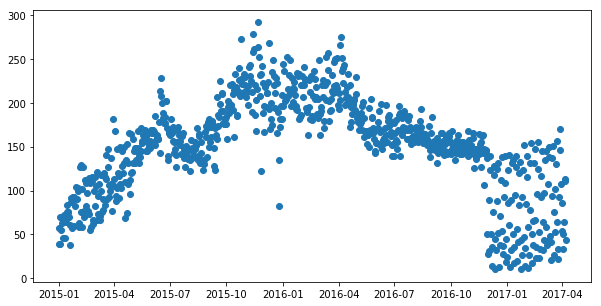

In [50]:
from datetime import datetime
times = pd.DataFrame()
times = politifact_pro.groupby('post_created_date_CT').mean()
times['count'] = politifact_pro.groupby('post_created_date_CT').size()
times.reset_index(level=0, inplace=True)
times=times[['post_created_date_CT','count']]
times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
plt.rcParams['figure.figsize'] = [10, 5]
mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'])

In [51]:
politifact_seldom = politifact_with_fake_domain[(politifact_with_fake_domain['domain']=='247NewsMedia.com')|(politifact_with_fake_domain['domain']=='AmericanPoliticNews.co	')|(politifact_with_fake_domain['domain']=='BuzzFeedUSA.com	')|(politifact_with_fake_domain['domain']=='CivicTribune.com')|(politifact_with_fake_domain['domain']=='ConservativeSpirit.com')|(politifact_with_fake_domain['domain']=='DemocraticMoms.com')|(politifact_with_fake_domain['domain']=='FederalistTribune.com')|(politifact_with_fake_domain['domain']=='GiverLiberty01.com')|(politifact_with_fake_domain['domain']=='GummyPost.com')|(politifact_with_fake_domain['domain']=='LastDeplorables.com')|(politifact_with_fake_domain['domain']=='NewPoliticsToday.com')|(politifact_with_fake_domain['domain']=='NewsExaminer.net')|(politifact_with_fake_domain['domain']=='NewsMagazine.com')|(politifact_with_fake_domain['domain']=='NoteAllowedTo.com')|(politifact_with_fake_domain['domain']=='OnePoliticalPlaza.com')|(politifact_with_fake_domain['domain']=='PoliticsUSANews.com')|
                                                (politifact_with_fake_domain['domain']=='ReadConservatives.news')|(politifact_with_fake_domain['domain']=='RedCountry.us')|(politifact_with_fake_domain['domain']=='ReligionMind.com')|(politifact_with_fake_domain['domain']=='TDTAlliance.com	')|(politifact_with_fake_domain['domain']=='The-Insider.co')|(politifact_with_fake_domain['domain']=='TheTrumpMedia.com')|(politifact_with_fake_domain['domain']=='USADailyInfo.com')|(politifact_with_fake_domain['domain']=='USADailyTime.com')|
                                                (politifact_with_fake_domain['domain']=='USANewsHome.com')|(politifact_with_fake_domain['domain']=='USAPolitics24hrs.com')|(politifact_with_fake_domain['domain']=='USASnich.com')|(politifact_with_fake_domain['domain']=='USHealthyAdvisor.com')|
                                                (politifact_with_fake_domain['domain']=='USInfoNews.com')|(politifact_with_fake_domain['domain']=='USPOLN.com')|(politifact_with_fake_domain['domain']=='USPostman.com')|(politifact_with_fake_domain['domain']=='UndergroundNewsReport.com')|(politifact_with_fake_domain['domain']=='VoxTribune.com')]

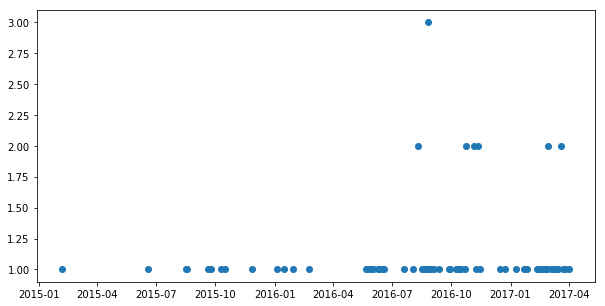

In [52]:
times = pd.DataFrame()
times = politifact_seldom.groupby('post_created_date_CT').mean()
times['count'] = politifact_seldom.groupby('post_created_date_CT').size()
times.reset_index(level=0, inplace=True)
times=times[['post_created_date_CT','count']]
times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
plt.rcParams['figure.figsize'] = [10, 5]
mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'])

In [17]:
fake_page = politifact_with_fake_domain.groupby('page_name').mean()
fake_page = fake_page[['post_likes','post_comments','post_shares']]
fake_page['count'] = politifact_with_fake_domain.groupby('page_name').size()

post_likes       859.841861
post_comments    116.194361
post_shares      459.216963
count            747.598870
dtype: float64

In [19]:
fake_page_seldom = fake_page[fake_page['count']<10]
fake_page_pro = fake_page[fake_page['count']>740]

In [22]:
print(fake_page_seldom['post_likes'].mean())
print(fake_page_pro['post_likes'].mean())
print(politics['post_likes'].mean())

1045.2311904761905
694.838580600322
575.8238362773211


In [23]:
print(fake_page_seldom['post_shares'].mean())
print(fake_page_pro['post_shares'].mean())
print(politics['post_shares'].mean())

546.8102408008658
338.9006962029508
135.8483961008781


In [20]:
print(fake_page_seldom['post_shares'].mean())
print(fake_page_pro['post_shares'].mean())
print(politics['post_shares'].mean())

546.8102408008658
338.9006962029508
135.8483961008781


In [115]:
post_sort_by_created_time = politifact_with_fake_domain.sort_values(['page_name','post_created_date_CT'])

# domain page relation

In [77]:
page_domain = politifact_with_fake_domain.groupby(['page_name','domain']).size()
page_domain = page_domain.reset_index()
page_domain
page_domain.to_csv('page_domain.csv')

In [82]:
domain_page = politifact_with_fake_domain.groupby(['domain','page_name']).size()
domain_page = domain_page.reset_index()
domain_page.to_csv('domain_page.csv')

## pages with the same name as domain

In [109]:
similar_or_the_same_name= ['Barracuda Brigade',
                           'ClashDaily.com with Doug Giles',
                           'Mad World News',
                           'Breitbart - One Voice Silenced, Millions Awakened',
                           'Disclose.tv',
                           'Freedom Daily',
                           'Liberal Daily']

In [170]:
first_post_create_time = pd.DataFrame()
for i in similar_or_the_same_name:
    first_created = post_sort_by_created_time[post_sort_by_created_time['page_name']==i].head(1)
    first_post_create_time = pd.concat([first_post_create_time,first_created])
first_post_create_time = first_post_create_time[['page_name','post_created_date_CT']]
first_post_create_time['post_created_date_CT'] = first_post_create_time['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
first_post_create_time

,page_name,post_created_date_CT
97321,Barracuda Brigade,2015-03-15
64262,ClashDaily.com with Doug Giles,2014-12-31
28108,Mad World News,2014-12-31
48013,"Breitbart - One Voice Silenced, Millions Awakened",2015-05-03
22874,Disclose.tv,2015-01-01
8856,Freedom Daily,2016-03-14
6954,Liberal Daily,2017-01-02


In [54]:
page_domain_same = politifact_with_fake_domain[(politifact_with_fake_domain['page_name'] == 'Barracuda Brigade') | (politifact_with_fake_domain['page_name'] == 'ClashDaily.com with Doug Giles') |
                         (politifact_with_fake_domain['page_name'] == 'Mad World News') |(politifact_with_fake_domain['page_name'] == 'Breitbart - One Voice Silenced, Millions Awakened') |
                         (politifact_with_fake_domain['page_name'] == 'Disclose.tv') |(politifact_with_fake_domain['page_name'] == 'Freedom Daily') |(politifact_with_fake_domain['page_name'] == 'Liberal Daily')]

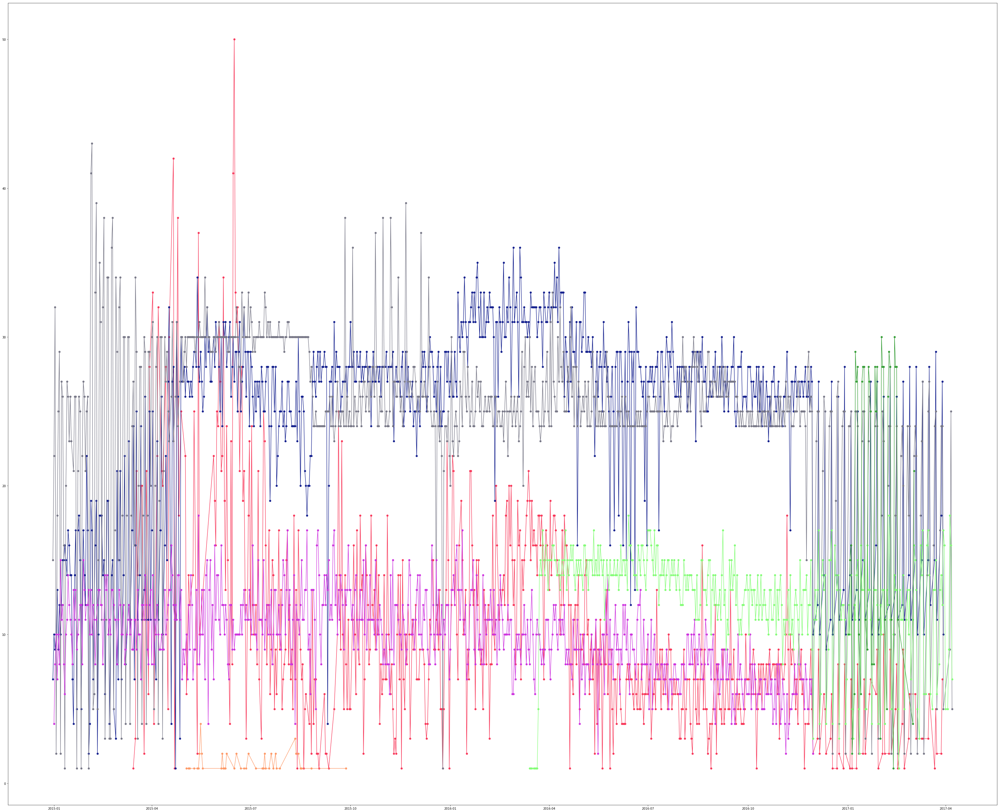

In [177]:
from datetime import datetime
plt.rcParams['figure.figsize'] = [60, 50]
times = pd.DataFrame()
for i in similar_or_the_same_name:
    times = page_domain_same[page_domain_same['page_name']==i].groupby('post_created_date_CT').mean()
    times['count'] = page_domain_same[page_domain_same['page_name']==i].groupby('post_created_date_CT').size()
    times.reset_index(level=0, inplace=True)
    times=times[['post_created_date_CT','count']]
    times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
    mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'], color = np.random.rand(3,),ls = 'solid')

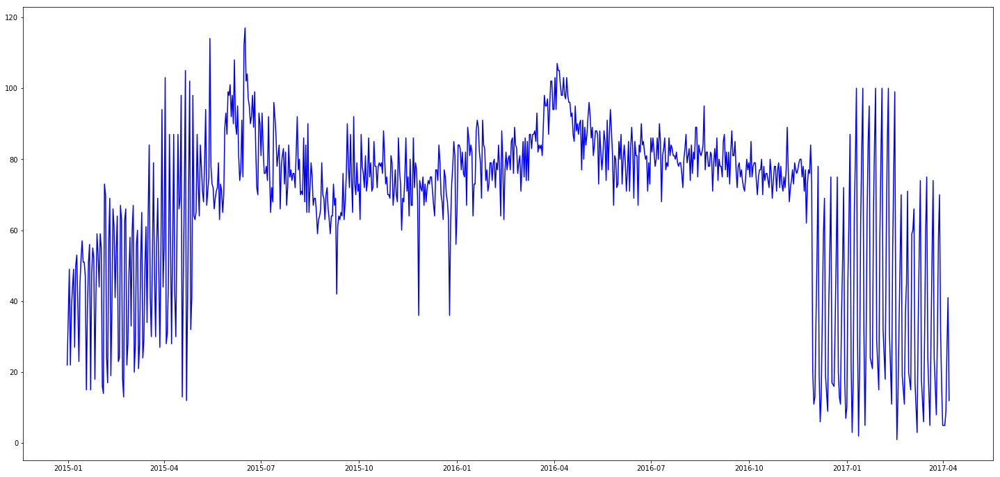

In [155]:
from datetime import datetime
times = pd.DataFrame()
times = page_domain_same.groupby('post_created_date_CT').mean()
times['count'] = page_domain_same.groupby('post_created_date_CT').size()
times.reset_index(level=0, inplace=True)
times=times[['post_created_date_CT','count']]
times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
plt.rcParams['figure.figsize'] = [25, 12]
mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'],'b-')

In [56]:
page_domain_different = page_domain_same[(page_domain_same['domain']!='BB4SP.com')|(page_domain_same['domain']!='Disclose.tv')|
                                        (page_domain_same['domain']!='FreedomDaily.com')|(page_domain_same['domain']!='LiberalPlug.com')|
                                        (page_domain_same['domain']!='MadWorldNews.com')]
page_domain_different = page_domain_different[(page_domain_different['page_name']=='ClashDaily.com with Doug Giles')&
                                             (page_domain_different['domain']!='ClashDaily.com')]
page_domain_different

,page_id,page_name,post_id,post_type,post_name,post_message,post_caption,post_picture,post_link,post_description,...,post_created_time_CT,post_updated_time_CT,post_created_date_CT,post_updated_date_CT,post_created_time,post_updated_time,page_talking_about_count,domain,category,type
82,228702593913193,ClashDaily.com with Doug Giles,228702593913193_1007442819372496,link,BREAKING: Judge Initiates Investigation Over O...,Obama has lied to the American people and he n...,usherald.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://usherald.com/breaking-judge-initiates-i...,"“The Wheels of Justice Grind Slow, But They Gr...",...,2016-06-28T14:35:01Z,2016-07-02T10:24:48Z,2016-06-28,2016-07-02,2016-06-28T19:35:01Z,2016-07-02T15:24:48Z,152602.0,USHerald.com,News/Media Website,media
101,228702593913193,ClashDaily.com with Doug Giles,228702593913193_1049407408509370,link,'The View' Is On The Chopping Block To Be Canc...,It's about time this liberal trash was yanked ...,usherald.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://usherald.com/the-view-is-about-to-be-ca...,“Please” say it isn’t so! Can it be true? You ...,...,2016-08-21T12:35:01Z,2016-08-23T04:40:30Z,2016-08-21,2016-08-23,2016-08-21T17:35:01Z,2016-08-23T09:40:30Z,432956.0,USHerald.com,News/Media Website,media
126,228702593913193,ClashDaily.com with Doug Giles,228702593913193_1003878156395629,link,Military Generals Take Steps To Arrest Obama O...,Military Generals Take Steps To Arrest Obama O...,usherald.com,https://fbexternal-a.akamaihd.net/safe_image.p...,http://usherald.com/military-generals-move-to-...,There’s absolutely no doubt that President Oba...,...,2016-06-23T15:35:01Z,2016-06-25T04:35:49Z,2016-06-23,2016-06-25,2016-06-23T20:35:01Z,2016-06-25T09:35:49Z,585611.0,USHerald.com,News/Media Website,media
173,228702593913193,ClashDaily.com with Doug Giles,228702593913193_1021063921343719,link,INSPIRING: Wounded Vet To Open Business Whose ...,'God Kept Me Alive for a Reason'\r\n\r\nCan we...,usherald.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://usherald.com/inspiring-wounded-war-vete...,This incredible soldier continues to give and ...,...,2016-07-17T13:35:01Z,2016-07-19T23:50:17Z,2016-07-17,2016-07-19,2016-07-17T18:35:01Z,2016-07-20T04:50:17Z,525734.0,USHerald.com,News/Media Website,media
209,228702593913193,ClashDaily.com with Doug Giles,228702593913193_1139574249492685,link,VIDEO: Obama Trying To SILENCE Judge Pirro Aft...,Obama wants to SILENCE Judge Pirro after what ...,usherald.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://usherald.com/video-obama-trying-silence...,"If you’re a fan of Jeanine Pirro, the popular ...",...,2016-11-24T14:35:02Z,2016-11-25T23:22:57Z,2016-11-24,2016-11-25,2016-11-24T20:35:02Z,2016-11-26T05:22:57Z,800737.0,USHerald.com,News/Media Website,media
220,228702593913193,ClashDaily.com with Doug Giles,228702593913193_953488141434631,link,"McDonalds, Pizza Hut And KFC Refuse Muslim Dem...",Muslims are furious but it's too late. They ar...,usherald.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://usherald.com/mcdonalds-pizza-hut-kfc-re...,"""Hold the pickle, hold the lettuce special ord...",...,2016-04-16T14:35:00Z,2016-04-17T11:45:53Z,2016-04-16,2016-04-17,2016-04-16T19:35:00Z,2016-04-17T16:45:53Z,184917.0,USHerald.com,News/Media Website,media
222,228702593913193,ClashDaily.com with Doug Giles,228702593913193_1032108510239260,link,VIDEO: Obama Trying To SILENCE Judge Pirro Aft...,Obama wants to SILENCE Judge Pirro after what ...,usherald.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://usherald.com/video-obama-trying-silence...,"If you’re a fan of Jeanine Pirro, the popular ...",...,2016-08-01T00:35:01Z,2016-08-02T22:18:56Z,2016-08-01,2016-08-02,2016-08-01T05:35:01Z,2016-08-03T03:18:56Z,476505.0,USHerald.com,News/Media Website,media
368,228702593913193,ClashDaily.com with Doug Giles,228702593913193_1002509363199175,link,BREAKING VIDEO: Ohio Muslims Launch Civil War ...,BREAKI

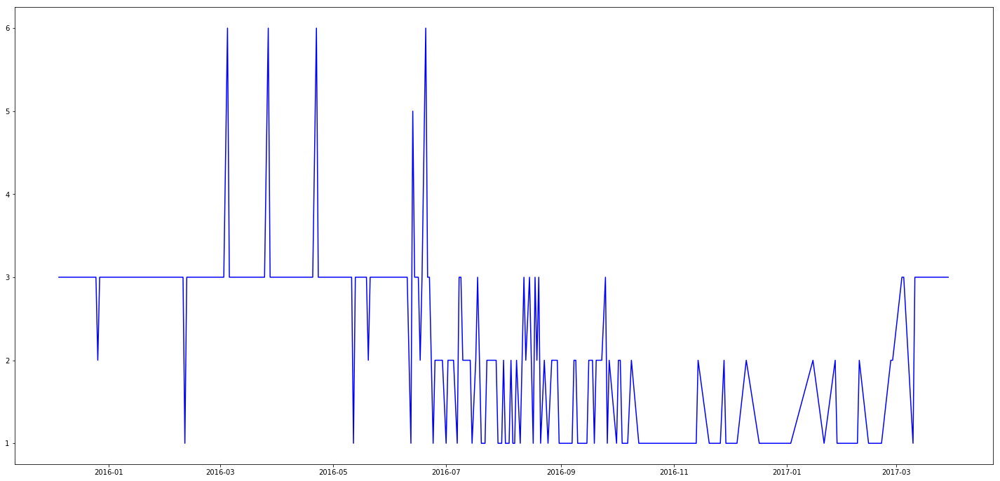

In [74]:
times = pd.DataFrame()
times = page_domain_different.groupby('post_created_date_CT').mean()
times['count'] = page_domain_different.groupby('post_created_date_CT').size()
times.reset_index(level=0, inplace=True)
times=times[['post_created_date_CT','count']]
times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
plt.rcParams['figure.figsize'] = [25, 12]
mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'],'b-')

## pages that posts mainly from one domain

In [125]:
mainlyfromone_page

['100 Percent FED Up',
 'Abolish The IRS',
 'America is RIGHT',
 'Angry American Patriots',
 'Ann Romney Fan Site',
 'Dc Gazette',
 'Democrats Driving Forward to Victory',
 'End The Fed',
 'Girls Just Wanna Have Guns',
 'God King',
 'Last American Patriots',
 'My Favorite Gun',
 'Obama Makes Me Puke',
 'Patriot Nation',
 'Rebirth of Freedom',
 'Robertson Family Values',
 'Sean Brown',
 'Spokane Conservative Examiner',
 'Tell Me Now',
 'The Last Great Stand',
 'The New Resistance',
 'The Political Insider',
 'Trina']

In [127]:
first_post_create_time = pd.DataFrame()
for i in mainlyfromone_page:
    first_created = post_sort_by_created_time[post_sort_by_created_time['page_name']==i].head(1)
    first_post_create_time = pd.concat([first_post_create_time,first_created])
first_post_create_time = first_post_create_time[['page_name','post_created_date_CT']]
first_post_create_time.sort_values('post_created_date_CT')

,page_name,post_created_date_CT
23167,The New Resistance,2014-12-31
96114,Sean Brown,2014-12-31
22148,Rebirth of Freedom,2014-12-31
52773,Ann Romney Fan Site,2015-01-01
28401,Patriot Nation,2015-01-10
37924,Girls Just Wanna Have Guns,2015-01-19
131426,Angry American Patriots,2015-01-22
112917,The Last Great Stand,2015-01-27
32623,Obama Makes Me Puke,2015-02-08
103306,Last American Patriots,2015-02-21


In [59]:
page_domain_mainlyfromone = page_domain[(page_domain['page_name'] == '100 Percent FED Up') | (page_domain['page_name'] == 'Abolish The IRS') |(page_domain['page_name'] == 'America is RIGHT') |(page_domain['page_name'] == 'Last American Patriots') |(page_domain['page_name'] == 'My Favorite Gun') |(page_domain['page_name'] == 'Obama Makes Me Puke') |(page_domain['page_name'] == 'Patriot Nation')|
                                        (page_domain['page_name'] == 'Rebirth of Freedom') | (page_domain['page_name'] == 'Robertson Family Values') |(page_domain['page_name'] == 'Sean Brown') |(page_domain['page_name'] == 'Spokane Conservative Examiner') |(page_domain['page_name'] == 'Tell Me Now') |(page_domain['page_name'] == 'The Last Great Stand') |(page_domain['page_name'] == 'The New Resistance')|
                                        (page_domain['page_name'] == 'The Political Insider') | (page_domain['page_name'] == 'Girls Just Wanna Have Guns') |(page_domain['page_name'] == 'Angry American Patriots') |(page_domain['page_name'] == 'Ann Romney Fan Site') |
                         (page_domain['page_name'] == 'Dc Gazette') |(page_domain['page_name'] == 'Democrats Driving Forward to Victory') |(page_domain['page_name'] == 'End The Fed')|(page_domain['page_name'] == 'God King')|(page_domain['page_name'] == 'Trina')]
page_domain_mainlyfromone

mainlyfromone_page = list(page_domain_mainlyfromone.page_name.unique())
mainlyfromwhat_domain = []

for i in mainlyfromone_page:
    test = page_domain_mainlyfromone[page_domain_mainlyfromone['page_name']==i]
    maximun = test.loc[test[0].idxmax()]
    mainlyfromwhat_domain.append(maximun['domain'])

In [60]:
mainlyfromone = politifact_with_fake_domain[(politifact_with_fake_domain['page_name'] == '100 Percent FED Up') | (politifact_with_fake_domain['page_name'] == 'Abolish The IRS') |(politifact_with_fake_domain['page_name'] == 'America is RIGHT') |(politifact_with_fake_domain['page_name'] == 'Last American Patriots') |(politifact_with_fake_domain['page_name'] == 'My Favorite Gun') |(politifact_with_fake_domain['page_name'] == 'Obama Makes Me Puke') |(politifact_with_fake_domain['page_name'] == 'Patriot Nation')|
                                        (politifact_with_fake_domain['page_name'] == 'Rebirth of Freedom') | (politifact_with_fake_domain['page_name'] == 'Robertson Family Values') |(politifact_with_fake_domain['page_name'] == 'Sean Brown') |(politifact_with_fake_domain['page_name'] == 'Spokane Conservative Examiner') |(politifact_with_fake_domain['page_name'] == 'Tell Me Now') |(politifact_with_fake_domain['page_name'] == 'The Last Great Stand') |(politifact_with_fake_domain['page_name'] == 'The New Resistance')|
                                        (politifact_with_fake_domain['page_name'] == 'The Political Insider') | (politifact_with_fake_domain['page_name'] == 'Girls Just Wanna Have Guns') |(politifact_with_fake_domain['page_name'] == 'Angry American Patriots') |(politifact_with_fake_domain['page_name'] == 'Ann Romney Fan Site') |
                         (politifact_with_fake_domain['page_name'] == 'Dc Gazette') |(politifact_with_fake_domain['page_name'] == 'Democrats Driving Forward to Victory') |(politifact_with_fake_domain['page_name'] == 'End The Fed')|(page_domain['page_name'] == 'God King')|(politifact_with_fake_domain['page_name'] == 'Trina')]
mainlyfromone

,page_id,page_name,post_id,post_type,post_name,post_message,post_caption,post_picture,post_link,post_description,...,post_created_time_CT,post_updated_time_CT,post_created_date_CT,post_updated_date_CT,post_created_time,post_updated_time,page_talking_about_count,domain,category,type
12,591402597574018,Tell Me Now,591402597574018_1065863346794605,link,This White House Petition to CHARGE Hillary Re...,EAT. THIS. HILDEBEEST. \nLet's push this OVER ...,clashdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://clashdaily.com/2016/07/white-house-peti...,"Hillary may have gotten her way with the FBI, ...",...,2016-07-07T20:00:00Z,2016-07-09T11:11:32Z,2016-07-07,2016-07-09,2016-07-08T01:00:00Z,2016-07-09T16:11:32Z,349481.0,ClashDaily.com,News/Media Website,media
30,112723252096438,The Political Insider,112723252096438_1061186837250070,link,"If Trump Is So Awful, Why Are His Kids So Awes...",Here's a great question...please forward this ...,clashdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://clashdaily.com/2016/03/if-trump-is-so-a...,NaN,...,2016-03-06T18:33:01Z,2016-03-08T17:40:30Z,2016-03-06,2016-03-08,2016-03-07T00:33:01Z,2016-03-08T23:40:30Z,1010747.0,ClashDaily.com,News/Media Website,media
38,112723252096438,The Political Insider,112723252096438_1146533155382104,link,This White House Petition to CHARGE Hillary Re...,Let's push this OVER 30 Million! 'Like & Share...,clashdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://clashdaily.com/2016/07/white-house-peti...,"Hillary may have gotten her way with the FBI, ...",...,2016-07-08T17:00:00Z,2016-07-09T18:50:18Z,2016-07-08,2016-07-09,2016-07-08T22:00:00Z,2016-07-09T23:50:18Z,1024760.0,ClashDaily.com,News/Media Website,media
50,112723252096438,The Political Insider,112723252096438_1253098804725538,link,DEAR TRUMP HATERS: If Trump Is ‘Evil’ Then WHY...,I believe Spiderman once said that a “tree is ...,clashdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://clashdaily.com/2016/07/dear-trump-hater...,NaN,...,2016-11-11T02:30:01Z,2016-11-11T02:30:01Z,2016-11-11,2016-11-11,2016-11-11T08:30:01Z,2016-11-11T08:30:01Z,684362.0,ClashDaily.com,News/Media Website,media
53,112723252096438,The Political Insider,112723252096438_1155268367841916,link,PATRIOTS: Ben Carson Linked Hillary To LUCIFER...,DANG. Ben went rogue on The Hildebeest. \n\nWa...,clashdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://clashdaily.com/2016/07/patriots-ben-car...,Ben Carson just called out Hillary and linked ...,...,2016-07-21T23:00:00Z,2016-07-23T22:39:08Z,2016-07-21,2016-07-23,2016-07-22T04:00:00Z,2016-07-24T03:39:08Z,915310.0,ClashDaily.com,News/Media Website,media
65,721683147909323,The New Resistance,721683147909323_1276732035737762,link,Liberals IRATE After Trump Sends 92 Muslims Pa...,Islamists and liberals are losing their minds ...,madworldnews.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://madworldnews.com/trump-92-muslims-airport/,Islamists and liberals are losing their minds ...,...,2017-01-26T16:30:17Z,2017-01-30T07:18:42Z,2017-01-26,2017-01-30,2017-01-26T22:30:17Z,2017-01-30T13:18:42Z,212803.0,MadWorldNews.com,Community,group
74,721683147909323,The New Resistance,721683147909323_1286162778128021,link,"Vet-Owned Coffee Co's Counter-Offer Has '10,00...",After liberal Starbucks announced they will de...,madworldnews.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://madworldnews.com/vet-coffee-refugees-st...,After liberal Starbucks announced they will de...,...,2017-02-03T19:30:00Z,2017-02-07T07:49:35Z,2017-02-03,2017-02-07,2017-02-04T01:30:00Z,2017-02-07T13:49:35Z,212803.0,MadWorldNews.com,Community,group
78,591402597574018,Tell Me Now,591402597574018_1046727372041536,link,QUESTION: Should Welfare ABUSERS Be ARRESTED?,This is a HOT potato. \nThis deserves ... oh ....,clashdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://clashdaily.com/2016/06/question-welfare...,Do you think that those 

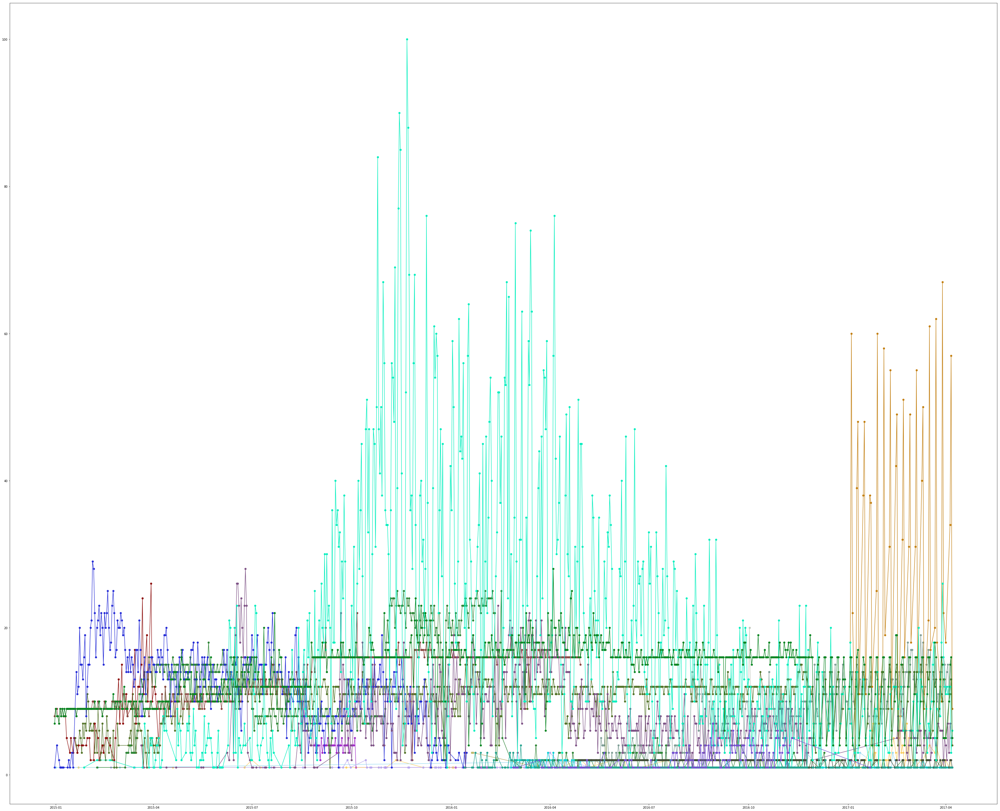

In [178]:
plt.rcParams['figure.figsize'] = [60, 50]
times = pd.DataFrame()
for i in mainlyfromone_page:
    times = mainlyfromone[mainlyfromone['page_name']==i].groupby('post_created_date_CT').mean()
    times['count'] = mainlyfromone[mainlyfromone['page_name']==i].groupby('post_created_date_CT').size()
    times.reset_index(level=0, inplace=True)
    times=times[['post_created_date_CT','count']]
    times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
    mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'], color = np.random.rand(3,),ls = 'solid')

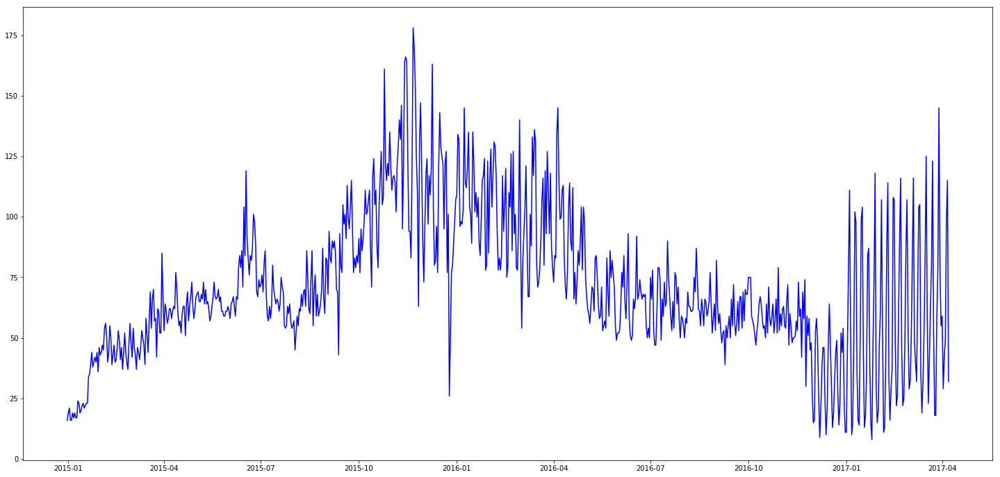

In [75]:
times = pd.DataFrame()
times = mainlyfromone.groupby('post_created_date_CT').mean()
times['count'] = mainlyfromone.groupby('post_created_date_CT').size()
times.reset_index(level=0, inplace=True)
times=times[['post_created_date_CT','count']]
times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
plt.rcParams['figure.figsize'] = [25, 12]
mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'],'b-')

In [110]:
mainlyfromone_page
mainlyfromwhat_domain
mainlyfromone_data = pd.DataFrame()
for i in range(23):
    test = mainlyfromone[(mainlyfromone['page_name']==mainlyfromone_page[i])&(mainlyfromone['domain']!=mainlyfromwhat_domain[i])]
    mainlyfromone_data = pd.concat([mainlyfromone_data,test])
mainlyfromone_data

,page_id,page_name,post_id,post_type,post_name,post_message,post_caption,post_picture,post_link,post_description,...,post_created_time_CT,post_updated_time_CT,post_created_date_CT,post_updated_date_CT,post_created_time,post_updated_time,page_talking_about_count,domain,category,type
292,311190048935167,100 Percent FED Up,311190048935167_1184685238252306,link,Armed Citizen Shoots and Kills Suspect Who Was...,Armed Citizen Shoots and Kills Suspect Who Was...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/armed-citizen-shoots-k...,This is what the 2nd Amendment is all about!,...,2016-11-15T13:00:00Z,2016-11-18T20:21:20Z,2016-11-15,2016-11-18,2016-11-15T19:00:00Z,2016-11-19T02:21:20Z,356173.0,FreedomDaily.com,Media/News/Publishing,media
317,311190048935167,100 Percent FED Up,311190048935167_1181048015282695,link,YES! Rosie O’Donnell Confirms She’s Moving Fro...,YES! Rosie O’Donnell Confirms She’s Moving Fro...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/yes-rosie-odonnell-con...,Pack your sh*t and go! Rosie O is gonna hit th...,...,2016-11-12T13:16:37Z,2016-11-14T09:06:17Z,2016-11-12,2016-11-14,2016-11-12T19:16:37Z,2016-11-14T15:06:17Z,1687606.0,FreedomDaily.com,Media/News/Publishing,media
819,311190048935167,100 Percent FED Up,311190048935167_1179785018742328,link,Trump Announces Trey Gowdy Is Finalist For One...,Trump Announces Trey Gowdy Is Finalist For One...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/trump-announces-trey-g...,Hillary is not going to sleep well over this!,...,2016-11-11T13:00:00Z,2016-11-13T19:48:40Z,2016-11-11,2016-11-13,2016-11-11T19:00:00Z,2016-11-14T01:48:40Z,356173.0,FreedomDaily.com,Media/News/Publishing,media
1612,311190048935167,100 Percent FED Up,311190048935167_1170058743048289,link,Liberals at 'The View' Tried to Bully Trumps M...,Whoopi and Her Liberal Hacks at 'The View' Tri...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/liberals-view-tried-bu...,She goes OFF.,...,2016-11-03T13:00:00Z,2016-11-08T14:40:44Z,2016-11-03,2016-11-08,2016-11-03T18:00:00Z,2016-11-08T20:40:44Z,356173.0,FreedomDaily.com,Media/News/Publishing,media
2035,311190048935167,100 Percent FED Up,311190048935167_1187623397958490,link,Freedom DAILY- Your Daily Dose Of Freedom.,** GEORGE SOROS IS BURNING **\n\nTrump has sen...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/,Freedom Daily Delivers meaningful conservative...,...,2016-11-17T17:38:14Z,2016-11-23T10:31:29Z,2016-11-17,2016-11-23,2016-11-17T23:38:14Z,2016-11-23T16:31:29Z,356173.0,FreedomDaily.com,Media/News/Publishing,media
2360,311190048935167,100 Percent FED Up,311190048935167_1182414141812749,link,PEPSI CEO Just Made SHAMEFUL Statement About T...,PEPSI CEO Just Made SHAMEFUL Statement About T...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/pepsi-,I feel another boycott coming on.,...,2016-11-13T13:37:50Z,2016-11-15T09:43:49Z,2016-11-13,2016-11-15,2016-11-13T19:37:50Z,2016-11-15T15:43:49Z,1738462.0,FreedomDaily.com,Media/News/Publishing,media
3727,311190048935167,100 Percent FED Up,311190048935167_1171391696248327,link,Breaking! Ex-Apprentice Trump Accuser Was Paid...,Breaking! Ex-Apprentice Trump Accuser Was Paid...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.com/ex-apprentice-trump-ac...,The Democratic machine has been in full overdr...,...,2016-11-04T13:00:00Z,2016-11-07T04:34:30Z,2016-11-04,2016-11-07,2016-11-04T18:00:00Z,2016-11-07T10:34:30Z,356173.0,FreedomDaily.com,Media/News/Publishing,media
5467,311190048935167,100 Percent FED Up,311190048935167_1190126087708221,link,Pro-Trump Family Of Soldier Killed Bringing Bo...,Pro-Trump Family Of Soldier Killed Bringing Bo...,freedomdaily.com,https://external.xx.fbcdn.net/safe_image.php?d...,http://freedomdaily.co

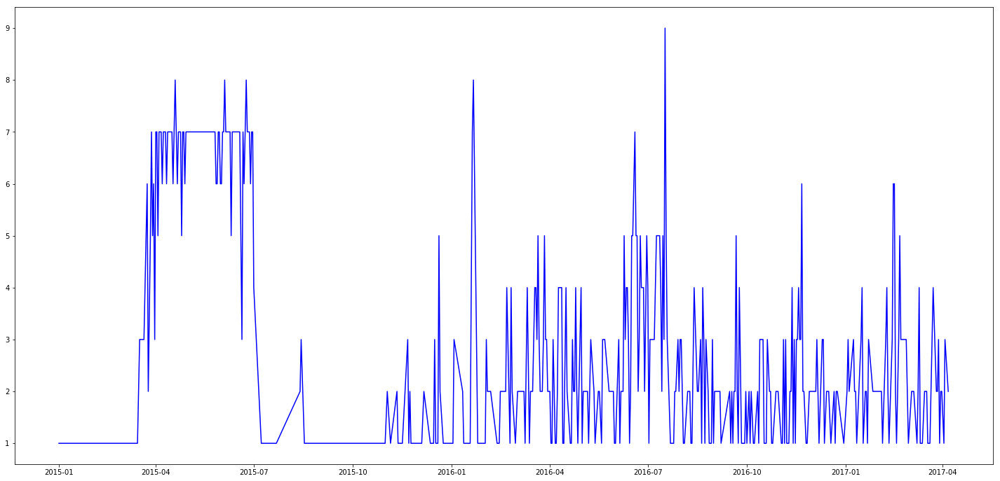

In [76]:
times = pd.DataFrame()
times = mainlyfromone_data.groupby('post_created_date_CT').mean()
times['count'] = mainlyfromone_data.groupby('post_created_date_CT').size()
times.reset_index(level=0, inplace=True)
times=times[['post_created_date_CT','count']]
times['post_created_date_CT'] = times['post_created_date_CT'].apply(lambda x:datetime.strptime(x,'%Y-%m-%d'))
plt.rcParams['figure.figsize'] = [25, 12]
mpl.pyplot.plot_date(times['post_created_date_CT'], times['count'],'b-')